In [72]:
import pandas as pd
import polars as pl
import numpy as np
import os
import logging
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_auc_score

In [73]:
def color_scale(val):
    color = plt.cm.viridis(val / 100)  # Usar colormap viridis
    return f'background-color: rgba({int(color[0]*255)}, {int(color[1]*255)}, {int(color[2]*255)}, {color[3]})'

In [74]:
logging.basicConfig()
logger = logging.getLogger(__name__)
logger.setLevel(logging.INFO)

In [75]:
os.chdir("/home/sagemaker-user/data-bbog-integration-fabrica-personas/src")
import data_bbog_integration_fabrica_personas.pipelines.backtesting.nodes as backtesting
import data_bbog_integration_fabrica_personas.pipelines.models.nodes as models
import data_bbog_integration_fabrica_personas.pipelines.model_selection.nodes as ms

In [76]:
%load_ext kedro.ipython

The kedro.ipython extension is already loaded. To reload it, use:
  %reload_ext kedro.ipython


In [77]:
%reload_kedro

[02/04/25 13:51:56] INFO     Resolved project path as:                                              ]8;id=564532;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/ipython/__init__.py\__init__.py]8;;\:]8;id=785915;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/ipython/__init__.py#139\139]8;;\
                             /home/sagemaker-user/data-bbog-integration-fabrica-personas.                          
                             To set a different path, run '%reload_kedro <project_root>'                           

[02/04/25 13:52:04] WARNING  /home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-p ]8;id=112475;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=748102;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             ackages/kedro/io/data_catalog.py:301: KedroDeprecationWarning:                        
                             Defining the 'layer' attribute at the top level is deprecated and will                
                             be removed in Kedro 0.19.0. Please move 'layer' inside the 'metadata'                 
                             -> 'kedro-viz' attributes. See                                                        
                             https://docs.kedro.org/en/latest/visualisation/kedro-viz_visualisation                
                             .html#visualise-layers for more information.                                          
                               warnings.warn(                                                                      
                                                                                                                   

                    WARNING  /home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-p ]8;id=768725;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=110023;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             ackages/kedro/io/__init__.py:44: KedroDeprecationWarning:                             
                             'AbstractDataSet' has been renamed to 'AbstractDataset', and the alias                
                             will be removed in Kedro 0.19.0                                                       
                               return getattr(kedro.io.core, name)                                                 
                                                                                                                   

                    INFO     Kedro project data-bbog-integration-fabrica-personas                   ]8;id=510764;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/ipython/__init__.py\__init__.py]8;;\:]8;id=140781;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/ipython/__init__.py#108\108]8;;\

                    INFO     Defined global variable 'context', 'session', 'catalog' and            ]8;id=734474;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/ipython/__init__.py\__init__.py]8;;\:]8;id=318337;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/ipython/__init__.py#109\109]8;;\
                             'pipelines'                                                                           

In [78]:
params1= catalog.list
params= catalog.load("parameters")

                    INFO     Loading data from 'parameters' (MemoryDataset)...                  ]8;id=887323;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=742106;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\

### Caracteres:

In [8]:
catalog.load('homologate_region_model_experimento_1_y_2') #expermento1,2,5 y 6

[01/27/25 14:47:46] INFO     Loading data from 'homologate_region_model_experimento_1_y_2'      ]8;id=240453;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=51529;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    


{
    'variable1': {
        'nombre': 'region',
        'insumo': 'departamento',
        'fillna': 'Other_Region',
        'modo_homologacion': {
            'amazonas': 'Region_Amazonica',
            'antioquia': 'Region_Andina',
            'arauca': 'Region_Orinoquia',
            'archipielago_de_san_andres_providencia_y': 'Region_Caribe',
            'atlantico': 'Region_Caribe',
            'bogota_d_c': 'Region_Central',
            'bogota_d_c_': 'Region_Central',
            'bolivar': 'Region_Caribe',
            'boyaca': 'Region_Andina',
            'caldas': 'Region_Andina',
            'caqueta': 'Region_Amazonica',
            'casanare': 'Region_Orinoquia',
            'cauca': 'Region_Pacifica',
            'cesar': 'Region_Caribe',
            'choco': 'Region_Pacifica',
            'cordoba': 'Region_Caribe',
            'cundinamarca': 'Region_Andina',
            'guainia': 'Region_Amazonica',
            'guaviare': 'Region_Amazonica',
            'huila': 'Re

In [9]:
catalog.load('homologate_region_model_experimento_3_y_4')

[01/27/25 14:47:47] INFO     Loading data from 'homologate_region_model_experimento_3'          ]8;id=589670;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=362826;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    


{
    'variable1': {
        'nombre': 'region',
        'insumo': 'departamento',
        'fillna': 'Other_Region',
        'modo_homologacion': {
            'amazonas': 'Region_Amazonica',
            'antioquia': 'Region_Andina',
            'arauca': 'Region_Orinoquia',
            'archipielago_de_san_andres_providencia_y': 'Region_Caribe',
            'atlantico': 'Region_Caribe',
            'bogota_d_c': 'Region_Central',
            'bogota_d_c_': 'Region_Central',
            'bolivar': 'Region_Caribe',
            'boyaca': 'Region_Andina',
            'caldas': 'Region_Andina',
            'caqueta': 'Region_Amazonica',
            'casanare': 'Region_Orinoquia',
            'cauca': 'Region_Pacifica',
            'cesar': 'Region_Caribe',
            'choco': 'Region_Pacifica',
            'cordoba': 'Region_Caribe',
            'cundinamarca': 'Region_Andina',
            'guainia': 'Region_Amazonica',
            'guaviare': 'Region_Amazonica',
            'huila': 'Re

In [18]:
# PRUEBA 3 % 4, PRUEBA 1 & 2, y feature selection del MVP4
df = pd.read_parquet("s3://data-bbog-dev-sandbox-entity/casos-uso/fabrica-personas/CDT/04-feature/feature_selected_list_new_t3_v2.parquet")
df1 = pd.read_parquet("s3://data-bbog-dev-sandbox-entity/casos-uso/fabrica-personas/CDT/04-feature/feature_selected_list_new_t3.parquet")
# MVP4
df2 = pd.read_parquet("s3://data-bbog-dev-sandbox-entity/casos-uso/fabrica-personas/CDT/04-feature/CDT/masivo/feature_selected_list_CDT_prueba.parquet")
pd.concat([df.set_index('Feature'),df1.set_index('Feature'),df2.set_index('Feature')], axis=1)

,Importance,Importance,Importance
Feature,,,
cdt_sum_monto_apertura,0.198122,0.218860,0.008762
sum_saldo_activos,0.143631,0.140422,0.005613
periodo,0.056570,0.060157,NaN
ah_cant,0.053602,0.041129,0.007407
cdt_sum_valor_interes,0.049362,0.050238,0.019384
cdt_cant,0.031749,0.033130,0.141022
ah_sum_saldo_corte,0.030381,0.031079,0.006418
cdt_cant_prev,0.016381,0.016924,0.158300
sum_saldo_pasivos,0.004238,0.004646,NaN


In [12]:
# PRUEBA 1 y 2 tienen el feature selection diferente al MVP4
df1 = pd.read_parquet("s3://data-bbog-dev-sandbox-entity/casos-uso/fabrica-personas/CDT/04-feature/feature_selected_list_new_t3.parquet")
# MVP4
df2 = pd.read_parquet("s3://data-bbog-dev-sandbox-entity/casos-uso/fabrica-personas/CDT/04-feature/CDT/masivo/feature_selected_list_CDT_prueba.parquet")
pd.concat([df1.set_index('Feature'),df2.set_index('Feature')], axis=1)

,Importance,Importance
Feature,,
cdt_sum_monto_apertura,0.218860,0.008762
sum_saldo_activos,0.140422,0.005613
ah_sum_monto_trx_credito_mean_6,0.071671,NaN
periodo,0.060157,NaN
cdt_sum_valor_interes,0.050238,0.019384
ah_cant,0.041129,0.007407
cdt_prom_plazo_total_meses,0.038277,NaN
cdt_cant,0.033130,0.141022
ah_sum_saldo_corte,0.031079,0.006418


In [13]:
base_ini = catalog.load('feature_df')

[01/27/25 15:48:42] INFO     Loading data from 'feature_df' (ParquetDataSet)...                 ]8;id=110951;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=3205;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\

In [14]:
for col in df2['Feature']:
    if col in base_ini:
        print(col)
    else:
        print('No: ',col)

ah_sum_monto_trx_credito_std_6
cdt_cant_prev
cdt_cant
ah_sum_monto_trx_debito_std_6
ah_sum_monto_trx_debito_mean_2
delta_ah_sum_monto_trx_debito
ah_sum_monto_trx_debito
delta_ah_sum_monto_trx_credito
ah_sum_monto_trx_credito_mean_2
cdt_sum_valor_interes
ah_sum_monto_trx_debito_std_3
cdt_sum_monto_apertura
ah_sum_monto_trx_debito_mean_6
ah_cant
ah_sum_monto_trx_credito_std_3
ah_sum_saldo_corte
sum_saldo_activos
vlr_activos
ah_sum_saldo_promedio
cc_sum_monto_trx_debito
viv_cant
tc_sum_facturacion_total_valor_mean_2
tc_sum_facturacion_total_valor
ld_sum_saldo_promedio
sus_saldo_promedio


### models:

In [8]:
info_save_all = catalog.load('info_save_all')

[02/03/25 13:52:13] INFO     Loading data from 'info_save_all' (PickleDataSet)...               ]8;id=641053;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=582152;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\

In [10]:
info_save_all_anterior = catalog.load('info_save_all_anterior')

[01/31/25 15:23:55] INFO     Loading data from 'info_save_all_anterior' (PickleDataSet)...      ]8;id=243101;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=52329;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\

In [9]:
info_save_all.keys()

dict_keys(['nodo_run', 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 'all_results', 'best_model_metrics_dataset', 'select_model'])

In [11]:
info_save_all['best_model_metrics_dataset'] # prueba 6, sin eda, experimento 4

,model_name,dataset_name,metric_name,metric_type,class_name,value
35,"Run4,MLP_3",test,f1-score,class metric,1.0,12.1598
33,"Run4,MLP_3",test,precision,class metric,1.0,6.5313
70,"Run8,xgboost_7",test,recall,class metric,1.0,91.4248
32,"Run4,MLP_3",train,f1-score,class metric,1.0,12.2229
30,"Run4,MLP_3",train,precision,class metric,1.0,6.5657
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.7329


In [13]:
99.6968-91.4248

8.271999999999991

In [12]:
info_save_all['all_results'][(info_save_all['all_results']['model_name'] == 'Run8,xgboost_7') & (info_save_all['all_results']['metric_name'] == 'recall')]

,model_name,dataset_name,metric_name,metric_type,class_name,value
2,"Run8,xgboost_7",balance,recall,overall metric,overall metric,99.5296
13,"Run8,xgboost_7",balance,recall,class metric,0.0,92.2084
14,"Run8,xgboost_7",balance,recall,class metric,1.0,99.5296
2,"Run8,xgboost_7",train,recall,overall metric,overall metric,99.6968
13,"Run8,xgboost_7",train,recall,class metric,0.0,76.7929
14,"Run8,xgboost_7",train,recall,class metric,1.0,99.6968
2,"Run8,xgboost_7",test,recall,overall metric,overall metric,91.4248
13,"Run8,xgboost_7",test,recall,class metric,0.0,76.6085
14,"Run8,xgboost_7",test,recall,class metric,1.0,91.4248


In [ ]:
info_save_all['best_model_metrics_dataset'] # prueba 5, sin eda, experimento 3

In [ ]:
96.6505-96.4524

In [11]:
info_save_all['best_model_metrics_dataset'] # prueba 4, experimento 2, eda+homologaciones

,model_name,dataset_name,metric_name,metric_type,class_name,value
8,"Run1,MLP_0",test,f1-score,class metric,1.0,18.9463
6,"Run1,MLP_0",test,precision,class metric,1.0,10.7037
25,"Run3,random_forest_2",test,recall,class metric,1.0,95.9695
5,"Run1,MLP_0",train,f1-score,class metric,1.0,19.0194
3,"Run1,MLP_0",train,precision,class metric,1.0,10.7471
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.9227


In [13]:
96.1870-95.9695

0.21750000000000114

In [12]:
info_save_all['all_results'][(info_save_all['all_results']['model_name'] == 'Run3,random_forest_2') & (info_save_all['all_results']['metric_name'] == 'recall')]

,model_name,dataset_name,metric_name,metric_type,class_name,value
2,"Run3,random_forest_2",balance,recall,overall metric,overall metric,96.1662
13,"Run3,random_forest_2",balance,recall,class metric,0.0,61.2315
14,"Run3,random_forest_2",balance,recall,class metric,1.0,96.1662
2,"Run3,random_forest_2",train,recall,overall metric,overall metric,96.1870
13,"Run3,random_forest_2",train,recall,class metric,0.0,61.2577
14,"Run3,random_forest_2",train,recall,class metric,1.0,96.1870
2,"Run3,random_forest_2",test,recall,overall metric,overall metric,95.9695
13,"Run3,random_forest_2",test,recall,class metric,0.0,61.3271
14,"Run3,random_forest_2",test,recall,class metric,1.0,95.9695


In [10]:
info_save_all['best_model_metrics_dataset'] # prueba 3, experimento 1, eda+homologaciones

,model_name,dataset_name,metric_name,metric_type,class_name,value
17,"Run2,xgboost_1",test,f1-score,class metric,1.0,18.4554
15,"Run2,xgboost_1",test,precision,class metric,1.0,10.3760
97,"Run11,xgboost_10",test,recall,class metric,1.0,88.2801
14,"Run2,xgboost_1",train,f1-score,class metric,1.0,18.6725
12,"Run2,xgboost_1",train,precision,class metric,1.0,10.5000
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.9349


In [11]:
99.9349-88.2801

11.654799999999994

In [10]:
info_save_all['best_model_metrics_dataset'] # prueba 2, experimento 2, sin eda

,model_name,dataset_name,metric_name,metric_type,class_name,value
8,"Run1,MLP_0",test,f1-score,class metric,1.0,19.0868
6,"Run1,MLP_0",test,precision,class metric,1.0,10.7860
52,"Run6,random_forest_5",test,recall,class metric,1.0,96.9176
5,"Run1,MLP_0",train,f1-score,class metric,1.0,19.2037
3,"Run1,MLP_0",train,precision,class metric,1.0,10.8550
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.5604


In [14]:
97.0767-96.9176

0.15910000000000935

In [13]:
info_save_all['all_results'][(info_save_all['all_results']['model_name'] == 'Run6,random_forest_5') & (info_save_all['all_results']['metric_name'] == 'recall')]

,model_name,dataset_name,metric_name,metric_type,class_name,value
2,"Run6,random_forest_5",balance,recall,overall metric,overall metric,97.0767
13,"Run6,random_forest_5",balance,recall,class metric,0.0,57.6221
14,"Run6,random_forest_5",balance,recall,class metric,1.0,97.0767
2,"Run6,random_forest_5",train,recall,overall metric,overall metric,97.0767
13,"Run6,random_forest_5",train,recall,class metric,0.0,57.6242
14,"Run6,random_forest_5",train,recall,class metric,1.0,97.0767
2,"Run6,random_forest_5",test,recall,overall metric,overall metric,96.9176
13,"Run6,random_forest_5",test,recall,class metric,0.0,57.6731
14,"Run6,random_forest_5",test,recall,class metric,1.0,96.9176


In [11]:
info_save_all['best_model_metrics_dataset'] # prueba 1, experimento 1, sin eda

,model_name,dataset_name,metric_name,metric_type,class_name,value
8,"Run1,MLP_0",test,f1-score,class metric,1.0,18.5102
6,"Run1,MLP_0",test,precision,class metric,1.0,10.4132
97,"Run11,xgboost_10",test,recall,class metric,1.0,88.7853
5,"Run1,MLP_0",train,f1-score,class metric,1.0,18.6021
3,"Run1,MLP_0",train,precision,class metric,1.0,10.4657
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.5710


In [16]:
99.5710-88.7853

10.785699999999991

In [12]:
info_save_all_anterior['best_model_metrics_dataset']

,model_name,dataset_name,metric_name,metric_type,class_name,value
8,"Run1,MLP_0",test,f1-score,class metric,1,13.4334
6,"Run1,MLP_0",test,precision,class metric,1,7.2833
79,"Run9,random_forest_8",test,recall,class metric,1,96.9052
5,"Run1,MLP_0",train,f1-score,class metric,1,13.5739
3,"Run1,MLP_0",train,precision,class metric,1,7.3589
85,"Run10,xgboost_9",train,recall,class metric,1,99.6554


In [19]:
97.0803-96.9052

0.17510000000000048

In [17]:
info_save_all_anterior['all_results'][(info_save_all_anterior['all_results']['model_name'] == 'Run9,random_forest_8') & (info_save_all_anterior['all_results']['metric_name'] == 'recall')]

,model_name,dataset_name,metric_name,metric_type,class_name,value
2,"Run9,random_forest_8",balance,recall,overall metric,overall metric,97.2580
13,"Run9,random_forest_8",balance,recall,class metric,0,65.8518
14,"Run9,random_forest_8",balance,recall,class metric,1,97.2580
2,"Run9,random_forest_8",train,recall,overall metric,overall metric,97.0803
13,"Run9,random_forest_8",train,recall,class metric,0,65.5215
14,"Run9,random_forest_8",train,recall,class metric,1,97.0803
2,"Run9,random_forest_8",test,recall,overall metric,overall metric,96.9052
13,"Run9,random_forest_8",test,recall,class metric,0,65.5157
14,"Run9,random_forest_8",test,recall,class metric,1,96.9052


info_save_all2 = info_save_all.copy()
for col in info_save_all.keys():
    if isinstance(col, int) and ('grid_search' not in info_save_all[col].keys()):
        del info_save_all2[col]

print(info_save_all2.keys())
print(info_save_all.keys())
info_save_last_all = models.evaluate_models_for_all(info_save_all2, params)
info_save_all_correct = models.compare_metrics_models(info_save_last_all, params)
print(info_save_all_correct.keys())

import pickle
import boto3
from io import BytesIO

# Configura el cliente de S3 (asegúrate de tener configuradas las credenciales de AWS)
s3_client = boto3.client('s3')

# Serializa el objeto en memoria (sin necesidad de archivo local)
pickle_buffer = BytesIO()
pickle.dump(info_save_all_correct, pickle_buffer)
pickle_buffer.seek(0)  # Vuelve al principio del buffer después de serializar


# Define el nombre del bucket y la ruta en S3
bucket_name = 'data-bbog-dev-sandbox-entity'
s3_key = 'casos-uso/fabrica-personas/AH/06-models/info_save_all.pickle'

# Sube el archivo pickle a S3
s3_client.upload_fileobj(pickle_buffer, bucket_name, s3_key)

print("Object has been pickled and uploaded to S3.")

In [9]:
for i in range(12):# experimento 1
    display(info_save_all[i]['Muestreo_tipo'])


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.65,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.65,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.65,
    'Use_auto': False
}

{'Type': 'Undersampling', 'sampling_strategy1': 0.8, 'sampling_strategy2': 0.5, 'Use_auto': False}

{'Type': 'Undersampling', 'sampling_strategy1': 0.8, 'sampling_strategy2': 0.5, 'Use_auto': False}

{'Type': 'Undersampling', 'sampling_strategy1': 0.8, 'sampling_strategy2': 0.5, 'Use_auto': False}


{
    'Type': 'Undersampling-Smote',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.8,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Smote',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.8,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Smote',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.8,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.95,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.95,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.95,
    'Use_auto': False
}

In [15]:
for i in range(12):# experimento 2
    display(info_save_all[i]['Muestreo_tipo'])


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.45,
    'sampling_strategy2': 0.6,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.45,
    'sampling_strategy2': 0.6,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.45,
    'sampling_strategy2': 0.6,
    'Use_auto': False
}

{'Type': 'Undersampling', 'sampling_strategy1': 0.8, 'sampling_strategy2': 0.7, 'Use_auto': False}

{'Type': 'Undersampling', 'sampling_strategy1': 0.8, 'sampling_strategy2': 0.7, 'Use_auto': False}

{'Type': 'Undersampling', 'sampling_strategy1': 0.8, 'sampling_strategy2': 0.7, 'Use_auto': False}

{'Type': 'Undersampling-Smote', 'sampling_strategy1': 0.6, 'sampling_strategy2': 0.6, 'Use_auto': True}

{'Type': 'Undersampling-Smote', 'sampling_strategy1': 0.6, 'sampling_strategy2': 0.6, 'Use_auto': True}

{'Type': 'Undersampling-Smote', 'sampling_strategy1': 0.6, 'sampling_strategy2': 0.6, 'Use_auto': True}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.5,
    'sampling_strategy2': 0.95,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.5,
    'sampling_strategy2': 0.95,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.5,
    'sampling_strategy2': 0.95,
    'Use_auto': False
}

In [12]:
for i in range(12):# experimento 1, prueba 3
    display(info_save_all[i]['Muestreo_tipo'])


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.65,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.65,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.65,
    'Use_auto': False
}

{'Type': 'Undersampling', 'sampling_strategy1': 0.8, 'sampling_strategy2': 0.5, 'Use_auto': False}

{'Type': 'Undersampling', 'sampling_strategy1': 0.8, 'sampling_strategy2': 0.5, 'Use_auto': False}

{'Type': 'Undersampling', 'sampling_strategy1': 0.8, 'sampling_strategy2': 0.5, 'Use_auto': False}


{
    'Type': 'Undersampling-Smote',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.8,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Smote',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.8,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Smote',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.8,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.95,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.95,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.62,
    'sampling_strategy2': 0.95,
    'Use_auto': False
}

In [14]:
for i in range(12):# experimento 2, prueba 4
    display(info_save_all[i]['Muestreo_tipo'])


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.45,
    'sampling_strategy2': 0.6,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.45,
    'sampling_strategy2': 0.6,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.45,
    'sampling_strategy2': 0.6,
    'Use_auto': False
}

{'Type': 'Undersampling', 'sampling_strategy1': 0.8, 'sampling_strategy2': 0.7, 'Use_auto': False}

{'Type': 'Undersampling', 'sampling_strategy1': 0.8, 'sampling_strategy2': 0.7, 'Use_auto': False}

{'Type': 'Undersampling', 'sampling_strategy1': 0.8, 'sampling_strategy2': 0.7, 'Use_auto': False}

{'Type': 'Undersampling-Smote', 'sampling_strategy1': 0.6, 'sampling_strategy2': 0.6, 'Use_auto': True}

{'Type': 'Undersampling-Smote', 'sampling_strategy1': 0.6, 'sampling_strategy2': 0.6, 'Use_auto': True}

{'Type': 'Undersampling-Smote', 'sampling_strategy1': 0.6, 'sampling_strategy2': 0.6, 'Use_auto': True}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.5,
    'sampling_strategy2': 0.95,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.5,
    'sampling_strategy2': 0.95,
    'Use_auto': False
}


{
    'Type': 'Undersampling-Oversampling',
    'sampling_strategy1': 0.5,
    'sampling_strategy2': 0.95,
    'Use_auto': False
}

In [ ]:
for i in range(12):# experimento 3, prueba 5
    display(info_save_all[i]['Muestreo_tipo'])

In [14]:
for i in range(12):# experimento 4, prueba 6
    display(info_save_all[i]['Muestreo_tipo'])


{
    'Type': 'Undersampling-ADASYN',
    'sampling_strategy1': 0.4,
    'sampling_strategy2': 0.7,
    'Use_auto': False
}


{
    'Type': 'Undersampling-ADASYN',
    'sampling_strategy1': 0.4,
    'sampling_strategy2': 0.7,
    'Use_auto': False
}


{
    'Type': 'Undersampling-ADASYN',
    'sampling_strategy1': 0.4,
    'sampling_strategy2': 0.7,
    'Use_auto': False
}


{
    'Type': 'Undersampling-ADASYN',
    'sampling_strategy1': 0.6,
    'sampling_strategy2': 0.8,
    'Use_auto': False
}


{
    'Type': 'Undersampling-ADASYN',
    'sampling_strategy1': 0.6,
    'sampling_strategy2': 0.8,
    'Use_auto': False
}


{
    'Type': 'Undersampling-ADASYN',
    'sampling_strategy1': 0.6,
    'sampling_strategy2': 0.8,
    'Use_auto': False
}


{
    'Type': 'Undersampling-ADASYN',
    'sampling_strategy1': 0.7,
    'sampling_strategy2': 0.9,
    'Use_auto': False
}


{
    'Type': 'Undersampling-ADASYN',
    'sampling_strategy1': 0.7,
    'sampling_strategy2': 0.9,
    'Use_auto': False
}


{
    'Type': 'Undersampling-ADASYN',
    'sampling_strategy1': 0.7,
    'sampling_strategy2': 0.9,
    'Use_auto': False
}

{'Type': 'Undersampling-ADASYN', 'sampling_strategy1': 0.6, 'sampling_strategy2': 1, 'Use_auto': True}

{'Type': 'Undersampling-ADASYN', 'sampling_strategy1': 0.6, 'sampling_strategy2': 1, 'Use_auto': True}

{'Type': 'Undersampling-ADASYN', 'sampling_strategy1': 0.6, 'sampling_strategy2': 1, 'Use_auto': True}

In [15]:
# con eda, prueba 3 y 4, experimento 1 y 2 respectivamente
info_save_all[0]['Scaler'].reindex_OneHotEncoding

,REINDEX
llave,


In [16]:
# sin eda, prueba 1 y 2, 5 y 6
info_save_all[0]['Scaler'].reindex_OneHotEncoding

,REINDEX,ocupacion
llave,,
0,ocupacion_comerciante,empleado_privado
1,ocupacion_desempleado,pensionado
2,ocupacion_empleado_entidad,empleado_publico
3,ocupacion_empleado_privado,independiente
4,ocupacion_empleado_publico,estudiante
5,ocupacion_estudiante,rentista_de_capital
6,ocupacion_fuerzas_militares,hogar
7,ocupacion_hogar,fuerzas_militares
8,ocupacion_independiente,desempleado


[01/31/25 18:58:06] INFO     Iniciando la comparacion de metricas sobre las datas generadas en         ]8;id=211362;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=512919;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#912\912]8;;\
                             Model_input:                                                                          

                    INFO     Graficos de desempeños en ['cohen_kappa', 'roc_auc'] calculadas tipo:     ]8;id=477555;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=410553;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#916\916]8;;\
                             ['overall metric']                                                                    

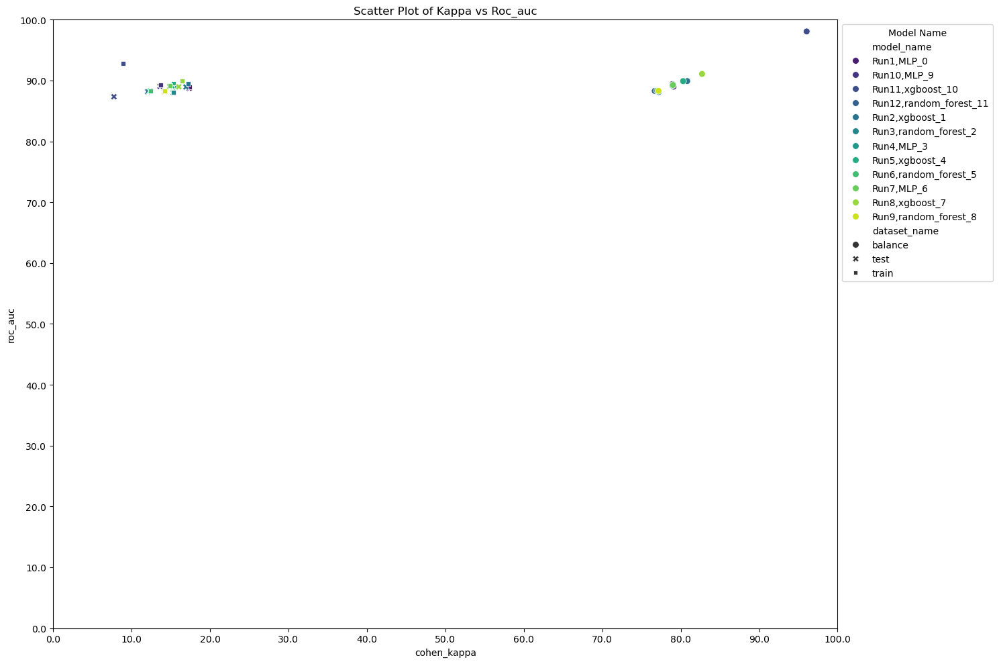

                    INFO     Graficos de desempeños en ['1', '1.0', 1, 1.0] calculadas sobre y         ]8;id=866913;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=928510;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#940\940]8;;\
                             f1-score                                                                              

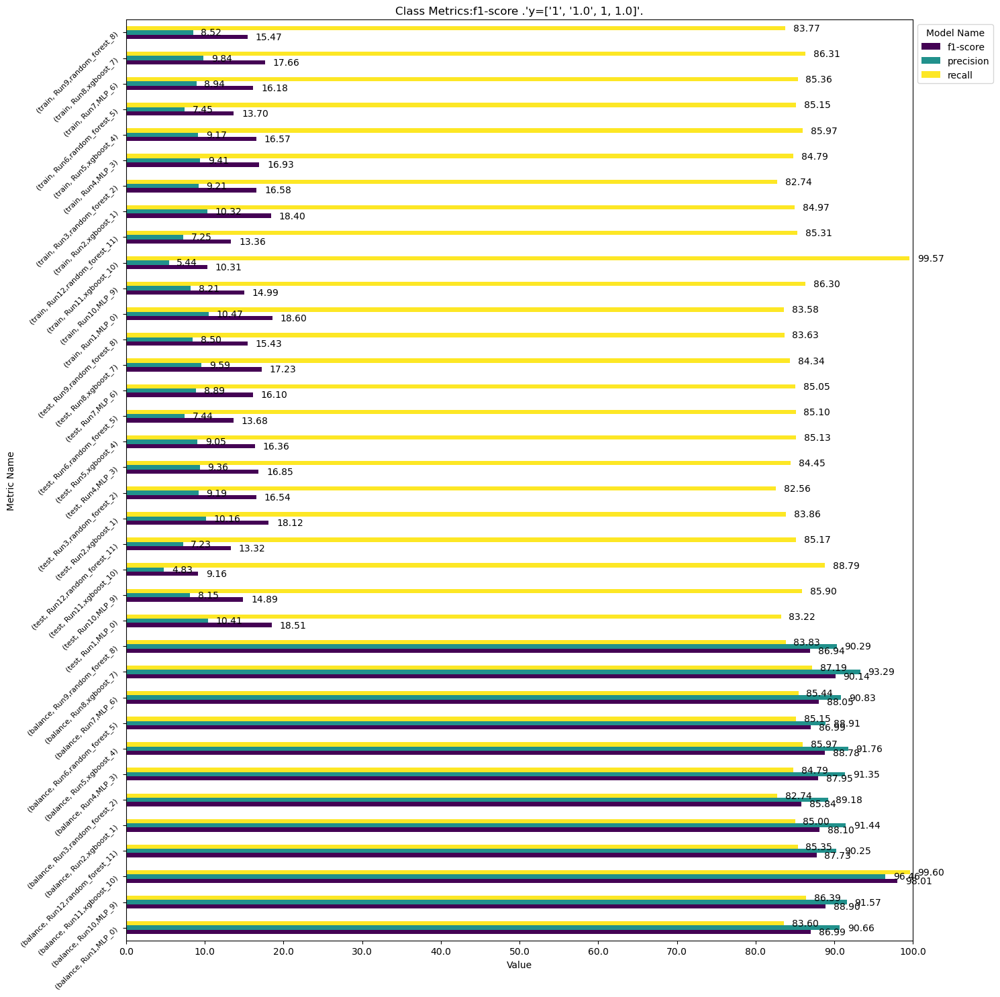

[01/31/25 18:58:07] INFO     Mejores algoritmos por metrica y dataset:                                 ]8;id=824934;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=948697;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#981\981]8;;\

,model_name,dataset_name,metric_name,metric_type,class_name,value
8,"Run1,MLP_0",test,f1-score,class metric,1.0,18.5102
6,"Run1,MLP_0",test,precision,class metric,1.0,10.4132
97,"Run11,xgboost_10",test,recall,class metric,1.0,88.7853
5,"Run1,MLP_0",train,f1-score,class metric,1.0,18.6021
3,"Run1,MLP_0",train,precision,class metric,1.0,10.4657
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.5710


                    INFO     Mejores algoritmos:                                                      ]8;id=720331;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=340832;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#1028\1028]8;;\

,best_model_name,best_unbiased_model,best_fitting_model
model_name,"Run1,MLP_0","Run1,MLP_0","Run6,random_forest_5"
metric_name,f1-score,f1-score,f1-score
metric_type,class metric,class metric,class metric
class_name,1.0,1.0,1.0
test,18.5102,18.5102,13.6771
balance,86.9878,86.9878,86.9927
train,18.6021,18.6021,13.7006
bias,-68.3857,-68.3857,-73.2921
real_bias,True,True,True
test-train,-0.0919,-0.0919,-0.0235


In [11]:
# sin EDA,prueba1, experimento 1
info_temp = models.compare_metrics_models(info_save_all,params)

[01/24/25 16:52:18] INFO     Iniciando la comparacion de metricas sobre las datas generadas en         ]8;id=56164;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=155054;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#891\891]8;;\
                             Model_input:                                                                          

                    INFO     Graficos de desempeños en ['cohen_kappa', 'roc_auc'] calculadas tipo:     ]8;id=405684;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=318831;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#895\895]8;;\
                             ['overall metric']                                                                    

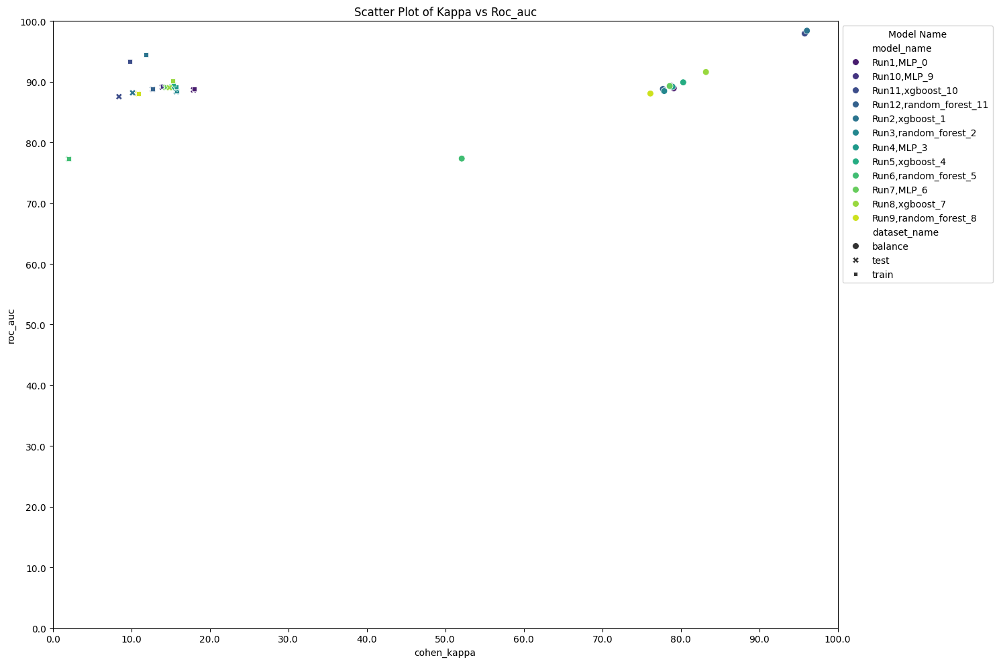

                    INFO     Graficos de desempeños en ['1', '1.0', 1, 1.0] calculadas sobre y         ]8;id=951476;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=186161;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#919\919]8;;\
                             f1-score                                                                              

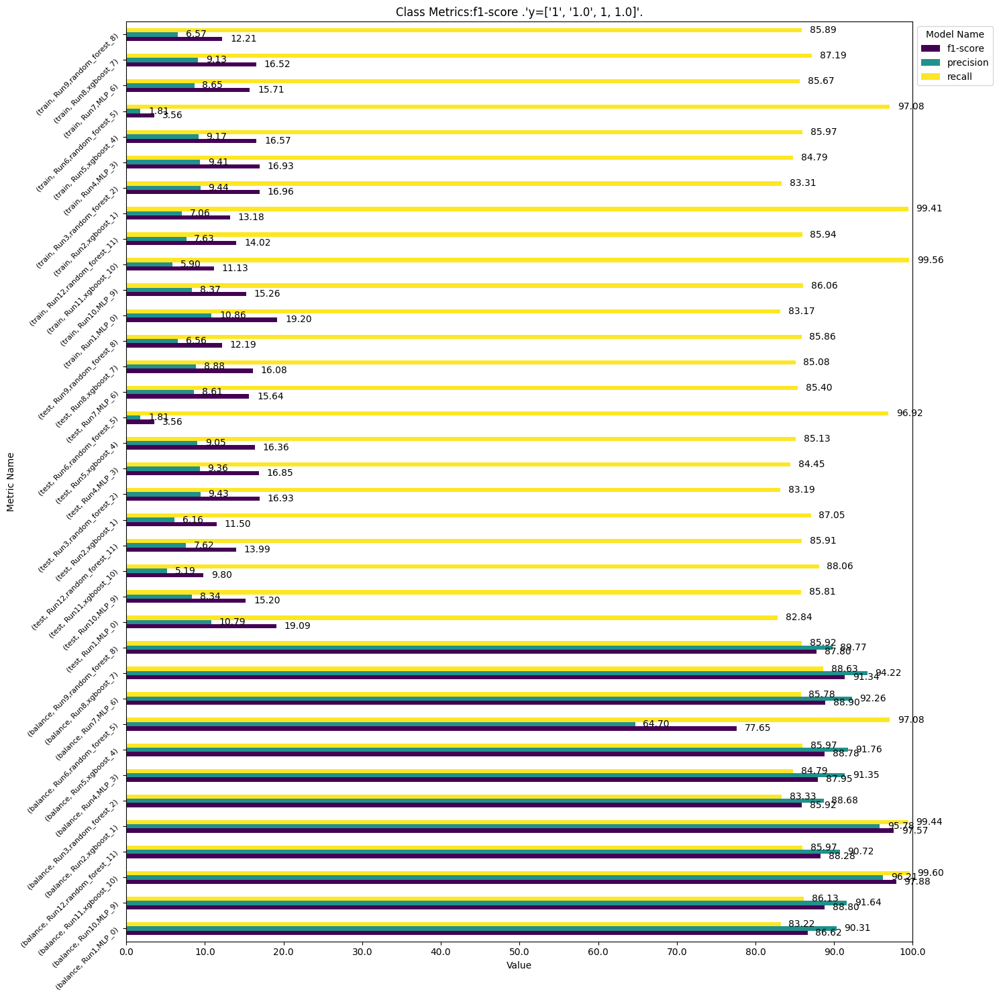

[01/24/25 16:52:19] INFO     Mejores algoritmos por metrica y dataset:                                 ]8;id=448615;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=857936;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#960\960]8;;\

,model_name,dataset_name,metric_name,metric_type,class_name,value
8,"Run1,MLP_0",test,f1-score,class metric,1.0,19.0868
6,"Run1,MLP_0",test,precision,class metric,1.0,10.7860
52,"Run6,random_forest_5",test,recall,class metric,1.0,96.9176
5,"Run1,MLP_0",train,f1-score,class metric,1.0,19.2037
3,"Run1,MLP_0",train,precision,class metric,1.0,10.8550
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.5604


                    INFO     Mejores algoritmos:                                                      ]8;id=149062;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=564499;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#1007\1007]8;;\

,best_model_name,best_unbiased_model,best_fitting_model
model_name,"Run1,MLP_0","Run1,MLP_0","Run6,random_forest_5"
metric_name,f1-score,f1-score,f1-score
metric_type,class metric,class metric,class metric
class_name,1.0,1.0,1.0
test,19.0868,19.0868,3.5561
balance,86.6181,86.6181,77.6461
train,19.2037,19.2037,3.5579
bias,-67.4144,-67.4144,-74.0882
real_bias,True,True,True
test-train,-0.1169,-0.1169,-0.0018


In [9]:
# sin EDA,prueba2, experimento 2
info_temp = models.compare_metrics_models(info_save_all,params)

[01/29/25 13:57:51] INFO     Iniciando la comparacion de metricas sobre las datas generadas en         ]8;id=294992;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=342988;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#891\891]8;;\
                             Model_input:                                                                          

                    INFO     Graficos de desempeños en ['cohen_kappa', 'roc_auc'] calculadas tipo:     ]8;id=365825;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=543595;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#895\895]8;;\
                             ['overall metric']                                                                    

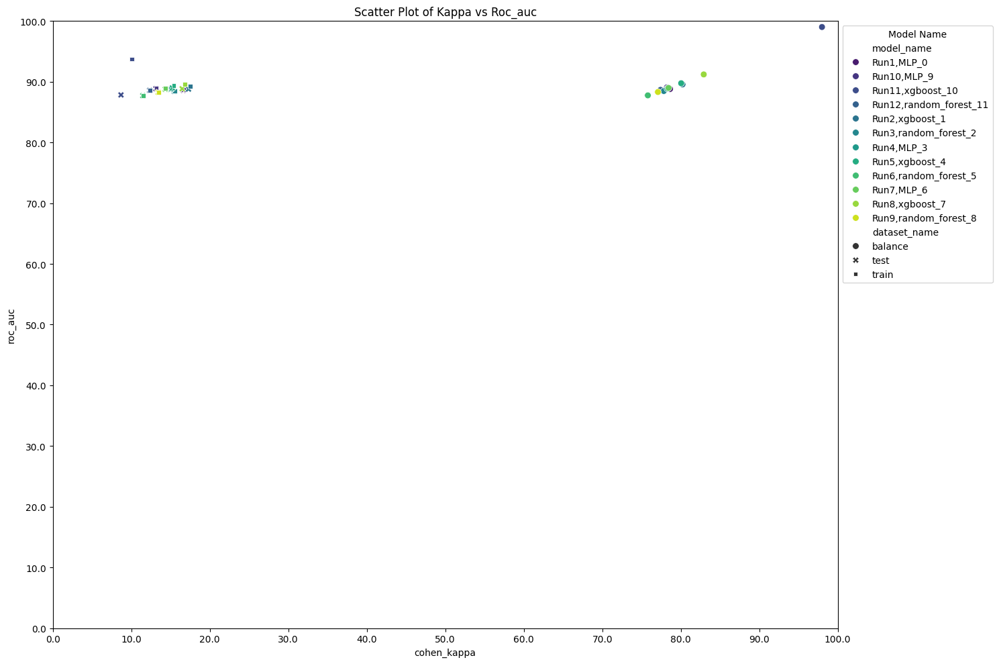

                    INFO     Graficos de desempeños en ['1', '1.0', 1, 1.0] calculadas sobre y         ]8;id=10378;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=159376;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#919\919]8;;\
                             f1-score                                                                              

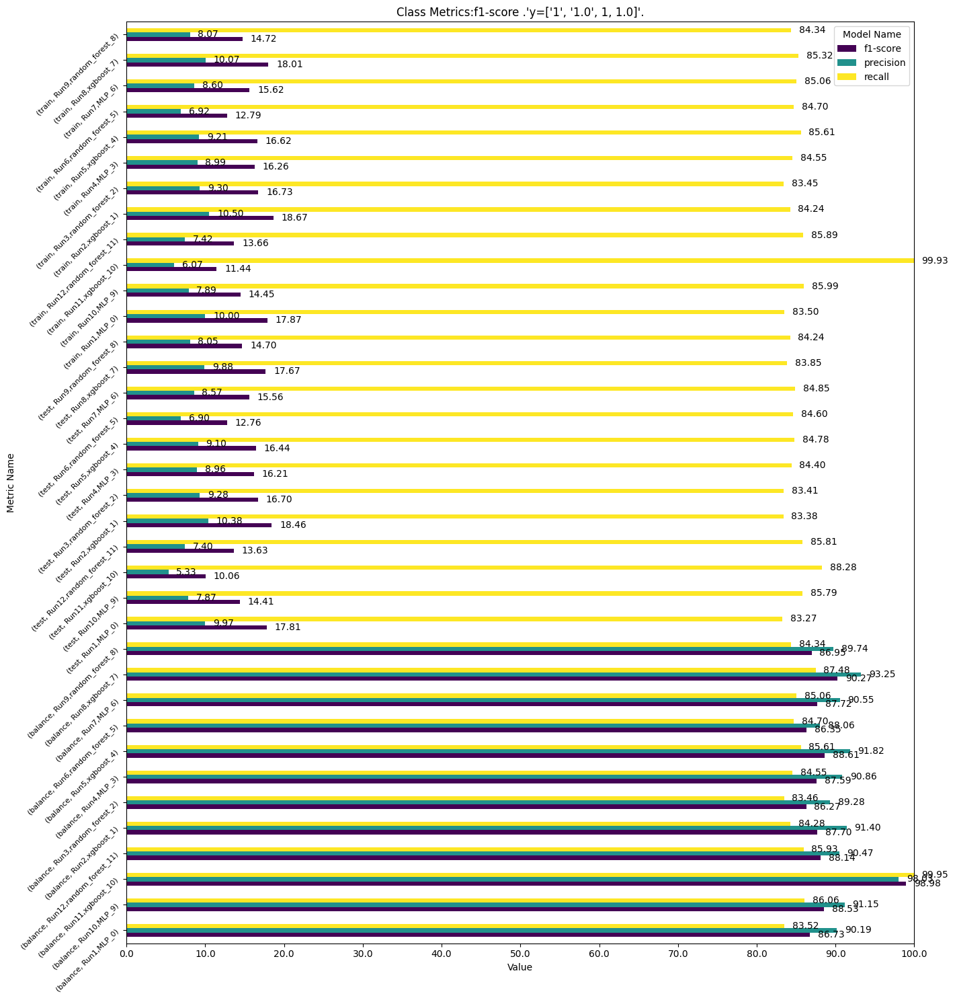

[01/29/25 13:57:52] INFO     Mejores algoritmos por metrica y dataset:                                 ]8;id=671749;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=296801;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#960\960]8;;\

,model_name,dataset_name,metric_name,metric_type,class_name,value
17,"Run2,xgboost_1",test,f1-score,class metric,1.0,18.4554
15,"Run2,xgboost_1",test,precision,class metric,1.0,10.3760
97,"Run11,xgboost_10",test,recall,class metric,1.0,88.2801
14,"Run2,xgboost_1",train,f1-score,class metric,1.0,18.6725
12,"Run2,xgboost_1",train,precision,class metric,1.0,10.5000
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.9349


                    INFO     Mejores algoritmos:                                                      ]8;id=723349;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=652425;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#1007\1007]8;;\

,best_model_name,best_unbiased_model,best_fitting_model
model_name,"Run2,xgboost_1","Run1,MLP_0","Run9,random_forest_8"
metric_name,f1-score,f1-score,f1-score
metric_type,class metric,class metric,class metric
class_name,1.0,1.0,1.0
test,18.4554,17.8142,14.6967
balance,87.6972,86.7258,86.955
train,18.6725,17.8684,14.723
bias,-69.0247,-68.8574,-72.232
real_bias,True,True,True
test-train,-0.2171,-0.0542,-0.0263


In [14]:
# con eda,prueba 3 experimento 1
info_temp = models.compare_metrics_models(info_save_all,params)

[01/30/25 21:31:56] INFO     Iniciando la comparacion de metricas sobre las datas generadas en         ]8;id=56345;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=492856;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#891\891]8;;\
                             Model_input:                                                                          

                    INFO     Graficos de desempeños en ['cohen_kappa', 'roc_auc'] calculadas tipo:     ]8;id=567978;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=974834;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#895\895]8;;\
                             ['overall metric']                                                                    

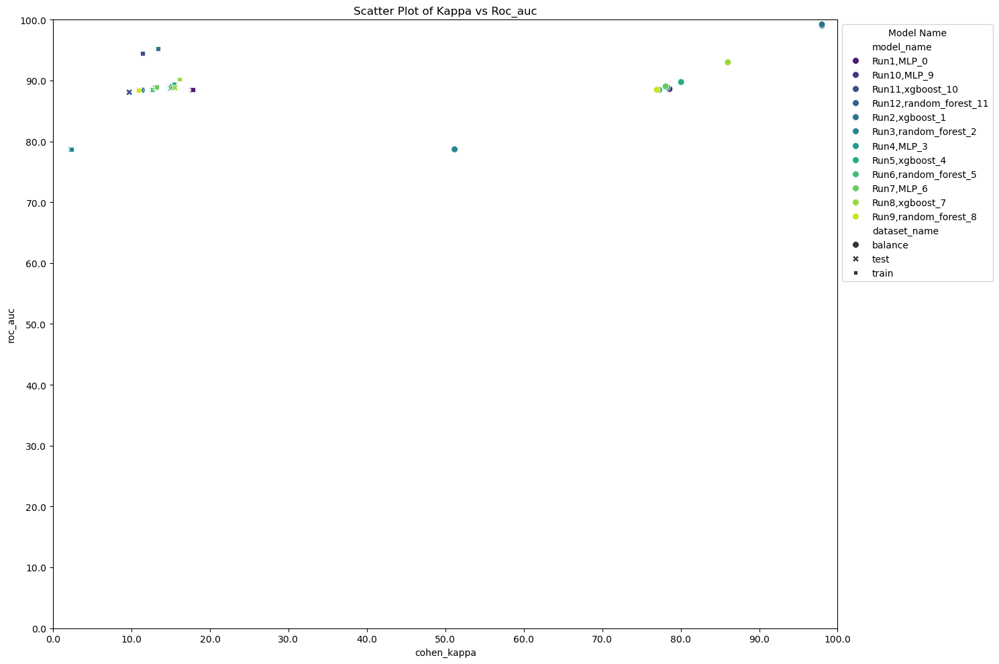

[01/30/25 21:31:57] INFO     Graficos de desempeños en ['1', '1.0', 1, 1.0] calculadas sobre y         ]8;id=180136;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=879054;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#919\919]8;;\
                             f1-score                                                                              

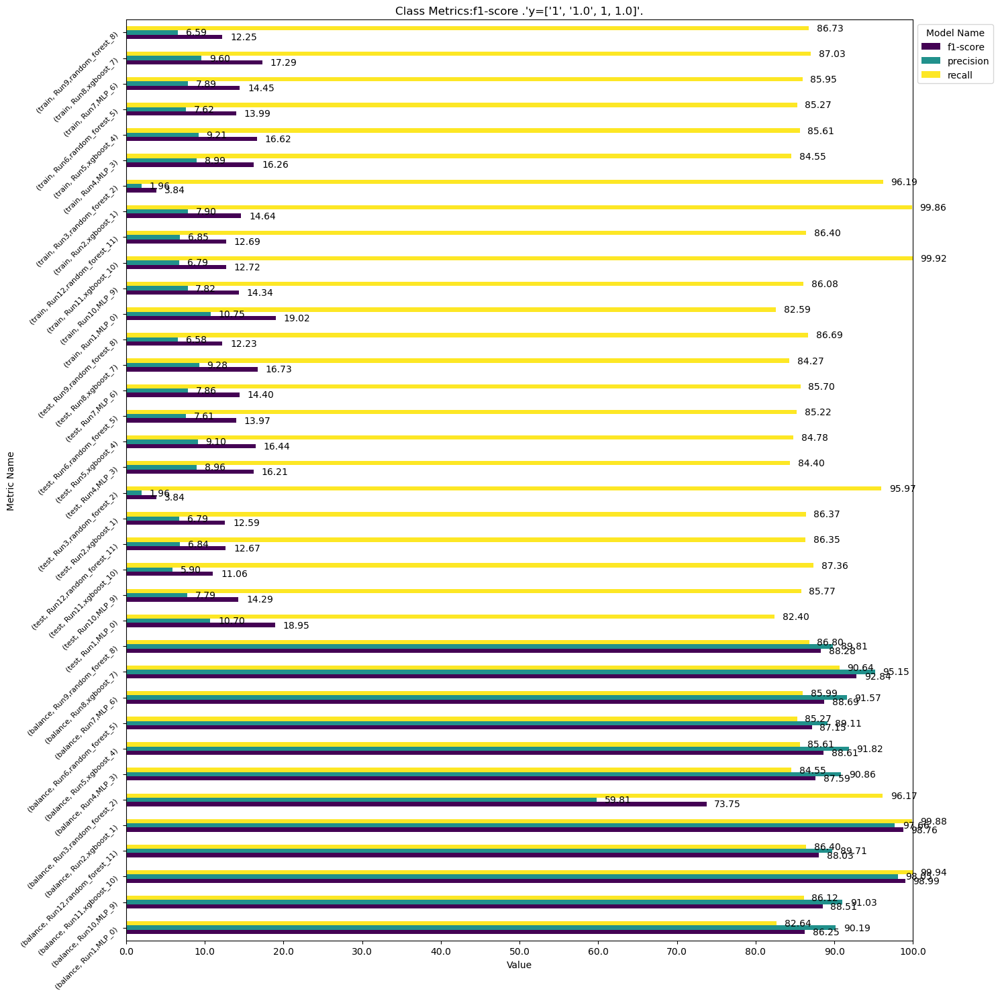

[01/30/25 21:31:58] INFO     Mejores algoritmos por metrica y dataset:                                 ]8;id=638613;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=846238;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#960\960]8;;\

,model_name,dataset_name,metric_name,metric_type,class_name,value
8,"Run1,MLP_0",test,f1-score,class metric,1.0,18.9463
6,"Run1,MLP_0",test,precision,class metric,1.0,10.7037
25,"Run3,random_forest_2",test,recall,class metric,1.0,95.9695
5,"Run1,MLP_0",train,f1-score,class metric,1.0,19.0194
3,"Run1,MLP_0",train,precision,class metric,1.0,10.7471
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.9227


                    INFO     Mejores algoritmos:                                                      ]8;id=398206;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=320307;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#1007\1007]8;;\

,best_model_name,best_unbiased_model,best_fitting_model
model_name,"Run1,MLP_0","Run1,MLP_0","Run3,random_forest_2"
metric_name,f1-score,f1-score,f1-score
metric_type,class metric,class metric,class metric
class_name,1.0,1.0,1.0
test,18.9463,18.9463,3.8417
balance,86.2521,86.2521,73.7526
train,19.0194,19.0194,3.8436
bias,-67.2327,-67.2327,-69.909
real_bias,True,True,True
test-train,-0.0731,-0.0731,-0.0019


In [16]:
# con eda,prueba 4 experimento 2
info_temp = models.compare_metrics_models(info_save_all,params)

In [ ]:
# sin EDA,prueba5, experimento 3
info_temp = models.compare_metrics_models(info_save_all,params)

[02/03/25 13:59:16] INFO     Iniciando la comparacion de metricas sobre las datas generadas en         ]8;id=201917;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=334317;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#912\912]8;;\
                             Model_input:                                                                          

                    INFO     Graficos de desempeños en ['cohen_kappa', 'roc_auc'] calculadas tipo:     ]8;id=145730;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=929238;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#916\916]8;;\
                             ['overall metric']                                                                    

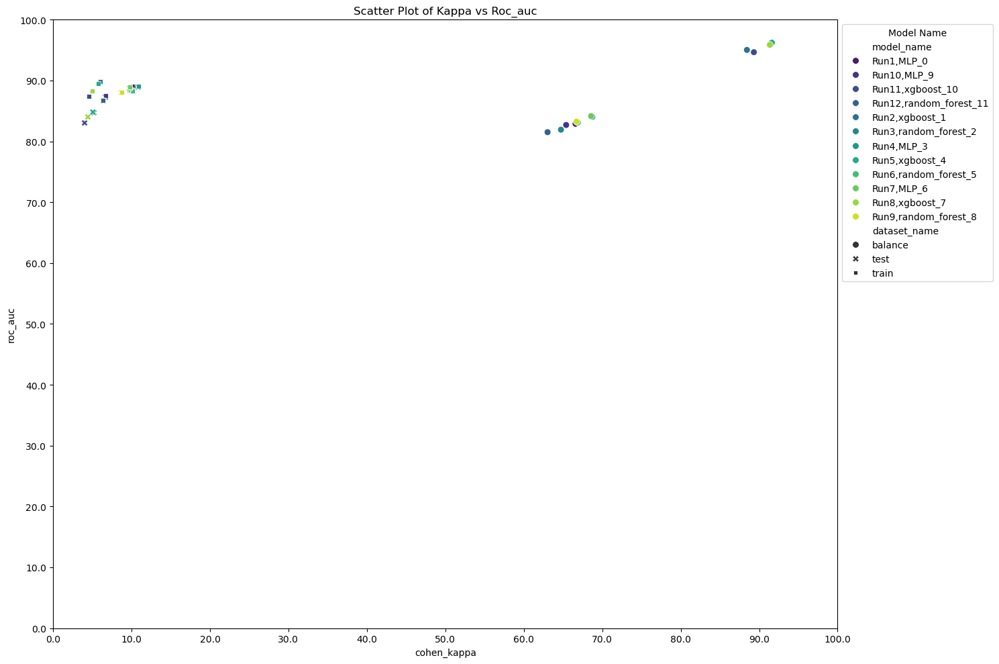

                    INFO     Graficos de desempeños en ['1', '1.0', 1, 1.0] calculadas sobre y         ]8;id=978682;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=287370;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#940\940]8;;\
                             f1-score                                                                              

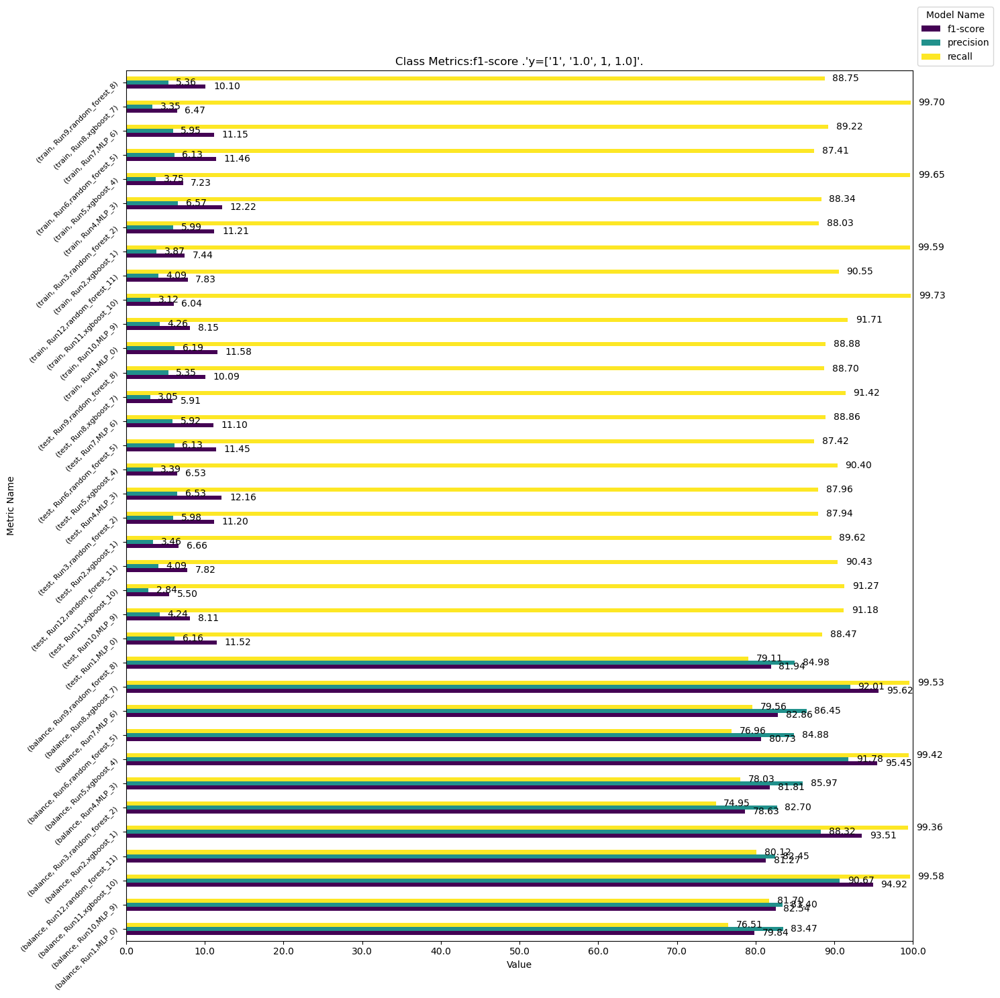

[02/03/25 13:59:17] INFO     Mejores algoritmos por metrica y dataset:                                 ]8;id=642009;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=917889;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#981\981]8;;\

,model_name,dataset_name,metric_name,metric_type,class_name,value
35,"Run4,MLP_3",test,f1-score,class metric,1.0,12.1598
33,"Run4,MLP_3",test,precision,class metric,1.0,6.5313
70,"Run8,xgboost_7",test,recall,class metric,1.0,91.4248
32,"Run4,MLP_3",train,f1-score,class metric,1.0,12.2229
30,"Run4,MLP_3",train,precision,class metric,1.0,6.5657
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.7329


                    INFO     Mejores algoritmos:                                                      ]8;id=378345;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py\nodes.py]8;;\:]8;id=21499;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/models/nodes.py#1028\1028]8;;\

,best_model_name,best_unbiased_model,best_fitting_model
model_name,"Run4,MLP_3","Run3,random_forest_2","Run6,random_forest_5"
metric_name,f1-score,f1-score,f1-score
metric_type,class metric,class metric,class metric
class_name,1.0,1.0,1.0
test,12.1598,11.1962,11.454
balance,81.8116,78.6333,80.7285
train,12.2229,11.2144,11.4575
bias,-69.5887,-67.4189,-69.271
real_bias,True,True,True
test-train,-0.0631,-0.0182,-0.0035


In [17]:
# sin EDA,prueba6, experimento 4
info_temp = models.compare_metrics_models(info_save_all,params)

In [57]:
# sin EDA, experimento 1, prueba 1
pct = 0.65
df = info_save_all['all_results']
df = df[df["metric_name"] == "f1-score"]
df = df[df["class_name"].isin(["1","1.0",1])]
df['value'] = df['value'].astype(float)
df_metrics_train = df[df['dataset_name']=='train'].sort_values(by ='value', ascending = False)
df_metrics_test = df[df['dataset_name']=='test'].sort_values(by ='value', ascending = False)
df_metrics_train = df_metrics_train.iloc[:int(df_metrics_train.shape[0]*pct)].sort_values(by = "value", ascending = False)
df_metrics_test = df_metrics_test.iloc[:int(df_metrics_test.shape[0]*pct)].sort_values(by = "value", ascending = False)
ensamble = []
names = []
for model_name in df_metrics_test['model_name']:
    if model_name in df_metrics_train['model_name'].values:
        names.append(model_name)
        ensamble.append(int(model_name.split(",")[0][3:]))
ensambles = sorted(ensamble)
ensamble = ["Run"+str(i) for i in ensambles]
weightss = [1]*len(ensamble)
print(ensamble)
print(weightss)
print('Total de modelo: ',np.sum(weightss))
display(df_metrics_test[df_metrics_test['model_name'].isin(names)])
display(df_metrics_train[df_metrics_train['model_name'].isin(names)])
info_save_all['best_model_metrics_dataset']

['Run1', 'Run2', 'Run3', 'Run4', 'Run5', 'Run8']
[1, 1, 1, 1, 1, 1]
Total de modelo:  6


,model_name,dataset_name,metric_name,metric_type,class_name,value
16,"Run1,MLP_0",test,f1-score,class metric,1.0,18.5102
16,"Run2,xgboost_1",test,f1-score,class metric,1.0,18.1227
16,"Run8,xgboost_7",test,f1-score,class metric,1.0,17.2252
16,"Run4,MLP_3",test,f1-score,class metric,1.0,16.8493
16,"Run3,random_forest_2",test,f1-score,class metric,1.0,16.5426
16,"Run5,xgboost_4",test,f1-score,class metric,1.0,16.3626


,model_name,dataset_name,metric_name,metric_type,class_name,value
16,"Run1,MLP_0",train,f1-score,class metric,1.0,18.6021
16,"Run2,xgboost_1",train,f1-score,class metric,1.0,18.4026
16,"Run8,xgboost_7",train,f1-score,class metric,1.0,17.6612
16,"Run4,MLP_3",train,f1-score,class metric,1.0,16.9345
16,"Run3,random_forest_2",train,f1-score,class metric,1.0,16.5829
16,"Run5,xgboost_4",train,f1-score,class metric,1.0,16.5709


,model_name,dataset_name,metric_name,metric_type,class_name,value
8,"Run1,MLP_0",test,f1-score,class metric,1.0,18.5102
6,"Run1,MLP_0",test,precision,class metric,1.0,10.4132
97,"Run11,xgboost_10",test,recall,class metric,1.0,88.7853
5,"Run1,MLP_0",train,f1-score,class metric,1.0,18.6021
3,"Run1,MLP_0",train,precision,class metric,1.0,10.4657
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.5710


In [12]:
# sin eda, prueba1, experimento 1 (Mayor Rango)
pct = 0.8
df = info_save_all['all_results']
df = df[df["metric_name"] == "f1-score"]
df = df[df["class_name"].isin(["1","1.0",1])]
df['value'] = df['value'].astype(float)
df_metrics_train = df[df['dataset_name']=='train'].sort_values(by ='value', ascending = False)
df_metrics_test = df[df['dataset_name']=='test'].sort_values(by ='value', ascending = False)
df_metrics_train = df_metrics_train.iloc[:int(df_metrics_train.shape[0]*pct)].sort_values(by = "value", ascending = False)
df_metrics_test = df_metrics_test.iloc[:int(df_metrics_test.shape[0]*pct)].sort_values(by = "value", ascending = False)
ensamble = []
names = []
for model_name in df_metrics_test['model_name']:
    if model_name in df_metrics_train['model_name'].values:
        names.append(model_name)
        ensamble.append(int(model_name.split(",")[0][3:]))
ensambles = sorted(ensamble)
ensamble = ["Run"+str(i) for i in ensambles]
weightss = [1]*len(ensamble)
print(ensamble)
print(weightss)
print('Total de modelo: ',np.sum(weightss))
display(df_metrics_test[df_metrics_test['model_name'].isin(names)])
display(df_metrics_train[df_metrics_train['model_name'].isin(names)])
info_save_all['best_model_metrics_dataset']

['Run1', 'Run2', 'Run3', 'Run4', 'Run5', 'Run7', 'Run8', 'Run9', 'Run10']
[1, 1, 1, 1, 1, 1, 1, 1, 1]
Total de modelo:  9


,model_name,dataset_name,metric_name,metric_type,class_name,value
16,"Run1,MLP_0",test,f1-score,class metric,1.0,18.5102
16,"Run2,xgboost_1",test,f1-score,class metric,1.0,18.1227
16,"Run8,xgboost_7",test,f1-score,class metric,1.0,17.2252
16,"Run4,MLP_3",test,f1-score,class metric,1.0,16.8493
16,"Run3,random_forest_2",test,f1-score,class metric,1.0,16.5426
16,"Run5,xgboost_4",test,f1-score,class metric,1.0,16.3626
16,"Run7,MLP_6",test,f1-score,class metric,1.0,16.0982
16,"Run9,random_forest_8",test,f1-score,class metric,1.0,15.4308
16,"Run10,MLP_9",test,f1-score,class metric,1.0,14.8900


,model_name,dataset_name,metric_name,metric_type,class_name,value
16,"Run1,MLP_0",train,f1-score,class metric,1.0,18.6021
16,"Run2,xgboost_1",train,f1-score,class metric,1.0,18.4026
16,"Run8,xgboost_7",train,f1-score,class metric,1.0,17.6612
16,"Run4,MLP_3",train,f1-score,class metric,1.0,16.9345
16,"Run3,random_forest_2",train,f1-score,class metric,1.0,16.5829
16,"Run5,xgboost_4",train,f1-score,class metric,1.0,16.5709
16,"Run7,MLP_6",train,f1-score,class metric,1.0,16.1776
16,"Run9,random_forest_8",train,f1-score,class metric,1.0,15.4697
16,"Run10,MLP_9",train,f1-score,class metric,1.0,14.9859


,model_name,dataset_name,metric_name,metric_type,class_name,value
8,"Run1,MLP_0",test,f1-score,class metric,1.0,18.5102
6,"Run1,MLP_0",test,precision,class metric,1.0,10.4132
97,"Run11,xgboost_10",test,recall,class metric,1.0,88.7853
5,"Run1,MLP_0",train,f1-score,class metric,1.0,18.6021
3,"Run1,MLP_0",train,precision,class metric,1.0,10.4657
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.5710


In [10]:
# sin EDA, experimento 2, prueba 2
pct = 0.58
df = info_save_all['all_results']
df = df[df["metric_name"] == "f1-score"]
df = df[df["class_name"].isin(["1","1.0",1])]
df['value'] = df['value'].astype(float)
df_metrics_train = df[df['dataset_name']=='train'].sort_values(by ='value', ascending = False)
df_metrics_test = df[df['dataset_name']=='test'].sort_values(by ='value', ascending = False)
df_metrics_train = df_metrics_train.iloc[:int(df_metrics_train.shape[0]*pct)].sort_values(by = "value", ascending = False)
df_metrics_test = df_metrics_test.iloc[:int(df_metrics_test.shape[0]*pct)].sort_values(by = "value", ascending = False)
ensamble = []
names = []
for model_name in df_metrics_test['model_name']:
    if model_name in df_metrics_train['model_name'].values:
        names.append(model_name)
        ensamble.append(int(model_name.split(",")[0][3:]))
ensambles = sorted(ensamble)
ensamble = ["Run"+str(i) for i in ensambles]
weightss = [1]*len(ensamble)
print(ensamble)
print(weightss)
print('Total de modelo: ',np.sum(weightss))
display(df_metrics_test[df_metrics_test['model_name'].isin(names)])
display(df_metrics_train[df_metrics_train['model_name'].isin(names)])
info_save_all['best_model_metrics_dataset']

['Run1', 'Run3', 'Run4', 'Run5', 'Run7', 'Run8']
[1, 1, 1, 1, 1, 1]
Total de modelo:  6


,model_name,dataset_name,metric_name,metric_type,class_name,value
16,"Run1,MLP_0",test,f1-score,class metric,1.0,19.0868
16,"Run3,random_forest_2",test,f1-score,class metric,1.0,16.9317
16,"Run4,MLP_3",test,f1-score,class metric,1.0,16.8493
16,"Run5,xgboost_4",test,f1-score,class metric,1.0,16.3626
16,"Run8,xgboost_7",test,f1-score,class metric,1.0,16.0848
16,"Run7,MLP_6",test,f1-score,class metric,1.0,15.6398


,model_name,dataset_name,metric_name,metric_type,class_name,value
16,"Run1,MLP_0",train,f1-score,class metric,1.0,19.2037
16,"Run3,random_forest_2",train,f1-score,class metric,1.0,16.9618
16,"Run4,MLP_3",train,f1-score,class metric,1.0,16.9345
16,"Run5,xgboost_4",train,f1-score,class metric,1.0,16.5709
16,"Run8,xgboost_7",train,f1-score,class metric,1.0,16.5229
16,"Run7,MLP_6",train,f1-score,class metric,1.0,15.7068


,model_name,dataset_name,metric_name,metric_type,class_name,value
8,"Run1,MLP_0",test,f1-score,class metric,1.0,19.0868
6,"Run1,MLP_0",test,precision,class metric,1.0,10.7860
52,"Run6,random_forest_5",test,recall,class metric,1.0,96.9176
5,"Run1,MLP_0",train,f1-score,class metric,1.0,19.2037
3,"Run1,MLP_0",train,precision,class metric,1.0,10.8550
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.5604


In [15]:
# con eda,prueba3, experimento 1
pct = 0.58
df = info_save_all['all_results']
df = df[df["metric_name"] == "f1-score"]
df = df[df["class_name"].isin(["1","1.0",1])]
df['value'] = df['value'].astype(float)
df_metrics_train = df[df['dataset_name']=='train'].sort_values(by ='value', ascending = False)
df_metrics_test = df[df['dataset_name']=='test'].sort_values(by ='value', ascending = False)
df_metrics_train = df_metrics_train.iloc[:int(df_metrics_train.shape[0]*pct)].sort_values(by = "value", ascending = False)
df_metrics_test = df_metrics_test.iloc[:int(df_metrics_test.shape[0]*pct)].sort_values(by = "value", ascending = False)
ensamble = []
names = []
for model_name in df_metrics_test['model_name']:
    if model_name in df_metrics_train['model_name'].values:
        names.append(model_name)
        ensamble.append(int(model_name.split(",")[0][3:]))
ensambles = sorted(ensamble)
ensamble = ["Run"+str(i) for i in ensambles]
weightss = [1]*len(ensamble)
print(ensamble)
print(weightss)
print('Total de modelo: ',np.sum(weightss))
display(df_metrics_test[df_metrics_test['model_name'].isin(names)])
display(df_metrics_train[df_metrics_train['model_name'].isin(names)])
info_save_all['best_model_metrics_dataset']

['Run1', 'Run2', 'Run3', 'Run4', 'Run5', 'Run8']
[1, 1, 1, 1, 1, 1]
Total de modelo:  6


,model_name,dataset_name,metric_name,metric_type,class_name,value
16,"Run2,xgboost_1",test,f1-score,class metric,1.0,18.4554
16,"Run1,MLP_0",test,f1-score,class metric,1.0,17.8142
16,"Run8,xgboost_7",test,f1-score,class metric,1.0,17.6697
16,"Run3,random_forest_2",test,f1-score,class metric,1.0,16.6974
16,"Run5,xgboost_4",test,f1-score,class metric,1.0,16.4426
16,"Run4,MLP_3",test,f1-score,class metric,1.0,16.2059


,model_name,dataset_name,metric_name,metric_type,class_name,value
16,"Run2,xgboost_1",train,f1-score,class metric,1.0,18.6725
16,"Run8,xgboost_7",train,f1-score,class metric,1.0,18.0061
16,"Run1,MLP_0",train,f1-score,class metric,1.0,17.8684
16,"Run3,random_forest_2",train,f1-score,class metric,1.0,16.7289
16,"Run5,xgboost_4",train,f1-score,class metric,1.0,16.6242
16,"Run4,MLP_3",train,f1-score,class metric,1.0,16.2555


,model_name,dataset_name,metric_name,metric_type,class_name,value
17,"Run2,xgboost_1",test,f1-score,class metric,1.0,18.4554
15,"Run2,xgboost_1",test,precision,class metric,1.0,10.3760
97,"Run11,xgboost_10",test,recall,class metric,1.0,88.2801
14,"Run2,xgboost_1",train,f1-score,class metric,1.0,18.6725
12,"Run2,xgboost_1",train,precision,class metric,1.0,10.5000
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.9349


In [18]:
# con eda,prueba4, experimento 2
pct = 0.6
df = info_save_all['all_results']
df = df[df["metric_name"] == "f1-score"]
df = df[df["class_name"].isin(["1","1.0",1])]
df['value'] = df['value'].astype(float)
df_metrics_train = df[df['dataset_name']=='train'].sort_values(by ='value', ascending = False)
df_metrics_test = df[df['dataset_name']=='test'].sort_values(by ='value', ascending = False)
df_metrics_train = df_metrics_train.iloc[:int(df_metrics_train.shape[0]*pct)].sort_values(by = "value", ascending = False)
df_metrics_test = df_metrics_test.iloc[:int(df_metrics_test.shape[0]*pct)].sort_values(by = "value", ascending = False)
ensamble = []
names = []
for model_name in df_metrics_test['model_name']:
    if model_name in df_metrics_train['model_name'].values:
        names.append(model_name)
        ensamble.append(int(model_name.split(",")[0][3:]))
ensambles = sorted(ensamble)
ensamble = ["Run"+str(i) for i in ensambles]
weightss = [1]*len(ensamble)
print(ensamble)
print(weightss)
print('Total de modelo: ',np.sum(weightss))
display(df_metrics_test[df_metrics_test['model_name'].isin(names)])
display(df_metrics_train[df_metrics_train['model_name'].isin(names)])
info_save_all['best_model_metrics_dataset']

['Run1', 'Run4', 'Run5', 'Run7', 'Run8', 'Run10']
[1, 1, 1, 1, 1, 1]
Total de modelo:  6


,model_name,dataset_name,metric_name,metric_type,class_name,value
16,"Run1,MLP_0",test,f1-score,class metric,1.0,18.9463
16,"Run8,xgboost_7",test,f1-score,class metric,1.0,16.7265
16,"Run5,xgboost_4",test,f1-score,class metric,1.0,16.4426
16,"Run4,MLP_3",test,f1-score,class metric,1.0,16.2059
16,"Run7,MLP_6",test,f1-score,class metric,1.0,14.4017
16,"Run10,MLP_9",test,f1-score,class metric,1.0,14.2871


,model_name,dataset_name,metric_name,metric_type,class_name,value
16,"Run1,MLP_0",train,f1-score,class metric,1.0,19.0194
16,"Run8,xgboost_7",train,f1-score,class metric,1.0,17.2930
16,"Run5,xgboost_4",train,f1-score,class metric,1.0,16.6242
16,"Run4,MLP_3",train,f1-score,class metric,1.0,16.2555
16,"Run7,MLP_6",train,f1-score,class metric,1.0,14.4529
16,"Run10,MLP_9",train,f1-score,class metric,1.0,14.3429


,model_name,dataset_name,metric_name,metric_type,class_name,value
8,"Run1,MLP_0",test,f1-score,class metric,1.0,18.9463
6,"Run1,MLP_0",test,precision,class metric,1.0,10.7037
25,"Run3,random_forest_2",test,recall,class metric,1.0,95.9695
5,"Run1,MLP_0",train,f1-score,class metric,1.0,19.0194
3,"Run1,MLP_0",train,precision,class metric,1.0,10.7471
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.9227


In [ ]:
# sin EDA, experimento 3, prueba 5
pct = 0.65
df = info_save_all['all_results']
df = df[df["metric_name"] == "f1-score"]
df = df[df["class_name"].isin(["1","1.0",1])]
df['value'] = df['value'].astype(float)
df_metrics_train = df[df['dataset_name']=='train'].sort_values(by ='value', ascending = False)
df_metrics_test = df[df['dataset_name']=='test'].sort_values(by ='value', ascending = False)
df_metrics_train = df_metrics_train.iloc[:int(df_metrics_train.shape[0]*pct)].sort_values(by = "value", ascending = False)
df_metrics_test = df_metrics_test.iloc[:int(df_metrics_test.shape[0]*pct)].sort_values(by = "value", ascending = False)
ensamble = []
names = []
for model_name in df_metrics_test['model_name']:
    if model_name in df_metrics_train['model_name'].values:
        names.append(model_name)
        ensamble.append(int(model_name.split(",")[0][3:]))
ensambles = sorted(ensamble)
ensamble = ["Run"+str(i) for i in ensambles]
weightss = [1]*len(ensamble)
print(ensamble)
print(weightss)
print('Total de modelo: ',np.sum(weightss))
display(df_metrics_test[df_metrics_test['model_name'].isin(names)])
display(df_metrics_train[df_metrics_train['model_name'].isin(names)])
info_save_all['best_model_metrics_dataset']

In [20]:
# sin EDA, experimento 4, prueba 6
pct = 0.58
df = info_save_all['all_results']
df = df[df["metric_name"] == "f1-score"]
df = df[df["class_name"].isin(["1","1.0",1])]
df['value'] = df['value'].astype(float)
df_metrics_train = df[df['dataset_name']=='train'].sort_values(by ='value', ascending = False)
df_metrics_test = df[df['dataset_name']=='test'].sort_values(by ='value', ascending = False)
df_metrics_train = df_metrics_train.iloc[:int(df_metrics_train.shape[0]*pct)].sort_values(by = "value", ascending = False)
df_metrics_test = df_metrics_test.iloc[:int(df_metrics_test.shape[0]*pct)].sort_values(by = "value", ascending = False)
ensamble = []
names = []
for model_name in df_metrics_test['model_name']:
    if model_name in df_metrics_train['model_name'].values:
        names.append(model_name)
        ensamble.append(int(model_name.split(",")[0][3:]))
ensambles = sorted(ensamble)
ensamble = ["Run"+str(i) for i in ensambles]
weightss = [1]*len(ensamble)
print(ensamble)
print(weightss)
print('Total de modelo: ',np.sum(weightss))
display(df_metrics_test[df_metrics_test['model_name'].isin(names)])
display(df_metrics_train[df_metrics_train['model_name'].isin(names)])
info_save_all['best_model_metrics_dataset']

['Run1', 'Run3', 'Run4', 'Run6', 'Run7', 'Run9']
[1, 1, 1, 1, 1, 1]
Total de modelo:  6


,model_name,dataset_name,metric_name,metric_type,class_name,value
16,"Run4,MLP_3",test,f1-score,class metric,1.0,12.1598
16,"Run1,MLP_0",test,f1-score,class metric,1.0,11.5246
16,"Run6,random_forest_5",test,f1-score,class metric,1.0,11.4540
16,"Run3,random_forest_2",test,f1-score,class metric,1.0,11.1962
16,"Run7,MLP_6",test,f1-score,class metric,1.0,11.0981
16,"Run9,random_forest_8",test,f1-score,class metric,1.0,10.0912


,model_name,dataset_name,metric_name,metric_type,class_name,value
16,"Run4,MLP_3",train,f1-score,class metric,1.0,12.2229
16,"Run1,MLP_0",train,f1-score,class metric,1.0,11.5785
16,"Run6,random_forest_5",train,f1-score,class metric,1.0,11.4575
16,"Run3,random_forest_2",train,f1-score,class metric,1.0,11.2144
16,"Run7,MLP_6",train,f1-score,class metric,1.0,11.1501
16,"Run9,random_forest_8",train,f1-score,class metric,1.0,10.1009


,model_name,dataset_name,metric_name,metric_type,class_name,value
35,"Run4,MLP_3",test,f1-score,class metric,1.0,12.1598
33,"Run4,MLP_3",test,precision,class metric,1.0,6.5313
70,"Run8,xgboost_7",test,recall,class metric,1.0,91.4248
32,"Run4,MLP_3",train,f1-score,class metric,1.0,12.2229
30,"Run4,MLP_3",train,precision,class metric,1.0,6.5657
94,"Run11,xgboost_10",train,recall,class metric,1.0,99.7329


## model_selection

In [17]:
## algoritmo anterior

In [10]:
info_save_select_ini = catalog.load('info_save_select_anterior') 
print('Run_name: ',info_save_select_ini['modelo_produccion']['nodos_select'])
print('W: ',info_save_select_ini['modelo_produccion']['weights'])

Run_name:  [0, 1, 2, 3, 5, 6, 7, 10, 11]
W:  [2, 1, 2, 1, 1, 2, 1, 1, 0]


In [101]:
check_df = info_save_select_ini['select_model2']
check_df = check_df[np.in1d(check_df.index.get_level_values(1),['backtest','recall n_top','Precision  n_top','f1-score n_top'])].reset_index() 
check_df = check_df[check_df['class_name'].isin([1,1.0,'1','1.0'])]
check_df = check_df.set_index(['metric_name','dataset_name','class_name','select_model','name_model']).sort_index()
check_df

value  \
metric_name    dataset_name class_name select_model        name_model                               
backtest       test         1          best_fitting_model  Run5                           15.4502   
                                       best_model_name     Run1                            16.538   
                                       best_unbiased_model Run1                            16.538   
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]  16.6032   
               train        1          best_fitting_model  Run5                           15.5498   
                                       best_model_name     Run1                           16.7692   
                                       best_unbiased_model Run1                           16.7692   
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]  17.1364   
f1-score n_top test         1          best_fitting_model  Run5                           26.7651   
                                       best_model_name     Run1                           28.3822   
                                       best_unbiased_model Run1                           28.3822   
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]  28.4781   
               train        1          best_fitting_model  Run5                           26.9145   
                                       best_model_name     Run1                            28.722   
                                       best_unbiased_model Run1                            28.722   
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]  29.2589   
recall n_top   test         1          best_fitting_model  Run5                             100.0   
                                       best_model_name     Run1                             100.0   
                                       best_unbiased_model Run1                             100.0   
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]    100.0   
               train        1          best_fitting_model  Run5                             100.0   
                                       best_model_name     Run1                             100.0   
                                       best_unbiased_model Run1                             100.0   
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]    100.0   

                                                                                               model_name  
metric_name    dataset_name class_name select_model        name_model                                      
backtest       test         1          best_fitting_model  Run5                           random_forest_4  
                                       best_model_name     Run1                                     MLP_0  
                                       best_unbiased_model Run1                                     MLP_0  
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]         Ensamble  
               train        1          best_fitting_model  Run5                           random_forest_4  
                                       best_model_name     Run1                                     MLP_0  
                                       best_unbiased_model Run1                                     MLP_0  
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]         Ensamble  
f1-score n_top test         1          best_fitting_model  Run5                           random_forest_4  
                                       best_model_name     Run1                                     MLP_0  
                                       best_unbiased_model Run1                                     MLP_0  
                                       modelo_produccion   [0

In [ ]:
info_save_select_mvp2 = catalog.load('info_save_select_mvp2') # best model unico

In [ ]:
check_df_mvp2 = info_save_select_mvp2['select_model2']
check_df_mvp2 = check_df_mvp2[np.in1d(check_df_mvp2.index.get_level_values(1),['backtest'])].reset_index() 
check_df_mvp2 = check_df_mvp2.set_index(['select_model','name_model','dataset_name','class_name']).sort_index()
check_df_mvp2

In [21]:
params['Ensamble']['want'] = True
params['optimizacion_bayesiana']['want'] = False
params['Ensamble']['Algoritmos'] = ensamble
params['Ensamble']['weights'] = weightss

In [22]:
params['n_obs_filter']

0.3

In [23]:
params['use_key']

{'want': False, 'llave': ['Run10,xgboost_9'], 'estrategia': ['best_model_name']}

In [24]:
params['Ensamble']


{
    'want': True,
    'Algoritmos': ['Run1', 'Run3', 'Run4', 'Run6', 'Run7', 'Run9'],
    'weights': [1, 1, 1, 1, 1, 1],
    'scorer': 'backtest_scorer'
}

In [25]:
info_save_temp=ms.generate_modelo_produccion(info_save_all, params)

[02/03/25 14:01:53] INFO     Iniciando el Ensamblado de modelos...                                     ]8;id=76810;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=71819;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#747\747]8;;\

                    INFO     train                                                                     ]8;id=470725;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=725477;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#707\707]8;;\

                    INFO     Nodo 0, Run1                                                              ]8;id=221067;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=765654;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#660\660]8;;\

[02/03/25 14:02:05] INFO     Nodo 2, Run3                                                              ]8;id=988145;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=106213;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#660\660]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:   25.0s
[Parallel(n_jobs=64)]: Done 672 tasks      | elapsed:   49.1s
[Parallel(n_jobs=64)]: Done 900 out of 900 | elapsed:  1.1min finished


[02/03/25 14:03:12] INFO     Nodo 3, Run4                                                              ]8;id=226172;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=71792;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#660\660]8;;\

[02/03/25 14:03:29] INFO     Nodo 5, Run6                                                              ]8;id=900129;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=564166;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#660\660]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  74 out of 100 | elapsed:    7.2s remaining:    2.5s
[Parallel(n_jobs=64)]: Done 100 out of 100 | elapsed:    8.9s finished


[02/03/25 14:03:40] INFO     Nodo 6, Run7                                                              ]8;id=176411;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=20451;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#660\660]8;;\

[02/03/25 14:03:52] INFO     Nodo 8, Run9                                                              ]8;id=107898;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=346834;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#660\660]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    7.1s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:   23.8s
[Parallel(n_jobs=64)]: Done 450 out of 450 | elapsed:   32.2s finished


[02/03/25 14:04:31] INFO     test                                                                      ]8;id=997721;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=468468;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#707\707]8;;\

                    INFO     Nodo 0, Run1                                                              ]8;id=146436;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=696017;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#660\660]8;;\

[02/03/25 14:04:35] INFO     Nodo 2, Run3                                                              ]8;id=424103;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=621185;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#660\660]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:    6.4s
[Parallel(n_jobs=64)]: Done 672 tasks      | elapsed:   12.7s
[Parallel(n_jobs=64)]: Done 900 out of 900 | elapsed:   16.6s finished


[02/03/25 14:04:52] INFO     Nodo 3, Run4                                                              ]8;id=734867;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=807424;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#660\660]8;;\

[02/03/25 14:04:56] INFO     Nodo 5, Run6                                                              ]8;id=739323;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=894228;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#660\660]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  74 out of 100 | elapsed:    1.9s remaining:    0.7s
[Parallel(n_jobs=64)]: Done 100 out of 100 | elapsed:    2.3s finished


[02/03/25 14:04:59] INFO     Nodo 6, Run7                                                              ]8;id=698829;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=268332;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#660\660]8;;\

[02/03/25 14:05:02] INFO     Nodo 8, Run9                                                              ]8;id=308069;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=431307;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#660\660]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 450 out of 450 | elapsed:    8.5s finished


[02/03/25 14:05:38] INFO     Ok Forecast                                                               ]8;id=497838;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=213877;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#723\723]8;;\

                    INFO     Iniciando el calculo de las metricas...                                  ]8;id=404330;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=303705;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1073\1073]8;;\

                    INFO     Tipo de Threshold: KS                                                    ]8;id=461113;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=204061;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1079\1079]8;;\

                    INFO     Models: best_model_name                                                  ]8;id=5777;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=945695;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1104\1104]8;;\

                    INFO     Estrategy: best_model_name                                               ]8;id=743603;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=694400;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1110\1110]8;;\

                    INFO     TOP N: 6746510                                                           ]8;id=712624;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=196093;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1116\1116]8;;\

[02/03/25 14:06:03] INFO     TOP N: 1686627                                                           ]8;id=285044;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=261082;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1116\1116]8;;\

value name_model model_name  \
class_name metric_name    dataset_name                                 
1          f1-score n_top test          4.9416       Run4      MLP_3   
           true_sum n_top test           42729       Run4      MLP_3   
           backtest       test          2.5334       Run4      MLP_3   

                                           select_model  
class_name metric_name    dataset_name                   
1          f1-score n_top test          best_model_name  
           true_sum n_top test          best_model_name  
           backtest       test          best_model_name

[02/03/25 14:06:09] INFO     Models: best_unbiased_model                                              ]8;id=64740;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=6659;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1104\1104]8;;\

                    INFO     Estrategy: best_unbiased_model                                           ]8;id=706216;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=343786;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1110\1110]8;;\

                    INFO     TOP N: 6746510                                                           ]8;id=330923;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=89774;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1116\1116]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    7.8s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:   25.2s
[Parallel(n_jobs=64)]: Done 672 tasks      | elapsed:   49.4s
[Parallel(n_jobs=64)]: Done 900 out of 900 | elapsed:  1.1min finished


[02/03/25 14:07:26] INFO     TOP N: 1686627                                                           ]8;id=916489;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=111390;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1116\1116]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:    6.5s
[Parallel(n_jobs=64)]: Done 672 tasks      | elapsed:   12.8s
[Parallel(n_jobs=64)]: Done 900 out of 900 | elapsed:   16.8s finished


value name_model       model_name  \
class_name metric_name    dataset_name                                       
1          f1-score n_top test          4.9264       Run3  random_forest_2   
           true_sum n_top test           42594       Run3  random_forest_2   
           backtest       test          2.5254       Run3  random_forest_2   

                                               select_model  
class_name metric_name    dataset_name                       
1          f1-score n_top test          best_unbiased_model  
           true_sum n_top test          best_unbiased_model  
           backtest       test          best_unbiased_model

[02/03/25 14:07:45] INFO     Models: best_fitting_model                                               ]8;id=364994;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=140206;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1104\1104]8;;\

                    INFO     Estrategy: best_fitting_model                                            ]8;id=837201;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=102681;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1110\1110]8;;\

                    INFO     TOP N: 6746510                                                           ]8;id=598978;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=415839;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1116\1116]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  74 out of 100 | elapsed:    7.4s remaining:    2.6s
[Parallel(n_jobs=64)]: Done 100 out of 100 | elapsed:    9.0s finished


[02/03/25 14:08:07] INFO     TOP N: 1686627                                                           ]8;id=458615;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=517919;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1116\1116]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  74 out of 100 | elapsed:    1.9s remaining:    0.7s
[Parallel(n_jobs=64)]: Done 100 out of 100 | elapsed:    2.4s finished


value name_model       model_name  \
class_name metric_name    dataset_name                                       
1          f1-score n_top test          4.9189       Run6  random_forest_5   
           true_sum n_top test           42528       Run6  random_forest_5   
           backtest       test          2.5215       Run6  random_forest_5   

                                              select_model  
class_name metric_name    dataset_name                      
1          f1-score n_top test          best_fitting_model  
           true_sum n_top test          best_fitting_model  
           backtest       test          best_fitting_model

[02/03/25 14:08:12] INFO     Estrategy: modelo_produccion                                             ]8;id=452609;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=932286;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1110\1110]8;;\

                    INFO     TOP N: 6746510                                                           ]8;id=94900;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=69001;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1116\1116]8;;\

[02/03/25 14:08:28] INFO     Iniciando análisis KS por deciles de probabilidad...                      ]8;id=438760;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=90182;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#755\755]8;;\

                    INFO     Calculando el estadístico KS para cada decil...                           ]8;id=968147;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=569161;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#793\793]8;;\

                    INFO     Deciles donde el ks aumenta:  [94, 93, 92, 91, 90, 89, 88, 87]            ]8;id=106288;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=355023;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#817\817]8;;\

                    INFO     Iniciando el procesamiento del ks                                        ]8;id=645813;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=308791;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1169\1169]8;;\

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=840720;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=230080;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=924371;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=393511;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=254573;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=246496;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=699970;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=330158;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=176765;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=47935;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=697020;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=656151;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=265947;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=530614;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=256425;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=699528;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=310177;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=508449;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=991936;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=259665;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=390507;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=445859;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=837081;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=290514;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=566720;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=94423;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    INFO     Finalizando el procesamiento del ks                                      ]8;id=349302;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=844934;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1177\1177]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    7.5s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:   24.3s
[Parallel(n_jobs=64)]: Done 672 tasks      | elapsed:   47.7s
[Parallel(n_jobs=64)]: Done 900 out of 900 | elapsed:  1.0min finished


[02/03/25 14:09:36] INFO     Iniciando análisis KS por deciles de probabilidad...                      ]8;id=808664;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=189441;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#755\755]8;;\

[02/03/25 14:09:37] INFO     Calculando el estadístico KS para cada decil...                           ]8;id=860584;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=244556;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#793\793]8;;\

                    INFO     Deciles donde el ks aumenta:  [94, 93, 92, 91, 90, 89, 88, 87]            ]8;id=517215;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=916795;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#817\817]8;;\

                    INFO     Iniciando el procesamiento del ks                                        ]8;id=328063;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=469523;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1169\1169]8;;\

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=358108;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=335222;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=768207;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=530581;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=676508;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=320871;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=905464;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=714153;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=348820;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=12849;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=873688;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=768187;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=870545;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=568353;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=74559;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=259729;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=928670;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=757747;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=657869;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=142246;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=31498;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=999153;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=343486;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=961373;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    INFO     Finalizando el procesamiento del ks                                      ]8;id=311032;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=106361;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1177\1177]8;;\

[02/03/25 14:09:57] INFO     Iniciando análisis KS por deciles de probabilidad...                      ]8;id=848547;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=217540;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#755\755]8;;\

                    INFO     Calculando el estadístico KS para cada decil...                           ]8;id=659925;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=521623;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#793\793]8;;\

                    INFO     Deciles donde el ks aumenta:  [94, 93, 92, 91, 90, 89, 88]                ]8;id=965378;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=527625;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#817\817]8;;\

                    INFO     Iniciando el procesamiento del ks                                        ]8;id=337156;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=729778;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1169\1169]8;;\

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=128903;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=772191;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=665899;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=980498;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=97740;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=563776;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=604835;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=236669;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=527998;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=366686;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=43780;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=763227;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=129824;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=965966;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=547853;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=626077;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=890597;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=456769;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=21553;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=332833;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=600224;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=794221;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=691749;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=870356;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=152222;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=491779;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    INFO     Finalizando el procesamiento del ks                                      ]8;id=764552;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=823280;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1177\1177]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  74 out of 100 | elapsed:    7.3s remaining:    2.6s
[Parallel(n_jobs=64)]: Done 100 out of 100 | elapsed:    9.0s finished


[02/03/25 14:10:10] INFO     Try Segment Dist Probs: 90                                               ]8;id=591258;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=874196;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:10:11] INFO     Try Segment Dist Probs: 85                                               ]8;id=56477;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=737732;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:10:12] INFO     Try Segment Dist Probs: 80                                               ]8;id=299750;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=615694;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:10:14] INFO     Try Segment Dist Probs: 75                                               ]8;id=350422;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=220216;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:10:15] INFO     Try Segment Dist Probs: 70                                               ]8;id=255033;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=440639;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:10:16] INFO     Try Segment Dist Probs: 65                                               ]8;id=706294;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=28242;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:10:18] INFO     Try Segment Dist Probs: 60                                               ]8;id=658450;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=724659;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:10:19] INFO     Try Segment Dist Probs: 55                                               ]8;id=866824;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=423023;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:10:22] INFO     Iniciando análisis KS por deciles de probabilidad...                      ]8;id=448071;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=322718;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#755\755]8;;\

[02/03/25 14:10:23] INFO     Calculando el estadístico KS para cada decil...                           ]8;id=233226;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=896231;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#793\793]8;;\

                    INFO     Deciles donde el ks aumenta:  [54, 53, 52, 51, 50]                        ]8;id=745815;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=111326;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#817\817]8;;\

                    INFO     Iniciando el procesamiento del ks                                        ]8;id=162635;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=709508;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1169\1169]8;;\

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=988342;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=342009;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=673767;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=28129;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=245513;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=980324;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=795205;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=441925;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=543974;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=663278;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=169591;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=511110;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    INFO     Finalizando el procesamiento del ks                                      ]8;id=769977;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=473891;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1177\1177]8;;\

[02/03/25 14:10:37] INFO     Iniciando análisis KS por deciles de probabilidad...                      ]8;id=558129;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=869831;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#755\755]8;;\

[02/03/25 14:10:38] INFO     Calculando el estadístico KS para cada decil...                           ]8;id=927925;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=932939;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#793\793]8;;\

                    INFO     Deciles donde el ks aumenta:  [94, 93, 92, 91, 90, 89, 88]                ]8;id=482663;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=398699;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#817\817]8;;\

                    INFO     Iniciando el procesamiento del ks                                        ]8;id=699603;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=891051;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1169\1169]8;;\

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=704616;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=297190;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=388746;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=229568;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=677519;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=626399;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=37685;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=84561;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=264427;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=545634;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=415998;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=143158;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=238452;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=880904;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=1718;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=903083;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=496087;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=837422;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=167683;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=858118;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=376679;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=749958;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=900343;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=656089;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=995744;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=589770;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    INFO     Finalizando el procesamiento del ks                                      ]8;id=265207;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=139723;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1177\1177]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:   24.6s
[Parallel(n_jobs=64)]: Done 450 out of 450 | elapsed:   33.2s finished


[02/03/25 14:11:15] INFO     Try Segment Dist Probs: 90                                               ]8;id=50692;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=724611;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:11:18] INFO     Iniciando análisis KS por deciles de probabilidad...                      ]8;id=406332;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=350233;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#755\755]8;;\

[02/03/25 14:11:19] INFO     Calculando el estadístico KS para cada decil...                           ]8;id=400666;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=136167;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#793\793]8;;\

                    INFO     Deciles donde el ks aumenta:  [89, 88, 87, 86, 85, 84, 83, 82]            ]8;id=172047;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=881307;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#817\817]8;;\

                    INFO     Iniciando el procesamiento del ks                                        ]8;id=157851;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=246098;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1169\1169]8;;\

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=432227;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=903630;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=808088;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=776428;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=778278;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=835984;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=587734;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=79139;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=282796;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=400257;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=294197;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=65117;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=902861;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=306418;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=540343;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=314931;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=252201;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=846496;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=668580;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=714993;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    INFO     Finalizando el procesamiento del ks                                      ]8;id=306439;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=84136;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1177\1177]8;;\

                    INFO     Tipo de Threshold: KS                                                     ]8;id=325885;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=458289;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#295\295]8;;\

                    INFO     ------------------------------------------------------                    ]8;id=35372;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=734164;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#313\313]8;;\

                    INFO     Modelo: MLP_0,Run1. Weight: 1                                             ]8;id=461347;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=827945;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#314\314]8;;\

[02/03/25 14:11:33] INFO     Update probs: Selected: 0, Target Select: 6746510, Diff %: -1.0           ]8;id=890798;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=739757;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

[02/03/25 14:11:38] INFO     Update probs: Selected: 236827, Target Select: 6746510, Diff %:           ]8;id=946980;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=771992;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9648963686409714                                                                   

[02/03/25 14:11:42] INFO     Update probs: Selected: 473405, Target Select: 6746510, Diff %:           ]8;id=86289;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=908229;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.92982964525362                                                                     

[02/03/25 14:11:46] INFO     Update probs: Selected: 710165, Target Select: 6746510, Diff %:           ]8;id=807263;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=184080;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8947359449552436                                                                   

[02/03/25 14:11:50] INFO     Update probs: Selected: 946922, Target Select: 6746510, Diff %:           ]8;id=5379;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=354864;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8596426893312246                                                                   

[02/03/25 14:11:55] INFO     Update probs: Selected: 1183470, Target Select: 6746510, Diff %:          ]8;id=439948;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=487341;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8245804126874487                                                                   

[02/03/25 14:11:59] INFO     Update probs: Selected: 1420364, Target Select: 6746510, Diff %:          ]8;id=269777;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=387353;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7894668502677681                                                                   

[02/03/25 14:12:03] INFO     Update probs: Selected: 1656863, Target Select: 6746510, Diff %:          ]8;id=24373;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=728657;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.754411836638499                                                                    

[02/03/25 14:12:08] INFO     Update probs: Selected: 1894025, Target Select: 6746510, Diff %:          ]8;id=774829;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=498558;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.71925854997621                                                                     

[02/03/25 14:12:12] INFO     Update probs: Selected: 2130517, Target Select: 6746510, Diff %:          ]8;id=222692;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=417643;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6842045739204419                                                                   

[02/03/25 14:12:16] INFO     Update probs: Selected: 2367315, Target Select: 6746510, Diff %:          ]8;id=192401;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=757742;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.649105241080203                                                                    

[02/03/25 14:12:20] INFO     Update probs: Selected: 2604041, Target Select: 6746510, Diff %:          ]8;id=183744;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=241993;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6140165804245454                                                                   

[02/03/25 14:12:25] INFO     Update probs: Selected: 2840538, Target Select: 6746510, Diff %:          ]8;id=979001;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=546318;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5789618632448481                                                                   

[02/03/25 14:12:29] INFO     Update probs: Selected: 3077272, Target Select: 6746510, Diff %:          ]8;id=445221;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=193490;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5438720167909037                                                                   

[02/03/25 14:12:33] INFO     Update probs: Selected: 3313567, Target Select: 6746510, Diff %:          ]8;id=927539;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=327964;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5088472410179485                                                                   

[02/03/25 14:12:37] INFO     Update probs: Selected: 3551008, Target Select: 6746510, Diff %:          ]8;id=238073;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=494128;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4736525996404067                                                                   

[02/03/25 14:12:42] INFO     Update probs: Selected: 3787967, Target Select: 6746510, Diff %:          ]8;id=558425;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=82668;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.43852940260964557                                                                  

[02/03/25 14:12:46] INFO     Update probs: Selected: 4023888, Target Select: 6746510, Diff %:          ]8;id=236288;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=549117;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4035600629065991                                                                   

[02/03/25 14:12:50] INFO     Update probs: Selected: 4261077, Target Select: 6746510, Diff %:          ]8;id=505544;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=155401;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.368402774175092                                                                    

[02/03/25 14:12:55] INFO     Update probs: Selected: 4497966, Target Select: 6746510, Diff %:          ]8;id=766200;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=479843;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.3332899528793406                                                                   

[02/03/25 14:12:59] INFO     Update probs: Selected: 4733643, Target Select: 6746510, Diff %:          ]8;id=536174;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=174872;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.29835678002404203                                                                  

[02/03/25 14:13:03] INFO     Update probs: Selected: 5206997, Target Select: 6746510, Diff %:          ]8;id=729737;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=302358;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.22819398474174055                                                                  

[02/03/25 14:13:07] INFO     Update probs: Selected: 5682087, Target Select: 6746510, Diff %:          ]8;id=105360;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=177478;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.15777387123119954                                                                  

[02/03/25 14:13:12] INFO     Update probs: Selected: 6153463, Target Select: 6746510, Diff %:          ]8;id=60471;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=789263;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.08790426457531375                                                                  

[02/03/25 14:13:16] INFO     Update probs: Selected: 6392581, Target Select: 6746510, Diff %:          ]8;id=238968;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=693220;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.05246105023189768                                                                  

[02/03/25 14:13:20] INFO     Update probs: Selected: 6627025, Target Select: 6746510, Diff %:          ]8;id=897384;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=692675;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.017710638537554974                                                                 

[02/03/25 14:13:25] INFO     Update probs: Selected: 6746510, Target Select: 6746510, Diff %: 0.0      ]8;id=547033;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=485523;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

                    INFO     Finish                                                                    ]8;id=856255;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=194319;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#251\251]8;;\

                    INFO     ------------------------------------------------------                    ]8;id=176488;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=713724;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#313\313]8;;\

                    INFO     Modelo: random_forest_2,Run3. Weight: 1                                   ]8;id=831928;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=457103;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#314\314]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:   24.5s
[Parallel(n_jobs=64)]: Done 672 tasks      | elapsed:   48.5s
[Parallel(n_jobs=64)]: Done 900 out of 900 | elapsed:  1.1min finished


[02/03/25 14:14:33] INFO     Update probs: Selected: 0, Target Select: 6746510, Diff %: -1.0           ]8;id=840657;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=816854;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

[02/03/25 14:14:37] INFO     Update probs: Selected: 236962, Target Select: 6746510, Diff %:           ]8;id=494810;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=452642;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9648763582948814                                                                   

[02/03/25 14:14:41] INFO     Update probs: Selected: 473264, Target Select: 6746510, Diff %:           ]8;id=829905;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=760770;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9298505449484252                                                                   

[02/03/25 14:14:45] INFO     Update probs: Selected: 709946, Target Select: 6746510, Diff %:           ]8;id=951854;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=184886;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8947684061833452                                                                   

[02/03/25 14:14:50] INFO     Update probs: Selected: 946736, Target Select: 6746510, Diff %:           ]8;id=829565;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=144838;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8596702591413931                                                                   

[02/03/25 14:14:54] INFO     Update probs: Selected: 1183330, Target Select: 6746510, Diff %:          ]8;id=636843;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=124687;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8246011641574681                                                                   

[02/03/25 14:14:58] INFO     Update probs: Selected: 1420148, Target Select: 6746510, Diff %:          ]8;id=827847;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=743263;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7894988668215122                                                                   

[02/03/25 14:15:02] INFO     Update probs: Selected: 1656416, Target Select: 6746510, Diff %:          ]8;id=186682;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=764158;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7544780931177749                                                                   

[02/03/25 14:15:06] INFO     Update probs: Selected: 1893600, Target Select: 6746510, Diff %:          ]8;id=142485;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=75167;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7193215455101971                                                                   

[02/03/25 14:15:11] INFO     Update probs: Selected: 2130001, Target Select: 6746510, Diff %:          ]8;id=932669;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=907270;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6842810579099415                                                                   

[02/03/25 14:15:15] INFO     Update probs: Selected: 2366950, Target Select: 6746510, Diff %:          ]8;id=431065;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=83137;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.649159343127039                                                                    

[02/03/25 14:15:19] INFO     Update probs: Selected: 2603161, Target Select: 6746510, Diff %:          ]8;id=319008;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=330752;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6141470182360954                                                                   

[02/03/25 14:15:23] INFO     Update probs: Selected: 2839862, Target Select: 6746510, Diff %:          ]8;id=961660;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=271641;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5790620632000842                                                                   

[02/03/25 14:15:28] INFO     Update probs: Selected: 3076307, Target Select: 6746510, Diff %:          ]8;id=801813;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=823502;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5440150537092512                                                                   

[02/03/25 14:15:32] INFO     Update probs: Selected: 3314484, Target Select: 6746510, Diff %:          ]8;id=470149;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=140947;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5087113188893221                                                                   

[02/03/25 14:15:36] INFO     Update probs: Selected: 3550985, Target Select: 6746510, Diff %:          ]8;id=467039;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=187383;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.47365600881048125                                                                  

[02/03/25 14:15:40] INFO     Update probs: Selected: 3787256, Target Select: 6746510, Diff %:          ]8;id=86560;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=435299;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4386347904323865                                                                   

[02/03/25 14:15:45] INFO     Update probs: Selected: 4024121, Target Select: 6746510, Diff %:          ]8;id=627348;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=589413;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.40352552653149554                                                                  

[02/03/25 14:15:49] INFO     Update probs: Selected: 4260969, Target Select: 6746510, Diff %:          ]8;id=360562;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=331040;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.3684187824519641                                                                   

[02/03/25 14:15:53] INFO     Update probs: Selected: 4497286, Target Select: 6746510, Diff %:          ]8;id=474590;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=514162;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.33339074573372013                                                                  

[02/03/25 14:15:57] INFO     Update probs: Selected: 4733334, Target Select: 6746510, Diff %:          ]8;id=858810;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=925653;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.2984025814828704                                                                   

[02/03/25 14:16:01] INFO     Update probs: Selected: 5206748, Target Select: 6746510, Diff %:          ]8;id=151179;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=854529;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.22823089271341776                                                                  

[02/03/25 14:16:06] INFO     Update probs: Selected: 5681395, Target Select: 6746510, Diff %:          ]8;id=256626;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=773714;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.1578764427830093                                                                   

[02/03/25 14:16:10] INFO     Update probs: Selected: 5916658, Target Select: 6746510, Diff %:          ]8;id=21087;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=363699;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.1230046349890536                                                                   

[02/03/25 14:16:14] INFO     Update probs: Selected: 6154532, Target Select: 6746510, Diff %:          ]8;id=936583;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=551566;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.08774581227923771                                                                  

[02/03/25 14:16:18] INFO     Update probs: Selected: 6390520, Target Select: 6746510, Diff %:          ]8;id=946045;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=706710;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.052766541515539146                                                                 

[02/03/25 14:16:23] INFO     Update probs: Selected: 6628426, Target Select: 6746510, Diff %:          ]8;id=629091;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=538346;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.017502975612575983                                                                 

[02/03/25 14:16:27] INFO     Update probs: Selected: 6746510, Target Select: 6746510, Diff %: 0.0      ]8;id=954034;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=318082;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

                    INFO     Finish                                                                    ]8;id=371284;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=423147;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#251\251]8;;\

                    INFO     ------------------------------------------------------                    ]8;id=456893;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=514583;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#313\313]8;;\

                    INFO     Modelo: MLP_3,Run4. Weight: 1                                             ]8;id=834716;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=820826;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#314\314]8;;\

[02/03/25 14:16:46] INFO     Update probs: Selected: 0, Target Select: 6746510, Diff %: -1.0           ]8;id=253433;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=524439;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

[02/03/25 14:16:50] INFO     Update probs: Selected: 236774, Target Select: 6746510, Diff %:           ]8;id=107093;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=616715;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9649042245546215                                                                   

[02/03/25 14:16:54] INFO     Update probs: Selected: 473560, Target Select: 6746510, Diff %:           ]8;id=887777;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=897596;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.929806670411813                                                                    

[02/03/25 14:16:58] INFO     Update probs: Selected: 710216, Target Select: 6746510, Diff %:           ]8;id=999231;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=568038;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8947283854911651                                                                   

[02/03/25 14:17:02] INFO     Update probs: Selected: 946811, Target Select: 6746510, Diff %:           ]8;id=604128;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=216135;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8596591422824542                                                                   

[02/03/25 14:17:07] INFO     Update probs: Selected: 1183584, Target Select: 6746510, Diff %:          ]8;id=129720;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=7853;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8245635150618617                                                                   

[02/03/25 14:17:11] INFO     Update probs: Selected: 1420178, Target Select: 6746510, Diff %:          ]8;id=595292;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=324167;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7894944200779366                                                                   

[02/03/25 14:17:15] INFO     Update probs: Selected: 1656740, Target Select: 6746510, Diff %:          ]8;id=646706;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=808876;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7544300682871589                                                                   

[02/03/25 14:17:19] INFO     Update probs: Selected: 1893876, Target Select: 6746510, Diff %:          ]8;id=964831;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=631106;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7192806354693019                                                                   

[02/03/25 14:17:23] INFO     Update probs: Selected: 2130686, Target Select: 6746510, Diff %:          ]8;id=637268;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=737886;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6841795239316328                                                                   

[02/03/25 14:17:28] INFO     Update probs: Selected: 2366851, Target Select: 6746510, Diff %:          ]8;id=134479;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=450298;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6491740173808384                                                                   

[02/03/25 14:17:32] INFO     Update probs: Selected: 2603479, Target Select: 6746510, Diff %:          ]8;id=61689;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=496771;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6140998827541944                                                                   

[02/03/25 14:17:36] INFO     Update probs: Selected: 2840744, Target Select: 6746510, Diff %:          ]8;id=76773;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=257084;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5789313289389625                                                                   

[02/03/25 14:17:40] INFO     Update probs: Selected: 3077790, Target Select: 6746510, Diff %:          ]8;id=840285;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=585180;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5437952363518322                                                                   

[02/03/25 14:17:44] INFO     Update probs: Selected: 3313859, Target Select: 6746510, Diff %:          ]8;id=94618;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=235562;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5088039593804797                                                                   

[02/03/25 14:17:48] INFO     Update probs: Selected: 3550339, Target Select: 6746510, Diff %:          ]8;id=142288;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=725983;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4737517620221418                                                                   

[02/03/25 14:17:53] INFO     Update probs: Selected: 3786892, Target Select: 6746510, Diff %:          ]8;id=911750;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=61236;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4386887442544367                                                                   

[02/03/25 14:17:57] INFO     Update probs: Selected: 4023787, Target Select: 6746510, Diff %:          ]8;id=836975;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=630482;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4035750336099702                                                                   

[02/03/25 14:18:01] INFO     Update probs: Selected: 4260639, Target Select: 6746510, Diff %:          ]8;id=792551;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=136796;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.3684676966312953                                                                   

[02/03/25 14:18:05] INFO     Update probs: Selected: 4496790, Target Select: 6746510, Diff %:          ]8;id=751637;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=733462;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.33346426522750283                                                                  

[02/03/25 14:18:09] INFO     Update probs: Selected: 4734842, Target Select: 6746510, Diff %:          ]8;id=539413;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=529884;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.29817905850580523                                                                  

[02/03/25 14:18:13] INFO     Update probs: Selected: 4971669, Target Select: 6746510, Diff %:          ]8;id=778042;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=484678;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.2630754271467766                                                                   

[02/03/25 14:18:18] INFO     Update probs: Selected: 5445041, Target Select: 6746510, Diff %:          ]8;id=305997;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=660884;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.19290996381832978                                                                  

[02/03/25 14:18:22] INFO     Update probs: Selected: 5680470, Target Select: 6746510, Diff %:          ]8;id=567230;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=844946;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.15801355070992262                                                                  

[02/03/25 14:18:26] INFO     Update probs: Selected: 5916861, Target Select: 6746510, Diff %:          ]8;id=438786;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=591429;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.1229745453575256                                                                   

[02/03/25 14:18:30] INFO     Update probs: Selected: 6155854, Target Select: 6746510, Diff %:          ]8;id=569021;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=998346;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.08754985911234105                                                                  

[02/03/25 14:18:34] INFO     Update probs: Selected: 6627870, Target Select: 6746510, Diff %:          ]8;id=873950;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=740798;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.01758538859350983                                                                  

[02/03/25 14:18:39] INFO     Update probs: Selected: 6746510, Target Select: 6746510, Diff %: 0.0      ]8;id=60881;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=564555;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

                    INFO     Finish                                                                    ]8;id=933561;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=941399;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#251\251]8;;\

[02/03/25 14:18:40] INFO     ------------------------------------------------------                    ]8;id=320629;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=346455;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#313\313]8;;\

                    INFO     Modelo: random_forest_5,Run6. Weight: 1                                   ]8;id=518474;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=301032;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#314\314]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  74 out of 100 | elapsed:    7.4s remaining:    2.6s
[Parallel(n_jobs=64)]: Done 100 out of 100 | elapsed:    9.0s finished


[02/03/25 14:18:52] INFO     Update probs: Selected: 0, Target Select: 6746510, Diff %: -1.0           ]8;id=118129;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=55268;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

[02/03/25 14:18:57] INFO     Update probs: Selected: 408645, Target Select: 6746510, Diff %:           ]8;id=544189;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=74967;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9394286823854111                                                                   

[02/03/25 14:19:01] INFO     Update probs: Selected: 817848, Target Select: 6746510, Diff %:           ]8;id=922195;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=365776;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8787746553403167                                                                   

[02/03/25 14:19:05] INFO     Update probs: Selected: 1226838, Target Select: 6746510, Diff %:          ]8;id=493241;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=620710;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8181522001746088                                                                   

[02/03/25 14:19:09] INFO     Update probs: Selected: 1635341, Target Select: 6746510, Diff %:          ]8;id=565087;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=690363;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7576019304796109                                                                   

[02/03/25 14:19:14] INFO     Update probs: Selected: 2044528, Target Select: 6746510, Diff %:          ]8;id=83292;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=166147;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6969502750310902                                                                   

[02/03/25 14:19:18] INFO     Update probs: Selected: 2452913, Target Select: 6746510, Diff %:          ]8;id=142013;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=57451;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6364174958608229                                                                   

[02/03/25 14:19:22] INFO     Update probs: Selected: 2862485, Target Select: 6746510, Diff %:          ]8;id=534824;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=215729;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.575708773869749                                                                    

[02/03/25 14:19:27] INFO     Update probs: Selected: 3271497, Target Select: 6746510, Diff %:          ]8;id=429790;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=741871;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5150830577587523                                                                   

[02/03/25 14:19:31] INFO     Update probs: Selected: 3680462, Target Select: 6746510, Diff %:          ]8;id=639406;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=478191;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.45446430821269074                                                                  

[02/03/25 14:19:35] INFO     Update probs: Selected: 4088519, Target Select: 6746510, Diff %:          ]8;id=281014;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=6880;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.39398014677218296                                                                  

[02/03/25 14:19:39] INFO     Update probs: Selected: 4497955, Target Select: 6746510, Diff %:          ]8;id=974242;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=371320;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.33329158335198494                                                                  

[02/03/25 14:19:44] INFO     Update probs: Selected: 4906917, Target Select: 6746510, Diff %:          ]8;id=615324;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=484845;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.2726732784802809                                                                   

[02/03/25 14:19:48] INFO     Update probs: Selected: 5315880, Target Select: 6746510, Diff %:          ]8;id=743245;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=917669;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.21205482538379103                                                                  

[02/03/25 14:19:52] INFO     Update probs: Selected: 5723208, Target Select: 6746510, Diff %:          ]8;id=712123;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=657671;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.15167871981216954                                                                  

[02/03/25 14:19:56] INFO     Update probs: Selected: 6132865, Target Select: 6746510, Diff %:          ]8;id=817837;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=972;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.09095739871429821                                                                  

[02/03/25 14:20:01] INFO     Update probs: Selected: 6543223, Target Select: 6746510, Diff %:          ]8;id=632619;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=74438;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.030132172041544444                                                                 

[02/03/25 14:20:05] INFO     Update probs: Selected: 6746510, Target Select: 6746510, Diff %: 0.0      ]8;id=911725;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=837928;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

                    INFO     Finish                                                                    ]8;id=667190;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=133312;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#251\251]8;;\

[02/03/25 14:20:06] INFO     ------------------------------------------------------                    ]8;id=906118;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=774320;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#313\313]8;;\

                    INFO     Modelo: MLP_6,Run7. Weight: 1                                             ]8;id=818886;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=465682;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#314\314]8;;\

[02/03/25 14:20:19] INFO     Update probs: Selected: 0, Target Select: 6746510, Diff %: -1.0           ]8;id=159945;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=901521;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

[02/03/25 14:20:23] INFO     Update probs: Selected: 236696, Target Select: 6746510, Diff %:           ]8;id=334601;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=651326;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9649157860879181                                                                   

[02/03/25 14:20:27] INFO     Update probs: Selected: 473587, Target Select: 6746510, Diff %:           ]8;id=327252;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=620893;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.929802668342595                                                                    

[02/03/25 14:20:32] INFO     Update probs: Selected: 709903, Target Select: 6746510, Diff %:           ]8;id=219391;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=737951;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8947747798491368                                                                   

[02/03/25 14:20:36] INFO     Update probs: Selected: 946968, Target Select: 6746510, Diff %:           ]8;id=537744;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=127832;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8596358709910754                                                                   

[02/03/25 14:20:40] INFO     Update probs: Selected: 1183707, Target Select: 6746510, Diff %:          ]8;id=947009;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=871617;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8245452834132018                                                                   

[02/03/25 14:20:44] INFO     Update probs: Selected: 1421069, Target Select: 6746510, Diff %:          ]8;id=721173;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=530189;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7893623517937423                                                                   

[02/03/25 14:20:48] INFO     Update probs: Selected: 1656792, Target Select: 6746510, Diff %:          ]8;id=913281;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=471839;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7544223605982945                                                                   

[02/03/25 14:20:53] INFO     Update probs: Selected: 1893990, Target Select: 6746510, Diff %:          ]8;id=265764;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=830549;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7192637378437148                                                                   

[02/03/25 14:20:57] INFO     Update probs: Selected: 2130810, Target Select: 6746510, Diff %:          ]8;id=102934;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=312732;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6841611440581872                                                                   

[02/03/25 14:21:01] INFO     Update probs: Selected: 2366831, Target Select: 6746510, Diff %:          ]8;id=17297;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=219207;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6491769818765555                                                                   

[02/03/25 14:21:05] INFO     Update probs: Selected: 2603866, Target Select: 6746510, Diff %:          ]8;id=356414;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=92873;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6140425197620696                                                                   

[02/03/25 14:21:09] INFO     Update probs: Selected: 2840879, Target Select: 6746510, Diff %:          ]8;id=672315;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=758003;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5789113185928725                                                                   

[02/03/25 14:21:13] INFO     Update probs: Selected: 3077109, Target Select: 6746510, Diff %:          ]8;id=177726;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=693149;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5438961774309976                                                                   

[02/03/25 14:21:17] INFO     Update probs: Selected: 3313600, Target Select: 6746510, Diff %:          ]8;id=815754;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=453992;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5088423496000154                                                                   

[02/03/25 14:21:21] INFO     Update probs: Selected: 3550188, Target Select: 6746510, Diff %:          ]8;id=410715;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=548765;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4737741439648055                                                                   

[02/03/25 14:21:25] INFO     Update probs: Selected: 3787913, Target Select: 6746510, Diff %:          ]8;id=618331;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=736652;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4385374067480816                                                                   

[02/03/25 14:21:30] INFO     Update probs: Selected: 4023471, Target Select: 6746510, Diff %:          ]8;id=561025;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=609449;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4036218726422995                                                                   

[02/03/25 14:21:34] INFO     Update probs: Selected: 4261364, Target Select: 6746510, Diff %:          ]8;id=529903;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=444793;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.3683602336615524                                                                   

[02/03/25 14:21:38] INFO     Update probs: Selected: 4496942, Target Select: 6746510, Diff %:          ]8;id=289330;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=120793;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.33344173506005326                                                                  

[02/03/25 14:21:42] INFO     Update probs: Selected: 4734499, Target Select: 6746510, Diff %:          ]8;id=678773;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=364402;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.2982298996073525                                                                   

[02/03/25 14:21:46] INFO     Update probs: Selected: 4971938, Target Select: 6746510, Diff %:          ]8;id=46891;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=237715;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.2630355546793824                                                                   

[02/03/25 14:21:50] INFO     Update probs: Selected: 5207386, Target Select: 6746510, Diff %:          ]8;id=251810;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=604386;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.22813632530004402                                                                  

[02/03/25 14:21:54] INFO     Update probs: Selected: 5445082, Target Select: 6746510, Diff %:          ]8;id=494192;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=581491;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.19290388660210983                                                                  

[02/03/25 14:21:58] INFO     Update probs: Selected: 5918280, Target Select: 6746510, Diff %:          ]8;id=637014;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=152497;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.12276421438640127                                                                  

[02/03/25 14:22:03] INFO     Update probs: Selected: 6155526, Target Select: 6746510, Diff %:          ]8;id=527043;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=566824;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.08759847684210058                                                                  

[02/03/25 14:22:07] INFO     Update probs: Selected: 6390457, Target Select: 6746510, Diff %:          ]8;id=94171;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=995234;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.05277587967704784                                                                  

[02/03/25 14:22:11] INFO     Update probs: Selected: 6746510, Target Select: 6746510, Diff %: 0.0      ]8;id=48568;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=75623;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

                    INFO     Finish                                                                    ]8;id=282044;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=966342;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#251\251]8;;\

[02/03/25 14:22:12] INFO     ------------------------------------------------------                    ]8;id=215351;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=235823;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#313\313]8;;\

                    INFO     Modelo: random_forest_8,Run9. Weight: 1                                   ]8;id=807250;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=83384;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#314\314]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    7.2s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:   24.2s
[Parallel(n_jobs=64)]: Done 450 out of 450 | elapsed:   32.6s finished


[02/03/25 14:22:49] INFO     Update probs: Selected: 0, Target Select: 6746510, Diff %: -1.0           ]8;id=403054;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=836164;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

[02/03/25 14:22:53] INFO     Update probs: Selected: 249722, Target Select: 6746510, Diff %:           ]8;id=940082;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=681752;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9629850100274068                                                                   

[02/03/25 14:22:58] INFO     Update probs: Selected: 499296, Target Select: 6746510, Diff %:           ]8;id=101336;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=623816;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9259919573231197                                                                   

[02/03/25 14:23:02] INFO     Update probs: Selected: 748922, Target Select: 6746510, Diff %:           ]8;id=978083;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=195498;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8889911969299682                                                                   

[02/03/25 14:23:06] INFO     Update probs: Selected: 998952, Target Select: 6746510, Diff %:           ]8;id=247687;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=770779;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8519305537233325                                                                   

[02/03/25 14:23:10] INFO     Update probs: Selected: 1249335, Target Select: 6746510, Diff %:          ]8;id=625403;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=826357;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8148175871672909                                                                   

[02/03/25 14:23:15] INFO     Update probs: Selected: 1499127, Target Select: 6746510, Diff %:          ]8;id=307969;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=277911;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7777922214596881                                                                   

[02/03/25 14:23:19] INFO     Update probs: Selected: 1748973, Target Select: 6746510, Diff %:          ]8;id=813777;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=645777;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7407588516136492                                                                   

[02/03/25 14:23:23] INFO     Update probs: Selected: 1998993, Target Select: 6746510, Diff %:          ]8;id=975749;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=580312;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7036996906548719                                                                   

[02/03/25 14:23:27] INFO     Update probs: Selected: 2248492, Target Select: 6746510, Diff %:          ]8;id=192557;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=27153;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6667177548095238                                                                   

[02/03/25 14:23:32] INFO     Update probs: Selected: 2498240, Target Select: 6746510, Diff %:          ]8;id=775783;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=387099;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6296989109924983                                                                   

[02/03/25 14:23:36] INFO     Update probs: Selected: 2748337, Target Select: 6746510, Diff %:          ]8;id=869134;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=672827;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5926283367252105                                                                   

[02/03/25 14:23:40] INFO     Update probs: Selected: 2998205, Target Select: 6746510, Diff %:          ]8;id=940813;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=686477;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5555917059338829                                                                   

[02/03/25 14:23:45] INFO     Update probs: Selected: 3248462, Target Select: 6746510, Diff %:          ]8;id=674176;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=221793;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5184974157008587                                                                   

[02/03/25 14:23:49] INFO     Update probs: Selected: 3497914, Target Select: 6746510, Diff %:          ]8;id=999177;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=598400;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.48152244642044556                                                                  

[02/03/25 14:23:53] INFO     Update probs: Selected: 3748580, Target Select: 6746510, Diff %:          ]8;id=347892;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=811694;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4443675322500078                                                                   

[02/03/25 14:23:57] INFO     Update probs: Selected: 3998470, Target Select: 6746510, Diff %:          ]8;id=416346;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=233722;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4073276405133914                                                                   

[02/03/25 14:24:02] INFO     Update probs: Selected: 4248341, Target Select: 6746510, Diff %:          ]8;id=76796;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=335504;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.37029056504770613                                                                  

[02/03/25 14:24:06] INFO     Update probs: Selected: 4497947, Target Select: 6746510, Diff %:          ]8;id=868195;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=340111;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.3332927691502718                                                                   

[02/03/25 14:24:10] INFO     Update probs: Selected: 4747721, Target Select: 6746510, Diff %:          ]8;id=479504;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=404261;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.29627007148881424                                                                  

[02/03/25 14:24:14] INFO     Update probs: Selected: 4996879, Target Select: 6746510, Diff %:          ]8;id=145466;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=881397;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.25933868029544166                                                                  

[02/03/25 14:24:19] INFO     Update probs: Selected: 5248104, Target Select: 6746510, Diff %:          ]8;id=89846;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=503670;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.22210090846971248                                                                  

[02/03/25 14:24:23] INFO     Update probs: Selected: 5496987, Target Select: 6746510, Diff %:          ]8;id=530442;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=502292;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.18521027909244928                                                                  

[02/03/25 14:24:27] INFO     Update probs: Selected: 5747913, Target Select: 6746510, Diff %:          ]8;id=413515;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=994396;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.14801682647768993                                                                  

[02/03/25 14:24:32] INFO     Update probs: Selected: 5996710, Target Select: 6746510, Diff %:          ]8;id=758862;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=911456;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.11113894443201003                                                                  

[02/03/25 14:24:36] INFO     Update probs: Selected: 6247627, Target Select: 6746510, Diff %:          ]8;id=886353;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=285113;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.07394682584032336                                                                  

[02/03/25 14:24:40] INFO     Update probs: Selected: 6746243, Target Select: 6746510, Diff %:          ]8;id=357641;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=994178;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -3.957601782254825e-05                                                                

[02/03/25 14:24:44] INFO     Update probs: Selected: 6746510, Target Select: 6746510, Diff %: 0.0      ]8;id=56779;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=397872;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

                    INFO     Finish                                                                    ]8;id=869978;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=762603;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#251\251]8;;\

[02/03/25 14:24:47] INFO     Iniciando sistema de votaciones..                                         ]8;id=399880;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=632182;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#331\331]8;;\

[02/03/25 14:24:52] INFO     Ok Sistema de votaciones                                                  ]8;id=173030;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=147058;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#350\350]8;;\

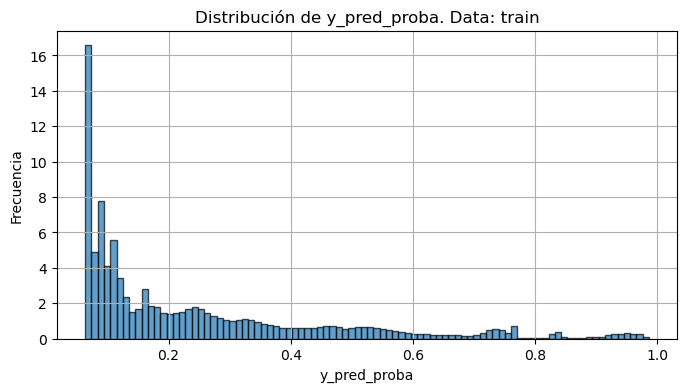

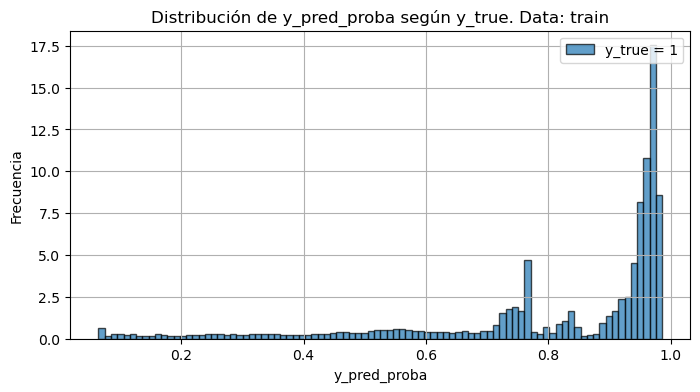

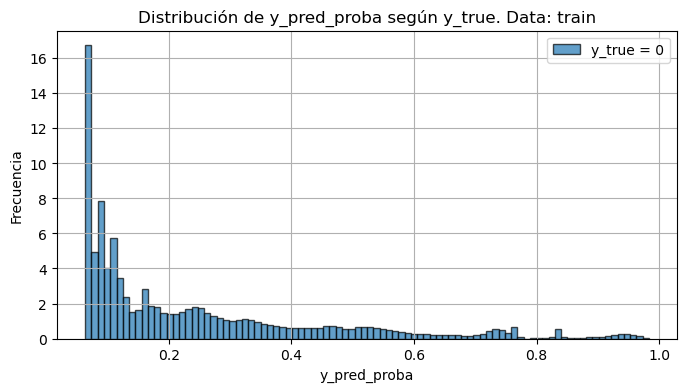

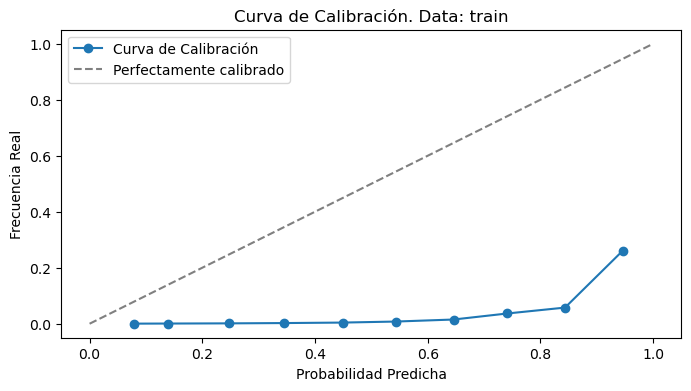

[02/03/25 14:25:16] INFO     TOP N: 1686627                                                           ]8;id=843963;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=91238;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1116\1116]8;;\

[02/03/25 14:25:20] INFO     Iniciando análisis KS por deciles de probabilidad...                      ]8;id=877921;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=438165;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#755\755]8;;\

                    INFO     Calculando el estadístico KS para cada decil...                           ]8;id=528513;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=838906;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#793\793]8;;\

                    INFO     Deciles donde el ks aumenta:  [94, 93, 92, 91, 90, 89, 88]                ]8;id=876629;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=335386;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#817\817]8;;\

                    INFO     Iniciando el procesamiento del ks                                        ]8;id=817472;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=861728;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1169\1169]8;;\

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=681384;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=197077;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=73088;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=33050;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=78082;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=920709;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=490529;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=64085;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=473792;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=291648;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=885232;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=642801;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=410914;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=204746;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=839433;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=405659;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=929896;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=460571;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=241440;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=355117;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=432601;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=943775;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    INFO     Finalizando el procesamiento del ks                                      ]8;id=564918;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=968698;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1177\1177]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:    6.4s
[Parallel(n_jobs=64)]: Done 672 tasks      | elapsed:   13.0s
[Parallel(n_jobs=64)]: Done 900 out of 900 | elapsed:   17.0s finished


[02/03/25 14:25:38] INFO     Iniciando análisis KS por deciles de probabilidad...                      ]8;id=115587;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=19825;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#755\755]8;;\

[02/03/25 14:25:39] INFO     Calculando el estadístico KS para cada decil...                           ]8;id=703781;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=397964;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#793\793]8;;\

                    INFO     Deciles donde el ks aumenta:  [94, 93, 92, 91, 90, 89, 88, 87]            ]8;id=629226;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=708611;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#817\817]8;;\

                    INFO     Iniciando el procesamiento del ks                                        ]8;id=593204;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=737744;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1169\1169]8;;\

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=490803;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=70945;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=976968;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=673585;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=899705;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=891266;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=544773;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=23892;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=288880;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=90380;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=674284;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=17553;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=289508;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=645769;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=589655;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=786442;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    INFO     Finalizando el procesamiento del ks                                      ]8;id=648050;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=60518;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1177\1177]8;;\

[02/03/25 14:25:44] INFO     Iniciando análisis KS por deciles de probabilidad...                      ]8;id=571389;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=323033;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#755\755]8;;\

                    INFO     Calculando el estadístico KS para cada decil...                           ]8;id=491962;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=28596;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#793\793]8;;\

                    INFO     Deciles donde el ks aumenta:  [94, 93, 92, 91, 90, 89, 88, 87]            ]8;id=425721;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=140050;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#817\817]8;;\

                    INFO     Iniciando el procesamiento del ks                                        ]8;id=406711;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=647071;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1169\1169]8;;\

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=199810;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=948170;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=433170;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=388468;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=628172;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=867106;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=902006;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=769333;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=894551;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=956329;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=299207;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=157370;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=640828;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=641827;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    INFO     Finalizando el procesamiento del ks                                      ]8;id=339428;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=234383;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1177\1177]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  74 out of 100 | elapsed:    1.9s remaining:    0.7s
[Parallel(n_jobs=64)]: Done 100 out of 100 | elapsed:    2.3s finished


[02/03/25 14:25:47] INFO     Try Segment Dist Probs: 90                                               ]8;id=257734;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=472992;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

                    INFO     Try Segment Dist Probs: 85                                               ]8;id=498632;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=937467;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:25:48] INFO     Try Segment Dist Probs: 80                                               ]8;id=310778;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=235903;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

                    INFO     Try Segment Dist Probs: 75                                               ]8;id=318008;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=229911;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

                    INFO     Try Segment Dist Probs: 70                                               ]8;id=490426;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=703740;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:25:49] INFO     Try Segment Dist Probs: 65                                               ]8;id=801250;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=932029;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

                    INFO     Try Segment Dist Probs: 60                                               ]8;id=291475;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=947552;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

                    INFO     Try Segment Dist Probs: 55                                               ]8;id=704400;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=337559;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:25:50] INFO     Iniciando análisis KS por deciles de probabilidad...                      ]8;id=392262;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=49467;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#755\755]8;;\

                    INFO     Calculando el estadístico KS para cada decil...                           ]8;id=50708;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=942707;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#793\793]8;;\

                    INFO     Deciles donde el ks aumenta:  [54, 53, 52, 51, 50]                        ]8;id=102694;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=756270;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#817\817]8;;\

                    INFO     Iniciando el procesamiento del ks                                        ]8;id=569532;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=569228;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1169\1169]8;;\

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=252753;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=83833;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=927523;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=815567;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=922727;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=745245;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=398908;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=538718;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    INFO     Finalizando el procesamiento del ks                                      ]8;id=798720;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=932683;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1177\1177]8;;\

[02/03/25 14:25:54] INFO     Iniciando análisis KS por deciles de probabilidad...                      ]8;id=521512;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=223721;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#755\755]8;;\

                    INFO     Calculando el estadístico KS para cada decil...                           ]8;id=812856;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=467976;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#793\793]8;;\

                    INFO     Deciles donde el ks aumenta:  [94, 93, 92, 91, 90, 89, 88]                ]8;id=961033;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=619883;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#817\817]8;;\

                    INFO     Iniciando el procesamiento del ks                                        ]8;id=802952;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=849565;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1169\1169]8;;\

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=84498;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=150750;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=340686;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=606485;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=145125;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=17688;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=623716;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=924407;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=852319;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=904503;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=804339;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=365327;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=321336;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=696181;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=649569;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=81580;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=441286;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=498995;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=38785;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=799484;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=777079;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=652234;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    INFO     Finalizando el procesamiento del ks                                      ]8;id=438519;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=327792;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1177\1177]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:    6.4s
[Parallel(n_jobs=64)]: Done 450 out of 450 | elapsed:    8.5s finished


[02/03/25 14:26:03] INFO     Try Segment Dist Probs: 90                                               ]8;id=953529;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=755335;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1150\1150]8;;\

[02/03/25 14:26:04] INFO     Iniciando análisis KS por deciles de probabilidad...                      ]8;id=972571;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=113124;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#755\755]8;;\

                    INFO     Calculando el estadístico KS para cada decil...                           ]8;id=409256;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=974751;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#793\793]8;;\

                    INFO     Deciles donde el ks aumenta:  [89, 88, 87, 86, 85, 84, 83, 82]            ]8;id=572223;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=544852;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#817\817]8;;\

                    INFO     Iniciando el procesamiento del ks                                        ]8;id=761212;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=370447;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1169\1169]8;;\

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=60900;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=586866;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=918683;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=612024;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=351414;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=461276;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=987257;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=510108;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=901043;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=229364;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=665314;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=729616;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=579665;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=324356;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=508081;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=764614;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=415334;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=472805;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

[02/03/25 14:26:05] WARNING  /home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_b ]8;id=530899;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=961839;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/warnings.py#109\109]8;;\
                             bog_integration_fabrica_personas/pipelines/model_selection/nodes.py:11                
                             8: SettingWithCopyWarning:                                                            
                             A value is trying to be set on a copy of a slice from a DataFrame                     
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               sub_group.loc[index,'prob_min'] = value_copy                                        
                                                                                                                   

                    INFO     Finalizando el procesamiento del ks                                      ]8;id=244936;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=296031;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#1177\1177]8;;\

                    INFO     Tipo de Threshold: KS                                                     ]8;id=631508;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=279887;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#295\295]8;;\

                    INFO     ------------------------------------------------------                    ]8;id=578135;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=446751;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#313\313]8;;\

                    INFO     Modelo: MLP_0,Run1. Weight: 1                                             ]8;id=917209;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=838408;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#314\314]8;;\

[02/03/25 14:26:08] INFO     Update probs: Selected: 0, Target Select: 1686627, Diff %: -1.0           ]8;id=85315;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=439637;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

[02/03/25 14:26:09] INFO     Update probs: Selected: 59214, Target Select: 1686627, Diff %:            ]8;id=224118;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=330052;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9648920597144478                                                                   

[02/03/25 14:26:10] INFO     Update probs: Selected: 118317, Target Select: 1686627, Diff %:           ]8;id=287648;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=2712;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9298499312533239                                                                   

[02/03/25 14:26:11] INFO     Update probs: Selected: 177571, Target Select: 1686627, Diff %:           ]8;id=931073;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=829213;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8947182749950048                                                                   

[02/03/25 14:26:12] INFO     Update probs: Selected: 236702, Target Select: 1686627, Diff %:           ]8;id=212258;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=890809;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8596595453529441                                                                   

[02/03/25 14:26:13] INFO     Update probs: Selected: 295896, Target Select: 1686627, Diff %:           ]8;id=846283;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=25034;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8245634630537754                                                                   

[02/03/25 14:26:14] INFO     Update probs: Selected: 355022, Target Select: 1686627, Diff %:           ]8;id=643263;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=726761;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7895076979083105                                                                   

[02/03/25 14:26:15] INFO     Update probs: Selected: 414290, Target Select: 1686627, Diff %:           ]8;id=42340;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=533912;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.754367741059523                                                                    

[02/03/25 14:26:16] INFO     Update probs: Selected: 473508, Target Select: 1686627, Diff %:           ]8;id=715040;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=497393;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7192574291766941                                                                   

[02/03/25 14:26:17] INFO     Update probs: Selected: 532585, Target Select: 1686627, Diff %:           ]8;id=336459;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=631575;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6842307160978687                                                                   

[02/03/25 14:26:18] INFO     Update probs: Selected: 591804, Target Select: 1686627, Diff %:           ]8;id=107563;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=48345;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6491198113157207                                                                   

[02/03/25 14:26:19] INFO     Update probs: Selected: 650882, Target Select: 1686627, Diff %:           ]8;id=419010;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=820868;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6140925053375761                                                                   

[02/03/25 14:26:20] INFO     Update probs: Selected: 769441, Target Select: 1686627, Diff %:           ]8;id=658852;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=835235;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.54379895495566                                                                     

[02/03/25 14:26:21] INFO     Update probs: Selected: 828435, Target Select: 1686627, Diff %:           ]8;id=201337;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=173430;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5088214525203261                                                                   

[02/03/25 14:26:22] INFO     Update probs: Selected: 887724, Target Select: 1686627, Diff %:           ]8;id=934214;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=369957;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4736690447858359                                                                   

[02/03/25 14:26:23] INFO     Update probs: Selected: 946704, Target Select: 1686627, Diff %:           ]8;id=3190;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=367272;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.43869984294097036                                                                  

[02/03/25 14:26:24] INFO     Update probs: Selected: 1006247, Target Select: 1686627, Diff %:          ]8;id=718987;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=554942;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.40339683877941                                                                     

[02/03/25 14:26:25] INFO     Update probs: Selected: 1065233, Target Select: 1686627, Diff %:          ]8;id=207229;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=996501;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.3684240795386295                                                                   

[02/03/25 14:26:26] INFO     Update probs: Selected: 1124484, Target Select: 1686627, Diff %:          ]8;id=355463;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=913701;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.33329420197826787                                                                  

[02/03/25 14:26:27] INFO     Update probs: Selected: 1183775, Target Select: 1686627, Diff %:          ]8;id=647942;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=94150;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.29814060844513934                                                                  

[02/03/25 14:26:28] INFO     Update probs: Selected: 1242645, Target Select: 1686627, Diff %:          ]8;id=646691;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=277255;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.2632366255253829                                                                   

[02/03/25 14:26:29] INFO     Update probs: Selected: 1302022, Target Select: 1686627, Diff %:          ]8;id=466722;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=718204;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.22803204265080543                                                                  

[02/03/25 14:26:30] INFO     Update probs: Selected: 1361234, Target Select: 1686627, Diff %:          ]8;id=28937;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=531131;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.1929252881638916                                                                   

[02/03/25 14:26:31] INFO     Update probs: Selected: 1420473, Target Select: 1686627, Diff %:          ]8;id=837875;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=281792;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.15780252539536008                                                                  

[02/03/25 14:26:32] INFO     Update probs: Selected: 1657027, Target Select: 1686627, Diff %:          ]8;id=794313;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=451970;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.017549819847541868                                                                 

[02/03/25 14:26:33] INFO     Update probs: Selected: 1686627, Target Select: 1686627, Diff %: 0.0      ]8;id=468025;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=913351;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

                    INFO     Finish                                                                    ]8;id=410196;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=847845;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#251\251]8;;\

                    INFO     ------------------------------------------------------                    ]8;id=57833;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=937049;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#313\313]8;;\

                    INFO     Modelo: random_forest_2,Run3. Weight: 1                                   ]8;id=870338;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=191649;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#314\314]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 672 tasks      | elapsed:   12.9s
[Parallel(n_jobs=64)]: Done 900 out of 900 | elapsed:   16.9s finished


[02/03/25 14:26:51] INFO     Update probs: Selected: 0, Target Select: 1686627, Diff %: -1.0           ]8;id=894944;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=194724;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

[02/03/25 14:26:52] INFO     Update probs: Selected: 59096, Target Select: 1686627, Diff %:            ]8;id=111232;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=602318;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9649620218341103                                                                   

[02/03/25 14:26:53] INFO     Update probs: Selected: 118320, Target Select: 1686627, Diff %:           ]8;id=949346;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=759770;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9298481525553665                                                                   

[02/03/25 14:26:54] INFO     Update probs: Selected: 177449, Target Select: 1686627, Diff %:           ]8;id=494343;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=938856;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.894790608711944                                                                    

[02/03/25 14:26:55] INFO     Update probs: Selected: 236552, Target Select: 1686627, Diff %:           ]8;id=279088;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=789264;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8597484802508202                                                                   

[02/03/25 14:26:56] INFO     Update probs: Selected: 295724, Target Select: 1686627, Diff %:           ]8;id=948300;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=131569;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8246654417366732                                                                   

[02/03/25 14:26:57] INFO     Update probs: Selected: 354909, Target Select: 1686627, Diff %:           ]8;id=804898;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=790666;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7895746955313772                                                                   

[02/03/25 14:26:58] INFO     Update probs: Selected: 414165, Target Select: 1686627, Diff %:           ]8;id=195776;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=197189;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7544418534744196                                                                   

[02/03/25 14:26:59] INFO     Update probs: Selected: 473322, Target Select: 1686627, Diff %:           ]8;id=543393;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=947844;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7193677084500604                                                                   

[02/03/25 14:27:00] INFO     Update probs: Selected: 532507, Target Select: 1686627, Diff %:           ]8;id=445737;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=924678;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6842769622447643                                                                   

[02/03/25 14:27:01] INFO     Update probs: Selected: 591592, Target Select: 1686627, Diff %:           ]8;id=600613;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=418542;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6492455059713855                                                                   

[02/03/25 14:27:02] INFO     Update probs: Selected: 650923, Target Select: 1686627, Diff %:           ]8;id=932058;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=495092;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.61406819646549                                                                     

[02/03/25 14:27:03] INFO     Update probs: Selected: 709950, Target Select: 1686627, Diff %:           ]8;id=297221;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=656703;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5790711283526233                                                                   

[02/03/25 14:27:04] INFO     Update probs: Selected: 769029, Target Select: 1686627, Diff %:           ]8;id=341612;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=616077;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5440432294751596                                                                   

[02/03/25 14:27:05] INFO     Update probs: Selected: 828342, Target Select: 1686627, Diff %:           ]8;id=135285;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=666254;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5088765921570092                                                                   

[02/03/25 14:27:06] INFO     Update probs: Selected: 887545, Target Select: 1686627, Diff %:           ]8;id=929612;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=204228;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.473775173763968                                                                    

[02/03/25 14:27:07] INFO     Update probs: Selected: 946787, Target Select: 1686627, Diff %:           ]8;id=282248;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=324661;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4386506322974789                                                                   

[02/03/25 14:27:08] INFO     Update probs: Selected: 1005734, Target Select: 1686627, Diff %:          ]8;id=787201;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=245231;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.40370099613014615                                                                  

[02/03/25 14:27:09] INFO     Update probs: Selected: 1124402, Target Select: 1686627, Diff %:          ]8;id=831825;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=303338;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.3333428197224401                                                                   

[02/03/25 14:27:10] INFO     Update probs: Selected: 1183292, Target Select: 1686627, Diff %:          ]8;id=174640;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=48160;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.2984269788163002                                                                   

[02/03/25 14:27:11] INFO     Update probs: Selected: 1242563, Target Select: 1686627, Diff %:          ]8;id=293371;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=717617;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.26328524326955516                                                                  

[02/03/25 14:27:12] INFO     Update probs: Selected: 1360967, Target Select: 1686627, Diff %:          ]8;id=955565;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=316928;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.19308359228211097                                                                  

[02/03/25 14:27:13] INFO     Update probs: Selected: 1420312, Target Select: 1686627, Diff %:          ]8;id=248950;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=125107;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.15789798218574705                                                                  

[02/03/25 14:27:14] INFO     Update probs: Selected: 1479294, Target Select: 1686627, Diff %:          ]8;id=30633;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=550264;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.12292759454224318                                                                  

[02/03/25 14:27:15] INFO     Update probs: Selected: 1538497, Target Select: 1686627, Diff %:          ]8;id=507310;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=312389;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.08782617614920193                                                                  

[02/03/25 14:27:16] INFO     Update probs: Selected: 1686627, Target Select: 1686627, Diff %: 0.0      ]8;id=288854;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=365005;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

                    INFO     Finish                                                                    ]8;id=991284;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=949855;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#251\251]8;;\

                    INFO     ------------------------------------------------------                    ]8;id=96216;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=202243;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#313\313]8;;\

                    INFO     Modelo: MLP_3,Run4. Weight: 1                                             ]8;id=276692;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=694482;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#314\314]8;;\

[02/03/25 14:27:21] INFO     Update probs: Selected: 0, Target Select: 1686627, Diff %: -1.0           ]8;id=458090;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=125826;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

[02/03/25 14:27:22] INFO     Update probs: Selected: 59189, Target Select: 1686627, Diff %:            ]8;id=521905;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=123913;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9649068821974272                                                                   

[02/03/25 14:27:23] INFO     Update probs: Selected: 118397, Target Select: 1686627, Diff %:           ]8;id=589952;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=536761;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.92980249930779                                                                     

[02/03/25 14:27:24] INFO     Update probs: Selected: 177522, Target Select: 1686627, Diff %:           ]8;id=14071;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=594651;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8947473270616443                                                                   

[02/03/25 14:27:25] INFO     Update probs: Selected: 236725, Target Select: 1686627, Diff %:           ]8;id=215660;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=361952;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.859645908668603                                                                    

[02/03/25 14:27:26] INFO     Update probs: Selected: 295895, Target Select: 1686627, Diff %:           ]8;id=19428;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=644292;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8245640559530946                                                                   

[02/03/25 14:27:27] INFO     Update probs: Selected: 355098, Target Select: 1686627, Diff %:           ]8;id=257099;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=253015;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7894626375600533                                                                   

[02/03/25 14:27:28] INFO     Update probs: Selected: 414268, Target Select: 1686627, Diff %:           ]8;id=603443;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=37825;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7543807848445447                                                                   

[02/03/25 14:27:29] INFO     Update probs: Selected: 473511, Target Select: 1686627, Diff %:           ]8;id=541365;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=194198;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7192556504787365                                                                   

[02/03/25 14:27:30] INFO     Update probs: Selected: 532717, Target Select: 1686627, Diff %:           ]8;id=135248;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=898072;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6841524533877378                                                                   

[02/03/25 14:27:31] INFO     Update probs: Selected: 591751, Target Select: 1686627, Diff %:           ]8;id=184018;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=49516;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6491512349796369                                                                   

[02/03/25 14:27:32] INFO     Update probs: Selected: 651057, Target Select: 1686627, Diff %:           ]8;id=270010;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=343994;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6139887479567208                                                                   

[02/03/25 14:27:33] INFO     Update probs: Selected: 710095, Target Select: 1686627, Diff %:           ]8;id=456468;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=348262;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5789851579513431                                                                   

                    INFO     Update probs: Selected: 769354, Target Select: 1686627, Diff %:           ]8;id=925841;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=651804;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5438505371964282                                                                   

[02/03/25 14:27:34] INFO     Update probs: Selected: 828633, Target Select: 1686627, Diff %:           ]8;id=498370;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=268733;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5087040584551297                                                                   

[02/03/25 14:27:35] INFO     Update probs: Selected: 887723, Target Select: 1686627, Diff %:           ]8;id=556651;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=264027;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.473669637685155                                                                    

[02/03/25 14:27:36] INFO     Update probs: Selected: 946761, Target Select: 1686627, Diff %:           ]8;id=526048;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=572093;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.43866604767977746                                                                  

[02/03/25 14:27:37] INFO     Update probs: Selected: 1006246, Target Select: 1686627, Diff %:          ]8;id=544669;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=465238;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4033974316787292                                                                   

[02/03/25 14:27:38] INFO     Update probs: Selected: 1065236, Target Select: 1686627, Diff %:          ]8;id=524613;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=67210;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.36842230084067196                                                                  

[02/03/25 14:27:39] INFO     Update probs: Selected: 1124300, Target Select: 1686627, Diff %:          ]8;id=979458;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=376912;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.33340329545299585                                                                  

[02/03/25 14:27:40] INFO     Update probs: Selected: 1183351, Target Select: 1686627, Diff %:          ]8;id=33408;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=84550;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.29839199775646896                                                                  

[02/03/25 14:27:41] INFO     Update probs: Selected: 1242728, Target Select: 1686627, Diff %:          ]8;id=967246;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=799896;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.2631874148818915                                                                   

[02/03/25 14:27:42] INFO     Update probs: Selected: 1301686, Target Select: 1686627, Diff %:          ]8;id=446770;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=660091;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.22823125682204778                                                                  

[02/03/25 14:27:43] INFO     Update probs: Selected: 1361015, Target Select: 1686627, Diff %:          ]8;id=195339;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=814376;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.19305513311479064                                                                  

[02/03/25 14:27:44] INFO     Update probs: Selected: 1420442, Target Select: 1686627, Diff %:          ]8;id=62321;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=732172;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.15782090527425446                                                                  

[02/03/25 14:27:45] INFO     Update probs: Selected: 1479242, Target Select: 1686627, Diff %:          ]8;id=419250;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=89412;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.12295842530684022                                                                  

[02/03/25 14:27:46] INFO     Update probs: Selected: 1538524, Target Select: 1686627, Diff %:          ]8;id=510898;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=566244;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.08781016786758424                                                                  

[02/03/25 14:27:47] INFO     Update probs: Selected: 1597559, Target Select: 1686627, Diff %:          ]8;id=881277;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=847215;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.05280835656016416                                                                  

[02/03/25 14:27:48] INFO     Update probs: Selected: 1657332, Target Select: 1686627, Diff %:          ]8;id=71839;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=689016;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.017368985555193887                                                                 

[02/03/25 14:27:49] INFO     Update probs: Selected: 1686627, Target Select: 1686627, Diff %: 0.0      ]8;id=968642;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=837170;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

                    INFO     Finish                                                                    ]8;id=223280;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=167102;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#251\251]8;;\

                    INFO     ------------------------------------------------------                    ]8;id=38854;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=226186;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#313\313]8;;\

                    INFO     Modelo: random_forest_5,Run6. Weight: 1                                   ]8;id=989124;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=122194;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#314\314]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  74 out of 100 | elapsed:    1.9s remaining:    0.7s
[Parallel(n_jobs=64)]: Done 100 out of 100 | elapsed:    2.3s finished


[02/03/25 14:27:53] INFO     Update probs: Selected: 0, Target Select: 1686627, Diff %: -1.0           ]8;id=608159;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=198330;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

[02/03/25 14:27:54] INFO     Update probs: Selected: 102196, Target Select: 1686627, Diff %:           ]8;id=850935;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=950203;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9394080611777234                                                                   

[02/03/25 14:27:55] INFO     Update probs: Selected: 204411, Target Select: 1686627, Diff %:           ]8;id=743010;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=585625;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8788048572683824                                                                   

[02/03/25 14:27:56] INFO     Update probs: Selected: 306551, Target Select: 1686627, Diff %:           ]8;id=29696;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=393583;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8182461208079794                                                                   

[02/03/25 14:27:57] INFO     Update probs: Selected: 408854, Target Select: 1686627, Diff %:           ]8;id=657171;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=902298;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7575907417585512                                                                   

[02/03/25 14:27:58] INFO     Update probs: Selected: 511075, Target Select: 1686627, Diff %:           ]8;id=961057;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=551124;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6969839804532952                                                                   

[02/03/25 14:27:59] INFO     Update probs: Selected: 613277, Target Select: 1686627, Diff %:           ]8;id=238836;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=463244;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6363884842351035                                                                   

[02/03/25 14:28:00] INFO     Update probs: Selected: 715619, Target Select: 1686627, Diff %:           ]8;id=489714;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=647170;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5757099821122276                                                                   

[02/03/25 14:28:01] INFO     Update probs: Selected: 817896, Target Select: 1686627, Diff %:           ]8;id=608109;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=258036;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5150700184450978                                                                   

[02/03/25 14:28:02] INFO     Update probs: Selected: 920050, Target Select: 1686627, Diff %:           ]8;id=940573;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=414387;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.45450298139422646                                                                  

[02/03/25 14:28:03] INFO     Update probs: Selected: 1022207, Target Select: 1686627, Diff %:          ]8;id=506407;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=591458;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.39393416564539757                                                                  

[02/03/25 14:28:04] INFO     Update probs: Selected: 1124249, Target Select: 1686627, Diff %:          ]8;id=286525;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=489627;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.3334335333182737                                                                   

[02/03/25 14:28:05] INFO     Update probs: Selected: 1226700, Target Select: 1686627, Diff %:          ]8;id=112090;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=727261;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.27269040516960774                                                                  

[02/03/25 14:28:06] INFO     Update probs: Selected: 1328846, Target Select: 1686627, Diff %:          ]8;id=169012;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=341400;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.2121281113132898                                                                   

[02/03/25 14:28:07] INFO     Update probs: Selected: 1431227, Target Select: 1686627, Diff %:          ]8;id=319615;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=1652;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.151426486116966                                                                    

[02/03/25 14:28:08] INFO     Update probs: Selected: 1533211, Target Select: 1686627, Diff %:          ]8;id=468189;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=675008;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.09096024195035417                                                                  

[02/03/25 14:28:09] INFO     Update probs: Selected: 1635619, Target Select: 1686627, Diff %:          ]8;id=419129;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=365866;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.03024260847241269                                                                  

[02/03/25 14:28:10] INFO     Update probs: Selected: 1686627, Target Select: 1686627, Diff %: 0.0      ]8;id=281381;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=202299;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

                    INFO     Finish                                                                    ]8;id=217512;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=651999;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#251\251]8;;\

                    INFO     ------------------------------------------------------                    ]8;id=809297;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=958704;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#313\313]8;;\

                    INFO     Modelo: MLP_6,Run7. Weight: 1                                             ]8;id=52438;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=430507;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#314\314]8;;\

[02/03/25 14:28:13] INFO     Update probs: Selected: 0, Target Select: 1686627, Diff %: -1.0           ]8;id=762349;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=325457;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

[02/03/25 14:28:14] INFO     Update probs: Selected: 59155, Target Select: 1686627, Diff %:            ]8;id=642916;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=42240;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.964927040774279                                                                    

[02/03/25 14:28:15] INFO     Update probs: Selected: 118347, Target Select: 1686627, Diff %:           ]8;id=334717;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=277490;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9298321442737487                                                                   

[02/03/25 14:28:16] INFO     Update probs: Selected: 177587, Target Select: 1686627, Diff %:           ]8;id=812516;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=724735;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8947087886058981                                                                   

[02/03/25 14:28:17] INFO     Update probs: Selected: 236668, Target Select: 1686627, Diff %:           ]8;id=244794;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=523773;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.859679703929796                                                                    

[02/03/25 14:28:18] INFO     Update probs: Selected: 295833, Target Select: 1686627, Diff %:           ]8;id=34553;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=234814;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8246008157108833                                                                   

[02/03/25 14:28:19] INFO     Update probs: Selected: 355253, Target Select: 1686627, Diff %:           ]8;id=275094;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=738317;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7893707381655813                                                                   

[02/03/25 14:28:20] INFO     Update probs: Selected: 414272, Target Select: 1686627, Diff %:           ]8;id=125226;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=33747;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7543784132472681                                                                   

[02/03/25 14:28:21] INFO     Update probs: Selected: 473454, Target Select: 1686627, Diff %:           ]8;id=57151;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=820699;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7192894457399295                                                                   

[02/03/25 14:28:22] INFO     Update probs: Selected: 532536, Target Select: 1686627, Diff %:           ]8;id=375141;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=833977;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6842597681645082                                                                   

[02/03/25 14:28:23] INFO     Update probs: Selected: 591702, Target Select: 1686627, Diff %:           ]8;id=635346;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=787524;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6491802870462764                                                                   

[02/03/25 14:28:24] INFO     Update probs: Selected: 650708, Target Select: 1686627, Diff %:           ]8;id=945854;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=742752;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6141956698191123                                                                   

[02/03/25 14:28:25] INFO     Update probs: Selected: 709999, Target Select: 1686627, Diff %:           ]8;id=340125;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=948823;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5790420762859838                                                                   

[02/03/25 14:28:26] INFO     Update probs: Selected: 769163, Target Select: 1686627, Diff %:           ]8;id=371987;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=73202;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5439637809663903                                                                   

[02/03/25 14:28:27] INFO     Update probs: Selected: 828206, Target Select: 1686627, Diff %:           ]8;id=768201;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=422860;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5089572264644169                                                                   

[02/03/25 14:28:28] INFO     Update probs: Selected: 887527, Target Select: 1686627, Diff %:           ]8;id=801446;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=290988;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.4737858459517131                                                                   

[02/03/25 14:28:29] INFO     Update probs: Selected: 946598, Target Select: 1686627, Diff %:           ]8;id=716789;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=823670;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.43876269026880277                                                                  

[02/03/25 14:28:30] INFO     Update probs: Selected: 1005948, Target Select: 1686627, Diff %:          ]8;id=95247;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=828499;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.40357411567584295                                                                  

[02/03/25 14:28:31] INFO     Update probs: Selected: 1064878, Target Select: 1686627, Diff %:          ]8;id=434608;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=655728;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.36863455879693613                                                                  

[02/03/25 14:28:32] INFO     Update probs: Selected: 1124262, Target Select: 1686627, Diff %:          ]8;id=822935;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=691268;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.3334258256271244                                                                   

[02/03/25 14:28:33] INFO     Update probs: Selected: 1183343, Target Select: 1686627, Diff %:          ]8;id=483532;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=165022;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.29839674095102237                                                                  

[02/03/25 14:28:34] INFO     Update probs: Selected: 1242377, Target Select: 1686627, Diff %:          ]8;id=565389;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=819270;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.2633955225429215                                                                   

[02/03/25 14:28:35] INFO     Update probs: Selected: 1301676, Target Select: 1686627, Diff %:          ]8;id=686619;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=218379;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.22823718581523952                                                                  

[02/03/25 14:28:36] INFO     Update probs: Selected: 1361048, Target Select: 1686627, Diff %:          ]8;id=960755;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=338630;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.19303556743725792                                                                  

[02/03/25 14:28:37] INFO     Update probs: Selected: 1420394, Target Select: 1686627, Diff %:          ]8;id=550909;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=155229;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.15784936444157482                                                                  

[02/03/25 14:28:38] INFO     Update probs: Selected: 1479329, Target Select: 1686627, Diff %:          ]8;id=6320;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=211;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.12290684306607211                                                                  

[02/03/25 14:28:39] INFO     Update probs: Selected: 1538450, Target Select: 1686627, Diff %:          ]8;id=681001;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=230434;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.0878540424172031                                                                   

[02/03/25 14:28:40] INFO     Update probs: Selected: 1597954, Target Select: 1686627, Diff %:          ]8;id=942623;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=531624;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.05257416132909055                                                                  

[02/03/25 14:28:41] INFO     Update probs: Selected: 1686627, Target Select: 1686627, Diff %: 0.0      ]8;id=964390;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=800040;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

                    INFO     Finish                                                                    ]8;id=989611;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=938952;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#251\251]8;;\

                    INFO     ------------------------------------------------------                    ]8;id=595910;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=278267;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#313\313]8;;\

                    INFO     Modelo: random_forest_8,Run9. Weight: 1                                   ]8;id=72482;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=819311;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#314\314]8;;\

[Parallel(n_jobs=64)]: Using backend ThreadingBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 450 out of 450 | elapsed:    8.4s finished


[02/03/25 14:28:50] INFO     Update probs: Selected: 0, Target Select: 1686627, Diff %: -1.0           ]8;id=349818;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=207472;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

[02/03/25 14:28:51] INFO     Update probs: Selected: 62475, Target Select: 1686627, Diff %:            ]8;id=9584;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=491088;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9629586150346223                                                                   

[02/03/25 14:28:52] INFO     Update probs: Selected: 124888, Target Select: 1686627, Diff %:           ]8;id=660115;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=386399;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.9259539898270335                                                                   

[02/03/25 14:28:53] INFO     Update probs: Selected: 187442, Target Select: 1686627, Diff %:           ]8;id=868781;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=799569;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8888657658154411                                                                   

[02/03/25 14:28:54] INFO     Update probs: Selected: 249904, Target Select: 1686627, Diff %:           ]8;id=737896;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=742635;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8518320885412127                                                                   

[02/03/25 14:28:55] INFO     Update probs: Selected: 312389, Target Select: 1686627, Diff %:           ]8;id=499299;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=837526;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.8147847745826433                                                                   

[02/03/25 14:28:56] INFO     Update probs: Selected: 374876, Target Select: 1686627, Diff %:           ]8;id=845562;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=638998;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7777362748254356                                                                   

[02/03/25 14:28:57] INFO     Update probs: Selected: 437241, Target Select: 1686627, Diff %:           ]8;id=139393;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=543629;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7407601087851671                                                                   

[02/03/25 14:28:58] INFO     Update probs: Selected: 499653, Target Select: 1686627, Diff %:           ]8;id=178219;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=773459;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.7037560764768974                                                                   

[02/03/25 14:28:59] INFO     Update probs: Selected: 562156, Target Select: 1686627, Diff %:           ]8;id=70613;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=998730;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6666980903305829                                                                   

[02/03/25 14:29:00] INFO     Update probs: Selected: 624580, Target Select: 1686627, Diff %:           ]8;id=6161;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=564394;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.6296869432304831                                                                   

[02/03/25 14:29:01] INFO     Update probs: Selected: 687243, Target Select: 1686627, Diff %:           ]8;id=349787;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=612675;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5925340931931008                                                                   

[02/03/25 14:29:02] INFO     Update probs: Selected: 749513, Target Select: 1686627, Diff %:           ]8;id=389860;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=322960;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5556142525881538                                                                   

[02/03/25 14:29:03] INFO     Update probs: Selected: 812147, Target Select: 1686627, Diff %:           ]8;id=775876;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=922155;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.5184785966310275                                                                   

[02/03/25 14:29:04] INFO     Update probs: Selected: 874466, Target Select: 1686627, Diff %:           ]8;id=560362;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=668644;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.48152970395944095                                                                  

[02/03/25 14:29:05] INFO     Update probs: Selected: 937127, Target Select: 1686627, Diff %:           ]8;id=745513;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=339190;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.444378039720697                                                                    

[02/03/25 14:29:06] INFO     Update probs: Selected: 1062111, Target Select: 1686627, Diff %:          ]8;id=301934;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=686436;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.3702751112130898                                                                   

[02/03/25 14:29:07] INFO     Update probs: Selected: 1124410, Target Select: 1686627, Diff %:          ]8;id=109035;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=46056;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.3333380765278867                                                                   

[02/03/25 14:29:08] INFO     Update probs: Selected: 1186860, Target Select: 1686627, Diff %:          ]8;id=323894;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=647397;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.29631151404548844                                                                  

[02/03/25 14:29:09] INFO     Update probs: Selected: 1249239, Target Select: 1686627, Diff %:          ]8;id=167434;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=984057;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.25932704741475143                                                                  

[02/03/25 14:29:10] INFO     Update probs: Selected: 1311893, Target Select: 1686627, Diff %:          ]8;id=732810;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=174578;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.22217953347124172                                                                  

[02/03/25 14:29:11] INFO     Update probs: Selected: 1374429, Target Select: 1686627, Diff %:          ]8;id=469450;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=88947;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.18510198164739447                                                                  

[02/03/25 14:29:12] INFO     Update probs: Selected: 1436947, Target Select: 1686627, Diff %:          ]8;id=908249;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=592821;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.14803510201129236                                                                  

[02/03/25 14:29:13] INFO     Update probs: Selected: 1561770, Target Select: 1686627, Diff %:          ]8;id=981587;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=151793;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.07402763029407214                                                                  

[02/03/25 14:29:14] INFO     Update probs: Selected: 1623892, Target Select: 1686627, Diff %:          ]8;id=705211;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=967347;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.03719553878836281                                                                  

[02/03/25 14:29:15] INFO     Update probs: Selected: 1686422, Target Select: 1686627, Diff %:          ]8;id=787708;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=95372;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\
                             -0.00012154436043061092                                                               

[02/03/25 14:29:16] INFO     Update probs: Selected: 1686627, Target Select: 1686627, Diff %: 0.0      ]8;id=565732;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=108698;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#225\225]8;;\

                    INFO     Finish                                                                    ]8;id=930564;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=668920;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#251\251]8;;\

[02/03/25 14:29:17] INFO     Iniciando sistema de votaciones..                                         ]8;id=728961;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=897209;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#331\331]8;;\

[02/03/25 14:29:18] INFO     Ok Sistema de votaciones                                                  ]8;id=573653;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py\nodes.py]8;;\:]8;id=505013;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/model_selection/nodes.py#350\350]8;;\

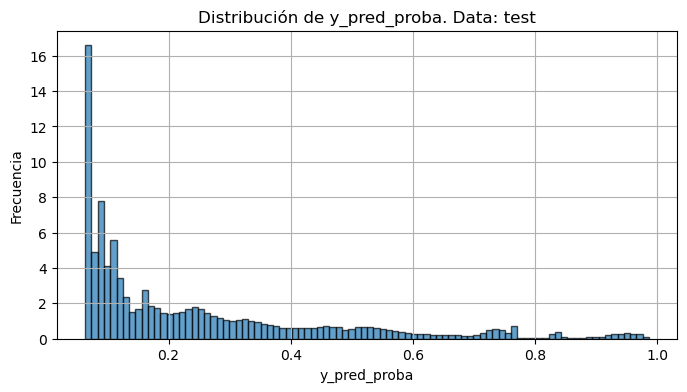

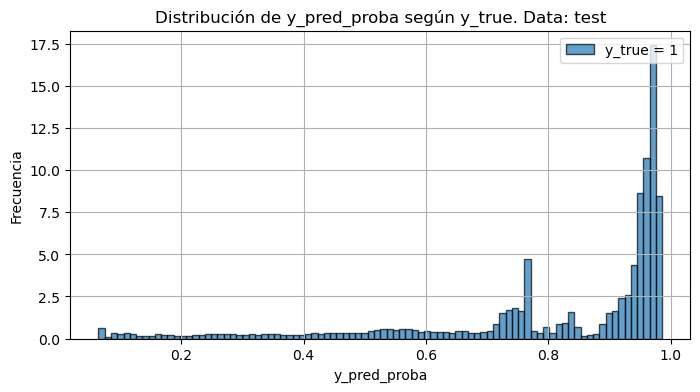

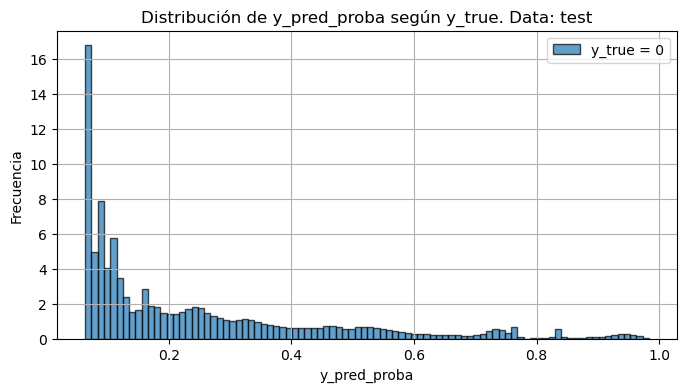

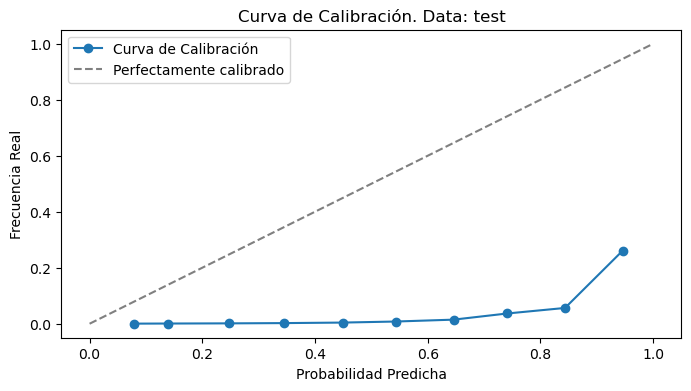

value          name_model model_name  \
class_name metric_name    dataset_name                                          
1          f1-score n_top test          4.9436  [0, 2, 3, 5, 6, 8]   Ensamble   
           true_sum n_top test           42747  [0, 2, 3, 5, 6, 8]   Ensamble   
           backtest       test          2.5345  [0, 2, 3, 5, 6, 8]   Ensamble   

                                             select_model  
class_name metric_name    dataset_name                     
1          f1-score n_top test          modelo_produccion  
           true_sum n_top test          modelo_produccion  
           backtest       test          modelo_produccion

In [26]:
info_save2=ms.calc_metrics_before_backtesting(info_save_all, info_save_temp,params)

In [64]:
# sin eda, experimento 1,prueba 1
check_df_cientifico = info_save2['select_model2']
check_df_cientifico = check_df_cientifico[np.in1d(check_df_cientifico.index.get_level_values(1),['backtest'])].reset_index() 
check_df_cientifico = check_df_cientifico.set_index(['select_model','name_model','dataset_name','class_name']).sort_index()
check_df_cientifico

metric_name  \
select_model        name_model         dataset_name class_name               
best_fitting_model  Run6               test         1             backtest   
                                       train        1             backtest   
best_model_name     Run1               test         1             backtest   
                                       train        1             backtest   
best_unbiased_model Run1               test         1             backtest   
                                       train        1             backtest   
modelo_produccion   [0, 1, 2, 3, 4, 7] test         1             backtest   
                                       train        1             backtest   

                                                                 value  \
select_model        name_model         dataset_name class_name           
best_fitting_model  Run6               test         1           2.5226   
                                       train        1           2.5272   
best_model_name     Run1               test         1           2.5336   
                                       train        1           2.5374   
best_unbiased_model Run1               test         1           2.5336   
                                       train        1           2.5374   
modelo_produccion   [0, 1, 2, 3, 4, 7] test         1           2.5405   
                                       train        1           2.5589   

                                                                     model_name  
select_model        name_model         dataset_name class_name                   
best_fitting_model  Run6               test         1           random_forest_5  
                                       train        1           random_forest_5  
best_model_name     Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
best_unbiased_model Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
modelo_produccion   [0, 1, 2, 3, 4, 7] test         1                  Ensamble  
                                       train        1                  Ensamble

In [ ]:
# sin eda, experimento 1,prueba 1, mayor alcance
check_df_cientifico = info_save2['select_model2']
check_df_cientifico = check_df_cientifico[np.in1d(check_df_cientifico.index.get_level_values(1),['backtest'])].reset_index() 
check_df_cientifico = check_df_cientifico.set_index(['select_model','name_model','dataset_name','class_name']).sort_index()
check_df_cientifico

metric_name  \
select_model        name_model                  dataset_name class_name               
best_fitting_model  Run6                        test         1             backtest   
                                                train        1             backtest   
best_model_name     Run1                        test         1             backtest   
                                                train        1             backtest   
best_unbiased_model Run1                        test         1             backtest   
                                                train        1             backtest   
modelo_produccion   [0, 1, 2, 3, 4, 6, 7, 8, 9] test         1             backtest   
                                                train        1             backtest   

                                                                          value  \
select_model        name_model                  dataset_name class_name           
best_fitting_model  Run6                        test         1           2.5226   
                                                train        1           2.5272   
best_model_name     Run1                        test         1           2.5336   
                                                train        1           2.5374   
best_unbiased_model Run1                        test         1           2.5336   
                                                train        1           2.5374   
modelo_produccion   [0, 1, 2, 3, 4, 6, 7, 8, 9] test         1           2.5399   
                                                train        1           2.5536   

                                                                              model_name  
select_model        name_model                  dataset_name class_name                   
best_fitting_model  Run6                        test         1           random_forest_5  
                                                train        1           random_forest_5  
best_model_name     Run1                        test         1                     MLP_0  
                                                train        1                     MLP_0  
best_unbiased_model Run1                        test         1                     MLP_0  
                                                train        1                     MLP_0  
modelo_produccion   [0, 1, 2, 3, 4, 6, 7, 8, 9] test         1                  Ensamble  
                                                train        1                  Ensamble

In [ ]:
# sin eda, experimento 2,prueba 2
check_df_cientifico = info_save2['select_model2']
check_df_cientifico = check_df_cientifico[np.in1d(check_df_cientifico.index.get_level_values(1),['backtest'])].reset_index() 
check_df_cientifico = check_df_cientifico.set_index(['select_model','name_model','dataset_name','class_name']).sort_index()
check_df_cientifico

metric_name  \
select_model        name_model         dataset_name class_name               
best_fitting_model  Run6               test         1             backtest   
                                       train        1             backtest   
best_model_name     Run1               test         1             backtest   
                                       train        1             backtest   
best_unbiased_model Run1               test         1             backtest   
                                       train        1             backtest   
modelo_produccion   [0, 2, 3, 4, 6, 7] test         1             backtest   
                                       train        1             backtest   

                                                                 value  \
select_model        name_model         dataset_name class_name           
best_fitting_model  Run6               test         1           2.5276   
                                       train        1           2.5338   
best_model_name     Run1               test         1           2.5345   
                                       train        1           2.5401   
best_unbiased_model Run1               test         1           2.5345   
                                       train        1           2.5401   
modelo_produccion   [0, 2, 3, 4, 6, 7] test         1           2.5385   
                                       train        1            2.554   

                                                                     model_name  
select_model        name_model         dataset_name class_name                   
best_fitting_model  Run6               test         1           random_forest_5  
                                       train        1           random_forest_5  
best_model_name     Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
best_unbiased_model Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
modelo_produccion   [0, 2, 3, 4, 6, 7] test         1                  Ensamble  
                                       train        1                  Ensamble

In [22]:
# con eda, experimento 1, prueba 3
check_df_cientifico = info_save2['select_model2']
check_df_cientifico = check_df_cientifico[np.in1d(check_df_cientifico.index.get_level_values(1),['backtest'])].reset_index()
check_df_cientifico = check_df_cientifico.set_index(['select_model','name_model','dataset_name','class_name']).sort_index()
check_df_cientifico

metric_name  \
select_model        name_model         dataset_name class_name               
best_fitting_model  Run9               test         1             backtest   
                                       train        1             backtest   
best_model_name     Run2               test         1             backtest   
                                       train        1             backtest   
best_unbiased_model Run1               test         1             backtest   
                                       train        1             backtest   
modelo_produccion   [0, 1, 2, 3, 4, 7] test         1             backtest   
                                       train        1             backtest   

                                                                 value  \
select_model        name_model         dataset_name class_name           
best_fitting_model  Run9               test         1           2.5167   
                                       train        1           2.5203   
best_model_name     Run2               test         1           2.5376   
                                       train        1           2.5626   
best_unbiased_model Run1               test         1           2.5227   
                                       train        1           2.5302   
modelo_produccion   [0, 1, 2, 3, 4, 7] test         1           2.5339   
                                       train        1           2.5568   

                                                                     model_name  
select_model        name_model         dataset_name class_name                   
best_fitting_model  Run9               test         1           random_forest_8  
                                       train        1           random_forest_8  
best_model_name     Run2               test         1                 xgboost_1  
                                       train        1                 xgboost_1  
best_unbiased_model Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
modelo_produccion   [0, 1, 2, 3, 4, 7] test         1                  Ensamble  
                                       train        1                  Ensamble

In [27]:
# con eda, experimento 2, prueba 4
check_df_cientifico = info_save2['select_model2']
check_df_cientifico = check_df_cientifico[np.in1d(check_df_cientifico.index.get_level_values(1),['backtest'])].reset_index()
check_df_cientifico = check_df_cientifico.set_index(['select_model','name_model','dataset_name','class_name']).sort_index()
check_df_cientifico

metric_name  \
select_model        name_model         dataset_name class_name               
best_fitting_model  Run3               test         1             backtest   
                                       train        1             backtest   
best_model_name     Run1               test         1             backtest   
                                       train        1             backtest   
best_unbiased_model Run1               test         1             backtest   
                                       train        1             backtest   
modelo_produccion   [0, 3, 4, 6, 7, 9] test         1             backtest   
                                       train        1             backtest   

                                                                 value  \
select_model        name_model         dataset_name class_name           
best_fitting_model  Run3               test         1            2.512   
                                       train        1           2.5174   
best_model_name     Run1               test         1           2.5206   
                                       train        1            2.529   
best_unbiased_model Run1               test         1           2.5206   
                                       train        1            2.529   
modelo_produccion   [0, 3, 4, 6, 7, 9] test         1           2.5332   
                                       train        1            2.555   

                                                                     model_name  
select_model        name_model         dataset_name class_name                   
best_fitting_model  Run3               test         1           random_forest_2  
                                       train        1           random_forest_2  
best_model_name     Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
best_unbiased_model Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
modelo_produccion   [0, 3, 4, 6, 7, 9] test         1                  Ensamble  
                                       train        1                  Ensamble

In [ ]:
# sin eda, experimento 3,prueba 5
check_df_cientifico = info_save2['select_model2']
check_df_cientifico = check_df_cientifico[np.in1d(check_df_cientifico.index.get_level_values(1),['backtest'])].reset_index() 
check_df_cientifico = check_df_cientifico.set_index(['select_model','name_model','dataset_name','class_name']).sort_index()
check_df_cientifico

In [27]:
# sin eda, experimento 4,prueba 6
check_df_cientifico = info_save2['select_model2']
check_df_cientifico = check_df_cientifico[np.in1d(check_df_cientifico.index.get_level_values(1),['backtest'])].reset_index() 
check_df_cientifico = check_df_cientifico.set_index(['select_model','name_model','dataset_name','class_name']).sort_index()
check_df_cientifico

metric_name  \
select_model        name_model         dataset_name class_name               
best_fitting_model  Run6               test         1             backtest   
                                       train        1             backtest   
best_model_name     Run4               test         1             backtest   
                                       train        1             backtest   
best_unbiased_model Run3               test         1             backtest   
                                       train        1             backtest   
modelo_produccion   [0, 2, 3, 5, 6, 8] test         1             backtest   
                                       train        1             backtest   

                                                                 value  \
select_model        name_model         dataset_name class_name           
best_fitting_model  Run6               test         1           2.5215   
                                       train        1           2.5282   
best_model_name     Run4               test         1           2.5334   
                                       train        1           2.5402   
best_unbiased_model Run3               test         1           2.5254   
                                       train        1           2.5303   
modelo_produccion   [0, 2, 3, 5, 6, 8] test         1           2.5345   
                                       train        1           2.5401   

                                                                     model_name  
select_model        name_model         dataset_name class_name                   
best_fitting_model  Run6               test         1           random_forest_5  
                                       train        1           random_forest_5  
best_model_name     Run4               test         1                     MLP_3  
                                       train        1                     MLP_3  
best_unbiased_model Run3               test         1           random_forest_2  
                                       train        1           random_forest_2  
modelo_produccion   [0, 2, 3, 5, 6, 8] test         1                  Ensamble  
                                       train        1                  Ensamble

In [30]:
# ks en uno de los modeos del ensamble
display(info_save2[info_save2['modelo_produccion']['nodos_select'][0]]['ks_train'].head())
display(info_save2[info_save2['modelo_produccion']['nodos_select'][0]]['ks_test'].head())

,prob_min,prob_max,tasa_aperturas
0,94.50,100.00,43.73
1,86.17,94.50,8.57
2,80.62,86.17,4.47
3,75.53,80.62,2.84
4,71.06,75.53,2.08


,prob_min,prob_max,tasa_aperturas
0,94.51,100.00,43.85
1,86.17,94.51,8.31
2,80.61,86.17,4.26
3,75.54,80.61,2.89
4,71.05,75.54,2.04


# optimizar ensamblado

In [31]:
train = info_save2['Votaciones']['train']
train2 = train.replace(0,np.nan).dropna(how = 'all').replace(np.nan,0)
index_train = ~train.index.isin(train2.index.tolist())
drops = train.index[index_train]
train.shape

test = info_save2['Votaciones']['test']
test2 = test.replace(0,np.nan).dropna(how = 'all').replace(np.nan,0)
index_test = ~test.index.isin(test2.index.tolist())
drops2 = test.index[index_test]
#test.index = list(range(test.shape[0]))
test.shape

(5622093, 7)

pd.DataFrame(index = drops).to_parquet("/home/sagemaker-user/data-bbog-integration-fabrica-personas/notebooks/drops.parquet")
pd.DataFrame(index = drops2).to_parquet("/home/sagemaker-user/data-bbog-integration-fabrica-personas/notebooks/drops2.parquet")
train.to_parquet("/home/sagemaker-user/data-bbog-integration-fabrica-personas/notebooks/train.parquet")
test.to_parquet("/home/sagemaker-user/data-bbog-integration-fabrica-personas/notebooks/test.parquet")

drops = pd.read_parquet("/home/sagemaker-user/data-bbog-integration-fabrica-personas/notebooks/drops.parquet").index
drops2 = pd.read_parquet("/home/sagemaker-user/data-bbog-integration-fabrica-personas/notebooks/drops2.parquet").index
train = pd.read_parquet("/home/sagemaker-user/data-bbog-integration-fabrica-personas/notebooks/train.parquet")
test = pd.read_parquet("/home/sagemaker-user/data-bbog-integration-fabrica-personas/notebooks/test.parquet")

In [32]:
best_probs = params['n_obs_filter']
best_probs = 0.2
import itertools
from multiprocessing import Pool, cpu_count
import matplotlib.pyplot as plt
import seaborn as sns
import time
import math
def calcular_metricas(itter,best_probs = best_probs):
    res = results[itter]
    total_count = res.shape[0]
    selected = res.nlargest(int(total_count * best_probs)).index
    return itter, y_true['y'][selected].sum()  # o la métrica que necesites

mejor_test_dado_mejores_train = True
ignore_train = False
first_loop = False

In [48]:
mejor_test_dado_mejores_train = True
ignore_train = False
first_loop = True

In [39]:
mejor_test_dado_mejores_train = False
ignore_train = True
first_loop = True

In [49]:
# Obtener el número de núcleos disponibles
timing = time.time()
num_nucleos = int(cpu_count()/10) # Puedes ajustar este número según sea necesario
msj = ['Train Data','Test Data']
lopps_df = [train,test]
nulls = [drops,drops2]
if ignore_train == True:
    msj = ["test Data"]
    lopps_df = [test]
    nulls = [drops2]
df_model_unic = pd.DataFrame()

for t,df_select in enumerate(lopps_df):
    y_true = df_select[['y']]
    tot = int(y_true.shape[0]*best_probs)
    print("N TOP",tot,".EMPEZAMOS: ",msj[t])
    dropping = nulls[t]
    df_select = df_select.drop('y', axis = 1).drop(dropping, axis = 0)

    if t == 0:
        n = df_select.shape[1]
        # Lista de elementos
        modelos = list(range(0,min(n,3),1)) # el algoritmo se ponderara son con 3 discriminaciones
        # Obtener todas las combinaciones de 2 elementos
        combinaciones = list(itertools.product(modelos, repeat = n))
        combinaciones = pd.DataFrame(combinaciones, columns = df_select.columns.tolist())
        weights = combinaciones.div(combinaciones.sum(axis=1), axis=0).dropna(how = 'all')
        modelos_unicos = []
        for i in range(n):
            filt = combinaciones[combinaciones[combinaciones.columns[i]] == 1]
            filt = filt.drop(combinaciones.columns[i], axis = 1)
            filt = filt.loc[(filt == 0).all(axis=1)]
            modelos_unicos.append(filt.index[0])
        weights_unicos = weights.loc[modelos_unicos]
        weights = weights.drop_duplicates()
    else:
        if mejor_test_dado_mejores_train == True:
            weights = weights.loc[best_iter_w.index.tolist()+modelos_unicos]
        else:
            pass
        #results_train = results.copy()
    logger.info(f"Numero de iteraciones: {weights.shape[0]}. {msj[t]}")
    #results = df_select @ weights.T # observaciones x iteraciones
    results = df_select.astype(np.float32).values @ weights.astype(np.float32).T.values
    results = pd.DataFrame(results, index = df_select.index, columns = weights.T.columns)
    nulos_temp =pd.DataFrame(np.zeros((dropping.shape[0],weights.shape[0])),index = dropping, columns = results.columns)
    results = pd.concat([results,nulos_temp], axis = 0)
    results = results.loc[y_true.index]
    # Usar Pool para paralelizar
    if __name__ == '__main__':
        with Pool(processes=num_nucleos) as pool:  # Especificar el número de núcleos
            resultados = pool.map(calcular_metricas, results.columns)
    
        # Convertir los resultados a un DataFrame
        epochs = pd.DataFrame(resultados, columns=['Iteracion', 'Valor'])
        epochs.set_index('Iteracion', inplace=True)

    maxi_true = epochs['Valor'].max()
    best_iter_w = epochs[epochs['Valor'] == maxi_true]
    trues = y_true['y'].sum()
    logger.info(f"TP: {maxi_true}. True: {trues}. Tasa de Exito: {np.round(maxi_true/tot*100,4)}%. Usando {best_probs} deciles para {msj[t]}")
    if best_iter_w.shape[0] == 1:
        logger.info(f"Numero de Iteraciones Finales: {best_iter_w.shape[0]}. {msj[t]}")
        print('------------------------')        
        break
    if t == 1:
        logger.info(f"Numero de Iteraciones Finales: {best_iter_w.shape[0]}. {msj[t]}")
        print('------------------------')
    if first_loop == True:
        break
minutess = (time.time() - timing) /60
hrs = math.floor(minutess / 60)
minutes = minutess - hrs * 60
logger.info(f"Hrs: {hrs}. Min {minutes}")
epochs.shape

N TOP 4497673 .EMPEZAMOS:  Train Data


[02/03/25 14:50:12] INFO     Numero de iteraciones: 665. Train Data                                ]8;id=208475;file:///tmp/ipykernel_26750/1704772933.py\1704772933.py]8;;\:]8;id=919786;file:///tmp/ipykernel_26750/1704772933.py#42\42]8;;\

[02/03/25 14:57:39] INFO     TP: 167147.0. True: 179726.0. Tasa de Exito: 3.7163%. Usando 0.2      ]8;id=627996;file:///tmp/ipykernel_26750/1704772933.py\1704772933.py]8;;\:]8;id=945441;file:///tmp/ipykernel_26750/1704772933.py#61\61]8;;\
                             deciles para Train Data                                                               

                    INFO     Numero de Iteraciones Finales: 1. Train Data                          ]8;id=599147;file:///tmp/ipykernel_26750/1704772933.py\1704772933.py]8;;\:]8;id=520860;file:///tmp/ipykernel_26750/1704772933.py#63\63]8;;\

------------------------


                    INFO     Hrs: 0. Min 7.475209891796112                                         ]8;id=48335;file:///tmp/ipykernel_26750/1704772933.py\1704772933.py]8;;\:]8;id=368105;file:///tmp/ipykernel_26750/1704772933.py#74\74]8;;\

(665, 1)

In [50]:
print(mejor_test_dado_mejores_train)
print(ignore_train)
print(first_loop)

True
False
True


In [53]:
epochs_select = (epochs.loc[modelos_unicos]/tot*100).round(4).sort_values(by="Valor", ascending = False)
mejor_unico = epochs_select.index[0]
print("Mejor modelo Unico")
display(combinaciones.loc[[mejor_unico]])
print("% TP en n_filt_obs de los modelos individuales o unicos ejecutados")
display(epochs_select)
print("Cominaciones e ietraciones de modelos unicos")
display(combinaciones.loc[modelos_unicos])
toti = int(y_true.shape[0]*0.1)
a,b = calcular_metricas(mejor_unico,0.1)
print("Decil 1: ",(a,np.round(100*b/toti,4)))
toti = int(y_true.shape[0]*0.2)
a,b = calcular_metricas(mejor_unico,0.2)
print("Decil 2: ",(a,np.round(100*b/toti,4)))
toti = int(y_true.shape[0]*0.3)
a,b = calcular_metricas(mejor_unico,0.3)
print("Decil 3: ",(a,np.round(100*b/toti,4)))

Mejor modelo Unico


,Run1,Run3,Run4,Run6,Run7,Run9
243,1,0,0,0,0,0


% TP en n_filt_obs de los modelos individuales o unicos ejecutados


,Valor
Iteracion,
243,3.7130
27,3.7113
3,3.7111
81,3.6860
1,3.6827
9,3.6819


Cominaciones e ietraciones de modelos unicos


,Run1,Run3,Run4,Run6,Run7,Run9
243,1,0,0,0,0,0
81,0,1,0,0,0,0
27,0,0,1,0,0,0
9,0,0,0,1,0,0
3,0,0,0,0,1,0
1,0,0,0,0,0,1


Decil 1:  (243, 7.0106)
Decil 2:  (243, 3.713)
Decil 3:  (243, 2.5421)


In [ ]:
epochs_select = (epochs/tot*100).round(4).sort_values(by="Valor", ascending = False)
mejor_combinado = epochs_select.index[0]
print("Mejor modelo Iteraciones")
display(combinaciones.loc[[mejor_combinado]])
print("% TP en n_filt_obs de los modelos individuales o unicos ejecutados")
display(epochs_select.head())
toti = int(y_true.shape[0]*0.1)
a,b = calcular_metricas(mejor_combinado,0.1)
print("Decil 1: ",(a,np.round(100*b/toti,4)))
toti = int(y_true.shape[0]*0.2)
a,b = calcular_metricas(mejor_combinado,0.2)
print("Decil 2: ",(a,np.round(100*b/toti,4)))
toti = int(y_true.shape[0]*0.3)
a,b = calcular_metricas(mejor_combinado,0.3)
print("Decil 3: ",(a,np.round(100*b/toti,4)))

Mejor modelo Iteraciones


,Run1,Run3,Run4,Run6,Run7,Run9
516,2,0,1,0,1,0


% TP en n_filt_obs de los modelos individuales o unicos ejecutados


,Valor
Iteracion,
516,3.7163
543,3.7161
519,3.7158
489,3.7157
273,3.7157


Decil 1:  (516, 7.0232)
Decil 2:  (516, 3.7163)
Decil 3:  (516, 2.543)


**prueba6-Experimento 4, sin eda**

In [44]:
iterr = [465,462,438,705,393] # test best in test
iterr2 = iterr   # test best in train
iterr3 = [516,543,519,489,273] # train best in test
iterr4 = iterr3 # train best in train

**prueba5-Experimento 3, sin eda**

In [ ]:
iterr = [] # test best in test
iterr2 = iterr   # test best in train
iterr3 = [] # train best in test
iterr4 = iterr3 # train best in train

**experimento4-EDA**

In [56]:
iterr = [141,69,30,57,114] # test best in test
iterr2 = iterr   # test best in train
iterr3 = [3,33,30,7,87] # train best in test
iterr4 = iterr3 # train best in train

In [46]:
# con eda, prueba 4, experimento 2
# test best in test
display(combinaciones.loc[iterr])
display(epochs_select.loc[iterr])

,Run1,Run4,Run5,Run7,Run8,Run10
141,0,1,2,0,2,0
69,0,0,2,1,2,0
30,0,0,1,0,1,0
57,0,0,2,0,1,0
114,0,1,1,0,2,0


,Valor
Iteracion,
141,3.7032
69,3.7031
30,3.7025
57,3.7025
114,3.7025


In [59]:
# con eda, prueba 4, experimento 2
# test best in train
display(combinaciones.loc[iterr2])
display(epochs_select.loc[iterr2])

,Run1,Run4,Run5,Run7,Run8,Run10
141,0,1,2,0,2,0
69,0,0,2,1,2,0
30,0,0,1,0,1,0
57,0,0,2,0,1,0
114,0,1,1,0,2,0


,Valor
Iteracion,
141,3.7662
69,3.7665
30,3.7768
57,3.7676
114,3.7696


In [ ]:
# con eda, prueba 4, experimento 2
# train best in test
display(combinaciones.loc[iterr3])
display(epochs_select.loc[iterr3])

In [58]:
# con eda, prueba 4, experimento 2
# train best in train
display(combinaciones.loc[iterr4])
display(epochs_select.loc[iterr4])

,Run1,Run4,Run5,Run7,Run8,Run10
3,0,0,0,0,1,0
33,0,0,1,0,2,0
30,0,0,1,0,1,0
7,0,0,0,0,2,1
87,0,1,0,0,2,0


,Valor
Iteracion,
3,3.7989
33,3.7843
30,3.7768
7,3.7754
87,3.7752


**experimento1**

In [74]:
iterr = [326,341,572,575,338] # test best in test
iterr2 = iterr   # test best in train
iterr3 = [1,83,5,82,86] # train best in test
iterr4 = iterr3 # train best in train

In [50]:
# sin eda
# test best in test
display(combinaciones.loc[iterr])
display(epochs_select.loc[iterr])

,Run1,Run2,Run3,Run4,Run5,Run8
326,1,1,0,0,0,2
341,1,1,0,1,2,2
572,2,1,0,0,1,2
575,2,1,0,0,2,2
338,1,1,0,1,1,2


,Valor
Iteracion,
326,3.7172
341,3.7172
572,3.7171
575,3.7169
338,3.7169


In [75]:
# sin eda
# test best in train
display(combinaciones.loc[iterr2])
display(epochs_select.loc[iterr2])

,Run1,Run2,Run3,Run4,Run5,Run8
326,1,1,0,0,0,2
341,1,1,0,1,2,2
572,2,1,0,0,1,2
575,2,1,0,0,2,2
338,1,1,0,1,1,2


,Valor
Iteracion,
326,3.7611
341,3.7519
572,3.7529
575,3.7521
338,3.7530


In [51]:
# sin eda
# train best in test
display(combinaciones.loc[iterr3])
display(epochs_select.loc[iterr3])

,Run1,Run2,Run3,Run4,Run5,Run8
1,0,0,0,0,0,1
83,0,1,0,0,0,2
5,0,0,0,0,1,2
82,0,1,0,0,0,1
86,0,1,0,0,1,2


,Valor
Iteracion,
1,3.7132
83,3.7159
5,3.7162
82,3.7168
86,3.7163


In [40]:
# sin eda
# train best in train
display(combinaciones.loc[iterr4])
display(epochs_select.loc[iterr4])

,Run1,Run2,Run3,Run4,Run5,Run8
1,0,0,0,0,0,1
83,0,1,0,0,0,2
5,0,0,0,0,1,2
82,0,1,0,0,0,1
86,0,1,0,0,1,2


,Valor
Iteracion,
1,3.7777
83,3.7701
5,3.7670
82,3.7664
86,3.7643


**experimento2**

In [35]:
iterr = [46,263,65,49,23] # test best in test
iterr2 = iterr   # test best in train
iterr3 = [1,11,29,5,245] # train best in test
iterr4 = iterr3 # train best in train

In [46]:
# sin eda
# test best in test
display(combinaciones.loc[iterr])
display(epochs_select.loc[iterr])

,Run1,Run3,Run4,Run5,Run7,Run8
46,0,0,1,2,0,1
263,1,0,0,2,0,2
65,0,0,2,1,0,2
49,0,0,1,2,1,1
23,0,0,0,2,1,2


,Valor
Iteracion,
46,3.7153
263,3.7152
65,3.7151
49,3.7150
23,3.7150


In [ ]:
# sin eda
# test best in train
display(combinaciones.loc[iterr2])
display(epochs_select.loc[iterr2])

In [47]:
# sin eda
# train best in test
display(combinaciones.loc[iterr3])
display(epochs_select.loc[iterr3])

,Run1,Run3,Run4,Run5,Run7,Run8
1,0,0,0,0,0,1
11,0,0,0,1,0,2
29,0,0,1,0,0,2
5,0,0,0,0,1,2
245,1,0,0,0,0,2


,Valor
Iteracion,
1,3.7067
11,3.7126
29,3.7125
5,3.7115
245,3.7132


In [ ]:
# sin eda
# train best in train
display(combinaciones.loc[iterr4])
display(epochs_select.loc[iterr4])

**experimento 3, eda**

In [41]:
iterr = [4,89,7,5,173] # test best in test
iterr2 = iterr   # test best in train
iterr3 = [1,83,5,82,86] # train best in test
iterr4 = iterr3 # train best in train

In [42]:
# con eda, # test best in test
display(combinaciones.loc[iterr])
display(epochs_select.loc[iterr])

,Run1,Run2,Run3,Run4,Run5,Run8
4,0,0,0,0,1,1
89,0,1,0,0,2,2
7,0,0,0,0,2,1
5,0,0,0,0,1,2
173,0,2,0,1,0,2


,Valor
Iteracion,
4,3.7024
89,3.7019
7,3.7017
5,3.7017
173,3.7016


In [51]:
# con eda, # test best in train
display(combinaciones.loc[iterr2])
display(epochs_select.loc[iterr2])

,Run1,Run2,Run3,Run4,Run5,Run8
4,0,0,0,0,1,1
89,0,1,0,0,2,2
7,0,0,0,0,2,1
5,0,0,0,0,1,2
173,0,2,0,1,0,2


,Valor
Iteracion,
4,3.7531
89,3.7529
7,3.7504
5,3.7570
173,3.7484


In [43]:
# con eda,# train best in test
display(combinaciones.loc[iterr3])
display(epochs_select.loc[iterr3])

,Run1,Run2,Run3,Run4,Run5,Run8
1,0,0,0,0,0,1
83,0,1,0,0,0,2
5,0,0,0,0,1,2
82,0,1,0,0,0,1
86,0,1,0,0,1,2


,Valor
Iteracion,
1,3.6994
83,3.7009
5,3.7017
82,3.7004
86,3.7016


In [52]:
# con eda,# train best in train
display(combinaciones.loc[iterr4])
display(epochs_select.loc[iterr4])

,Run1,Run2,Run3,Run4,Run5,Run8
1,0,0,0,0,0,1
83,0,1,0,0,0,2
5,0,0,0,0,1,2
82,0,1,0,0,0,1
86,0,1,0,0,1,2


,Valor
Iteracion,
1,3.7629
83,3.7589
5,3.7570
82,3.7563
86,3.7551


In [45]:
combinaciones_interes = list(set([mejor_unico]+iterr+iterr2+iterr3+iterr4))
rangos = sorted(list(set([params['n_obs_filter'],0.01,0.05,0.1,0.2,0.3,0.5])))
print('Iteracion: ',combinaciones_interes)
print('Calling: ',rangos)

Iteracion:  [705, 516, 519, 393, 489, 462, 465, 273, 438, 27, 543]
Calling:  [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]


**Experimento 1**

In [ ]:
# sin eda train
summary = pd.DataFrame()
for mejor_combinado in combinaciones_interes:
    toti = int(y_true.shape[0]*0.1)
    
    for nodo in rangos:
        a,b = calcular_metricas(mejor_combinado,nodo)
        res1234 = np.round(100*b/toti,4)
        summary.loc[mejor_combinado,nodo] = res1234
summary.index.name = 'Iteraccion'
summary

In [83]:
# sin eda test
summary_test = pd.DataFrame()
for mejor_combinado in combinaciones_interes:
    toti = int(y_true.shape[0]*0.1)
    
    for nodo in rangos:
        a,b = calcular_metricas(mejor_combinado,nodo)
        res1234 = np.round(100*b/toti,4)
        summary_test.loc[mejor_combinado,nodo] = res1234
summary_test.index.name = 'Iteraccion'
summary_test

,0.01,0.05,0.10,0.20,0.30,0.50
Iteraccion,,,,,,
1,4.7027,6.4588,7.0065,7.4264,7.6189,7.7245
5,4.7125,6.4627,7.0127,7.4325,7.6189,7.7420
326,4.7166,6.4693,7.0180,7.4344,7.6230,7.7560
338,4.7189,6.4721,7.0152,7.4339,7.6223,7.7608
83,4.7168,6.4672,7.0109,7.4318,7.6183,7.7423
82,4.7216,6.4698,7.0129,7.4335,7.6235,7.7423
341,4.7185,6.4721,7.0148,7.4344,7.6226,7.7608
86,4.7201,6.4681,7.0138,7.4326,7.6242,7.7468
572,4.7095,6.4704,7.0143,7.4342,7.6212,7.7573


**Experimento 2**

In [29]:
# sin eda train
summary = pd.DataFrame()
for mejor_combinado in combinaciones_interes:
    toti = int(y_true.shape[0]*0.1)
    
    for nodo in rangos:
        a,b = calcular_metricas(mejor_combinado,nodo)
        res1234 = np.round(100*b/toti,4)
        summary.loc[mejor_combinado,nodo] = res1234
summary.index.name = 'Iteraccion'
summary

,0.01,0.05,0.10,0.20,0.30,0.50
Iteraccion,,,,,,
65,4.7166,6.5559,7.1057,7.5140,7.6974,7.8194
1,4.7304,6.6170,7.1689,7.5674,7.7403,7.8142
5,4.7220,6.5739,7.1348,7.5388,7.7327,7.8183
263,4.7411,6.5674,7.1150,7.5201,7.6999,7.8198
11,4.7418,6.5966,7.1500,7.5481,7.7371,7.8176
46,4.7313,6.5523,7.0969,7.5057,7.6903,7.8194
49,4.7216,6.5406,7.0829,7.4942,7.6849,7.8212
245,4.7252,6.5762,7.1359,7.5377,7.7302,7.8175
23,4.7400,6.5664,7.1147,7.5214,7.7011,7.8207


In [37]:
# sin eda test
summary_test = pd.DataFrame()
for mejor_combinado in combinaciones_interes:
    toti = int(y_true.shape[0]*0.1)
    
    for nodo in rangos:
        a,b = calcular_metricas(mejor_combinado,nodo)
        res1234 = np.round(100*b/toti,4)
        summary_test.loc[mejor_combinado,nodo] = res1234
summary_test.index.name = 'Iteraccion'
summary_test

,0.01,0.05,0.10,0.20,0.30,0.50
Iteraccion,,,,,,
65,4.7002,6.4633,7.0102,7.4302,7.6235,7.7541
1,4.6847,6.4410,6.9896,7.4134,7.6119,7.7178
5,4.6895,6.4583,7.0033,7.4230,7.6151,7.7480
263,4.7203,6.4672,7.0114,7.4303,7.6226,7.7521
9,4.7061,6.4625,7.0084,7.4257,7.6203,7.7279
11,4.7080,6.4606,7.0024,7.4252,7.6157,7.7411
46,4.7180,6.4689,7.0114,7.4305,7.6201,7.7541
49,4.7096,6.4704,7.0086,7.4300,7.6244,7.7569
245,4.6961,6.4570,7.0038,7.4264,7.6159,7.7466


**Experimento 3**

In [54]:
# con eda train, prueba 3, experimento 1
summary = pd.DataFrame()
for mejor_combinado in combinaciones_interes:
    toti = int(y_true.shape[0]*0.1)
    
    for nodo in rangos:
        a,b = calcular_metricas(mejor_combinado,nodo)
        res1234 = np.round(100*b/toti,4)
        summary.loc[mejor_combinado,nodo] = res1234
summary.index.name = 'Iteraccion'
summary

,0.01,0.05,0.10,0.20,0.30,0.50
Iteraccion,,,,,,
1,4.2090,6.5530,7.1144,7.5258,7.7139,7.7926
4,4.2177,6.5329,7.0942,7.5062,7.6996,7.8007
5,4.2188,6.5400,7.1029,7.5139,7.7131,7.8007
7,4.2145,6.5261,7.0844,7.5009,7.6853,7.8007
173,4.2199,6.5199,7.0781,7.4969,7.6941,7.8057
82,4.2258,6.5383,7.0988,7.5127,7.7070,7.8033
83,4.2213,6.5444,7.1066,7.5179,7.7142,7.8033
86,4.2228,6.5368,7.0971,7.5101,7.7043,7.8059
89,4.2219,6.5312,7.0904,7.5059,7.6967,7.8059


In [45]:
# con eda test, prueba 3, experimento 1
summary_test = pd.DataFrame()
for mejor_combinado in combinaciones_interes:
    toti = int(y_true.shape[0]*0.1)
    
    for nodo in rangos:
        a,b = calcular_metricas(mejor_combinado,nodo)
        res1234 = np.round(100*b/toti,4)
        summary_test.loc[mejor_combinado,nodo] = res1234
summary_test.index.name = 'Iteraccion'
summary_test

,0.01,0.05,0.10,0.20,0.30,0.50
Iteraccion,,,,,,
1,4.1540,6.4355,6.9750,7.3988,7.6014,7.7121
4,4.1758,6.4471,6.9801,7.4049,7.6128,7.7361
5,4.1671,6.4469,6.9787,7.4035,7.6020,7.7361
7,4.1726,6.4474,6.9807,7.4035,7.6091,7.7361
173,4.1833,6.4464,6.9823,7.4033,7.6109,7.7523
81,4.1908,6.4533,6.9789,7.4006,7.6128,7.7208
82,4.1842,6.4485,6.9796,7.4008,7.6144,7.7389
83,4.1718,6.4437,6.9791,7.4019,7.6029,7.7389
86,4.1787,6.4492,6.9803,7.4031,7.6151,7.7416


**Experimento 4**

In [62]:
# con eda train, prueba 4, experimento 2
summary = pd.DataFrame()
for mejor_combinado in combinaciones_interes:
    toti = int(y_true.shape[0]*0.1)
    
    for nodo in rangos:
        a,b = calcular_metricas(mejor_combinado,nodo)
        res1234 = np.round(100*b/toti,4)
        summary.loc[mejor_combinado,nodo] = res1234
summary.index.name = 'Iteraccion'
summary

,0.01,0.05,0.10,0.20,0.30,0.50
Iteraccion,,,,,,
33,4.2220,6.5904,7.1703,7.5686,7.7595,7.8326
3,4.2045,6.6193,7.2017,7.5979,7.7661,7.8309
69,4.2276,6.5455,7.1249,7.5331,7.7208,7.8341
7,4.2119,6.5627,7.1537,7.5508,7.7493,7.8310
141,4.2258,6.5464,7.1244,7.5325,7.7185,7.8328
114,4.2221,6.5541,7.1348,7.5391,7.7298,7.8328
87,4.2057,6.5628,7.1510,7.5505,7.7491,7.8302
57,4.2278,6.5538,7.1266,7.5352,7.7015,7.8326
30,4.2259,6.5732,7.1498,7.5537,7.7286,7.8326


In [49]:
# con eda test, prueba 4, experimento 2
summary_test = pd.DataFrame()
for mejor_combinado in combinaciones_interes:
    toti = int(y_true.shape[0]*0.1)
    
    for nodo in rangos:
        a,b = calcular_metricas(mejor_combinado,nodo)
        res1234 = np.round(100*b/toti,4)
        summary_test.loc[mejor_combinado,nodo] = res1234
summary_test.index.name = 'Iteraccion'
summary_test

,0.01,0.05,0.10,0.20,0.30,0.50
Iteraccion,,,,,,
33,4.1565,6.4412,6.9752,7.4008,7.6096,7.7434
3,4.1225,6.4263,6.9608,7.3955,7.6078,7.7181
69,4.1867,6.4485,6.9825,7.4061,7.6093,7.7596
7,4.1586,6.4371,6.9750,7.3891,7.6068,7.7517
141,4.1830,6.4488,6.9787,7.4065,7.6114,7.7585
114,4.1716,6.4488,6.9773,7.4051,7.6110,7.7585
87,4.1403,6.4453,6.9768,7.3978,7.6084,7.7500
57,4.1839,6.4501,6.9817,7.4051,7.6102,7.7434
27,4.1726,6.4440,6.9766,7.3987,7.6082,7.7174


**Prueba 5**

In [ ]:
# sin eda train, prueba 5, experimento 3
summary = pd.DataFrame()
for mejor_combinado in combinaciones_interes:
    toti = int(y_true.shape[0]*0.1)
    
    for nodo in rangos:
        a,b = calcular_metricas(mejor_combinado,nodo)
        res1234 = np.round(100*b/toti,4)
        summary.loc[mejor_combinado,nodo] = res1234
summary.index.name = 'Iteraccion'
summary

In [ ]:
# sin eda test, prueba 5, experimento 3
summary_test = pd.DataFrame()
for mejor_combinado in combinaciones_interes:
    toti = int(y_true.shape[0]*0.1)
    
    for nodo in rangos:
        a,b = calcular_metricas(mejor_combinado,nodo)
        res1234 = np.round(100*b/toti,4)
        summary_test.loc[mejor_combinado,nodo] = res1234
summary_test.index.name = 'Iteraccion'
summary_test

**Prueba 6**

In [55]:
# sin eda train, prueba 6, experimento 4
summary = pd.DataFrame()
for mejor_combinado in combinaciones_interes:
    toti = int(y_true.shape[0]*0.1)
    
    for nodo in rangos:
        a,b = calcular_metricas(mejor_combinado,nodo)
        res1234 = np.round(100*b/toti,4)
        summary.loc[mejor_combinado,nodo] = res1234
summary.index.name = 'Iteraccion'
summary

,0.01,0.05,0.10,0.20,0.30,0.50
Iteraccion,,,,,,
705,4.5829,6.4540,7.0174,7.4278,7.6270,7.7686
516,4.5522,6.4670,7.0232,7.4326,7.6291,7.7560
519,4.5529,6.4672,7.0236,7.4316,7.6287,7.7560
393,4.5834,6.4529,7.0161,7.4256,7.6246,7.7703
489,4.5362,6.4627,7.0215,7.4314,7.6279,7.7497
462,4.5937,6.4459,7.0141,7.4263,7.6253,7.7686
465,4.5839,6.4511,7.0164,7.4268,7.6248,7.7686
273,4.5608,6.4677,7.0231,7.4313,7.6290,7.7560
438,4.5800,6.4464,7.0151,7.4266,7.6248,7.7686


In [47]:
# sin eda test, prueba 6, experimento 4
summary_test = pd.DataFrame()
for mejor_combinado in combinaciones_interes:
    toti = int(y_true.shape[0]*0.1)
    
    for nodo in rangos:
        a,b = calcular_metricas(mejor_combinado,nodo)
        res1234 = np.round(100*b/toti,4)
        summary_test.loc[mejor_combinado,nodo] = res1234
summary_test.index.name = 'Iteraccion'
summary_test

,0.01,0.05,0.10,0.20,0.30,0.50
Iteraccion,,,,,,
705,4.5954,6.4328,6.9960,7.4124,7.6062,7.7496
516,4.5652,6.4396,6.9867,7.4054,7.6023,7.7372
519,4.5656,6.4400,6.9867,7.4065,7.6023,7.7372
393,4.5983,6.4319,6.9978,7.4122,7.6061,7.7517
489,4.5464,6.4298,6.9860,7.4031,7.5977,7.7283
462,4.6052,6.4266,6.9976,7.4125,7.6084,7.7496
465,4.5988,6.4314,6.9995,7.4129,7.6062,7.7496
273,4.5716,6.4408,6.9860,7.4093,7.6016,7.7372
438,4.5951,6.4263,6.9970,7.4125,7.6066,7.7496


**Experimento 1**

<Axes: ylabel='Iteraccion'>

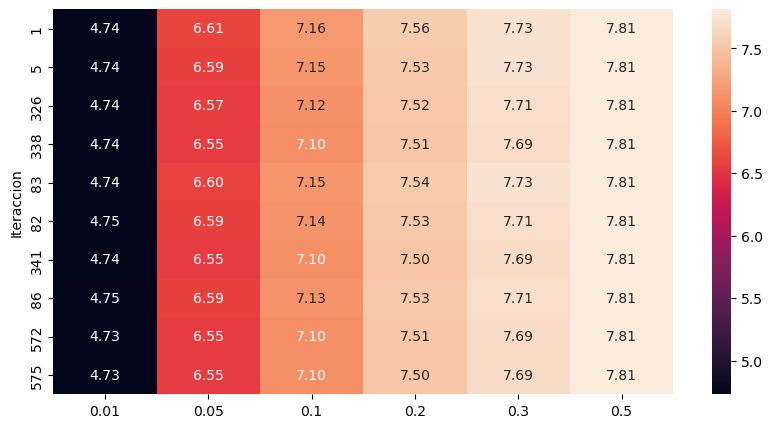

In [84]:
# sin eda train
plt.figure(figsize = (10,5))
sns.heatmap(summary, annot=True,  fmt=".2f")

<Axes: ylabel='Iteraccion'>

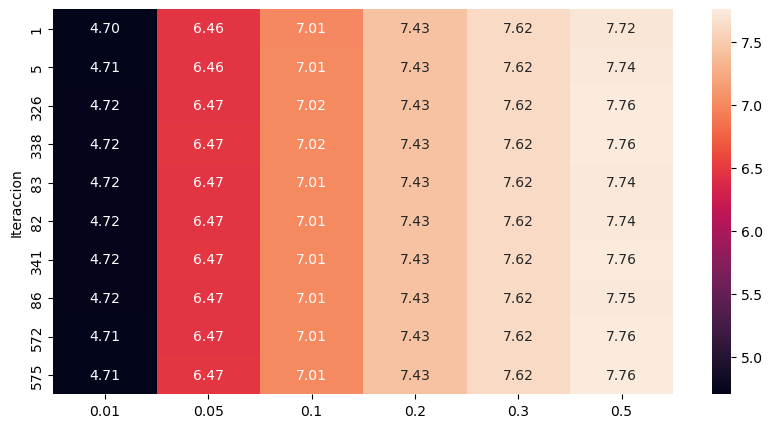

In [85]:
# sin eda test
plt.figure(figsize = (10,5))
sns.heatmap(summary_test, annot=True,  fmt=".2f")

<Axes: ylabel='Iteraccion'>

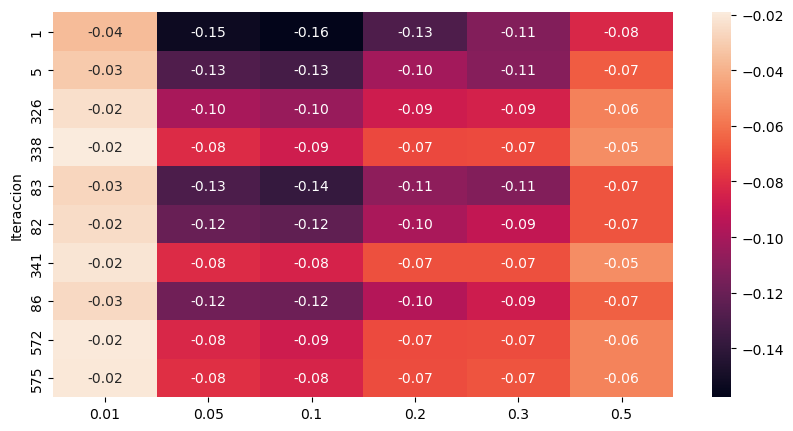

In [93]:
# sin eda test-train
plt.figure(figsize = (10,5))
sns.heatmap(summary_test -summary, annot=True,  fmt=".2f")

**Experimento 2**

<Axes: ylabel='Iteraccion'>

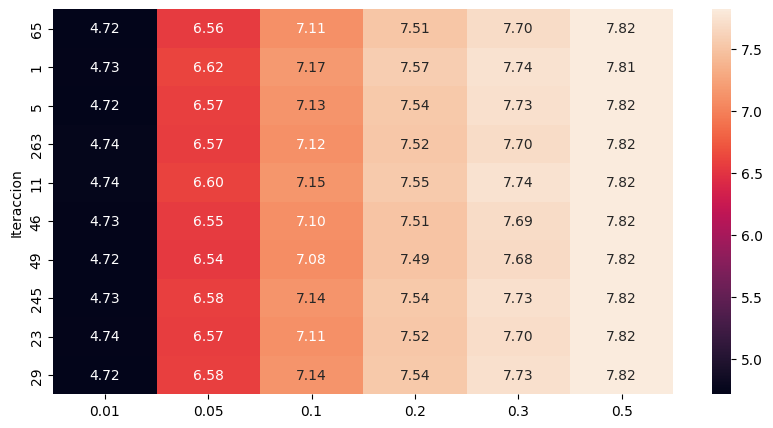

In [38]:
# sin eda train
plt.figure(figsize = (10,5))
sns.heatmap(summary, annot=True,  fmt=".2f")

<Axes: ylabel='Iteraccion'>

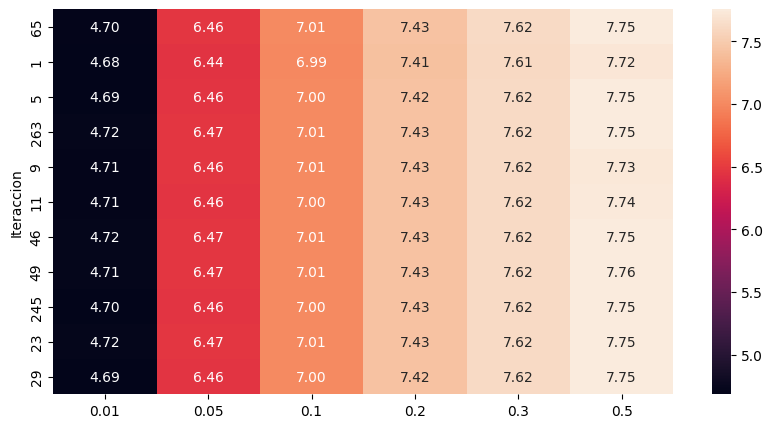

In [39]:
# sin eda train
plt.figure(figsize = (10,5))
sns.heatmap(summary_test, annot=True,  fmt=".2f")

<Axes: ylabel='Iteraccion'>

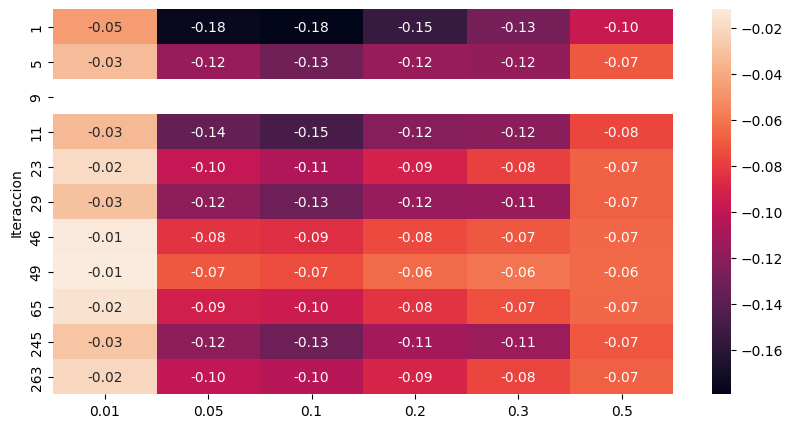

In [40]:
# sin eda test-train
plt.figure(figsize = (10,5))
sns.heatmap(summary_test -summary, annot=True,  fmt=".2f")

**Experimento 3**

<Axes: ylabel='Iteraccion'>

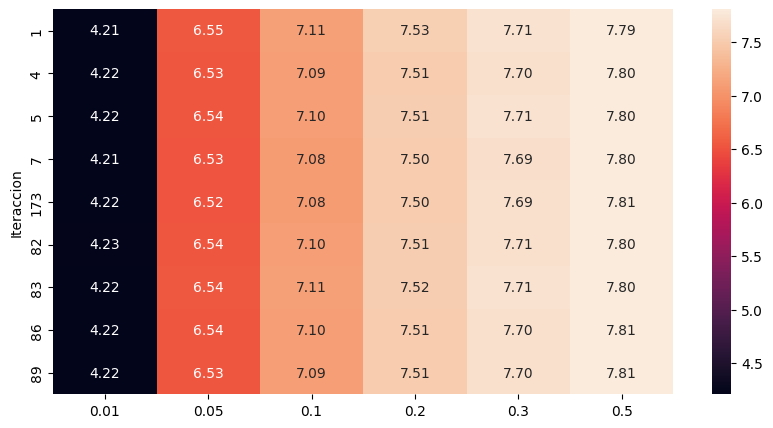

In [55]:
# con eda, prueba 3, experimento 1
plt.figure(figsize = (10,5))
sns.heatmap(summary, annot=True,  fmt=".2f")

<Axes: ylabel='Iteraccion'>

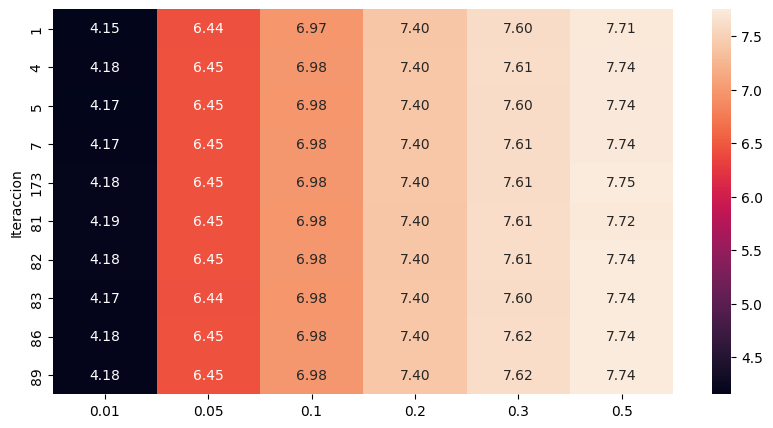

In [56]:
# con eda test, prueba 3, experimento 1
plt.figure(figsize = (10,5))
sns.heatmap(summary_test, annot=True,  fmt=".2f")

<Axes: ylabel='Iteraccion'>

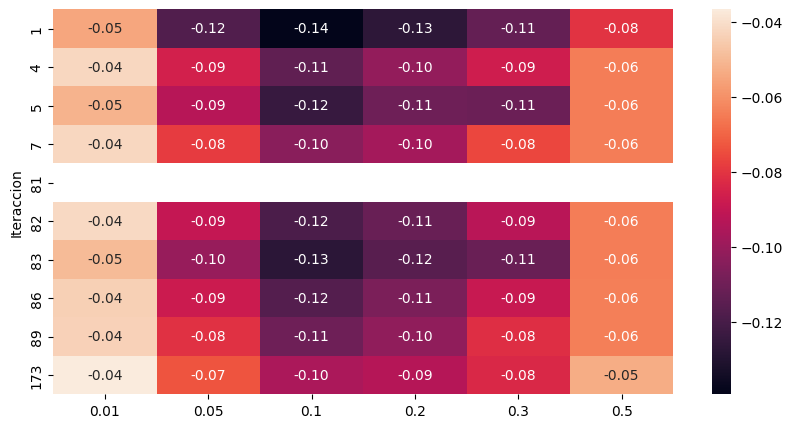

In [57]:
# con eda test-train, prueba 3, experimento 1
plt.figure(figsize = (10,5))
sns.heatmap(summary_test -summary, annot=True,  fmt=".2f")

**Experimento 4**

<Axes: ylabel='Iteraccion'>

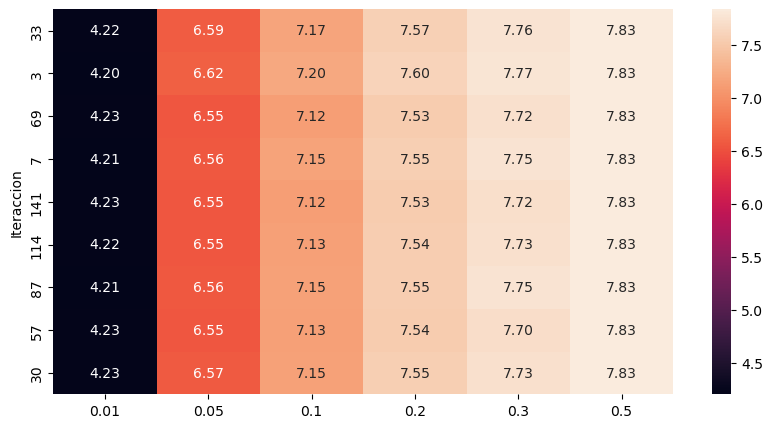

In [63]:
# con eda, prueba 4, experimento 2
plt.figure(figsize = (10,5))
sns.heatmap(summary, annot=True,  fmt=".2f")

<Axes: ylabel='Iteraccion'>

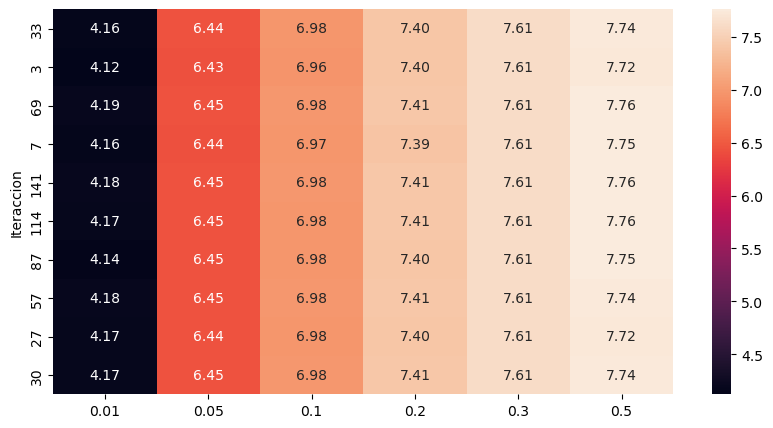

In [64]:
# con eda test, prueba 4, experimento 2
plt.figure(figsize = (10,5))
sns.heatmap(summary_test, annot=True,  fmt=".2f")

<Axes: ylabel='Iteraccion'>

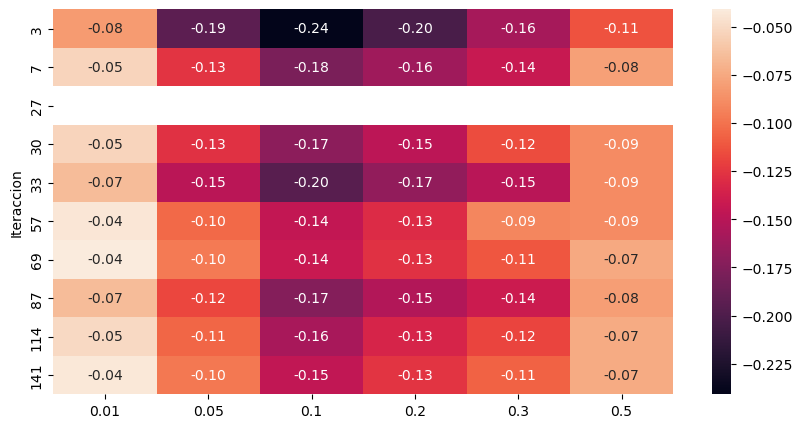

In [65]:
# con eda test-train, prueba 4, experimento 2
plt.figure(figsize = (10,5))
sns.heatmap(summary_test -summary, annot=True,  fmt=".2f")

**Prueba 5**

In [ ]:
# sin eda, prueba 5, experimento 3
plt.figure(figsize = (10,5))
sns.heatmap(summary, annot=True,  fmt=".2f")

In [ ]:
# sin eda test, prueba 5, experimento 3
plt.figure(figsize = (10,5))
sns.heatmap(summary_test, annot=True,  fmt=".2f")

In [ ]:
# con eda test-train, prueba 5, experimento 3
plt.figure(figsize = (10,5))
sns.heatmap(summary_test -summary, annot=True,  fmt=".2f")

**Prueba 6**

<Axes: ylabel='Iteraccion'>

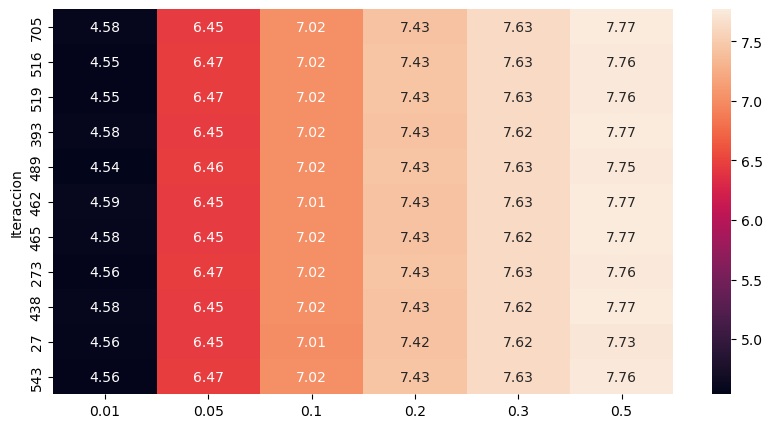

In [56]:
# sin eda, prueba 6, experimento 4
plt.figure(figsize = (10,5))
sns.heatmap(summary, annot=True,  fmt=".2f")

<Axes: ylabel='Iteraccion'>

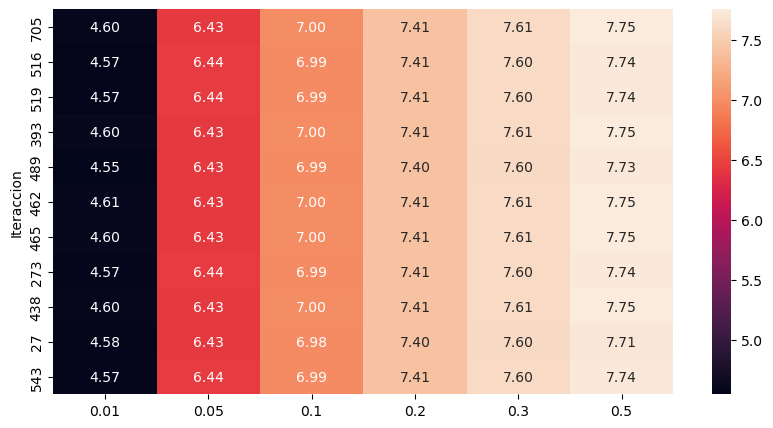

In [57]:
# sin eda test, prueba 6, experimento 4
plt.figure(figsize = (10,5))
sns.heatmap(summary_test, annot=True,  fmt=".2f")

<Axes: ylabel='Iteraccion'>

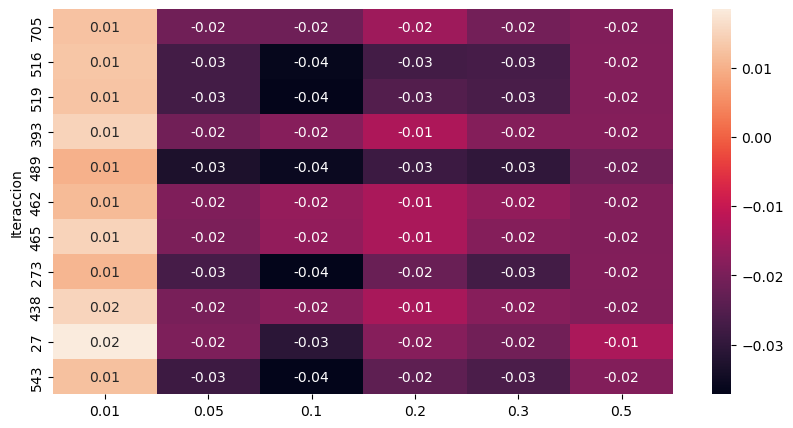

In [58]:
# con eda test-train, prueba 6, experimento 4
plt.figure(figsize = (10,5))
sns.heatmap(summary_test -summary, annot=True,  fmt=".2f")

<Axes: ylabel='Iteraccion'>

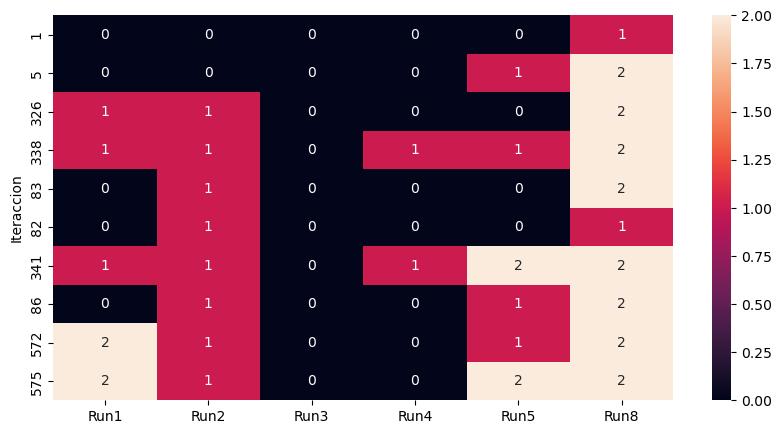

In [86]:
# sin eda, experimento1
plt.figure(figsize = (10,5)) #modelo 326 mejor
sns.heatmap(combinaciones.loc[summary.index],annot=True)

<Axes: ylabel='Iteraccion'>

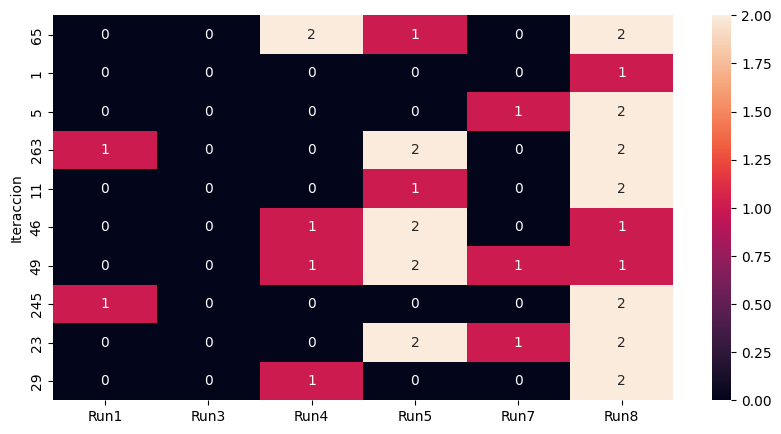

In [41]:
# sin eda, experimento2
plt.figure(figsize = (10,5)) #modelo 49 mejor y luego seria el 46
sns.heatmap(combinaciones.loc[summary.index],annot=True)

<Axes: ylabel='Iteraccion'>

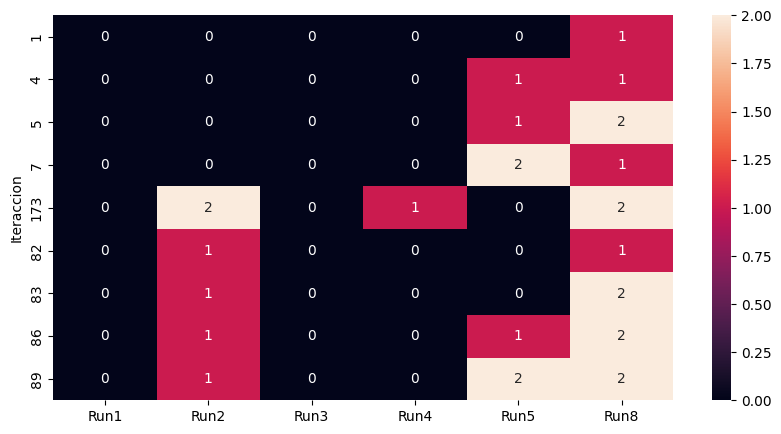

In [58]:
# con eda, experimento 1, prueba 3
plt.figure(figsize = (10,5))
sns.heatmap(combinaciones.loc[summary.index],annot=True)
# mejor modelo: 173 es muy parecido a los  86 y 89 y tiene menor sobreajuste
# modelos de preferencia pero estan un poco mas sobre-ajustados al modelo 173

<Axes: ylabel='Iteraccion'>

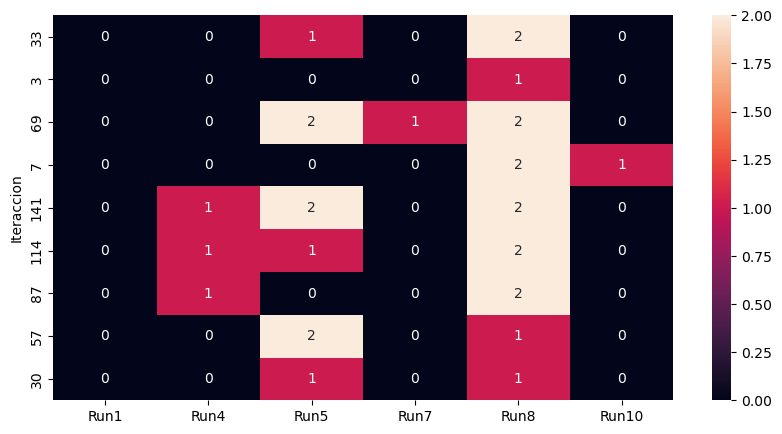

In [66]:
# con eda, experimento 2, prueba 4
plt.figure(figsize = (10,5))
sns.heatmap(combinaciones.loc[summary.index],annot=True)
# mejor modelo: 69

In [ ]:
# sin eda, experimento3, prueba 5
plt.figure(figsize = (10,5)) #mejor modelo el 659
sns.heatmap(combinaciones.loc[summary.index],annot=True)

<Axes: ylabel='Iteraccion'>

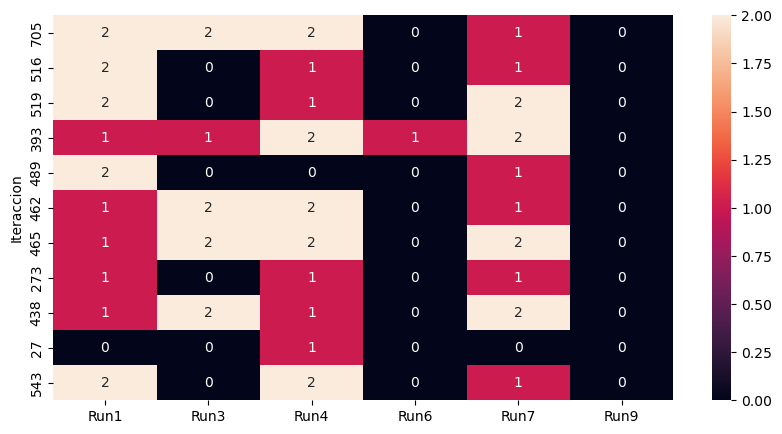

In [59]:
# sin eda, experimento4, prueba 6
plt.figure(figsize = (10,5)) #modelo 462 mejor
sns.heatmap(combinaciones.loc[summary.index],annot=True)

In [105]:
# mejor modelo
check_df

value  \
metric_name    dataset_name class_name select_model        name_model                               
backtest       test         1          best_fitting_model  Run5                           15.4502   
                                       best_model_name     Run1                            16.538   
                                       best_unbiased_model Run1                            16.538   
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]  16.6032   
               train        1          best_fitting_model  Run5                           15.5498   
                                       best_model_name     Run1                           16.7692   
                                       best_unbiased_model Run1                           16.7692   
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]  17.1364   
f1-score n_top test         1          best_fitting_model  Run5                           26.7651   
                                       best_model_name     Run1                           28.3822   
                                       best_unbiased_model Run1                           28.3822   
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]  28.4781   
               train        1          best_fitting_model  Run5                           26.9145   
                                       best_model_name     Run1                            28.722   
                                       best_unbiased_model Run1                            28.722   
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]  29.2589   
recall n_top   test         1          best_fitting_model  Run5                             100.0   
                                       best_model_name     Run1                             100.0   
                                       best_unbiased_model Run1                             100.0   
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]    100.0   
               train        1          best_fitting_model  Run5                             100.0   
                                       best_model_name     Run1                             100.0   
                                       best_unbiased_model Run1                             100.0   
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]    100.0   

                                                                                               model_name  
metric_name    dataset_name class_name select_model        name_model                                      
backtest       test         1          best_fitting_model  Run5                           random_forest_4  
                                       best_model_name     Run1                                     MLP_0  
                                       best_unbiased_model Run1                                     MLP_0  
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]         Ensamble  
               train        1          best_fitting_model  Run5                           random_forest_4  
                                       best_model_name     Run1                                     MLP_0  
                                       best_unbiased_model Run1                                     MLP_0  
                                       modelo_produccion   [0, 1, 2, 3, 5, 6, 7, 10, 11]         Ensamble  
f1-score n_top test         1          best_fitting_model  Run5                           random_forest_4  
                                       best_model_name     Run1                                     MLP_0  
                                       best_unbiased_model Run1                                     MLP_0  
                                       modelo_produccion   [0

In [ ]:
# MVP2
check_df_mvp2

In [88]:
# ensamble sin optimizar, experimento1
check_df_cientifico

metric_name  \
select_model        name_model         dataset_name class_name               
best_fitting_model  Run6               test         1             backtest   
                                       train        1             backtest   
best_model_name     Run1               test         1             backtest   
                                       train        1             backtest   
best_unbiased_model Run1               test         1             backtest   
                                       train        1             backtest   
modelo_produccion   [0, 1, 2, 3, 4, 7] test         1             backtest   
                                       train        1             backtest   

                                                                 value  \
select_model        name_model         dataset_name class_name           
best_fitting_model  Run6               test         1           2.5226   
                                       train        1           2.5272   
best_model_name     Run1               test         1           2.5336   
                                       train        1           2.5374   
best_unbiased_model Run1               test         1           2.5336   
                                       train        1           2.5374   
modelo_produccion   [0, 1, 2, 3, 4, 7] test         1           2.5405   
                                       train        1           2.5589   

                                                                     model_name  
select_model        name_model         dataset_name class_name                   
best_fitting_model  Run6               test         1           random_forest_5  
                                       train        1           random_forest_5  
best_model_name     Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
best_unbiased_model Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
modelo_produccion   [0, 1, 2, 3, 4, 7] test         1                  Ensamble  
                                       train        1                  Ensamble

In [42]:
# ensamble sin optimizar, experimento2
check_df_cientifico

metric_name  \
select_model        name_model         dataset_name class_name               
best_fitting_model  Run6               test         1             backtest   
                                       train        1             backtest   
best_model_name     Run1               test         1             backtest   
                                       train        1             backtest   
best_unbiased_model Run1               test         1             backtest   
                                       train        1             backtest   
modelo_produccion   [0, 2, 3, 4, 6, 7] test         1             backtest   
                                       train        1             backtest   

                                                                 value  \
select_model        name_model         dataset_name class_name           
best_fitting_model  Run6               test         1           2.5276   
                                       train        1           2.5338   
best_model_name     Run1               test         1           2.5345   
                                       train        1           2.5401   
best_unbiased_model Run1               test         1           2.5345   
                                       train        1           2.5401   
modelo_produccion   [0, 2, 3, 4, 6, 7] test         1           2.5385   
                                       train        1            2.554   

                                                                     model_name  
select_model        name_model         dataset_name class_name                   
best_fitting_model  Run6               test         1           random_forest_5  
                                       train        1           random_forest_5  
best_model_name     Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
best_unbiased_model Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
modelo_produccion   [0, 2, 3, 4, 6, 7] test         1                  Ensamble  
                                       train        1                  Ensamble

In [59]:
# ensamble sin optimizar, experimento1, prueba 3
check_df_cientifico

metric_name  \
select_model        name_model         dataset_name class_name               
best_fitting_model  Run9               test         1             backtest   
                                       train        1             backtest   
best_model_name     Run2               test         1             backtest   
                                       train        1             backtest   
best_unbiased_model Run1               test         1             backtest   
                                       train        1             backtest   
modelo_produccion   [0, 1, 2, 3, 4, 7] test         1             backtest   
                                       train        1             backtest   

                                                                 value  \
select_model        name_model         dataset_name class_name           
best_fitting_model  Run9               test         1           2.5167   
                                       train        1           2.5203   
best_model_name     Run2               test         1           2.5376   
                                       train        1           2.5626   
best_unbiased_model Run1               test         1           2.5227   
                                       train        1           2.5302   
modelo_produccion   [0, 1, 2, 3, 4, 7] test         1           2.5339   
                                       train        1           2.5568   

                                                                     model_name  
select_model        name_model         dataset_name class_name                   
best_fitting_model  Run9               test         1           random_forest_8  
                                       train        1           random_forest_8  
best_model_name     Run2               test         1                 xgboost_1  
                                       train        1                 xgboost_1  
best_unbiased_model Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
modelo_produccion   [0, 1, 2, 3, 4, 7] test         1                  Ensamble  
                                       train        1                  Ensamble

In [67]:
# ensamble sin optimizar, experimento2, prueba 4
check_df_cientifico

metric_name  \
select_model        name_model         dataset_name class_name               
best_fitting_model  Run3               test         1             backtest   
                                       train        1             backtest   
best_model_name     Run1               test         1             backtest   
                                       train        1             backtest   
best_unbiased_model Run1               test         1             backtest   
                                       train        1             backtest   
modelo_produccion   [0, 3, 4, 6, 7, 9] test         1             backtest   
                                       train        1             backtest   

                                                                 value  \
select_model        name_model         dataset_name class_name           
best_fitting_model  Run3               test         1            2.512   
                                       train        1           2.5174   
best_model_name     Run1               test         1           2.5206   
                                       train        1            2.529   
best_unbiased_model Run1               test         1           2.5206   
                                       train        1            2.529   
modelo_produccion   [0, 3, 4, 6, 7, 9] test         1           2.5332   
                                       train        1            2.555   

                                                                     model_name  
select_model        name_model         dataset_name class_name                   
best_fitting_model  Run3               test         1           random_forest_2  
                                       train        1           random_forest_2  
best_model_name     Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
best_unbiased_model Run1               test         1                     MLP_0  
                                       train        1                     MLP_0  
modelo_produccion   [0, 3, 4, 6, 7, 9] test         1                  Ensamble  
                                       train        1                  Ensamble

In [ ]:
# ensamble sin optimizar, experimento3, prueba 5
check_df_cientifico

In [60]:
# ensamble sin optimizar, experimento4, prueba 6
check_df_cientifico

metric_name  \
select_model        name_model         dataset_name class_name               
best_fitting_model  Run6               test         1             backtest   
                                       train        1             backtest   
best_model_name     Run4               test         1             backtest   
                                       train        1             backtest   
best_unbiased_model Run3               test         1             backtest   
                                       train        1             backtest   
modelo_produccion   [0, 2, 3, 5, 6, 8] test         1             backtest   
                                       train        1             backtest   

                                                                 value  \
select_model        name_model         dataset_name class_name           
best_fitting_model  Run6               test         1           2.5215   
                                       train        1           2.5282   
best_model_name     Run4               test         1           2.5334   
                                       train        1           2.5402   
best_unbiased_model Run3               test         1           2.5254   
                                       train        1           2.5303   
modelo_produccion   [0, 2, 3, 5, 6, 8] test         1           2.5345   
                                       train        1           2.5401   

                                                                     model_name  
select_model        name_model         dataset_name class_name                   
best_fitting_model  Run6               test         1           random_forest_5  
                                       train        1           random_forest_5  
best_model_name     Run4               test         1                     MLP_3  
                                       train        1                     MLP_3  
best_unbiased_model Run3               test         1           random_forest_2  
                                       train        1           random_forest_2  
modelo_produccion   [0, 2, 3, 5, 6, 8] test         1                  Ensamble  
                                       train        1                  Ensamble

In [42]:
info_save_select_ensamble = catalog.load("info_save_select") # modelo generado, experimento 1
print('Run_name: ',info_save_select_ensamble['modelo_produccion']['nodos_select'])
print('W: ',info_save_select_ensamble['modelo_produccion']['weights'])
check_df_opt = info_save_select_ensamble['select_model2']
check_df_opt = check_df_opt[np.in1d(check_df_opt.index.get_level_values(1),['backtest','recall n_top','Precision n_top','f1-score n_top'])].reset_index() 
check_df_opt = check_df_opt[check_df_opt['class_name'].isin([1,1.0,'1','1.0'])]
check_df_opt = check_df_opt.set_index(['metric_name','dataset_name','class_name','select_model','name_model']).sort_index()
check_df_opt

Run_name:  [0, 1, 7]
W:  [1, 1, 2]


value  \
metric_name     dataset_name class_name select_model        name_model           
Precision n_top test         1          best_fitting_model  Run6        2.5226   
                                        best_model_name     Run1        2.5336   
                                        best_unbiased_model Run1        2.5336   
                                        modelo_produccion   [0, 1, 7]    2.541   
                train        1          best_fitting_model  Run6        2.5272   
                                        best_model_name     Run1        2.5374   
                                        best_unbiased_model Run1        2.5374   
                                        modelo_produccion   [0, 1, 7]   2.5694   
backtest        test         1          best_fitting_model  Run6        2.5226   
                                        best_model_name     Run1        2.5336   
                                        best_unbiased_model Run1        2.5336   
                                        modelo_produccion   [0, 1, 7]    2.541   
                train        1          best_fitting_model  Run6        2.5272   
                                        best_model_name     Run1        2.5374   
                                        best_unbiased_model Run1        2.5374   
                                        modelo_produccion   [0, 1, 7]   2.5694   
f1-score n_top  test         1          best_fitting_model  Run6        4.9211   
                                        best_model_name     Run1        4.9419   
                                        best_unbiased_model Run1        4.9419   
                                        modelo_produccion   [0, 1, 7]    4.956   
                train        1          best_fitting_model  Run6        4.9298   
                                        best_model_name     Run1        4.9492   
                                        best_unbiased_model Run1        4.9492   
                                        modelo_produccion   [0, 1, 7]     5.01   
recall n_top    test         1          best_fitting_model  Run6         100.0   
                                        best_model_name     Run1         100.0   
                                        best_unbiased_model Run1         100.0   
                                        modelo_produccion   [0, 1, 7]    100.0   
                train        1          best_fitting_model  Run6         100.0   
                                        best_model_name     Run1         100.0   
                                        best_unbiased_model Run1         100.0   
                                        modelo_produccion   [0, 1, 7]    100.0   

                                                                             model_name  
metric_name     dataset_name class_name select_model        name_model                   
Precision n_top test         1          best_fitting_model  Run6        random_forest_5  
                                        best_model_name     Run1                  MLP_0  
                                        best_unbiased_model Run1                  MLP_0  
                                        modelo_produccion   [0, 1, 7]          Ensamble  
                train        1          best_fitting_model  Run6        random_forest_5  
                                        best_model_name     Run1                  MLP_0  
                                        best_unbiased_model Run1                  MLP_0  
                                        modelo_produccion   [0, 1, 7]          Ensamble  
backtest        test         1          best_fitting_model  Run6        random_forest_5  
                                        best_model_name     Run1                  MLP_0  
                                        best_unbiased_model Run1                  MLP_0  
                                        modelo_produccion   [0, 1, 7]          Ensamble  
                train   

In [9]:
info_save_select_ensamble = catalog.load("info_save_select") # modelo generado, experimento 2
print('Run_name: ',info_save_select_ensamble['modelo_produccion']['nodos_select'])
print('W: ',info_save_select_ensamble['modelo_produccion']['weights'])
check_df_opt = info_save_select_ensamble['select_model2']
check_df_opt = check_df_opt[np.in1d(check_df_opt.index.get_level_values(1),['backtest','recall n_top','Precision n_top','f1-score n_top'])].reset_index() 
check_df_opt = check_df_opt[check_df_opt['class_name'].isin([1,1.0,'1','1.0'])]
check_df_opt = check_df_opt.set_index(['metric_name','dataset_name','class_name','select_model','name_model']).sort_index()
check_df_opt

[01/24/25 18:24:08] INFO     Loading data from 'info_save_select' (PickleDataSet)...            ]8;id=575276;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=745937;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\

Run_name:  [3, 4, 6, 7]
W:  [1, 2, 1, 1]


value  \
metric_name     dataset_name class_name select_model        name_model             
Precision n_top test         1          best_fitting_model  Run6          2.5276   
                                        best_model_name     Run1          2.5345   
                                        best_unbiased_model Run1          2.5345   
                                        modelo_produccion   [3, 4, 6, 7]  2.5415   
                train        1          best_fitting_model  Run6          2.5338   
                                        best_model_name     Run1          2.5401   
                                        best_unbiased_model Run1          2.5401   
                                        modelo_produccion   [3, 4, 6, 7]  2.5616   
backtest        test         1          best_fitting_model  Run6          2.5276   
                                        best_model_name     Run1          2.5345   
                                        best_unbiased_model Run1          2.5345   
                                        modelo_produccion   [3, 4, 6, 7]  2.5415   
                train        1          best_fitting_model  Run6          2.5338   
                                        best_model_name     Run1          2.5401   
                                        best_unbiased_model Run1          2.5401   
                                        modelo_produccion   [3, 4, 6, 7]  2.5616   
f1-score n_top  test         1          best_fitting_model  Run6          4.9306   
                                        best_model_name     Run1          4.9436   
                                        best_unbiased_model Run1          4.9436   
                                        modelo_produccion   [3, 4, 6, 7]  4.9569   
                train        1          best_fitting_model  Run6          4.9424   
                                        best_model_name     Run1          4.9544   
                                        best_unbiased_model Run1          4.9544   
                                        modelo_produccion   [3, 4, 6, 7]  4.9953   
recall n_top    test         1          best_fitting_model  Run6           100.0   
                                        best_model_name     Run1           100.0   
                                        best_unbiased_model Run1           100.0   
                                        modelo_produccion   [3, 4, 6, 7]   100.0   
                train        1          best_fitting_model  Run6           100.0   
                                        best_model_name     Run1           100.0   
                                        best_unbiased_model Run1           100.0   
                                        modelo_produccion   [3, 4, 6, 7]   100.0   

                                                                               model_name  
metric_name     dataset_name class_name select_model        name_model                     
Precision n_top test         1          best_fitting_model  Run6          random_forest_5  
                                        best_model_name     Run1                    MLP_0  
                                        best_unbiased_model Run1                    MLP_0  
                                        modelo_produccion   [3, 4, 6, 7]         Ensamble  
                train        1          best_fitting_model  Run6          random_forest_5  
                                        best_model_name     Run1                    MLP_0  
                                        best_unbiased_model Run1                    MLP_0  
                                        modelo_produccion   [3, 4, 6, 7]         Ensamble  
backtest        test         1          best_fitting_model  Run6          random_forest_5  
                                        best_model_name     Run1                    MLP_0  
                                        best_unbiased_model Run1                    MLP_0  
                      

In [68]:
info_save_select_ensamble = catalog.load("info_save_select_experimento_1_y_2") # modelo mix generado por el experimento 1 y experimento 2
print('Run_name: ',info_save_select_ensamble['modelo_produccion']['nodos_select'])
print('W: ',info_save_select_ensamble['modelo_produccion']['weights'])
check_df_opt = info_save_select_ensamble['select_model2']
check_df_opt = check_df_opt[np.in1d(check_df_opt.index.get_level_values(1),['backtest','recall n_top','Precision n_top','f1-score n_top'])].reset_index() 
check_df_opt = check_df_opt[check_df_opt['class_name'].isin([1,1.0,'1','1.0'])]
check_df_opt = check_df_opt.set_index(['metric_name','dataset_name','class_name','select_model','name_model']).sort_index()
check_df_opt

[01/30/25 22:29:02] INFO     Loading data from 'info_save_select_experimento_1_y_2'             ]8;id=388732;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=452394;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

Run_name:  [0, 1, 4, 7, 19]
W:  [1, 2, 2, 2, 1]


value  \
metric_name     dataset_name class_name select_model        name_model                 
Precision n_top test         1          best_fitting_model  Run18             2.5276   
                                        best_model_name     Run13             2.5345   
                                        best_unbiased_model Run13             2.5345   
                                        modelo_produccion   [0, 1, 4, 7, 19]  2.5415   
                train        1          best_fitting_model  Run18             2.5338   
                                        best_model_name     Run13             2.5401   
                                        best_unbiased_model Run13             2.5401   
                                        modelo_produccion   [0, 1, 4, 7, 19]  2.5674   
backtest        test         1          best_fitting_model  Run18             2.5276   
                                        best_model_name     Run13             2.5345   
                                        best_unbiased_model Run13             2.5345   
                                        modelo_produccion   [0, 1, 4, 7, 19]  2.5415   
                train        1          best_fitting_model  Run18             2.5338   
                                        best_model_name     Run13             2.5401   
                                        best_unbiased_model Run13             2.5401   
                                        modelo_produccion   [0, 1, 4, 7, 19]  2.5674   
f1-score n_top  test         1          best_fitting_model  Run18             4.9306   
                                        best_model_name     Run13             4.9436   
                                        best_unbiased_model Run13             4.9436   
                                        modelo_produccion   [0, 1, 4, 7, 19]  4.9569   
                train        1          best_fitting_model  Run18             4.9424   
                                        best_model_name     Run13             4.9544   
                                        best_unbiased_model Run13             4.9544   
                                        modelo_produccion   [0, 1, 4, 7, 19]  5.0063   
recall n_top    test         1          best_fitting_model  Run18              100.0   
                                        best_model_name     Run13              100.0   
                                        best_unbiased_model Run13              100.0   
                                        modelo_produccion   [0, 1, 4, 7, 19]   100.0   
                train        1          best_fitting_model  Run18              100.0   
                                        best_model_name     Run13              100.0   
                                        best_unbiased_model Run13              100.0   
                                        modelo_produccion   [0, 1, 4, 7, 19]   100.0   

                                                                                    model_name  
metric_name     dataset_name class_name select_model        name_model                          
Precision n_top test         1          best_fitting_model  Run18             random_forest_17  
                                        best_model_name     Run13                       MLP_12  
                                        best_unbiased_model Run13                       MLP_12  
                                        modelo_produccion   [0, 1, 4, 7, 19]          Ensamble  
                train        1          best_fitting_model  Run18             random_forest_17  
                                        best_model_name     Run13                       MLP_12  
                                        best_unbiased_model Run13                       MLP_12  
                                        modelo_produccion   [0, 1, 4, 7, 19]          Ensamble  
backtest        test         1          best_fitting_model  Run18             random_forest_17  
                   

In [8]:
info_save_select_ensamble = catalog.load("info_save_select") # mejor modelo: 173, experimento 1, prueba 3
print('Run_name: ',info_save_select_ensamble['modelo_produccion']['nodos_select'])
print('W: ',info_save_select_ensamble['modelo_produccion']['weights'])
check_df_opt = info_save_select_ensamble['select_model2']
check_df_opt = check_df_opt[np.in1d(check_df_opt.index.get_level_values(1),['backtest','recall n_top','Precision n_top','f1-score n_top'])].reset_index() 
check_df_opt = check_df_opt[check_df_opt['class_name'].isin([1,1.0,'1','1.0'])]
check_df_opt = check_df_opt.set_index(['metric_name','dataset_name','class_name','select_model','name_model']).sort_index()
check_df_opt

[01/29/25 15:32:02] INFO     Loading data from 'info_save_select' (PickleDataSet)...            ]8;id=459161;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=17739;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\

Run_name:  [1, 3, 7]
W:  [2, 1, 2]


value  \
metric_name     dataset_name class_name select_model        name_model           
Precision n_top test         1          best_fitting_model  Run9        2.5167   
                                        best_model_name     Run2        2.5376   
                                        best_unbiased_model Run1        2.5227   
                                        modelo_produccion   [1, 3, 7]    2.537   
                train        1          best_fitting_model  Run9        2.5203   
                                        best_model_name     Run2        2.5626   
                                        best_unbiased_model Run1        2.5302   
                                        modelo_produccion   [1, 3, 7]   2.5647   
backtest        test         1          best_fitting_model  Run9        2.5167   
                                        best_model_name     Run2        2.5376   
                                        best_unbiased_model Run1        2.5227   
                                        modelo_produccion   [1, 3, 7]    2.537   
                train        1          best_fitting_model  Run9        2.5203   
                                        best_model_name     Run2        2.5626   
                                        best_unbiased_model Run1        2.5302   
                                        modelo_produccion   [1, 3, 7]   2.5647   
f1-score n_top  test         1          best_fitting_model  Run9        4.9098   
                                        best_model_name     Run2        4.9496   
                                        best_unbiased_model Run1        4.9212   
                                        modelo_produccion   [1, 3, 7]   4.9484   
                train        1          best_fitting_model  Run9        4.9167   
                                        best_model_name     Run2        4.9971   
                                        best_unbiased_model Run1        4.9356   
                                        modelo_produccion   [1, 3, 7]   5.0011   
recall n_top    test         1          best_fitting_model  Run9         100.0   
                                        best_model_name     Run2         100.0   
                                        best_unbiased_model Run1         100.0   
                                        modelo_produccion   [1, 3, 7]    100.0   
                train        1          best_fitting_model  Run9         100.0   
                                        best_model_name     Run2         100.0   
                                        best_unbiased_model Run1         100.0   
                                        modelo_produccion   [1, 3, 7]    100.0   

                                                                             model_name  
metric_name     dataset_name class_name select_model        name_model                   
Precision n_top test         1          best_fitting_model  Run9        random_forest_8  
                                        best_model_name     Run2              xgboost_1  
                                        best_unbiased_model Run1                  MLP_0  
                                        modelo_produccion   [1, 3, 7]          Ensamble  
                train        1          best_fitting_model  Run9        random_forest_8  
                                        best_model_name     Run2              xgboost_1  
                                        best_unbiased_model Run1                  MLP_0  
                                        modelo_produccion   [1, 3, 7]          Ensamble  
backtest        test         1          best_fitting_model  Run9        random_forest_8  
                                        best_model_name     Run2              xgboost_1  
                                        best_unbiased_model Run1                  MLP_0  
                                        modelo_produccion   [1, 3, 7]          Ensamble  
                train   

In [8]:
info_save_select_ensamble = catalog.load("info_save_select_experimento4") # mejor modelo: 69, experimento 2, prueba 4
print('Run_name: ',info_save_select_ensamble['modelo_produccion']['nodos_select'])
print('W: ',info_save_select_ensamble['modelo_produccion']['weights'])
check_df_opt = info_save_select_ensamble['select_model2']
check_df_opt = check_df_opt[np.in1d(check_df_opt.index.get_level_values(1),['backtest','recall n_top','Precision n_top','f1-score n_top'])].reset_index() 
check_df_opt = check_df_opt[check_df_opt['class_name'].isin([1,1.0,'1','1.0'])]
check_df_opt = check_df_opt.set_index(['metric_name','dataset_name','class_name','select_model','name_model']).sort_index()
check_df_opt

[01/31/25 13:40:31] INFO     Loading data from 'info_save_select_experimento4'                  ]8;id=624679;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=655194;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

Run_name:  [4, 6, 7]
W:  [2, 1, 2]


value  \
metric_name     dataset_name class_name select_model        name_model           
Precision n_top test         1          best_fitting_model  Run3         2.512   
                                        best_model_name     Run1        2.5206   
                                        best_unbiased_model Run1        2.5206   
                                        modelo_produccion   [4, 6, 7]   2.5364   
                train        1          best_fitting_model  Run3        2.5174   
                                        best_model_name     Run1         2.529   
                                        best_unbiased_model Run1         2.529   
                                        modelo_produccion   [4, 6, 7]   2.5736   
backtest        test         1          best_fitting_model  Run3         2.512   
                                        best_model_name     Run1        2.5206   
                                        best_unbiased_model Run1        2.5206   
                                        modelo_produccion   [4, 6, 7]   2.5364   
                train        1          best_fitting_model  Run3        2.5174   
                                        best_model_name     Run1         2.529   
                                        best_unbiased_model Run1         2.529   
                                        modelo_produccion   [4, 6, 7]   2.5736   
f1-score n_top  test         1          best_fitting_model  Run3        4.9009   
                                        best_model_name     Run1        4.9172   
                                        best_unbiased_model Run1        4.9172   
                                        modelo_produccion   [4, 6, 7]   4.9474   
                train        1          best_fitting_model  Run3        4.9111   
                                        best_model_name     Run1        4.9332   
                                        best_unbiased_model Run1        4.9332   
                                        modelo_produccion   [4, 6, 7]   5.0181   
recall n_top    test         1          best_fitting_model  Run3         100.0   
                                        best_model_name     Run1         100.0   
                                        best_unbiased_model Run1         100.0   
                                        modelo_produccion   [4, 6, 7]    100.0   
                train        1          best_fitting_model  Run3         100.0   
                                        best_model_name     Run1         100.0   
                                        best_unbiased_model Run1         100.0   
                                        modelo_produccion   [4, 6, 7]    100.0   

                                                                             model_name  
metric_name     dataset_name class_name select_model        name_model                   
Precision n_top test         1          best_fitting_model  Run3        random_forest_2  
                                        best_model_name     Run1                  MLP_0  
                                        best_unbiased_model Run1                  MLP_0  
                                        modelo_produccion   [4, 6, 7]          Ensamble  
                train        1          best_fitting_model  Run3        random_forest_2  
                                        best_model_name     Run1                  MLP_0  
                                        best_unbiased_model Run1                  MLP_0  
                                        modelo_produccion   [4, 6, 7]          Ensamble  
backtest        test         1          best_fitting_model  Run3        random_forest_2  
                                        best_model_name     Run1                  MLP_0  
                                        best_unbiased_model Run1                  MLP_0  
                                        modelo_produccion   [4, 6, 7]          Ensamble  
                train   

In [ ]:
info_save_select_ensamble = catalog.load("info_save_select_experimento4") # mejor modelo: , experimento 3, prueba 5
print('Run_name: ',info_save_select_ensamble['modelo_produccion']['nodos_select'])
print('W: ',info_save_select_ensamble['modelo_produccion']['weights'])
check_df_opt = info_save_select_ensamble['select_model2']
check_df_opt = check_df_opt[np.in1d(check_df_opt.index.get_level_values(1),['backtest','recall n_top','Precision n_top','f1-score n_top'])].reset_index() 
check_df_opt = check_df_opt[check_df_opt['class_name'].isin([1,1.0,'1','1.0'])]
check_df_opt = check_df_opt.set_index(['metric_name','dataset_name','class_name','select_model','name_model']).sort_index()
check_df_opt

In [61]:
info_save_select_ensamble = catalog.load("info_save_select_experimento4") # mejor modelo: 462, experimento 4, prueba 6
print('Run_name: ',info_save_select_ensamble['modelo_produccion']['nodos_select'])
print('W: ',info_save_select_ensamble['modelo_produccion']['weights'])
check_df_opt = info_save_select_ensamble['select_model2']
check_df_opt = check_df_opt[np.in1d(check_df_opt.index.get_level_values(1),['backtest','recall n_top','Precision n_top','f1-score n_top'])].reset_index() 
check_df_opt = check_df_opt[check_df_opt['class_name'].isin([1,1.0,'1','1.0'])]
check_df_opt = check_df_opt.set_index(['metric_name','dataset_name','class_name','select_model','name_model']).sort_index()
check_df_opt

[02/03/25 15:53:32] INFO     Loading data from 'info_save_select_experimento4'                  ]8;id=783327;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=61418;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

Run_name:  [4, 6, 7]
W:  [2, 1, 2]


value  \
metric_name     dataset_name class_name select_model        name_model           
Precision n_top test         1          best_fitting_model  Run3         2.512   
                                        best_model_name     Run1        2.5206   
                                        best_unbiased_model Run1        2.5206   
                                        modelo_produccion   [4, 6, 7]   2.5364   
                train        1          best_fitting_model  Run3        2.5174   
                                        best_model_name     Run1         2.529   
                                        best_unbiased_model Run1         2.529   
                                        modelo_produccion   [4, 6, 7]   2.5736   
backtest        test         1          best_fitting_model  Run3         2.512   
                                        best_model_name     Run1        2.5206   
                                        best_unbiased_model Run1        2.5206   
                                        modelo_produccion   [4, 6, 7]   2.5364   
                train        1          best_fitting_model  Run3        2.5174   
                                        best_model_name     Run1         2.529   
                                        best_unbiased_model Run1         2.529   
                                        modelo_produccion   [4, 6, 7]   2.5736   
f1-score n_top  test         1          best_fitting_model  Run3        4.9009   
                                        best_model_name     Run1        4.9172   
                                        best_unbiased_model Run1        4.9172   
                                        modelo_produccion   [4, 6, 7]   4.9474   
                train        1          best_fitting_model  Run3        4.9111   
                                        best_model_name     Run1        4.9332   
                                        best_unbiased_model Run1        4.9332   
                                        modelo_produccion   [4, 6, 7]   5.0181   
recall n_top    test         1          best_fitting_model  Run3         100.0   
                                        best_model_name     Run1         100.0   
                                        best_unbiased_model Run1         100.0   
                                        modelo_produccion   [4, 6, 7]    100.0   
                train        1          best_fitting_model  Run3         100.0   
                                        best_model_name     Run1         100.0   
                                        best_unbiased_model Run1         100.0   
                                        modelo_produccion   [4, 6, 7]    100.0   

                                                                             model_name  
metric_name     dataset_name class_name select_model        name_model                   
Precision n_top test         1          best_fitting_model  Run3        random_forest_2  
                                        best_model_name     Run1                  MLP_0  
                                        best_unbiased_model Run1                  MLP_0  
                                        modelo_produccion   [4, 6, 7]          Ensamble  
                train        1          best_fitting_model  Run3        random_forest_2  
                                        best_model_name     Run1                  MLP_0  
                                        best_unbiased_model Run1                  MLP_0  
                                        modelo_produccion   [4, 6, 7]          Ensamble  
backtest        test         1          best_fitting_model  Run3        random_forest_2  
                                        best_model_name     Run1                  MLP_0  
                                        best_unbiased_model Run1                  MLP_0  
                                        modelo_produccion   [4, 6, 7]          Ensamble  
                train   

## backtesting

In [13]:
#info_save_select = catalog.load("info_save_select") # dio mejor en el backtesting
info_save_select = info_save_select_ensamble.copy()
print('Run_name: ',info_save_select['modelo_produccion']['nodos_select'])
print('W: ',info_save_select['modelo_produccion']['weights'])
check_df_opt = info_save_select_ensamble['select_model2']
check_df_opt = check_df_opt[np.in1d(check_df_opt.index.get_level_values(1),['backtest','recall n_top','Precision n_top','f1-score n_top'])].reset_index() 
check_df_opt = check_df_opt[check_df_opt['class_name'].isin([1,1.0,'1','1.0'])]
check_df_opt = check_df_opt.set_index(['metric_name','dataset_name','class_name','select_model','name_model']).sort_index()
check_df_opt

Run_name:  [3, 4, 6, 7]
W:  [1, 2, 1, 1]


value  \
metric_name     dataset_name class_name select_model        name_model             
Precision n_top test         1          best_fitting_model  Run6          2.5276   
                                        best_model_name     Run1          2.5345   
                                        best_unbiased_model Run1          2.5345   
                                        modelo_produccion   [3, 4, 6, 7]  2.5415   
                train        1          best_fitting_model  Run6          2.5338   
                                        best_model_name     Run1          2.5401   
                                        best_unbiased_model Run1          2.5401   
                                        modelo_produccion   [3, 4, 6, 7]  2.5616   
backtest        test         1          best_fitting_model  Run6          2.5276   
                                        best_model_name     Run1          2.5345   
                                        best_unbiased_model Run1          2.5345   
                                        modelo_produccion   [3, 4, 6, 7]  2.5415   
                train        1          best_fitting_model  Run6          2.5338   
                                        best_model_name     Run1          2.5401   
                                        best_unbiased_model Run1          2.5401   
                                        modelo_produccion   [3, 4, 6, 7]  2.5616   
f1-score n_top  test         1          best_fitting_model  Run6          4.9306   
                                        best_model_name     Run1          4.9436   
                                        best_unbiased_model Run1          4.9436   
                                        modelo_produccion   [3, 4, 6, 7]  4.9569   
                train        1          best_fitting_model  Run6          4.9424   
                                        best_model_name     Run1          4.9544   
                                        best_unbiased_model Run1          4.9544   
                                        modelo_produccion   [3, 4, 6, 7]  4.9953   
recall n_top    test         1          best_fitting_model  Run6           100.0   
                                        best_model_name     Run1           100.0   
                                        best_unbiased_model Run1           100.0   
                                        modelo_produccion   [3, 4, 6, 7]   100.0   
                train        1          best_fitting_model  Run6           100.0   
                                        best_model_name     Run1           100.0   
                                        best_unbiased_model Run1           100.0   
                                        modelo_produccion   [3, 4, 6, 7]   100.0   

                                                                               model_name  
metric_name     dataset_name class_name select_model        name_model                     
Precision n_top test         1          best_fitting_model  Run6          random_forest_5  
                                        best_model_name     Run1                    MLP_0  
                                        best_unbiased_model Run1                    MLP_0  
                                        modelo_produccion   [3, 4, 6, 7]         Ensamble  
                train        1          best_fitting_model  Run6          random_forest_5  
                                        best_model_name     Run1                    MLP_0  
                                        best_unbiased_model Run1                    MLP_0  
                                        modelo_produccion   [3, 4, 6, 7]         Ensamble  
backtest        test         1          best_fitting_model  Run6          random_forest_5  
                                        best_model_name     Run1                    MLP_0  
                                        best_unbiased_model Run1                    MLP_0  
                      

In [14]:
try:
    display(info_save_select["modelo_produccion"]['Scaler'].reindex_OneHotEncoding)
    display(info_save_select["modelo_produccion"]['ks_test'])
    display(info_save_select["modelo_produccion"]['ks_train'])
except:
    display(info_save_select[info_save_select["modelo_produccion"]['nodos_select'][0]]['Scaler'].reindex_OneHotEncoding)

,REINDEX,ocupacion
llave,,
0,ocupacion_comerciante,empleado_privado
1,ocupacion_desempleado,pensionado
2,ocupacion_empleado_entidad,empleado_publico
3,ocupacion_empleado_privado,independiente
4,ocupacion_empleado_publico,estudiante
5,ocupacion_estudiante,rentista_de_capital
6,ocupacion_fuerzas_militares,hogar
7,ocupacion_hogar,fuerzas_militares
8,ocupacion_independiente,desempleado


In [15]:
print(info_save_select["modelo_produccion"]["model_name"])
print(info_save_select["modelo_produccion"]["name_model"])
if info_save_select["modelo_produccion"]["model_name"] == "Ensamble":
    print(info_save_select["modelo_produccion"]["nodos_select"])
    print(info_save_select["modelo_produccion"]["weights"])

Ensamble

[3, 4, 6, 7]
[1, 2, 1, 1]


In [8]:
#save_backtesting = catalog.load("data_backtesting_202411")
save_backtesting = catalog.load("data_backtesting")

[01/14/25 16:41:08] INFO     Loading data from 'data_backtesting_202411' (PickleDataSet)...     ]8;id=329686;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=583040;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\

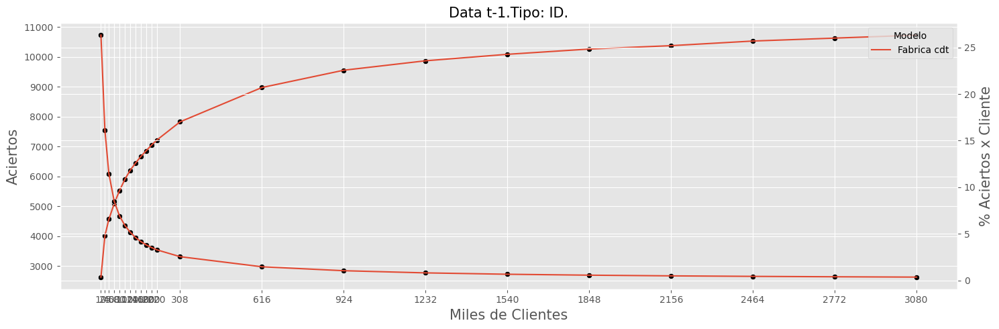

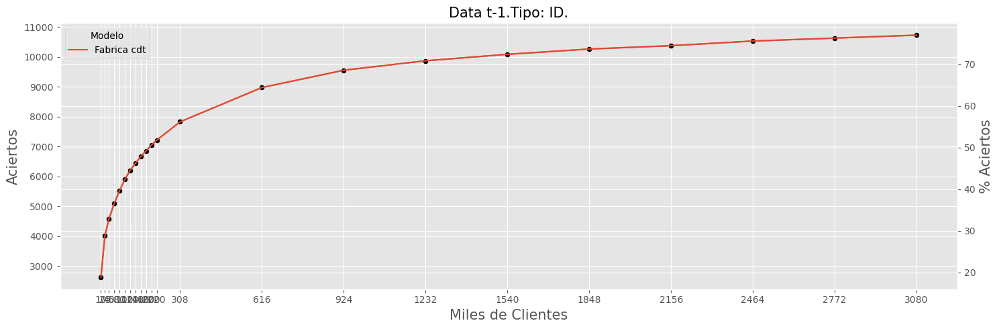

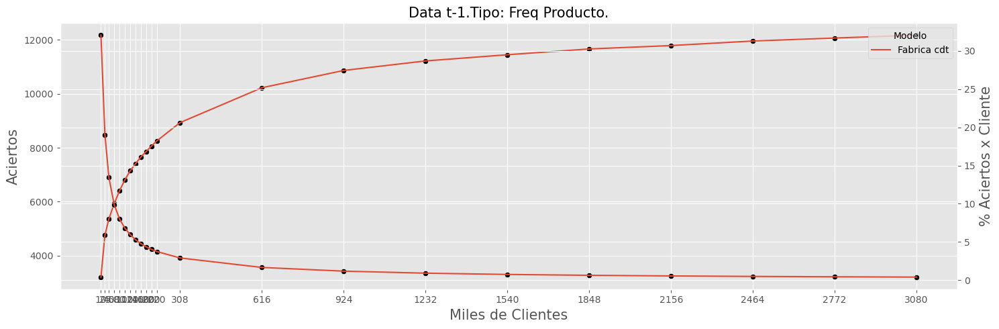

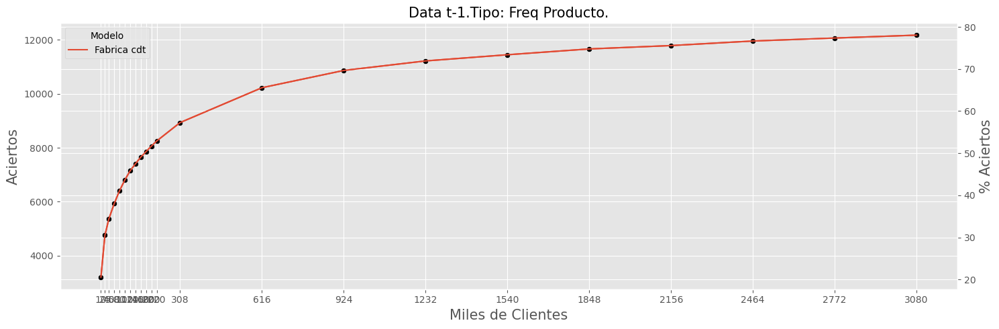

[01/14/25 16:45:01] INFO     ---------------------------------------------------                       ]8;id=428723;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=142524;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#312\312]8;;\

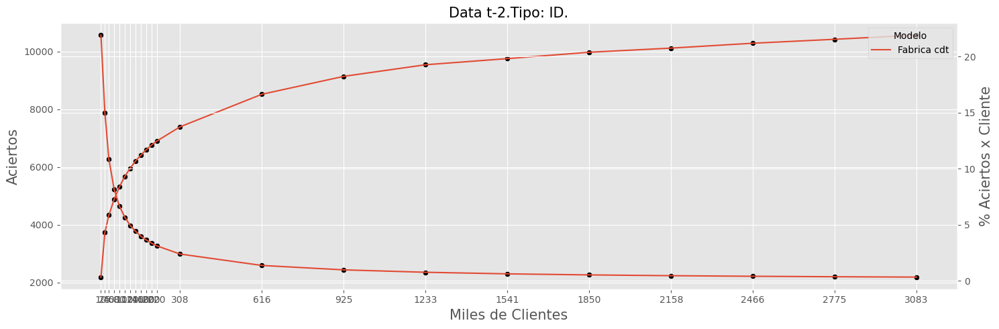

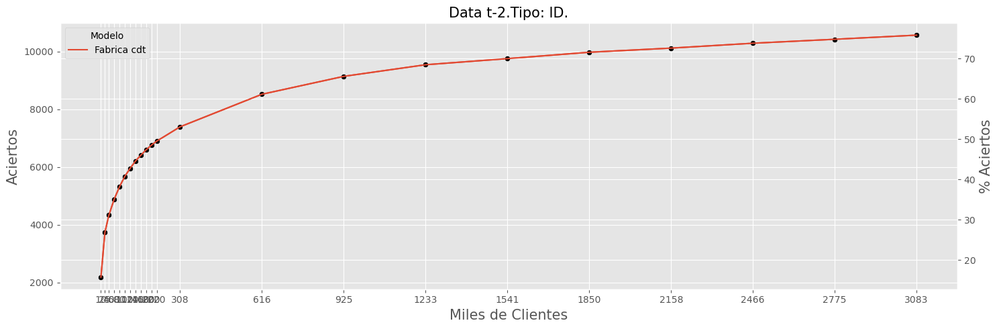

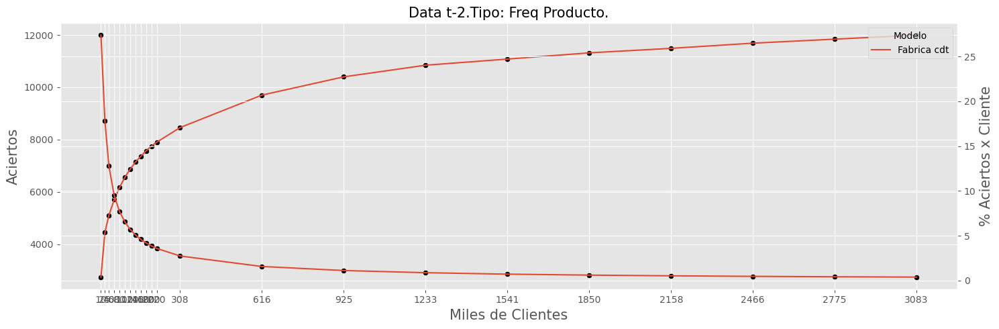

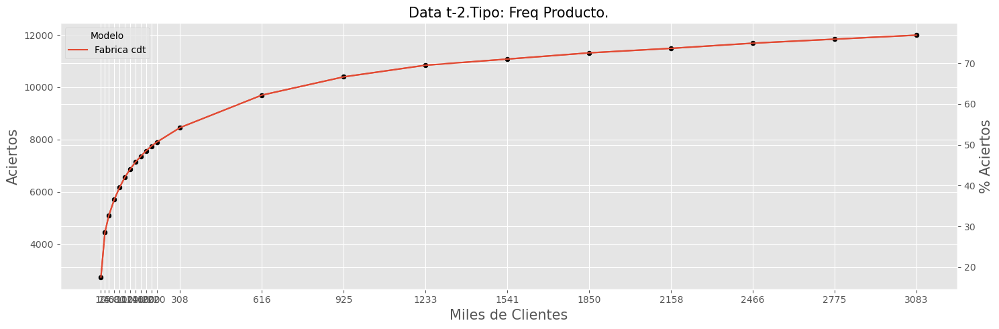

[01/14/25 16:45:03] INFO     ---------------------------------------------------                       ]8;id=521904;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=478323;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#312\312]8;;\

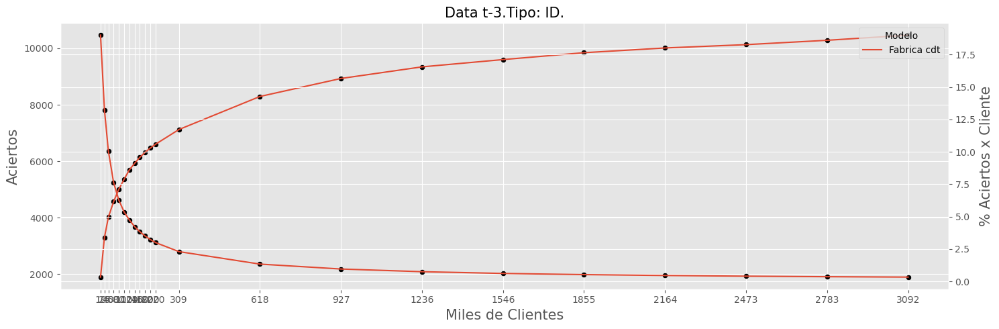

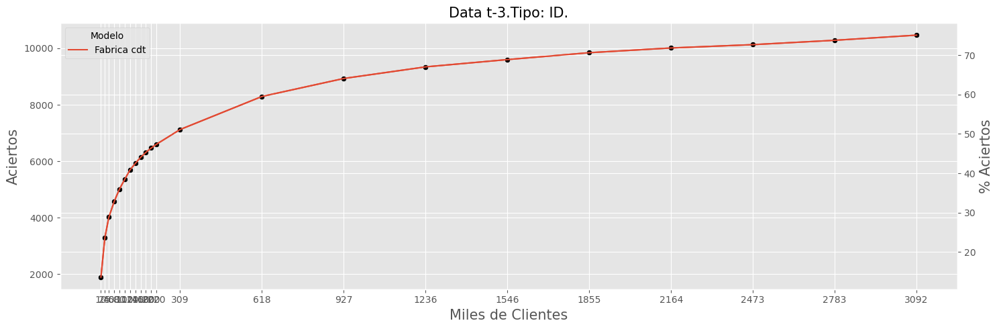

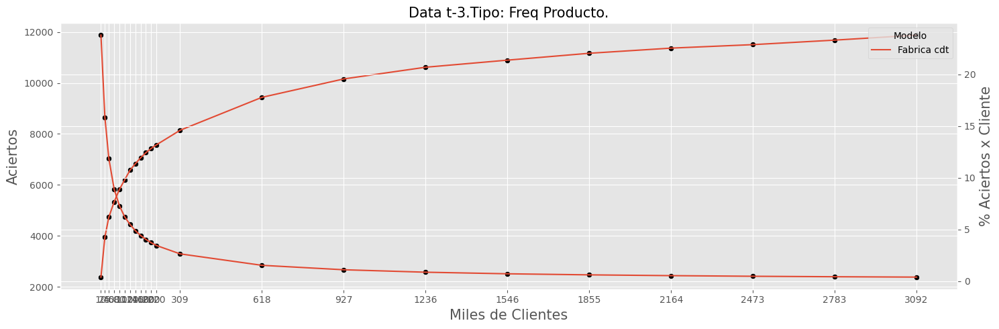

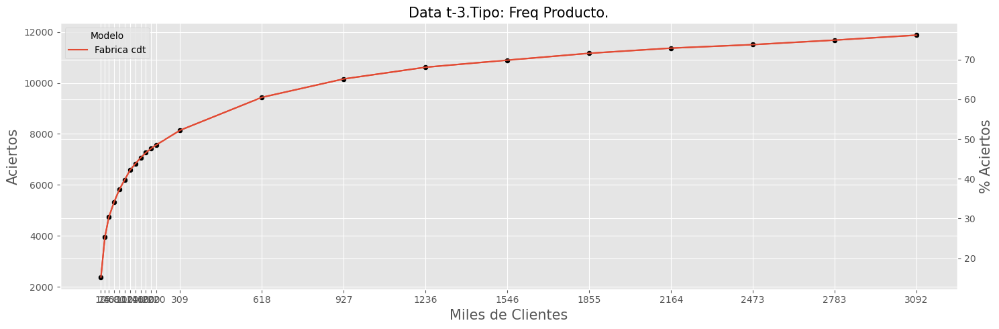

[01/14/25 16:45:05] INFO     ---------------------------------------------------                       ]8;id=153847;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=875156;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#312\312]8;;\

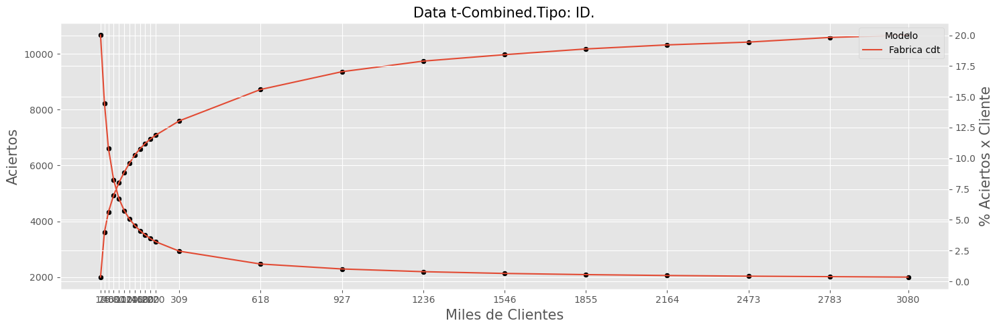

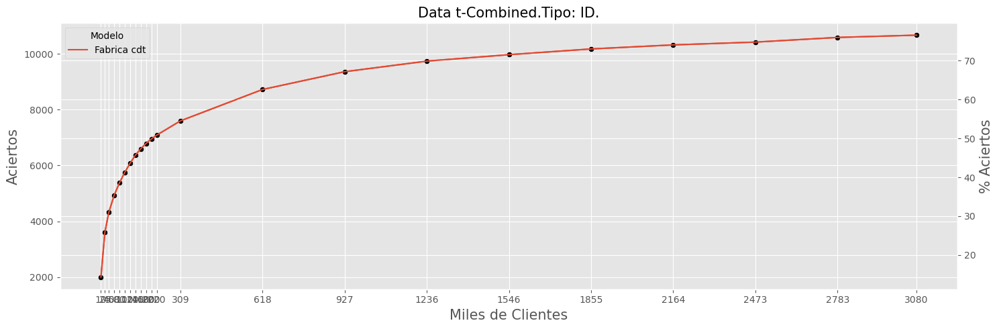

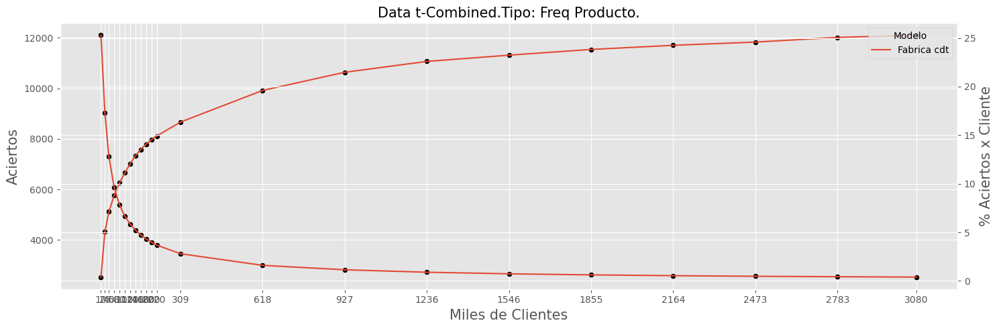

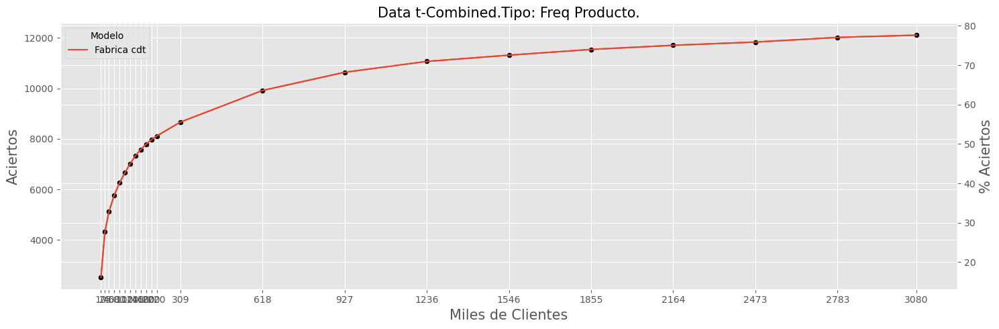

[01/14/25 16:45:06] INFO     ---------------------------------------------------                       ]8;id=270435;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py\nodes.py]8;;\:]8;id=186482;file:///home/sagemaker-user/data-bbog-integration-fabrica-personas/src/data_bbog_integration_fabrica_personas/pipelines/backtesting/nodes.py#312\312]8;;\

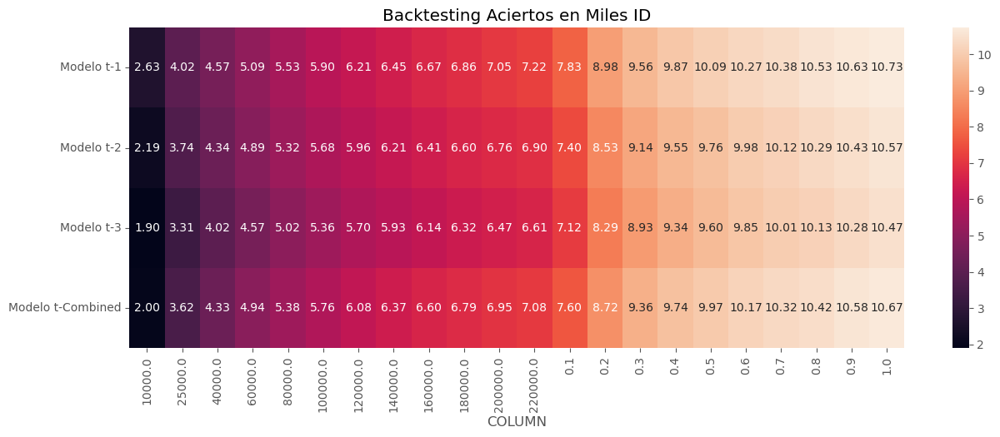

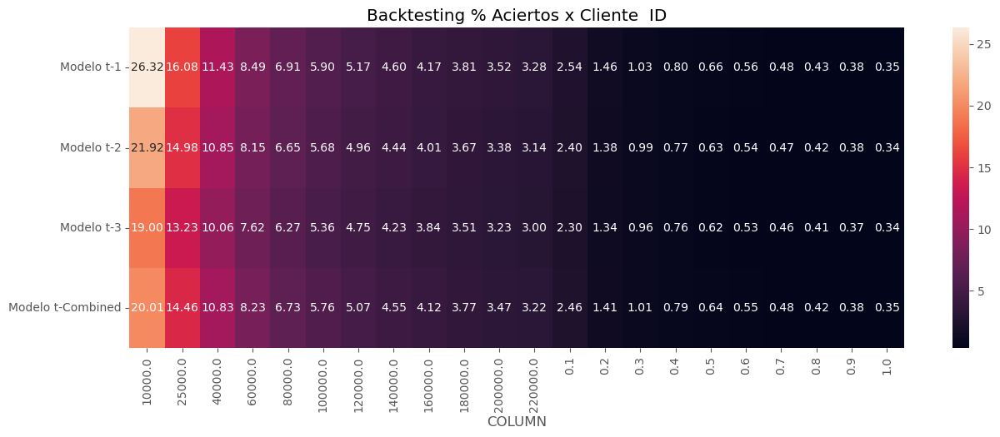

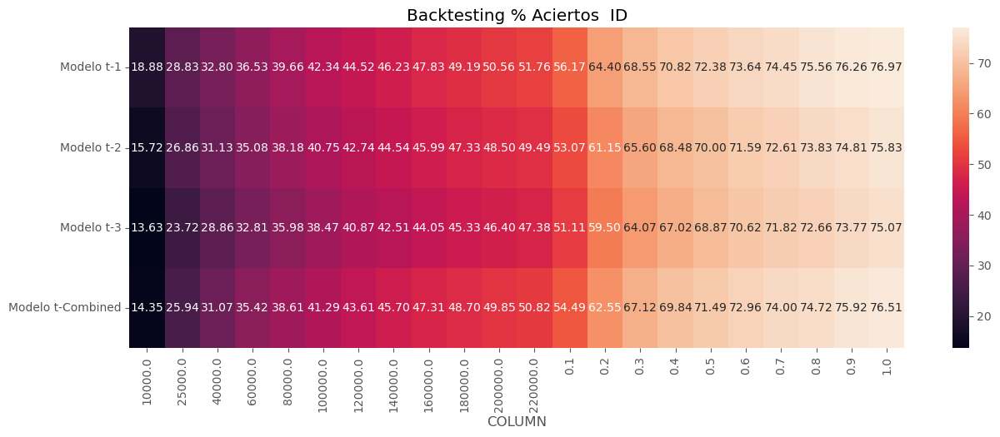

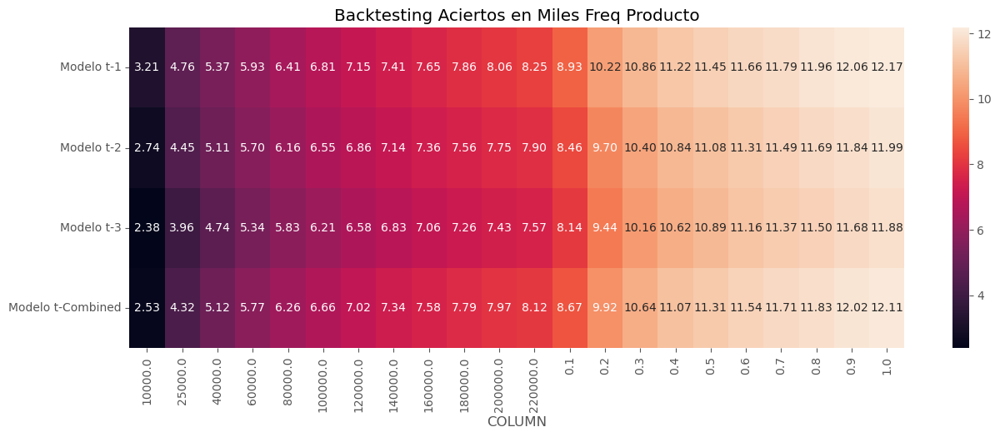

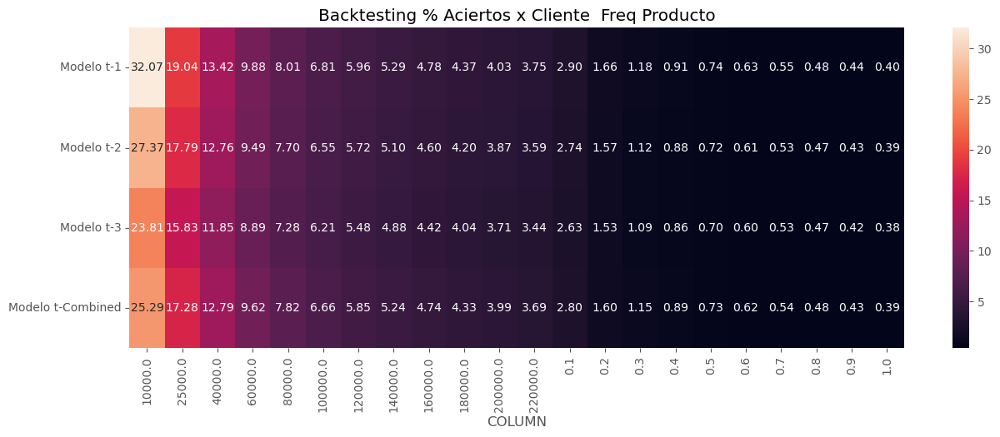

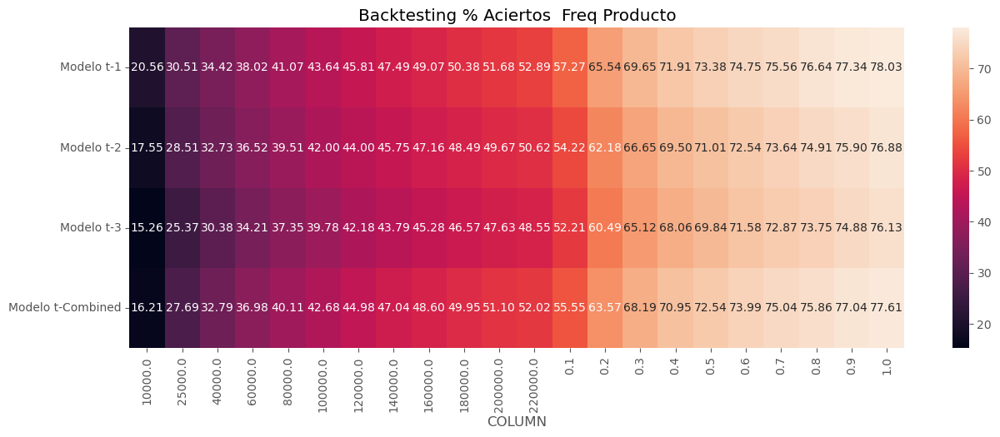

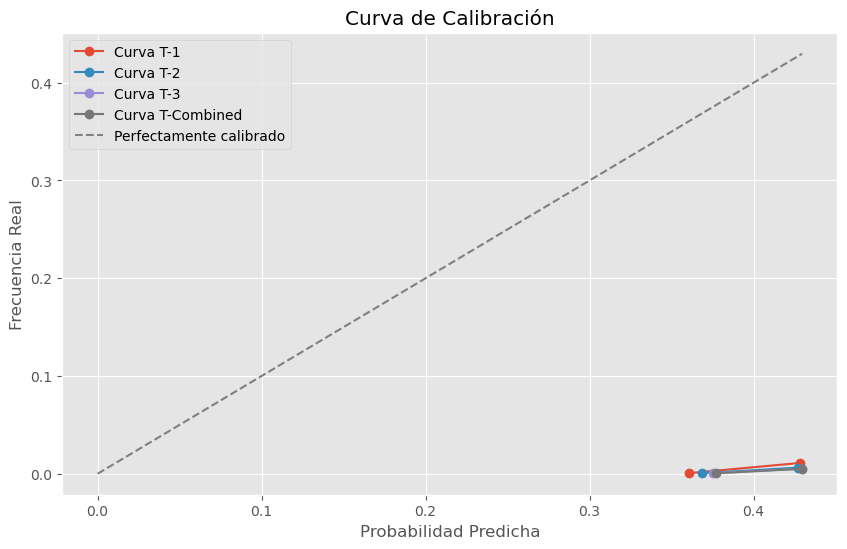

In [9]:
backtesting.plotear_curvas_rezago(save_backtesting, params)
plt.figure(figsize=(10, 6))
max_value = 0
for i in save_backtesting.keys():
    prob_true = save_backtesting[i]['prob_true']
    prob_pred = save_backtesting[i]['prob_pred']
    # Graficar la curva de calibración
    try:
        msg = str(int(i))
    except:
        msg = str(i)
    plt.plot(prob_pred, prob_true, marker='o', label='Curva'+" T-"+msg)
    max_value = np.max([max_value,np.max(prob_pred)])
plt.plot([0, max_value], [0, max_value], linestyle='--', color='gray', label='Perfectamente calibrado')
plt.title('Curva de Calibración')
plt.xlabel('Probabilidad Predicha')
plt.ylabel('Frecuencia Real')
plt.legend()
plt.show()
# curva > 45 grados = subestimar
# curva < 45 grados = sobrestimar

In [10]:
wanted_metric = ['N all','N n_top','true_sum n_top','backtest_metric n_top','Precision n_top','recall n_top','f1-score n_top']
for i in save_backtesting.keys():
    print(i,'Top Metrics')
    res = save_backtesting[i]['metrics']
    display(res[(res["metric_name"].isin(wanted_metric))&(res["class_name"].isin(['1.0','1',1,1.0,'dim shape']))].drop('timestamp', axis=1))
    display(res[res["metric_name"].isin(['True negatives','True positives','False negatives','False positives'])])
    print('------------')

1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.0343
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.0343
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.0475
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,9560


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-14 16:08,CDT,"Ensamble,",202411,True positives,overall metric,overall,10731.0
19,2025-01-14 16:08,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-14 16:08,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-14 16:08,CDT,"Ensamble,",202411,False positives,overall metric,overall,2991686.0


------------
2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.9901
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.9901
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.9608
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,9159


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-14 16:08,CDT,"Ensamble,",202411,True positives,overall metric,overall,10572.0
19,2025-01-14 16:08,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-14 16:08,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-14 16:08,CDT,"Ensamble,",202411,False positives,overall metric,overall,2925091.0


------------
3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,927688
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3092295
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.9651
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.9651
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.9117
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,8953


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-14 16:09,CDT,"Ensamble,",202411,True positives,overall metric,overall,10466.0
19,2025-01-14 16:09,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-14 16:09,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-14 16:09,CDT,"Ensamble,",202411,False positives,overall metric,overall,2858656.0


------------
Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.0132
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.0132
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.0062
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,9365


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-14 16:09,CDT,"Ensamble,",202411,True positives,overall metric,overall,10666.0
19,2025-01-14 16:09,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-14 16:09,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-14 16:09,CDT,"Ensamble,",202411,False positives,overall metric,overall,2885660.0


------------


In [11]:
for i in save_backtesting.keys():
    print(i)
    res = save_backtesting[i]['ks']
    display(res)

1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,43.75,44.99,308088,7830,2.54,72.97,10.0,62.97
1,9,41.70,43.75,308088,1148,0.37,83.66,20.0,63.66
2,8,39.39,41.70,308088,579,0.19,89.06,30.0,59.06
3,7,37.40,39.39,308088,316,0.10,92.00,40.0,52.00
4,6,36.09,37.40,308087,217,0.07,94.03,50.0,44.03
5,5,35.90,36.09,308058,176,0.06,95.67,60.0,35.67
6,4,35.71,35.90,308118,113,0.04,96.72,70.0,26.72
7,3,35.10,35.71,308088,155,0.05,98.16,80.0,18.16
8,2,34.74,35.10,308082,98,0.03,99.08,90.0,9.08
9,1,33.85,34.74,308094,99,0.03,100.00,100.0,0.00


2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.38,44.99,308346,7398,2.40,69.98,10.0,59.98
1,9,43.44,44.38,308346,1127,0.37,80.64,20.0,60.64
2,8,42.28,43.44,308346,620,0.20,86.50,30.0,56.50
3,7,41.17,42.28,308346,402,0.13,90.30,40.0,50.30
4,6,40.22,41.17,308346,212,0.07,92.31,50.0,42.31
5,5,38.61,40.22,308346,221,0.07,94.40,60.0,34.40
6,4,37.21,38.61,308346,143,0.05,95.75,70.0,25.75
7,3,36.01,37.21,308346,169,0.05,97.35,80.0,17.35
8,2,35.43,36.01,308346,137,0.04,98.65,90.0,8.65
9,1,33.70,35.43,308346,143,0.05,100.00,100.0,0.00


3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.57,44.99,309230,7125,2.30,68.08,10.0,58.08
1,9,43.99,44.57,309229,1170,0.38,79.26,20.0,59.26
2,8,43.15,43.99,309230,637,0.21,85.34,30.0,55.34
3,7,42.42,43.15,306067,410,0.13,89.26,39.9,49.36
4,6,41.72,42.42,312391,259,0.08,91.74,50.0,41.74
5,5,40.57,41.72,309230,244,0.08,94.07,60.0,34.07
6,4,39.60,40.57,309229,167,0.05,95.66,70.0,25.66
7,3,38.68,39.60,309230,118,0.04,96.79,80.0,16.79
8,2,35.95,38.68,309225,154,0.05,98.26,90.0,8.26
9,1,33.70,35.95,309234,182,0.06,100.00,100.0,0.00


Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.61,44.99,308088,7592,2.46,71.18,10.00,61.18
1,9,44.09,44.61,308088,1125,0.37,81.73,20.00,61.73
2,8,43.32,44.09,308088,631,0.20,87.64,30.00,57.64
3,7,42.57,43.32,308088,385,0.12,91.25,40.00,51.25
4,6,41.88,42.57,308088,230,0.07,93.41,50.00,43.41
5,5,40.91,41.88,308088,207,0.07,95.35,60.00,35.35
6,4,39.83,40.91,308088,143,0.05,96.69,70.00,26.69
7,3,38.95,39.83,308088,97,0.03,97.60,80.00,17.60
8,2,35.99,38.95,306737,173,0.06,99.22,89.96,9.27
9,1,35.64,35.99,309439,83,0.03,100.00,100.00,0.00


## Comparar backtesting

In [62]:
data_backtesting11111 = catalog.load("data_backtesting_202410_anterior_df_mvp7")
data_backtesting1111 = catalog.load("data_backtesting_202410_experimento1")
data_backtesting111 = catalog.load("data_backtesting_202410_experimento2")
data_backtesting11 = catalog.load("data_backtesting_202410_experimento7")
data_backtesting1 = catalog.load("data_backtesting_202410_anterior")

[02/04/25 13:15:45] INFO     Loading data from 'data_backtesting_202410_anterior_df_mvp7'       ]8;id=337372;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=891706;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/04/25 13:17:53] INFO     Loading data from 'data_backtesting_202410_experimento1'           ]8;id=440966;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=623999;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/04/25 13:19:43] INFO     Loading data from 'data_backtesting_202410_experimento2'           ]8;id=329145;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=241976;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/04/25 13:21:29] INFO     Loading data from 'data_backtesting_202410_experimento7'           ]8;id=307698;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=575019;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/04/25 13:23:38] INFO     Loading data from 'data_backtesting_202410_anterior'               ]8;id=890205;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=406916;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

In [101]:
nametag_model = ['202410_MVP4-DF MVP7','202410 exp1','202410 exp2','2024_exp7_MVP7&4 produccion','202410_MVP4']
backtesting_all = [data_backtesting11111,data_backtesting1111,data_backtesting111,data_backtesting11,data_backtesting1]
# nametag_model = ['202410','202411']
# backtesting_all = [data_backtesting1,data_backtesting2]

dict_keys(['ID', 'Freq Producto'])


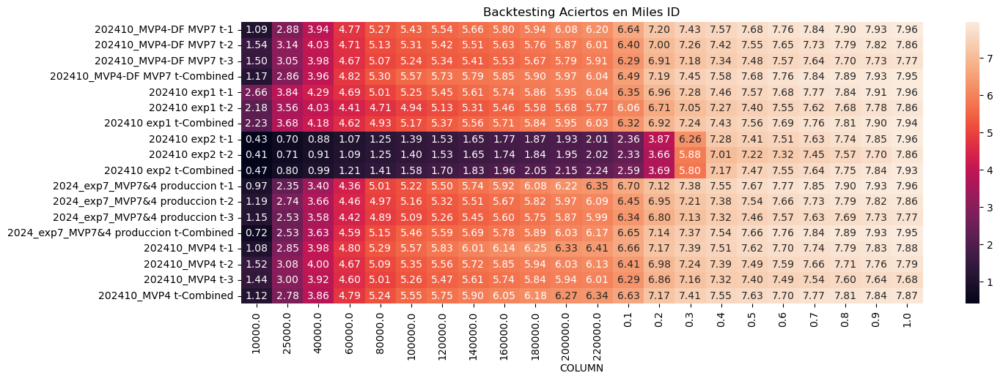

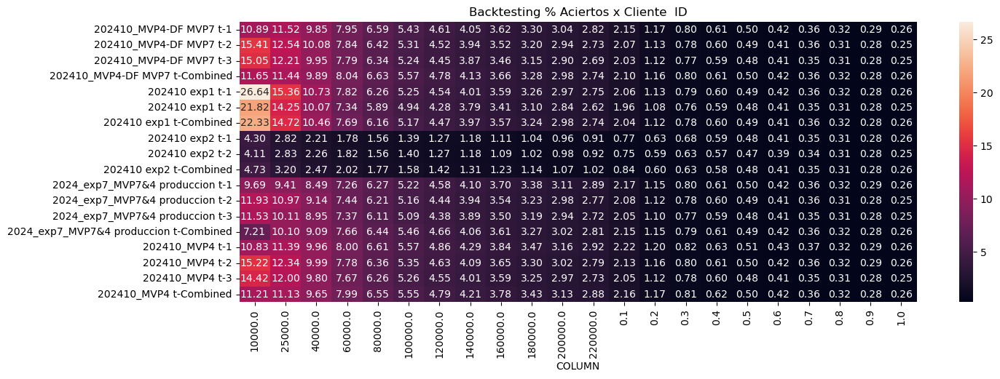

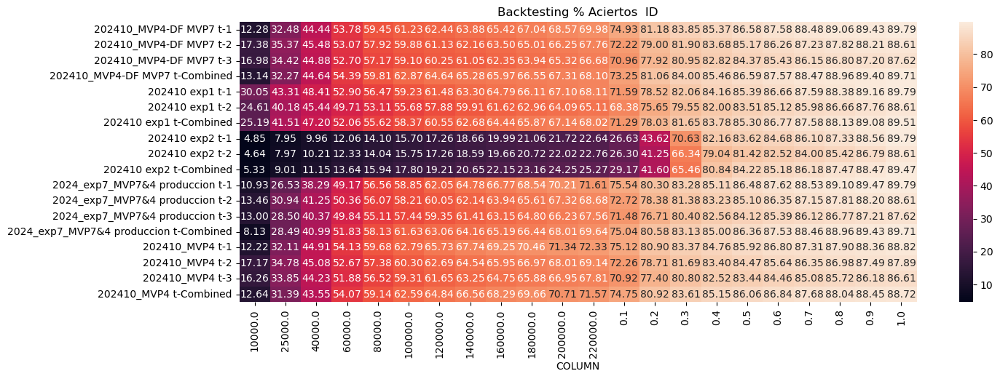

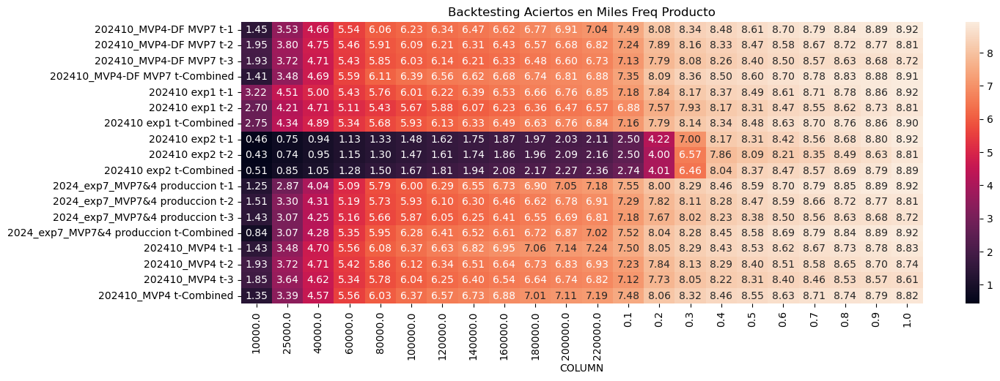

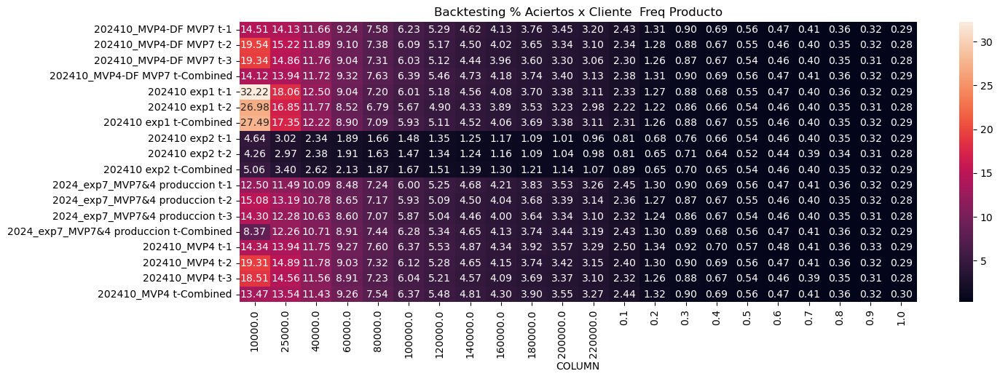

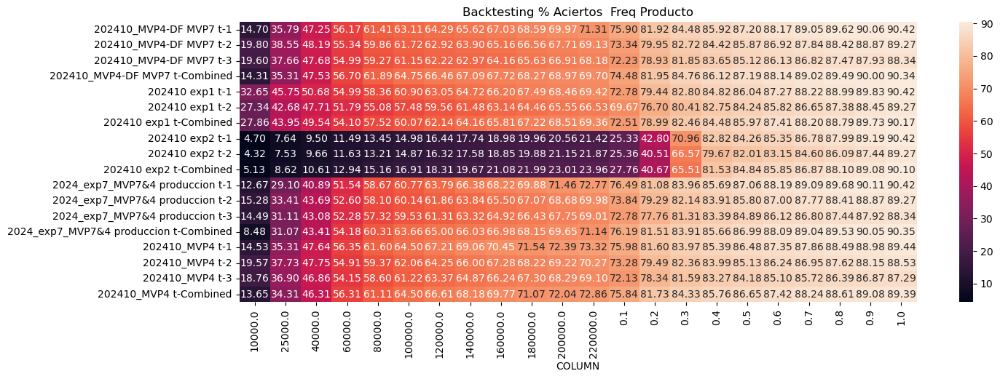

In [102]:
consolidacion_tipo = {}
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        df_i = save_backtesting[i]['contactabilidad_curva']#.keys()
        df_i = df_i[~df_i['Aciertos'].isnull()]
        df_i = df_i.replace('Fabrica '+params['target'].split('_')[0],name)
        df_i = df_i[df_i['Modelo'] == name]
        for tipo in df_i['Tipo'].unique():
            df_ii = df_i[df_i['Tipo'] == tipo]
            df_ii = df_ii.set_index('COLUMN')
            if tipo not in consolidacion_tipo:
                consolidacion_tipo[tipo] = {'Aciertos': pd.DataFrame(),'% Aciertos x Cliente':pd.DataFrame(),'% Aciertos': pd.DataFrame()}
            for col in ['Aciertos','% Aciertos x Cliente','% Aciertos']:
                consolidacion_tipo[tipo][col] = pd.concat([consolidacion_tipo[tipo][col],df_ii[[col]].rename(columns = {col:name})], axis = 1)
print(consolidacion_tipo.keys())
import seaborn as sns
for col in list(consolidacion_tipo.keys()):
    for tipo in ['Aciertos','% Aciertos x Cliente','% Aciertos']:
        if tipo == 'Aciertos':
            graph = consolidacion_tipo[col][tipo].T/1000
            msj = f'Backtesting {tipo} en Miles {col}'
        else:
            graph = consolidacion_tipo[col][tipo].T
            msj = f'Backtesting {tipo}  {col}'
        plt.figure(figsize=(15,5))
        sns.heatmap(graph, annot = True, fmt= '0.02f')
        plt.title(msj)
        plt.show()

In [103]:
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        print(name)
        res = save_backtesting[i]['ks']
        display(res)

202410_MVP4-DF MVP7 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.34,17.06,308346,6643,2.15,83.44,10.00,73.44
1,9,0.20,0.34,308346,554,0.18,90.40,20.00,70.40
2,8,0.17,0.20,308346,237,0.08,93.38,30.00,63.38
3,7,0.15,0.17,308346,135,0.04,95.08,40.00,55.08
4,6,0.14,0.15,308346,107,0.03,96.42,50.00,46.42
5,5,0.12,0.14,306514,89,0.03,97.54,59.94,37.60
6,4,0.11,0.12,309648,79,0.03,98.53,69.98,28.55
7,3,0.11,0.11,299717,51,0.02,99.17,79.70,19.47
8,2,0.11,0.11,317505,34,0.01,99.60,90.00,9.60
9,1,0.04,0.11,308346,32,0.01,100.00,100.00,0.00


202410_MVP4-DF MVP7 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.33,17.05,309230,6403,2.07,81.50,10.00,71.50
1,9,0.20,0.33,309229,601,0.19,89.15,20.00,69.15
2,8,0.17,0.20,309230,257,0.08,92.43,30.00,62.43
3,7,0.15,0.17,309229,158,0.05,94.44,40.00,54.44
4,6,0.14,0.15,309229,132,0.04,96.12,50.00,46.12
5,5,0.12,0.14,309230,97,0.03,97.35,60.00,37.35
6,4,0.11,0.12,309219,86,0.03,98.45,70.00,28.45
7,3,0.11,0.11,301153,50,0.02,99.08,79.74,19.35
8,2,0.11,0.11,317316,37,0.01,99.55,90.00,9.55
9,1,0.04,0.11,309230,35,0.01,100.00,100.00,0.00


202410_MVP4-DF MVP7 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.33,17.06,309354,6291,2.03,80.99,10.0,70.99
1,9,0.20,0.33,309354,617,0.20,88.93,20.0,68.93
2,8,0.17,0.20,309354,269,0.09,92.39,30.0,62.39
3,7,0.15,0.17,309354,166,0.05,94.53,40.0,54.53
4,6,0.14,0.15,309353,137,0.04,96.29,50.0,46.29
5,5,0.12,0.14,309354,94,0.03,97.50,60.0,37.50
6,4,0.11,0.12,309305,64,0.02,98.33,70.0,28.33
7,3,0.11,0.11,309402,58,0.02,99.07,80.0,19.07
8,2,0.11,0.11,309355,35,0.01,99.52,90.0,9.52
9,1,0.04,0.11,309354,37,0.01,100.00,100.0,0.00


202410_MVP4-DF MVP7 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.56,17.06,308346,6488,2.10,81.57,10.0,71.57
1,9,0.23,0.56,308346,699,0.23,90.36,20.0,70.36
2,8,0.19,0.23,308346,259,0.08,93.61,30.0,63.61
3,7,0.17,0.19,308346,129,0.04,95.24,40.0,55.24
4,6,0.15,0.17,308346,101,0.03,96.50,50.0,46.50
5,5,0.13,0.15,308346,86,0.03,97.59,60.0,37.59
6,4,0.12,0.13,308346,79,0.03,98.58,70.0,28.58
7,3,0.11,0.12,308346,46,0.01,99.16,80.0,19.16
8,2,0.11,0.11,308346,38,0.01,99.64,90.0,9.64
9,1,0.10,0.11,308347,29,0.01,100.00,100.0,0.00


202410 exp1 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.38,44.99,308346,6347,2.06,79.73,10.0,69.73
1,9,43.44,44.38,308346,615,0.20,87.45,20.0,67.45
2,8,42.28,43.44,308346,313,0.10,91.38,30.0,61.38
3,7,41.17,42.28,308346,187,0.06,93.73,40.0,53.73
4,6,40.22,41.17,308346,109,0.04,95.10,50.0,45.10
5,5,38.61,40.22,308346,112,0.04,96.51,60.0,36.51
6,4,37.21,38.61,308346,83,0.03,97.55,70.0,27.55
7,3,36.01,37.21,308346,70,0.02,98.43,80.0,18.43
8,2,35.43,36.01,308346,69,0.02,99.30,90.0,9.30
9,1,33.70,35.43,308346,56,0.02,100.00,100.0,0.00


202410 exp1 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.57,44.99,309230,6063,1.96,77.18,10.0,67.18
1,9,43.99,44.57,309229,644,0.21,85.37,20.0,65.37
2,8,43.15,43.99,309230,346,0.11,89.78,30.0,59.78
3,7,42.42,43.15,306067,217,0.07,92.54,39.9,52.64
4,6,41.72,42.42,312391,134,0.04,94.25,50.0,44.25
5,5,40.57,41.72,309230,143,0.05,96.07,60.0,36.07
6,4,39.60,40.57,309229,76,0.02,97.03,70.0,27.03
7,3,38.68,39.60,309230,60,0.02,97.80,80.0,17.80
8,2,35.95,38.68,309225,98,0.03,99.05,90.0,9.05
9,1,33.70,35.95,309234,75,0.02,100.00,100.0,0.00


202410 exp1 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.60,44.99,308346,6319,2.05,79.62,10.00,69.62
1,9,44.06,44.60,308346,595,0.19,87.12,20.00,67.12
2,8,43.26,44.06,308346,323,0.10,91.19,30.00,61.19
3,7,42.52,43.26,308346,189,0.06,93.57,40.00,53.57
4,6,41.83,42.52,308346,136,0.04,95.29,50.00,45.29
5,5,40.82,41.83,308346,131,0.04,96.94,60.00,36.94
6,4,39.77,40.82,308346,72,0.02,97.85,70.00,27.85
7,3,38.88,39.77,308346,48,0.02,98.45,80.00,18.45
8,2,35.96,38.88,284458,84,0.03,99.51,89.23,10.28
9,1,35.57,35.96,332235,39,0.01,100.00,100.00,0.00


202410 exp2 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.78,44.78,308317,2361,0.77,29.66,10.0,19.66
1,9,44.78,44.78,308375,1506,0.49,48.57,20.0,28.57
2,8,44.77,44.78,308346,2395,0.78,78.66,30.0,48.66
3,7,44.75,44.77,308346,1022,0.33,91.50,40.0,51.50
4,6,44.74,44.75,308345,130,0.04,93.13,50.0,43.13
5,5,44.74,44.74,308345,94,0.03,94.31,60.0,34.31
6,4,44.73,44.74,308348,126,0.04,95.89,70.0,25.89
7,3,44.72,44.73,308346,109,0.04,97.26,80.0,17.26
8,2,44.70,44.72,308346,109,0.04,98.63,90.0,8.63
9,1,27.09,44.70,308346,109,0.04,100.00,100.0,0.00


202410 exp2 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.78,44.78,309230,2332,0.75,29.68,10.00,19.68
1,9,44.78,44.78,309229,1325,0.43,46.55,20.00,26.55
2,8,44.77,44.78,309230,2225,0.72,74.87,30.00,44.87
3,7,44.75,44.77,309229,1126,0.36,89.21,40.00,49.21
4,6,44.74,44.75,309219,211,0.07,91.89,50.00,41.89
5,5,44.74,44.74,309240,97,0.03,93.13,60.00,33.13
6,4,44.73,44.74,308739,128,0.04,94.76,69.98,24.77
7,3,44.72,44.73,309720,129,0.04,96.40,80.00,16.40
8,2,44.70,44.72,309229,122,0.04,97.95,90.00,7.95
9,1,26.79,44.70,309230,161,0.05,100.00,100.00,0.00


202410 exp2 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.78,44.78,308332,2577,0.84,32.49,10.0,22.49
1,9,44.78,44.78,308360,1103,0.36,46.39,20.0,26.39
2,8,44.78,44.78,308346,2110,0.68,73.00,30.0,43.00
3,7,44.76,44.78,308346,1370,0.44,90.27,40.0,50.27
4,6,44.74,44.76,308346,307,0.10,94.14,50.0,44.14
5,5,44.74,44.74,308345,84,0.03,95.20,60.0,35.20
6,4,44.74,44.74,308347,89,0.03,96.32,70.0,26.32
7,3,44.73,44.74,308329,111,0.04,97.72,80.0,17.72
8,2,44.72,44.73,308363,90,0.03,98.85,90.0,8.85
9,1,44.46,44.72,308347,91,0.03,100.00,100.0,0.00


2024_exp7_MVP7&4 produccion t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.32,16.93,308346,6697,2.17,84.12,10.0,74.12
1,9,0.21,0.32,308346,422,0.14,89.42,20.0,69.42
2,8,0.18,0.21,308346,265,0.09,92.75,30.0,62.75
3,7,0.16,0.18,308346,162,0.05,94.79,40.0,54.79
4,6,0.14,0.16,308346,121,0.04,96.31,50.0,46.31
5,5,0.12,0.14,308346,101,0.03,97.58,60.0,37.58
6,4,0.11,0.12,308346,81,0.03,98.59,70.0,28.59
7,3,0.11,0.11,308346,51,0.02,99.23,80.0,19.23
8,2,0.11,0.11,308346,32,0.01,99.64,90.0,9.64
9,1,0.04,0.11,308346,29,0.01,100.00,100.0,0.00


2024_exp7_MVP7&4 produccion t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.32,16.92,309230,6447,2.08,82.06,10.00,72.06
1,9,0.21,0.32,309229,502,0.16,88.45,20.00,68.45
2,8,0.19,0.21,309230,266,0.09,91.84,30.00,61.84
3,7,0.17,0.19,309229,164,0.05,93.93,40.00,53.93
4,6,0.14,0.17,309229,166,0.05,96.04,50.00,46.04
5,5,0.12,0.14,309230,111,0.04,97.45,60.00,37.45
6,4,0.11,0.12,309229,71,0.02,98.36,70.00,28.36
7,3,0.11,0.11,308302,58,0.02,99.10,79.97,19.13
8,2,0.11,0.11,308438,35,0.01,99.54,89.94,9.60
9,1,0.04,0.11,310949,36,0.01,100.00,100.00,0.00


2024_exp7_MVP7&4 produccion t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.33,16.95,309354,6337,2.05,81.58,10.00,71.58
1,9,0.22,0.33,309354,464,0.15,87.55,20.00,67.55
2,8,0.19,0.22,309354,327,0.11,91.76,30.00,61.76
3,7,0.17,0.19,309354,192,0.06,94.23,40.00,54.23
4,6,0.14,0.17,309353,138,0.04,96.01,50.00,46.01
5,5,0.12,0.14,309354,113,0.04,97.46,60.00,37.46
6,4,0.11,0.12,309354,64,0.02,98.29,70.00,28.29
7,3,0.11,0.11,309354,58,0.02,99.03,80.00,19.03
8,2,0.11,0.11,301185,39,0.01,99.54,89.74,9.80
9,1,0.04,0.11,317523,36,0.01,100.00,100.00,0.00


2024_exp7_MVP7&4 produccion t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.45,16.95,308346,6647,2.16,83.57,10.0,73.57
1,9,0.25,0.45,308346,495,0.16,89.79,20.0,69.79
2,8,0.21,0.25,308346,221,0.07,92.57,30.0,62.57
3,7,0.19,0.21,308346,170,0.06,94.71,40.0,54.71
4,6,0.17,0.19,308346,122,0.04,96.24,50.0,46.24
5,5,0.14,0.17,308346,105,0.03,97.56,60.0,37.56
6,4,0.12,0.14,308345,83,0.03,98.60,70.0,28.60
7,3,0.11,0.12,308347,42,0.01,99.13,80.0,19.13
8,2,0.11,0.11,308338,43,0.01,99.67,90.0,9.67
9,1,0.11,0.11,308355,26,0.01,100.00,100.0,0.00


202410_MVP4 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.20,17.06,300137,6660,2.22,84.57,10.00,74.57
1,9,0.08,0.20,300136,513,0.17,91.09,20.00,71.09
2,8,0.05,0.08,300136,219,0.07,93.87,30.00,63.87
3,7,0.04,0.05,300137,123,0.04,95.43,40.00,55.43
4,6,0.03,0.04,300136,103,0.03,96.74,50.00,46.74
5,5,0.02,0.03,300136,78,0.03,97.73,60.00,37.73
6,4,0.02,0.02,299451,45,0.02,98.30,69.98,28.32
7,3,0.01,0.02,300822,52,0.02,98.96,80.00,18.96
8,2,0.01,0.01,300136,41,0.01,99.48,90.00,9.48
9,1,0.00,0.01,300137,41,0.01,100.00,100.00,0.00


202410_MVP4 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.23,17.05,301027,6407,2.13,82.23,10.0,72.23
1,9,0.09,0.23,301026,571,0.19,89.55,20.0,69.55
2,8,0.05,0.09,301026,265,0.09,92.95,30.0,62.95
3,7,0.04,0.05,301026,151,0.05,94.89,40.0,54.89
4,6,0.03,0.04,301026,95,0.03,96.11,50.0,46.11
5,5,0.02,0.03,301026,104,0.03,97.45,60.0,37.45
6,4,0.02,0.02,301026,63,0.02,98.25,70.0,28.25
7,3,0.01,0.02,301026,56,0.02,98.97,80.0,18.97
8,2,0.01,0.01,301026,45,0.01,99.55,90.0,9.55
9,1,0.00,0.01,301027,35,0.01,100.00,100.0,0.00


202410_MVP4 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.23,17.06,306616,6288,2.05,81.89,10.00,71.89
1,9,0.09,0.23,306616,574,0.19,89.36,20.00,69.36
2,8,0.05,0.09,306616,302,0.10,93.29,30.00,63.29
3,7,0.03,0.05,306615,152,0.05,95.27,40.00,55.27
4,6,0.03,0.03,306616,82,0.03,96.34,50.00,46.34
5,5,0.02,0.03,306616,90,0.03,97.51,60.00,37.51
6,4,0.01,0.02,306615,55,0.02,98.23,70.00,28.23
7,3,0.01,0.01,306459,57,0.02,98.97,79.99,18.98
8,2,0.01,0.01,306773,41,0.01,99.51,90.00,9.51
9,1,0.00,0.01,306616,38,0.01,100.00,100.00,0.00


202410_MVP4 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.38,17.06,298793,6601,2.21,83.92,10.0,73.92
1,9,0.12,0.38,298792,557,0.19,91.00,20.0,71.00
2,8,0.07,0.12,298792,249,0.08,94.16,30.0,64.16
3,7,0.05,0.07,298793,133,0.04,95.86,40.0,55.86
4,6,0.04,0.05,298792,81,0.03,96.89,50.0,46.89
5,5,0.03,0.04,298792,71,0.02,97.79,60.0,37.79
6,4,0.02,0.03,298793,76,0.03,98.75,70.0,28.75
7,3,0.02,0.02,298792,34,0.01,99.19,80.0,19.19
8,2,0.01,0.02,298792,31,0.01,99.58,90.0,9.58
9,1,0.01,0.01,298793,33,0.01,100.00,100.0,0.00


In [104]:
wanted_metric = ['N all','N n_top','true_sum n_top','backtest_metric n_top','Precision n_top','recall n_top','f1-score n_top']
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        print(name,'Top Metrics')
        res = save_backtesting[i]['metrics']
        display(res[(res["metric_name"].isin(wanted_metric))&(res["class_name"].isin(['1.0','1',1,1.0,'dim shape']))].drop('timestamp', axis=1))
        display(res[res["metric_name"].isin(['True negatives','True positives','False negatives','False positives'])])
        print('------------')

202410_MVP4-DF MVP7 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,0.8038
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,0.8038
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,1.5947
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,7435


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 22:16,CDT,"Ensamble,",202412,True positives,overall metric,overall,7961.0
19,2025-02-03 22:16,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-02-03 22:16,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-02-03 22:16,CDT,"Ensamble,",202412,False positives,overall metric,overall,3003105.0


------------
202410_MVP4-DF MVP7 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,927688
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3092295
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,0.7828
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,0.7828
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,1.5535
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,7262


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 22:16,CDT,"Ensamble,",202412,True positives,overall metric,overall,7856.0
19,2025-02-03 22:16,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-02-03 22:16,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-02-03 22:16,CDT,"Ensamble,",202412,False positives,overall metric,overall,2933823.0


------------
202410_MVP4-DF MVP7 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,928061
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3093539
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,0.7746
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,0.7746
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,1.5373
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,7189


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 22:16,CDT,"Ensamble,",202412,True positives,overall metric,overall,7768.0
19,2025-02-03 22:16,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-02-03 22:16,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-02-03 22:16,CDT,"Ensamble,",202412,False positives,overall metric,overall,2847240.0


------------
202410_MVP4-DF MVP7 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3083461
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,0.8052
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,0.8052
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,1.5975
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,7448


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 22:16,CDT,"Ensamble,",202412,True positives,overall metric,overall,7954.0
19,2025-02-03 22:16,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-02-03 22:16,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-02-03 22:16,CDT,"Ensamble,",202412,False positives,overall metric,overall,2858351.0


------------
202410 exp1 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.7866
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.7866
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.5608
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,7276


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-14 16:51,CDT,"Ensamble,",202411,True positives,overall metric,overall,7961.0
19,2025-01-14 16:51,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-14 16:51,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-14 16:51,CDT,"Ensamble,",202411,False positives,overall metric,overall,3003105.0


------------
202410 exp1 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,927688
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3092295
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.7607
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.7607
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.5099
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,7057


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-14 16:52,CDT,"Ensamble,",202411,True positives,overall metric,overall,7856.0
19,2025-01-14 16:52,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-14 16:52,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-14 16:52,CDT,"Ensamble,",202411,False positives,overall metric,overall,2933823.0


------------
202410 exp1 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083461
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.7828
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.7828
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.5534
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,7241


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-14 16:52,CDT,"Ensamble,",202411,True positives,overall metric,overall,7936.0
19,2025-01-14 16:52,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-14 16:52,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-14 16:52,CDT,"Ensamble,",202411,False positives,overall metric,overall,2954783.0


------------
202410 exp2 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.6772
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.6772
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.3452
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,6264


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-24 19:52,CDT,"Ensamble,",202411,True positives,overall metric,overall,7961.0
19,2025-01-24 19:52,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-24 19:52,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-24 19:52,CDT,"Ensamble,",202411,False positives,overall metric,overall,3003105.0


------------
202410 exp2 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,927688
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3092295
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.6373
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.6373
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.2665
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,5912


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-24 19:53,CDT,"Ensamble,",202411,True positives,overall metric,overall,7856.0
19,2025-01-24 19:53,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-24 19:53,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-24 19:53,CDT,"Ensamble,",202411,False positives,overall metric,overall,2933823.0


------------
202410 exp2 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083461
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.6279
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.6279
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.2479
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,5808


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-24 19:53,CDT,"Ensamble,",202411,True positives,overall metric,overall,7932.0
19,2025-01-24 19:53,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-24 19:53,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-24 19:53,CDT,"Ensamble,",202411,False positives,overall metric,overall,2964381.0


------------
2024_exp7_MVP7&4 produccion t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.7983
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.7983
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.584
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,7385


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-04 14:58,CDT,"Ensamble,",202411,True positives,overall metric,overall,7961.0
19,2025-02-04 14:58,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-04 14:58,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-04 14:58,CDT,"Ensamble,",202411,False positives,overall metric,overall,3003105.0


------------
2024_exp7_MVP7&4 produccion t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,927688
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3092295
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.7782
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.7782
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.5443
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,7219


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-04 14:59,CDT,"Ensamble,",202411,True positives,overall metric,overall,7856.0
19,2025-02-04 14:59,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-04 14:59,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-04 14:59,CDT,"Ensamble,",202411,False positives,overall metric,overall,2933823.0


------------
2024_exp7_MVP7&4 produccion t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,928061
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3093539
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.7689
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.7689
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.5261
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,7136


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-04 14:59,CDT,"Ensamble,",202411,True positives,overall metric,overall,7768.0
19,2025-02-04 14:59,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-04 14:59,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-04 14:59,CDT,"Ensamble,",202411,False positives,overall metric,overall,2847240.0


------------
2024_exp7_MVP7&4 produccion t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083461
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.7969
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.7969
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.5813
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,7372


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-04 14:59,CDT,"Ensamble,",202411,True positives,overall metric,overall,7954.0
19,2025-02-04 14:59,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-04 14:59,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-04 14:59,CDT,"Ensamble,",202411,False positives,overall metric,overall,2867364.0


------------
202410_MVP4 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,900409
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,3001364
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,0.8211
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,0.8211
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,1.6288
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,7393


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
20,2025-01-20 16:55,CDT,"Ensamble,",202410,True positives,overall metric,overall,7873.0
21,2025-01-20 16:55,CDT,"Ensamble,",202410,False negatives,overall metric,overall,2.0
22,2025-01-20 16:55,CDT,"Ensamble,",202410,True negatives,overall metric,overall,11452.0
23,2025-01-20 16:55,CDT,"Ensamble,",202410,False positives,overall metric,overall,2909759.0


------------
202410_MVP4 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,903078
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,3010262
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,0.8031
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,0.8031
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,1.5935
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,7253


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
20,2025-01-20 16:55,CDT,"Ensamble,",202410,True positives,overall metric,overall,7792.0
21,2025-01-20 16:55,CDT,"Ensamble,",202410,False negatives,overall metric,overall,0.0
22,2025-01-20 16:55,CDT,"Ensamble,",202410,True negatives,overall metric,overall,10267.0
23,2025-01-20 16:55,CDT,"Ensamble,",202410,False positives,overall metric,overall,2834666.0


------------
202410_MVP4 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,919847
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,3066158
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,0.7803
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,0.7803
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,1.5486
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,7178


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
20,2025-01-20 16:55,CDT,"Ensamble,",202410,True positives,overall metric,overall,7677.0
21,2025-01-20 16:55,CDT,"Ensamble,",202410,False negatives,overall metric,overall,2.0
22,2025-01-20 16:55,CDT,"Ensamble,",202410,True negatives,overall metric,overall,10151.0
23,2025-01-20 16:55,CDT,"Ensamble,",202410,False positives,overall metric,overall,2753550.0


------------
202410_MVP4 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,896377
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,2987924
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,0.8278
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,0.8278
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,1.642
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,7420


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-20 16:55,CDT,"Ensamble,",202410,True positives,overall metric,overall,7866.0
19,2025-01-20 16:55,CDT,"Ensamble,",202410,False negatives,overall metric,overall,0.0
20,2025-01-20 16:55,CDT,"Ensamble,",202410,True negatives,overall metric,overall,0.0
21,2025-01-20 16:55,CDT,"Ensamble,",202410,False positives,overall metric,overall,2742156.0


------------


**Comparativo 202411**

In [17]:
data_backtesting2222222222 = catalog.load("data_backtesting_202411_anterior_df_mvp7")  # modelo del MVP4 ejecutado en el MVP4 y data del MVP7
data_backtesting222222222 = catalog.load("data_backtesting_202411_experimento7") # modelo del MVP4 ejecutado en el MVP7 y data del MVP7
data_backtesting22222222 = catalog.load("data_backtesting_202411_experimento6")
data_backtesting2222222 = catalog.load("data_backtesting_202411_experimento5")
data_backtesting222222 = catalog.load("data_backtesting_202411_experimento4")
data_backtesting22222 = catalog.load("data_backtesting_202411_experimento3")
data_backtesting2222 = catalog.load("data_backtesting_202411_experimento1_mas_experimento2")
data_backtesting222 = catalog.load("data_backtesting_202411_experimento2")
data_backtesting22 = catalog.load("data_backtesting_202411_experimento1")
data_backtesting2 = catalog.load("data_backtesting_202411_anterior") # modelo del MVP4 ejecutado en el MVP4 y data del MVP4

[02/03/25 21:09:41] INFO     Loading data from 'data_backtesting_202411_experimento6'           ]8;id=150196;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=851925;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/03/25 21:14:41] INFO     Loading data from 'data_backtesting_202411_experimento5'           ]8;id=49839;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=709593;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/03/25 21:19:47] INFO     Loading data from 'data_backtesting_202411_experimento4'           ]8;id=524038;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=109611;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/03/25 21:23:56] INFO     Loading data from 'data_backtesting_202411_experimento3'           ]8;id=319687;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=340532;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/03/25 21:28:11] INFO     Loading data from                                                  ]8;id=396734;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=416849;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             'data_backtesting_202411_experimento1_mas_experimento2'                               
                             (PickleDataSet)...                                                                    

[02/03/25 21:33:02] INFO     Loading data from 'data_backtesting_202411_experimento2'           ]8;id=655577;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=364305;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/03/25 21:37:56] INFO     Loading data from 'data_backtesting_202411_experimento1'           ]8;id=898622;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=457005;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/03/25 21:43:17] INFO     Loading data from 'data_backtesting_202411_anterior'               ]8;id=783886;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=152286;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

In [93]:
nametag_model = ['202411_MVP4','202411_exp7_MVP7&4 produccion','202411_MVP4_DF_MVP7','202411 exp1 prueba 3','202411 exp2 prueba 4']
backtesting_all = [data_backtesting2,data_backtesting222222222,data_backtesting2222222222,data_backtesting22222,data_backtesting222222] # los de los edas

dict_keys(['ID', 'Freq Producto'])


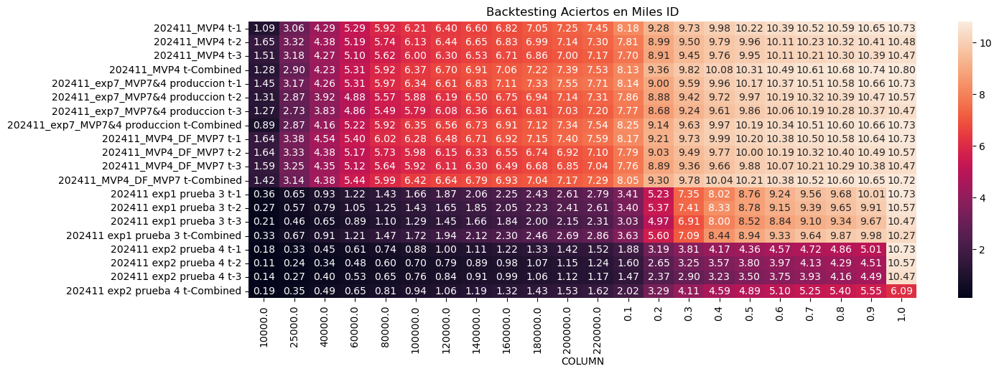

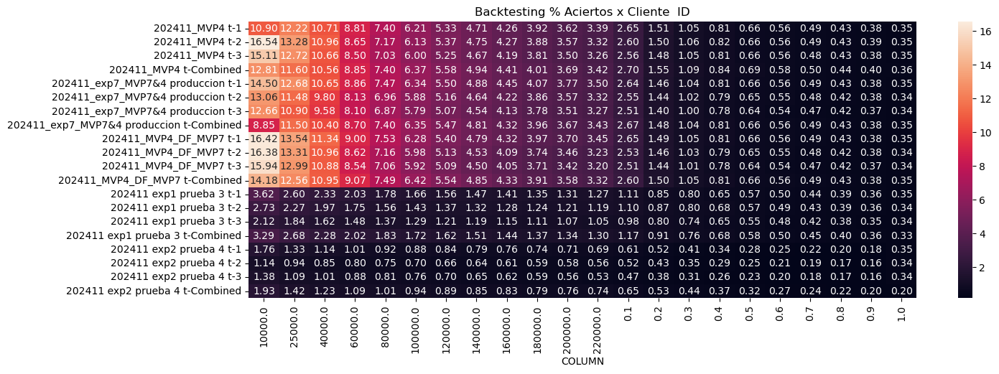

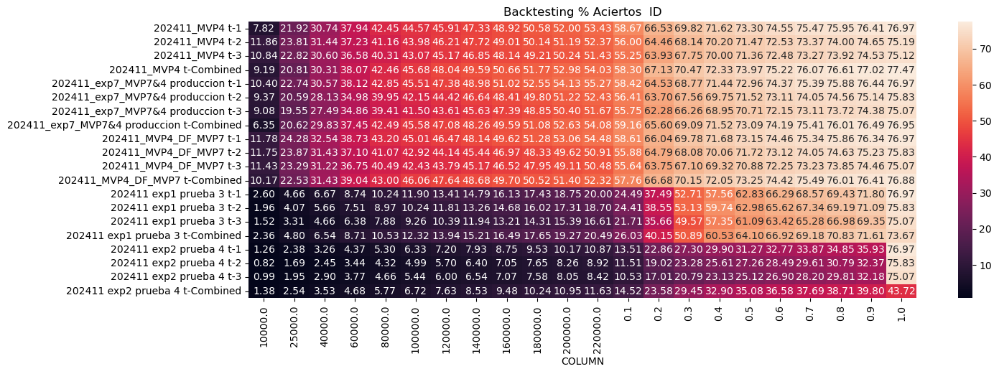

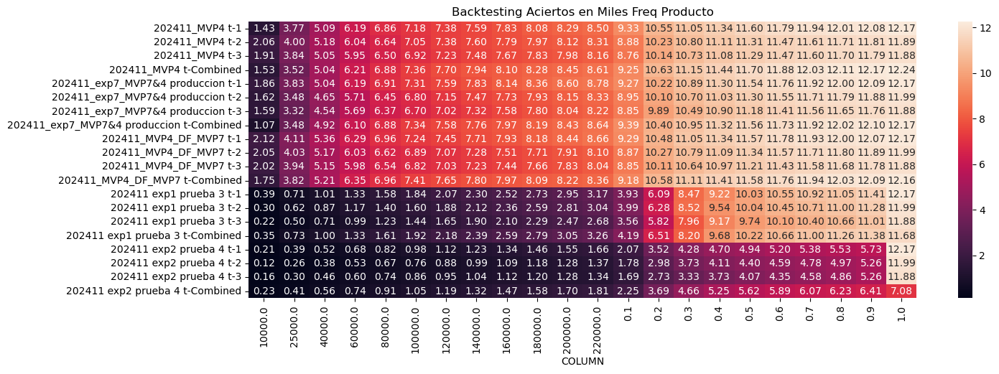

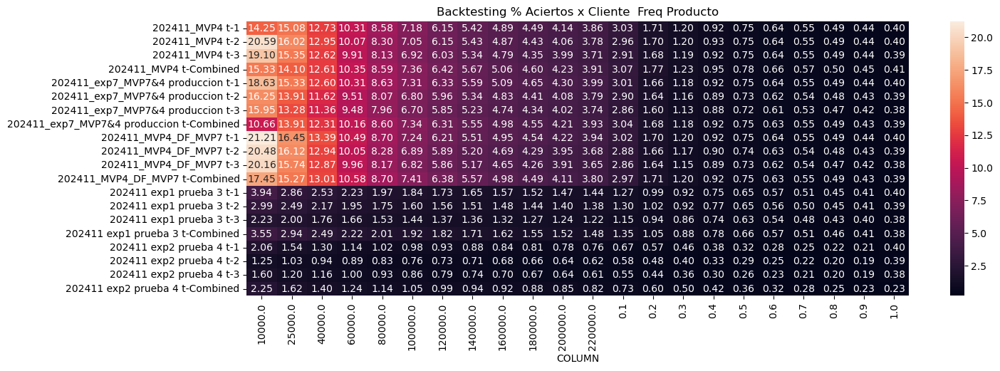

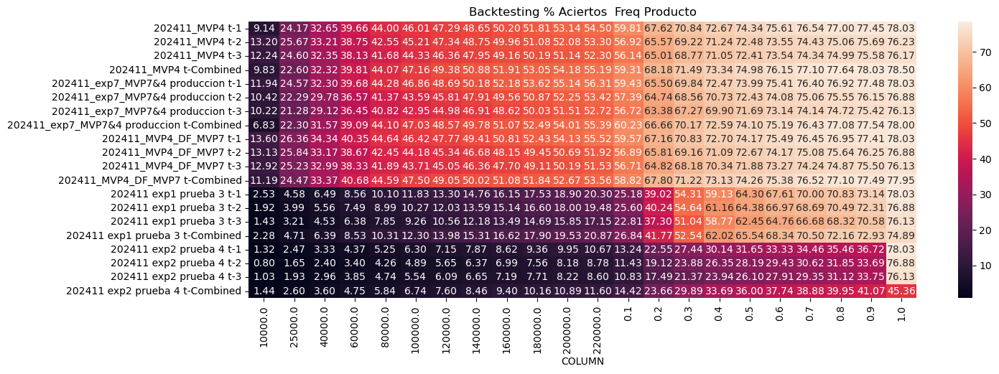

In [94]:
consolidacion_tipo = {}
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        df_i = save_backtesting[i]['contactabilidad_curva']#.keys()
        df_i = df_i[~df_i['Aciertos'].isnull()]
        df_i = df_i.replace('Fabrica '+params['target'].split('_')[0],name)
        df_i = df_i[df_i['Modelo'] == name]
        for tipo in df_i['Tipo'].unique():
            df_ii = df_i[df_i['Tipo'] == tipo]
            df_ii = df_ii.set_index('COLUMN')
            if tipo not in consolidacion_tipo:
                consolidacion_tipo[tipo] = {'Aciertos': pd.DataFrame(),'% Aciertos x Cliente':pd.DataFrame(),'% Aciertos': pd.DataFrame()}
            for col in ['Aciertos','% Aciertos x Cliente','% Aciertos']:
                consolidacion_tipo[tipo][col] = pd.concat([consolidacion_tipo[tipo][col],df_ii[[col]].rename(columns = {col:name})], axis = 1)
print(consolidacion_tipo.keys())
import seaborn as sns
for col in list(consolidacion_tipo.keys()):
    for tipo in ['Aciertos','% Aciertos x Cliente','% Aciertos']:
        if tipo == 'Aciertos':
            graph = consolidacion_tipo[col][tipo].T/1000
            msj = f'Backtesting {tipo} en Miles {col}'
        else:
            graph = consolidacion_tipo[col][tipo].T
            msj = f'Backtesting {tipo}  {col}'
        plt.figure(figsize=(15,5))
        sns.heatmap(graph, annot = True, fmt= '0.02f')
        plt.title(msj)
        plt.show()

In [95]:
nametag_model = ['202411_MVP4','202411_exp7_MVP7&4 produccion','202411_MVP4_DF_MVP7','202411 exp1','202411 exp2','202411 exp1_mas_exp2','202411 exp3 prueba5','202411 exp4 prueba6']
backtesting_all = [data_backtesting2,data_backtesting222222222,data_backtesting2222222222,data_backtesting22,data_backtesting222,data_backtesting2222,data_backtesting2222222,data_backtesting22222222]

dict_keys(['ID', 'Freq Producto'])


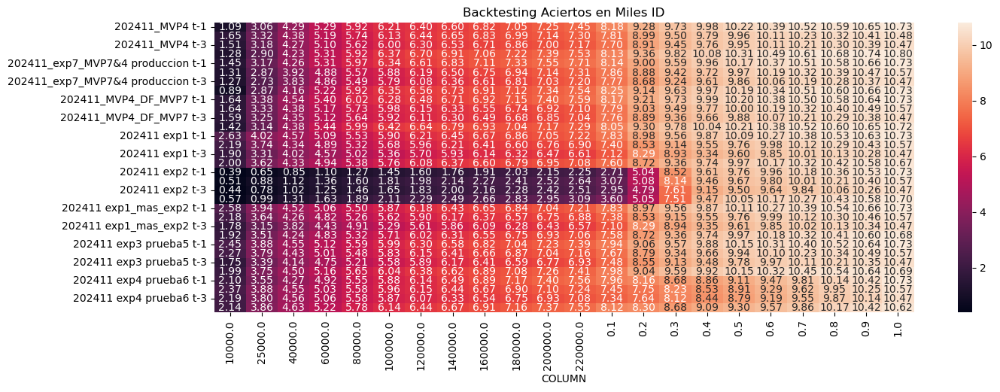

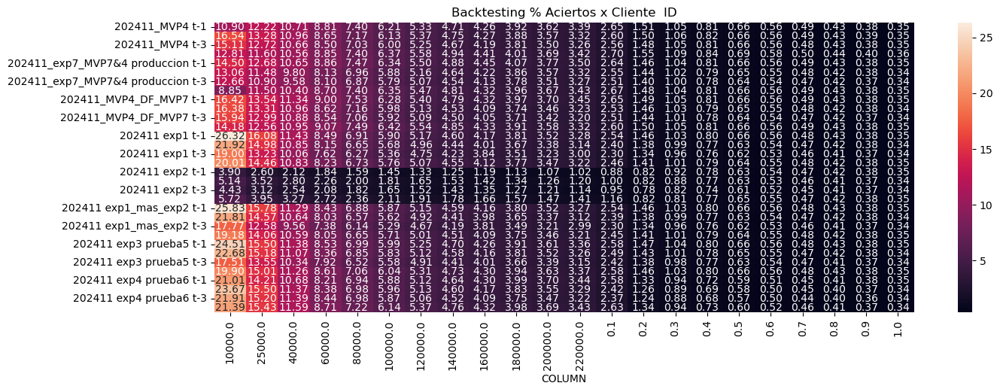

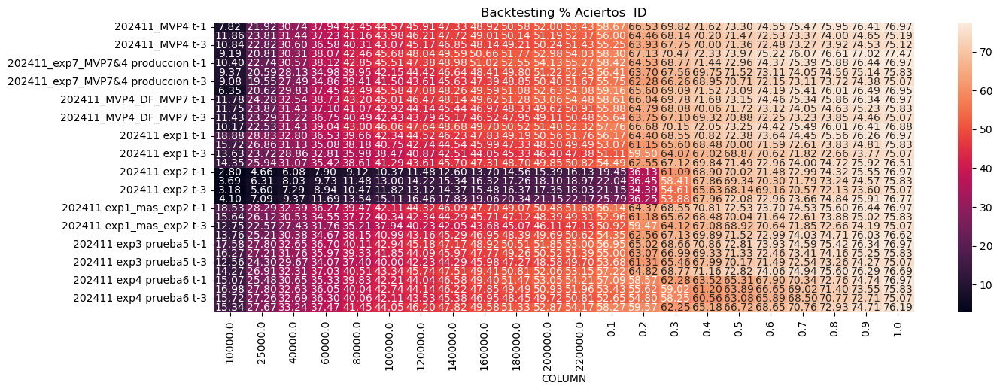

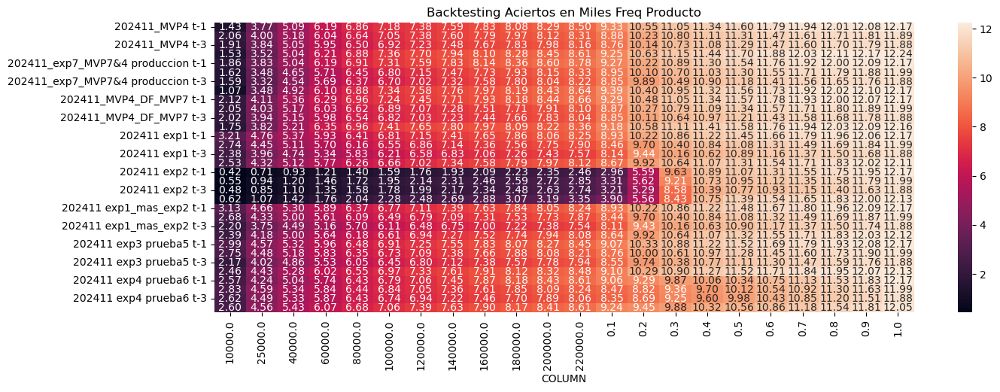

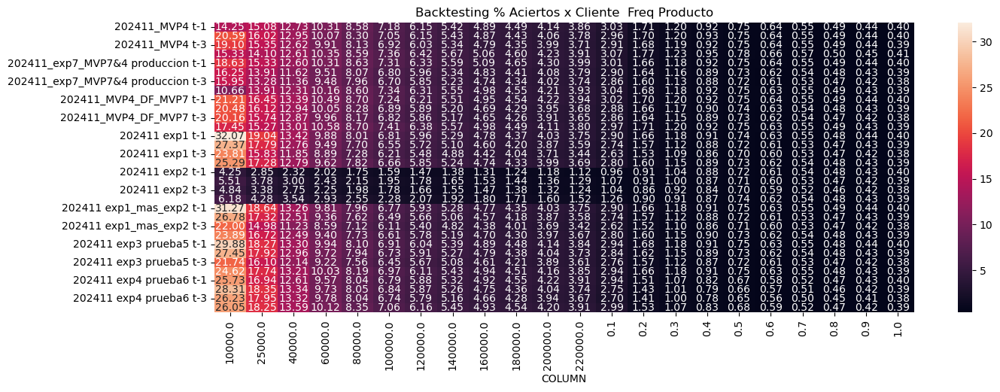

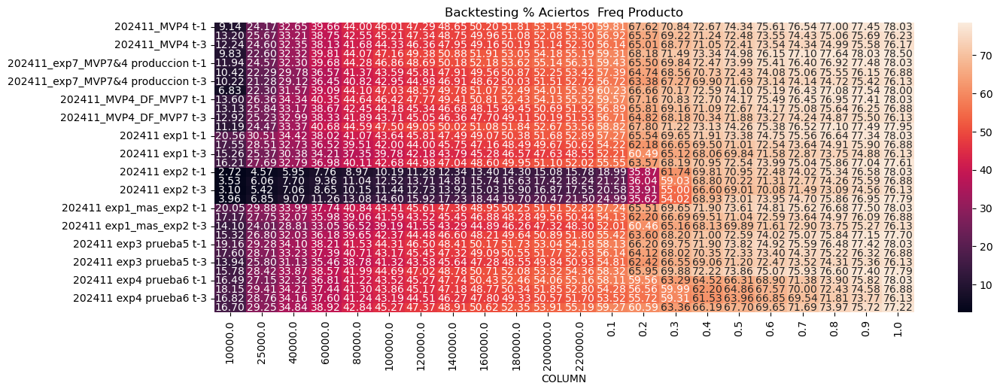

In [96]:
consolidacion_tipo = {}
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        df_i = save_backtesting[i]['contactabilidad_curva']#.keys()
        df_i = df_i[~df_i['Aciertos'].isnull()]
        df_i = df_i.replace('Fabrica '+params['target'].split('_')[0],name)
        df_i = df_i[df_i['Modelo'] == name]
        for tipo in df_i['Tipo'].unique():
            df_ii = df_i[df_i['Tipo'] == tipo]
            df_ii = df_ii.set_index('COLUMN')
            if tipo not in consolidacion_tipo:
                consolidacion_tipo[tipo] = {'Aciertos': pd.DataFrame(),'% Aciertos x Cliente':pd.DataFrame(),'% Aciertos': pd.DataFrame()}
            for col in ['Aciertos','% Aciertos x Cliente','% Aciertos']:
                consolidacion_tipo[tipo][col] = pd.concat([consolidacion_tipo[tipo][col],df_ii[[col]].rename(columns = {col:name})], axis = 1)
print(consolidacion_tipo.keys())
import seaborn as sns
for col in list(consolidacion_tipo.keys()):
    for tipo in ['Aciertos','% Aciertos x Cliente','% Aciertos']:
        if tipo == 'Aciertos':
            graph = consolidacion_tipo[col][tipo].T/1000
            msj = f'Backtesting {tipo} en Miles {col}'
        else:
            graph = consolidacion_tipo[col][tipo].T
            msj = f'Backtesting {tipo}  {col}'
        plt.figure(figsize=(15,5))
        sns.heatmap(graph, annot = True, fmt= '0.02f')
        plt.title(msj)
        plt.show()

In [97]:
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        print(name)
        res = save_backtesting[i]['ks']
        display(res)

202411_MVP4 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.33,17.06,308088,8179,2.65,76.22,10.00,66.22
1,9,0.20,0.33,308088,1096,0.36,86.43,20.00,66.43
2,8,0.17,0.20,308088,458,0.15,90.70,30.00,60.70
3,7,0.15,0.17,308088,252,0.08,93.05,40.00,53.05
4,6,0.14,0.15,308087,234,0.08,95.23,50.00,45.23
5,5,0.12,0.14,308088,174,0.06,96.85,60.00,36.85
6,4,0.11,0.12,305066,128,0.04,98.04,69.90,28.14
7,3,0.11,0.11,297724,67,0.02,98.67,79.57,19.10
8,2,0.11,0.11,321474,64,0.02,99.26,90.00,9.26
9,1,0.04,0.11,308088,79,0.03,100.00,100.00,0.00


202411_MVP4 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.20,17.06,300137,7807,2.60,74.48,10.00,64.48
1,9,0.08,0.20,300136,1180,0.39,85.74,20.00,65.74
2,8,0.05,0.08,300136,513,0.17,90.63,30.00,60.63
3,7,0.04,0.05,300137,287,0.10,93.37,40.00,53.37
4,6,0.03,0.04,300136,177,0.06,95.06,50.00,45.06
5,5,0.02,0.03,300136,148,0.05,96.47,60.00,36.47
6,4,0.02,0.02,299451,117,0.04,97.59,69.98,27.61
7,3,0.01,0.02,300822,88,0.03,98.43,80.00,18.43
8,2,0.01,0.01,300136,90,0.03,99.28,90.00,9.28
9,1,0.00,0.01,300137,75,0.02,100.00,100.00,0.00


202411_MVP4 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.23,17.05,301027,7703,2.56,73.55,10.0,63.55
1,9,0.09,0.23,301026,1209,0.40,85.10,20.0,65.09
2,8,0.05,0.09,301026,533,0.18,90.18,30.0,60.18
3,7,0.04,0.05,301026,314,0.10,93.18,40.0,53.18
4,6,0.03,0.04,301026,189,0.06,94.99,50.0,44.99
5,5,0.02,0.03,301026,157,0.05,96.49,60.0,36.49
6,4,0.02,0.02,301026,110,0.04,97.54,70.0,27.54
7,3,0.01,0.02,301026,90,0.03,98.40,80.0,18.40
8,2,0.01,0.01,301026,85,0.03,99.21,90.0,9.21
9,1,0.00,0.01,301027,83,0.03,100.00,100.0,0.00


202411_MVP4 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.51,17.06,298793,8113,2.72,75.12,10.00,65.12
1,9,0.21,0.51,298792,1240,0.42,86.60,20.00,66.60
2,8,0.17,0.21,298792,466,0.16,90.92,30.00,60.92
3,7,0.15,0.17,298793,255,0.09,93.28,40.00,53.28
4,6,0.14,0.15,298792,230,0.08,95.41,50.00,45.41
5,5,0.13,0.14,298792,177,0.06,97.05,60.00,37.05
6,4,0.12,0.13,297943,119,0.04,98.15,69.97,28.18
7,3,0.11,0.12,298658,77,0.03,98.86,79.97,18.89
8,2,0.11,0.11,299776,58,0.02,99.40,90.00,9.40
9,1,0.10,0.11,298793,65,0.02,100.00,100.00,0.00


202411_exp7_MVP7&4 produccion t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.29,16.99,308088,8145,2.64,75.90,10.00,65.90
1,9,0.22,0.29,308088,851,0.28,83.83,20.00,63.83
2,8,0.19,0.22,308088,591,0.19,89.34,30.00,59.34
3,7,0.18,0.19,308088,373,0.12,92.82,40.00,52.82
4,6,0.16,0.18,308087,211,0.07,94.78,50.00,44.78
5,5,0.13,0.16,295187,194,0.07,96.59,59.58,37.01
6,4,0.13,0.13,320989,145,0.05,97.94,70.00,27.94
7,3,0.12,0.13,308088,68,0.02,98.57,80.00,18.57
8,2,0.12,0.12,308088,78,0.03,99.30,90.00,9.30
9,1,0.04,0.12,308088,75,0.02,100.00,100.00,0.00


202411_exp7_MVP7&4 produccion t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.32,16.93,308346,7864,2.55,74.39,10.0,64.39
1,9,0.21,0.32,308346,1016,0.33,84.00,20.0,64.00
2,8,0.18,0.21,308346,538,0.17,89.08,30.0,59.08
3,7,0.16,0.18,308346,306,0.10,91.98,40.0,51.98
4,6,0.14,0.16,308346,246,0.08,94.31,50.0,44.31
5,5,0.12,0.14,308346,222,0.07,96.41,60.0,36.41
6,4,0.11,0.12,308346,132,0.04,97.65,70.0,27.65
7,3,0.11,0.11,308346,71,0.02,98.33,80.0,18.33
8,2,0.11,0.11,308346,80,0.03,99.08,90.0,9.08
9,1,0.04,0.11,308346,97,0.03,100.00,100.0,0.00


202411_exp7_MVP7&4 produccion t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.32,16.92,309230,7772,2.51,74.26,10.00,64.26
1,9,0.21,0.32,309229,911,0.29,82.96,20.00,62.96
2,8,0.19,0.21,309230,554,0.18,88.26,30.00,58.26
3,7,0.17,0.19,309229,376,0.12,91.85,40.00,51.85
4,6,0.14,0.17,309229,244,0.08,94.18,50.00,44.18
5,5,0.12,0.14,309230,201,0.07,96.10,60.00,36.10
6,4,0.11,0.12,309229,134,0.04,97.38,70.00,27.38
7,3,0.11,0.11,308302,85,0.03,98.19,79.97,18.22
8,2,0.11,0.11,308438,92,0.03,99.07,89.94,9.13
9,1,0.04,0.11,310949,97,0.03,100.00,100.00,0.00


202411_exp7_MVP7&4 produccion t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.43,16.99,308088,8244,2.68,76.85,10.00,66.85
1,9,0.25,0.43,308088,894,0.29,85.19,20.00,65.19
2,8,0.21,0.25,308088,490,0.16,89.75,30.00,59.75
3,7,0.19,0.21,308088,334,0.11,92.87,40.00,52.87
4,6,0.17,0.19,308088,224,0.07,94.96,50.00,44.96
5,5,0.14,0.17,308088,155,0.05,96.40,60.00,36.40
6,4,0.13,0.14,308087,168,0.05,97.97,70.00,27.97
7,3,0.12,0.13,295181,82,0.03,98.73,79.58,19.15
8,2,0.12,0.12,320996,70,0.02,99.38,90.00,9.38
9,1,0.12,0.12,308088,66,0.02,100.00,100.00,0.00


202411_MVP4_DF_MVP7 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.31,17.05,308088,8171,2.65,76.14,10.0,66.14
1,9,0.20,0.31,308088,1035,0.34,85.79,20.0,65.79
2,8,0.17,0.20,308088,522,0.17,90.65,30.0,60.65
3,7,0.16,0.17,308088,265,0.09,93.12,40.0,53.12
4,6,0.14,0.16,308087,205,0.07,95.03,50.0,45.03
5,5,0.13,0.14,308088,182,0.06,96.73,60.0,36.73
6,4,0.12,0.13,308088,123,0.04,97.88,70.0,27.88
7,3,0.12,0.12,308059,73,0.02,98.56,80.0,18.56
8,2,0.12,0.12,308117,66,0.02,99.17,90.0,9.17
9,1,0.04,0.12,308088,89,0.03,100.00,100.0,0.00


202411_MVP4_DF_MVP7 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.34,17.06,308346,7790,2.53,73.69,10.00,63.69
1,9,0.20,0.34,308346,1243,0.40,85.44,20.00,65.44
2,8,0.17,0.20,308346,458,0.15,89.77,30.00,59.77
3,7,0.15,0.17,308346,276,0.09,92.39,40.00,52.39
4,6,0.14,0.15,308346,232,0.08,94.58,50.00,44.58
5,5,0.12,0.14,306514,194,0.06,96.42,59.94,36.47
6,4,0.11,0.12,309648,130,0.04,97.64,69.98,27.66
7,3,0.11,0.11,299715,80,0.03,98.40,79.70,18.70
8,2,0.11,0.11,317507,85,0.03,99.21,90.00,9.21
9,1,0.04,0.11,308346,84,0.03,100.00,100.00,0.00


202411_MVP4_DF_MVP7 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.33,17.05,309230,7757,2.51,74.12,10.00,64.12
1,9,0.20,0.33,309229,1131,0.37,84.92,20.00,64.92
2,8,0.17,0.20,309230,467,0.15,89.38,30.00,59.38
3,7,0.15,0.17,309229,309,0.10,92.34,40.00,52.34
4,6,0.14,0.15,309229,218,0.07,94.42,50.00,44.42
5,5,0.12,0.14,309230,190,0.06,96.24,60.00,36.24
6,4,0.11,0.12,309219,137,0.04,97.54,70.00,27.54
7,3,0.11,0.11,301153,86,0.03,98.37,79.74,18.63
8,2,0.11,0.11,317316,86,0.03,99.19,90.00,9.19
9,1,0.04,0.11,309230,85,0.03,100.00,100.00,0.00


202411_MVP4_DF_MVP7 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.53,17.06,308088,8047,2.61,75.08,10.0,65.08
1,9,0.24,0.53,308088,1245,0.40,86.70,20.0,66.70
2,8,0.19,0.24,308088,486,0.16,91.23,30.0,61.23
3,7,0.17,0.19,308088,261,0.08,93.66,40.0,53.66
4,6,0.16,0.17,308088,170,0.06,95.25,50.0,45.25
5,5,0.14,0.16,308088,160,0.05,96.74,60.0,36.74
6,4,0.13,0.14,308088,154,0.05,98.18,70.0,28.18
7,3,0.12,0.13,308088,72,0.02,98.85,80.0,18.85
8,2,0.12,0.12,308088,56,0.02,99.37,90.0,9.37
9,1,0.11,0.12,308088,67,0.02,100.00,100.0,0.00


202411 exp1 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,43.75,44.99,308088,7830,2.54,72.97,10.0,62.97
1,9,41.70,43.75,308088,1148,0.37,83.66,20.0,63.66
2,8,39.39,41.70,308088,579,0.19,89.06,30.0,59.06
3,7,37.40,39.39,308088,316,0.10,92.00,40.0,52.00
4,6,36.09,37.40,308087,217,0.07,94.03,50.0,44.03
5,5,35.90,36.09,308058,176,0.06,95.67,60.0,35.67
6,4,35.71,35.90,308118,113,0.04,96.72,70.0,26.72
7,3,35.10,35.71,308088,155,0.05,98.16,80.0,18.16
8,2,34.74,35.10,308082,98,0.03,99.08,90.0,9.08
9,1,33.85,34.74,308094,99,0.03,100.00,100.0,0.00


202411 exp1 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.38,44.99,308346,7398,2.40,69.98,10.0,59.98
1,9,43.44,44.38,308346,1127,0.37,80.64,20.0,60.64
2,8,42.28,43.44,308346,620,0.20,86.50,30.0,56.50
3,7,41.17,42.28,308346,402,0.13,90.30,40.0,50.30
4,6,40.22,41.17,308346,212,0.07,92.31,50.0,42.31
5,5,38.61,40.22,308346,221,0.07,94.40,60.0,34.40
6,4,37.21,38.61,308346,143,0.05,95.75,70.0,25.75
7,3,36.01,37.21,308346,169,0.05,97.35,80.0,17.35
8,2,35.43,36.01,308346,137,0.04,98.65,90.0,8.65
9,1,33.70,35.43,308346,143,0.05,100.00,100.0,0.00


202411 exp1 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.57,44.99,309230,7125,2.30,68.08,10.0,58.08
1,9,43.99,44.57,309229,1170,0.38,79.26,20.0,59.26
2,8,43.15,43.99,309230,637,0.21,85.34,30.0,55.34
3,7,42.42,43.15,306067,410,0.13,89.26,39.9,49.36
4,6,41.72,42.42,312391,259,0.08,91.74,50.0,41.74
5,5,40.57,41.72,309230,244,0.08,94.07,60.0,34.07
6,4,39.60,40.57,309229,167,0.05,95.66,70.0,25.66
7,3,38.68,39.60,309230,118,0.04,96.79,80.0,16.79
8,2,35.95,38.68,309225,154,0.05,98.26,90.0,8.26
9,1,33.70,35.95,309234,182,0.06,100.00,100.0,0.00


202411 exp1 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.61,44.99,308088,7592,2.46,71.18,10.00,61.18
1,9,44.09,44.61,308088,1125,0.37,81.73,20.00,61.73
2,8,43.32,44.09,308088,631,0.20,87.64,30.00,57.64
3,7,42.57,43.32,308088,385,0.12,91.25,40.00,51.25
4,6,41.88,42.57,308088,230,0.07,93.41,50.00,43.41
5,5,40.91,41.88,308088,207,0.07,95.35,60.00,35.35
6,4,39.83,40.91,308088,143,0.05,96.69,70.00,26.69
7,3,38.95,39.83,308088,97,0.03,97.60,80.00,17.60
8,2,35.99,38.95,306737,173,0.06,99.22,89.96,9.27
9,1,35.64,35.99,309439,83,0.03,100.00,100.00,0.00


202411 exp2 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.78,44.78,307930,2712,0.88,25.27,9.99,15.28
1,9,44.78,44.78,308211,2325,0.75,46.94,20.00,26.94
2,8,44.77,44.78,308123,3479,1.13,79.36,30.00,49.36
3,7,44.74,44.77,300568,1088,0.36,89.50,39.76,49.74
4,6,44.74,44.74,304891,151,0.05,90.90,49.65,41.25
5,5,44.73,44.74,318801,210,0.07,92.86,60.00,32.86
6,4,44.73,44.73,308090,211,0.07,94.83,70.00,24.83
7,3,44.72,44.73,307483,184,0.06,96.54,79.98,16.56
8,2,44.70,44.72,308691,173,0.06,98.15,90.00,8.15
9,1,27.24,44.70,308091,198,0.06,100.00,100.00,0.00


202411 exp2 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.78,44.78,308317,3072,1.00,29.06,10.0,19.06
1,9,44.78,44.78,308375,2009,0.65,48.06,20.0,28.06
2,8,44.77,44.78,308346,3062,0.99,77.02,30.0,47.02
3,7,44.75,44.77,308346,1317,0.43,89.48,40.0,49.48
4,6,44.74,44.75,308345,207,0.07,91.44,50.0,41.44
5,5,44.74,44.74,308345,133,0.04,92.70,60.0,32.70
6,4,44.73,44.74,308348,208,0.07,94.67,70.0,24.67
7,3,44.72,44.73,308346,203,0.07,96.59,80.0,16.59
8,2,44.70,44.72,308346,185,0.06,98.34,90.0,8.34
9,1,27.09,44.70,308346,176,0.06,100.00,100.0,0.00


202411 exp2 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.78,44.78,309230,2948,0.95,28.17,10.00,18.17
1,9,44.78,44.78,309229,1846,0.60,45.81,20.00,25.81
2,8,44.77,44.78,309230,2819,0.91,72.74,30.00,42.74
3,7,44.75,44.77,309229,1536,0.50,87.42,40.00,47.42
4,6,44.74,44.75,309219,351,0.11,90.77,50.00,40.77
5,5,44.74,44.74,309240,142,0.05,92.13,60.00,32.13
6,4,44.73,44.74,308739,192,0.06,93.96,69.98,23.98
7,3,44.72,44.73,309720,222,0.07,96.08,80.00,16.08
8,2,44.70,44.72,309229,204,0.07,98.03,90.00,8.03
9,1,26.79,44.70,309230,206,0.07,100.00,100.00,0.00


202411 exp2 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.78,44.78,308067,3593,1.17,33.57,10.0,23.57
1,9,44.78,44.78,308109,1455,0.47,47.17,20.0,27.17
2,8,44.78,44.78,308082,2426,0.79,69.84,30.0,39.84
3,7,44.77,44.78,308094,1985,0.64,88.39,40.0,48.39
4,6,44.75,44.77,308016,586,0.19,93.86,50.0,43.86
5,5,44.74,44.75,308160,125,0.04,95.03,60.0,35.03
6,4,44.74,44.74,308088,97,0.03,95.94,70.0,25.94
7,3,44.73,44.74,307945,164,0.05,97.47,80.0,17.47
8,2,44.72,44.73,308211,147,0.05,98.84,90.0,8.84
9,1,44.64,44.72,308108,124,0.04,100.00,100.0,0.00


202411 exp1_mas_exp2 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.57,45.19,308088,7827,2.54,72.94,10.00,62.94
1,9,43.53,44.57,308088,1147,0.37,83.63,20.00,63.63
2,8,42.37,43.53,308088,583,0.19,89.06,30.00,59.06
3,7,41.36,42.37,302881,304,0.10,91.89,39.83,52.06
4,6,40.70,41.36,313294,251,0.08,94.23,50.00,44.23
5,5,40.61,40.70,294253,155,0.05,95.68,59.55,36.13
6,4,40.51,40.61,321923,123,0.04,96.82,70.00,26.82
7,3,40.21,40.51,308088,149,0.05,98.21,80.00,18.21
8,2,39.98,40.21,308075,118,0.04,99.31,90.00,9.31
9,1,38.97,39.98,308101,74,0.02,100.00,100.00,0.00


202411 exp1_mas_exp2 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.88,45.19,308346,7383,2.39,69.84,10.0,59.84
1,9,44.41,44.88,308346,1146,0.37,80.68,20.0,60.68
2,8,43.82,44.41,308346,619,0.20,86.53,30.0,56.53
3,7,43.25,43.82,308346,399,0.13,90.30,40.0,50.30
4,6,42.78,43.25,308346,217,0.07,92.36,50.0,42.36
5,5,41.96,42.78,308346,223,0.07,94.47,60.0,34.47
6,4,41.27,41.96,308346,136,0.04,95.75,70.0,25.75
7,3,40.67,41.27,308346,177,0.06,97.43,80.0,17.43
8,2,40.25,40.67,308346,159,0.05,98.93,90.0,8.93
9,1,39.16,40.25,308346,113,0.04,100.00,100.0,0.00


202411 exp1_mas_exp2 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.98,45.19,309230,7099,2.30,67.83,10.0,57.83
1,9,44.68,44.98,309229,1192,0.39,79.22,20.0,59.22
2,8,44.26,44.68,309230,648,0.21,85.41,30.0,55.41
3,7,43.88,44.26,309229,412,0.13,89.35,40.0,49.35
4,6,43.53,43.88,309229,257,0.08,91.80,50.0,41.80
5,5,42.94,43.53,309230,240,0.08,94.10,60.0,34.10
6,4,42.46,42.94,309229,168,0.05,95.70,70.0,25.70
7,3,42.00,42.46,309230,114,0.04,96.79,80.0,16.79
8,2,40.49,42.00,309229,213,0.07,98.82,90.0,8.82
9,1,39.09,40.49,309230,123,0.04,100.00,100.0,0.00


202411 exp1_mas_exp2 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,45.00,45.19,308088,7573,2.46,70.89,10.0,60.89
1,9,44.73,45.00,308088,1137,0.37,81.54,20.0,61.54
2,8,44.34,44.73,308088,645,0.21,87.58,30.0,57.58
3,7,43.96,44.34,308088,381,0.12,91.14,40.0,51.14
4,6,43.61,43.96,308088,233,0.08,93.33,50.0,43.33
5,5,43.12,43.61,308088,204,0.07,95.23,60.0,35.23
6,4,42.58,43.12,308088,144,0.05,96.58,70.0,26.58
7,3,42.13,42.58,308088,94,0.03,97.46,80.0,17.46
8,2,40.63,42.13,308088,176,0.06,99.11,90.0,9.11
9,1,40.44,40.63,308088,95,0.03,100.00,100.0,0.00


202411 exp3 prueba5 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.64,45.02,308088,7940,2.58,73.99,10.0,63.99
1,9,44.02,44.64,308086,1124,0.36,84.47,20.0,64.47
2,8,43.21,44.02,308090,508,0.16,89.20,30.0,59.20
3,7,42.38,43.21,308088,307,0.10,92.06,40.0,52.06
4,6,41.12,42.38,308087,272,0.09,94.60,50.0,44.60
5,5,39.97,41.12,308088,156,0.05,96.05,60.0,36.05
6,4,39.16,39.97,308088,91,0.03,96.90,70.0,26.90
7,3,37.45,39.16,308088,117,0.04,97.99,80.0,17.99
8,2,34.64,37.45,308088,127,0.04,99.17,90.0,9.17
9,1,32.18,34.64,308088,89,0.03,100.00,100.0,0.00


202411 exp3 prueba5 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.72,45.02,308346,7667,2.49,72.52,10.0,62.52
1,9,44.27,44.72,308346,1125,0.36,83.16,20.0,63.16
2,8,43.65,44.27,308346,547,0.18,88.34,30.0,58.34
3,7,42.96,43.65,308346,326,0.11,91.42,40.0,51.42
4,6,42.00,42.96,308346,279,0.09,94.06,50.0,44.06
5,5,41.03,42.00,308346,157,0.05,95.54,60.0,35.54
6,4,39.87,41.03,308346,133,0.04,96.80,70.0,26.80
7,3,38.88,39.87,308346,104,0.03,97.79,80.0,17.79
8,2,34.75,38.88,308346,153,0.05,99.23,90.0,9.23
9,1,32.07,34.75,308346,81,0.03,100.00,100.0,0.00


202411 exp3 prueba5 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.76,45.02,309230,7483,2.42,71.50,10.0,61.50
1,9,44.40,44.76,309229,1064,0.34,81.66,20.0,61.66
2,8,43.89,44.40,309230,579,0.19,87.20,30.0,57.20
3,7,43.28,43.89,309229,353,0.11,90.57,40.0,50.57
4,6,42.42,43.28,309229,304,0.10,93.47,50.0,43.47
5,5,41.53,42.42,309230,183,0.06,95.22,60.0,35.22
6,4,40.44,41.53,309229,147,0.05,96.63,70.0,26.63
7,3,39.57,40.44,309230,100,0.03,97.58,80.0,17.58
8,2,35.50,39.57,309229,141,0.05,98.93,90.0,8.93
9,1,31.92,35.50,309230,112,0.04,100.00,100.0,0.00


202411 exp3 prueba5 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.81,45.02,308088,7965,2.59,74.49,10.0,64.49
1,9,44.51,44.81,308088,1069,0.35,84.49,20.0,64.49
2,8,44.05,44.51,308088,545,0.18,89.59,30.0,59.59
3,7,43.53,44.05,308088,336,0.11,92.73,40.0,52.73
4,6,42.85,43.53,308088,235,0.08,94.93,50.0,44.93
5,5,41.90,42.85,308088,175,0.06,96.57,60.0,36.57
6,4,40.79,41.90,308088,119,0.04,97.68,70.0,27.68
7,3,39.67,40.79,308088,92,0.03,98.54,80.0,18.54
8,2,37.52,39.67,308088,94,0.03,99.42,90.0,9.42
9,1,34.85,37.52,308088,62,0.02,100.00,100.0,0.00


202411 exp4 prueba6 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,30.30,39.67,294113,7950,2.70,74.08,9.55,64.54
1,9,30.22,30.30,322063,215,0.07,76.09,20.00,56.09
2,8,30.03,30.22,308088,518,0.17,80.92,30.00,50.92
3,7,29.99,30.03,308088,172,0.06,82.52,40.00,42.52
4,6,29.91,29.99,308087,250,0.08,84.85,50.00,34.85
5,5,29.88,29.91,308088,361,0.12,88.21,60.00,28.21
6,4,29.87,29.88,308088,340,0.11,91.38,70.00,21.38
7,3,29.80,29.87,307886,338,0.11,94.53,79.99,14.54
8,2,29.75,29.80,306840,276,0.09,97.10,89.95,7.15
9,1,0.43,29.75,309538,311,0.10,100.00,100.00,0.00


202411 exp4 prueba6 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,30.38,39.69,306030,7448,2.43,70.45,9.92,60.53
1,9,30.28,30.38,310662,306,0.10,73.34,20.00,53.34
2,8,30.10,30.28,308346,474,0.15,77.83,30.00,47.83
3,7,30.01,30.10,308346,304,0.10,80.70,40.00,40.70
4,6,29.90,30.01,308346,375,0.12,84.25,50.00,34.25
5,5,29.88,29.90,308346,384,0.12,87.88,60.00,27.88
6,4,29.87,29.88,308346,331,0.11,91.01,70.00,21.01
7,3,29.81,29.87,308346,332,0.11,94.15,80.00,14.15
8,2,29.76,29.81,308346,299,0.10,96.98,90.00,6.98
9,1,0.43,29.76,308346,319,0.10,100.00,100.00,0.00


202411 exp4 prueba6 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,30.38,39.67,309229,7340,2.37,70.13,10.0,60.13
1,9,30.29,30.38,309230,300,0.10,73.00,20.0,53.00
2,8,30.11,30.29,309230,481,0.16,77.59,30.0,47.59
3,7,30.01,30.11,309229,321,0.10,80.66,40.0,40.66
4,6,29.91,30.01,309229,352,0.11,84.02,50.0,34.02
5,5,29.88,29.91,309230,392,0.13,87.77,60.0,27.77
6,4,29.88,29.88,309229,364,0.12,91.25,70.0,21.25
7,3,29.82,29.88,309230,316,0.10,94.27,80.0,14.27
8,2,29.76,29.82,309229,270,0.09,96.85,90.0,6.85
9,1,0.32,29.76,309230,330,0.11,100.00,100.0,0.00


202411 exp4 prueba6 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,30.38,39.69,307869,8124,2.64,76.49,9.99,66.50
1,9,30.34,30.38,308138,180,0.06,78.18,19.99,58.19
2,8,30.20,30.34,308257,365,0.12,81.62,30.00,51.62
3,7,30.06,30.20,308088,413,0.13,85.51,40.00,45.51
4,6,30.00,30.06,308088,215,0.07,87.53,50.00,37.53
5,5,29.92,30.00,308088,267,0.09,90.05,60.00,30.05
6,4,29.88,29.92,308088,290,0.09,92.78,70.00,22.78
7,3,29.88,29.88,308088,309,0.10,95.69,80.00,15.69
8,2,29.84,29.88,308088,243,0.08,97.98,90.00,7.98
9,1,29.75,29.84,308088,215,0.07,100.00,100.00,0.00


In [98]:
wanted_metric = ['N all','N n_top','true_sum n_top','backtest_metric n_top','Precision n_top','recall n_top','f1-score n_top']
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        print(name,'Top Metrics')
        res = save_backtesting[i]['metrics']
        display(res[(res["metric_name"].isin(wanted_metric))&(res["class_name"].isin(['1.0','1',1,1.0,'dim shape']))].drop('timestamp', axis=1))
        display(res[res["metric_name"].isin(['True negatives','True positives','False negatives','False positives'])])
        print('------------')

202411_MVP4 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,1.0533
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,1.0533
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,2.0846
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,9735


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-20 17:29,CDT,"Ensamble,",202410,True positives,overall metric,overall,10731.0
19,2025-01-20 17:29,CDT,"Ensamble,",202410,False negatives,overall metric,overall,0.0
20,2025-01-20 17:29,CDT,"Ensamble,",202410,True negatives,overall metric,overall,0.0
21,2025-01-20 17:29,CDT,"Ensamble,",202410,False positives,overall metric,overall,2991686.0


------------
202411_MVP4 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,900409
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,3001364
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,1.0559
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,1.0559
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,2.0896
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,9507


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
20,2025-01-20 17:29,CDT,"Ensamble,",202410,True positives,overall metric,overall,10479.0
21,2025-01-20 17:29,CDT,"Ensamble,",202410,False negatives,overall metric,overall,3.0
22,2025-01-20 17:29,CDT,"Ensamble,",202410,True negatives,overall metric,overall,10362.0
23,2025-01-20 17:29,CDT,"Ensamble,",202410,False positives,overall metric,overall,2834260.0


------------
202411_MVP4 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,903078
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,3010262
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,1.0474
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,1.0474
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,2.0731
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,9459


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
20,2025-01-20 17:29,CDT,"Ensamble,",202410,True positives,overall metric,overall,10469.0
21,2025-01-20 17:29,CDT,"Ensamble,",202410,False negatives,overall metric,overall,4.0
22,2025-01-20 17:29,CDT,"Ensamble,",202410,True negatives,overall metric,overall,9613.0
23,2025-01-20 17:29,CDT,"Ensamble,",202410,False positives,overall metric,overall,2770661.0


------------
202411_MVP4 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,896377
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,2987924
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,1.096
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,1.096
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,2.1682
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,9824


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-20 17:29,CDT,"Ensamble,",202410,True positives,overall metric,overall,10800.0
19,2025-01-20 17:29,CDT,"Ensamble,",202410,False negatives,overall metric,overall,0.0
20,2025-01-20 17:29,CDT,"Ensamble,",202410,True negatives,overall metric,overall,0.0
21,2025-01-20 17:29,CDT,"Ensamble,",202410,False positives,overall metric,overall,2898974.0


------------
202411_exp7_MVP7&4 produccion t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202501,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202501,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202501,backtest_metric n_top,n_top,1.0,1.0376
3,CDT,"Ensamble,",202501,Precision n_top,n_top,1,1.0376
5,CDT,"Ensamble,",202501,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202501,f1-score n_top,n_top,1,2.0539
9,CDT,"Ensamble,",202501,true_sum n_top,n_top,1,9590


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-04 14:37,CDT,"Ensamble,",202501,True positives,overall metric,overall,10731.0
19,2025-02-04 14:37,CDT,"Ensamble,",202501,False negatives,overall metric,overall,0.0
20,2025-02-04 14:37,CDT,"Ensamble,",202501,True negatives,overall metric,overall,0.0
21,2025-02-04 14:37,CDT,"Ensamble,",202501,False positives,overall metric,overall,2991686.0


------------
202411_exp7_MVP7&4 produccion t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202501,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202501,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202501,backtest_metric n_top,n_top,1.0,1.0188
3,CDT,"Ensamble,",202501,Precision n_top,n_top,1,1.0188
5,CDT,"Ensamble,",202501,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202501,f1-score n_top,n_top,1,2.017
9,CDT,"Ensamble,",202501,true_sum n_top,n_top,1,9424


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-04 14:37,CDT,"Ensamble,",202501,True positives,overall metric,overall,10572.0
19,2025-02-04 14:37,CDT,"Ensamble,",202501,False negatives,overall metric,overall,0.0
20,2025-02-04 14:37,CDT,"Ensamble,",202501,True negatives,overall metric,overall,0.0
21,2025-02-04 14:37,CDT,"Ensamble,",202501,False positives,overall metric,overall,2925091.0


------------
202411_exp7_MVP7&4 produccion t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202501,N n_top,n_top,1,927688
1,CDT,"Ensamble,",202501,N all,dim shape,dim shape,3092295
2,CDT,"Ensamble,",202501,backtest_metric n_top,n_top,1.0,0.9967
3,CDT,"Ensamble,",202501,Precision n_top,n_top,1,0.9967
5,CDT,"Ensamble,",202501,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202501,f1-score n_top,n_top,1,1.9737
9,CDT,"Ensamble,",202501,true_sum n_top,n_top,1,9246


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-04 14:38,CDT,"Ensamble,",202501,True positives,overall metric,overall,10466.0
19,2025-02-04 14:38,CDT,"Ensamble,",202501,False negatives,overall metric,overall,0.0
20,2025-02-04 14:38,CDT,"Ensamble,",202501,True negatives,overall metric,overall,0.0
21,2025-02-04 14:38,CDT,"Ensamble,",202501,False positives,overall metric,overall,2858656.0


------------
202411_exp7_MVP7&4 produccion t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202501,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202501,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202501,backtest_metric n_top,n_top,1.0,1.0427
3,CDT,"Ensamble,",202501,Precision n_top,n_top,1,1.0427
5,CDT,"Ensamble,",202501,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202501,f1-score n_top,n_top,1,2.0638
9,CDT,"Ensamble,",202501,true_sum n_top,n_top,1,9637


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-04 14:38,CDT,"Ensamble,",202501,True positives,overall metric,overall,10727.0
19,2025-02-04 14:38,CDT,"Ensamble,",202501,False negatives,overall metric,overall,0.0
20,2025-02-04 14:38,CDT,"Ensamble,",202501,True negatives,overall metric,overall,0.0
21,2025-02-04 14:38,CDT,"Ensamble,",202501,False positives,overall metric,overall,2945090.0


------------
202411_MVP4_DF_MVP7 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,1.0528
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,1.0528
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,2.0837
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,9731


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 23:04,CDT,"Ensamble,",202412,True positives,overall metric,overall,10731.0
19,2025-02-03 23:04,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-02-03 23:04,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-02-03 23:04,CDT,"Ensamble,",202412,False positives,overall metric,overall,2991686.0


------------
202411_MVP4_DF_MVP7 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,1.0272
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,1.0272
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,2.0335
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,9502


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 23:04,CDT,"Ensamble,",202412,True positives,overall metric,overall,10572.0
19,2025-02-03 23:04,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-02-03 23:04,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-02-03 23:04,CDT,"Ensamble,",202412,False positives,overall metric,overall,2925091.0


------------
202411_MVP4_DF_MVP7 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,927688
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3092295
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,1.0103
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,1.0103
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,2.0003
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,9372


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 23:04,CDT,"Ensamble,",202412,True positives,overall metric,overall,10466.0
19,2025-02-03 23:04,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-02-03 23:04,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-02-03 23:04,CDT,"Ensamble,",202412,False positives,overall metric,overall,2858656.0


------------
202411_MVP4_DF_MVP7 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,1.0589
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,1.0589
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,2.0956
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,9787


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 23:05,CDT,"Ensamble,",202412,True positives,overall metric,overall,10718.0
19,2025-02-03 23:05,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-02-03 23:05,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-02-03 23:05,CDT,"Ensamble,",202412,False positives,overall metric,overall,2909717.0


------------
202411 exp1 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.0343
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.0343
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.0475
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,9560


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-14 16:08,CDT,"Ensamble,",202411,True positives,overall metric,overall,10731.0
19,2025-01-14 16:08,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-14 16:08,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-14 16:08,CDT,"Ensamble,",202411,False positives,overall metric,overall,2991686.0


------------
202411 exp1 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.9901
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.9901
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.9608
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,9159


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-14 16:08,CDT,"Ensamble,",202411,True positives,overall metric,overall,10572.0
19,2025-01-14 16:08,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-14 16:08,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-14 16:08,CDT,"Ensamble,",202411,False positives,overall metric,overall,2925091.0


------------
202411 exp1 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,927688
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3092295
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.9651
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.9651
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.9117
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,8953


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-14 16:09,CDT,"Ensamble,",202411,True positives,overall metric,overall,10466.0
19,2025-01-14 16:09,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-14 16:09,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-14 16:09,CDT,"Ensamble,",202411,False positives,overall metric,overall,2858656.0


------------
202411 exp1 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.0132
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.0132
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.0062
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,9365


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-14 16:09,CDT,"Ensamble,",202411,True positives,overall metric,overall,10666.0
19,2025-01-14 16:09,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-14 16:09,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-14 16:09,CDT,"Ensamble,",202411,False positives,overall metric,overall,2885660.0


------------
202411 exp2 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.922
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.922
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.8272
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,8522


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-24 21:08,CDT,"Ensamble,",202411,True positives,overall metric,overall,10731.0
19,2025-01-24 21:08,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-24 21:08,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-24 21:08,CDT,"Ensamble,",202411,False positives,overall metric,overall,2991686.0


------------
202411 exp2 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.8832
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.8832
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.7509
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,8170


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-24 21:08,CDT,"Ensamble,",202411,True positives,overall metric,overall,10572.0
19,2025-01-24 21:08,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-24 21:08,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-24 21:08,CDT,"Ensamble,",202411,False positives,overall metric,overall,2925091.0


------------
202411 exp2 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,927688
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3092295
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.828
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.828
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.6423
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,7681


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-24 21:08,CDT,"Ensamble,",202411,True positives,overall metric,overall,10466.0
19,2025-01-24 21:08,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-24 21:08,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-24 21:08,CDT,"Ensamble,",202411,False positives,overall metric,overall,2858656.0


------------
202411 exp2 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.8159
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.8159
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.6186
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,7541


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-24 21:09,CDT,"Ensamble,",202411,True positives,overall metric,overall,10702.0
19,2025-01-24 21:09,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-24 21:09,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-24 21:09,CDT,"Ensamble,",202411,False positives,overall metric,overall,2896264.0


------------
202411 exp1_mas_exp2 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.0343
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.0343
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.0475
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,9560


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-31 14:05,CDT,"Ensamble,",202411,True positives,overall metric,overall,10731.0
19,2025-01-31 14:05,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-31 14:05,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-31 14:05,CDT,"Ensamble,",202411,False positives,overall metric,overall,2991686.0


------------
202411 exp1_mas_exp2 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.9904
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.9904
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.9615
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,9162


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-31 14:06,CDT,"Ensamble,",202411,True positives,overall metric,overall,10572.0
19,2025-01-31 14:06,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-31 14:06,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-31 14:06,CDT,"Ensamble,",202411,False positives,overall metric,overall,2925091.0


------------
202411 exp1_mas_exp2 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,927688
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3092295
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.9653
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.9653
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.9121
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,8955


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-31 14:06,CDT,"Ensamble,",202411,True positives,overall metric,overall,10466.0
19,2025-01-31 14:06,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-31 14:06,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-31 14:06,CDT,"Ensamble,",202411,False positives,overall metric,overall,2858656.0


------------
202411 exp1_mas_exp2 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.0141
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.0141
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.0078
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,9373


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-31 14:06,CDT,"Ensamble,",202411,True positives,overall metric,overall,10682.0
19,2025-01-31 14:06,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-31 14:06,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-31 14:06,CDT,"Ensamble,",202411,False positives,overall metric,overall,2888929.0


------------
202411 exp3 prueba5 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202501,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202501,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202501,backtest_metric n_top,n_top,1.0,1.0357
3,CDT,"Ensamble,",202501,Precision n_top,n_top,1,1.0357
5,CDT,"Ensamble,",202501,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202501,f1-score n_top,n_top,1,2.0503
9,CDT,"Ensamble,",202501,true_sum n_top,n_top,1,9573


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 22:50,CDT,"Ensamble,",202501,True positives,overall metric,overall,10731.0
19,2025-02-03 22:50,CDT,"Ensamble,",202501,False negatives,overall metric,overall,0.0
20,2025-02-03 22:50,CDT,"Ensamble,",202501,True negatives,overall metric,overall,0.0
21,2025-02-03 22:50,CDT,"Ensamble,",202501,False positives,overall metric,overall,2991686.0


------------
202411 exp3 prueba5 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202501,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202501,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202501,backtest_metric n_top,n_top,1.0,1.0107
3,CDT,"Ensamble,",202501,Precision n_top,n_top,1,1.0107
5,CDT,"Ensamble,",202501,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202501,f1-score n_top,n_top,1,2.0011
9,CDT,"Ensamble,",202501,true_sum n_top,n_top,1,9349


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 22:51,CDT,"Ensamble,",202501,True positives,overall metric,overall,10572.0
19,2025-02-03 22:51,CDT,"Ensamble,",202501,False negatives,overall metric,overall,0.0
20,2025-02-03 22:51,CDT,"Ensamble,",202501,True negatives,overall metric,overall,0.0
21,2025-02-03 22:51,CDT,"Ensamble,",202501,False positives,overall metric,overall,2925091.0


------------
202411 exp3 prueba5 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202501,N n_top,n_top,1,927688
1,CDT,"Ensamble,",202501,N all,dim shape,dim shape,3092295
2,CDT,"Ensamble,",202501,backtest_metric n_top,n_top,1.0,0.9859
3,CDT,"Ensamble,",202501,Precision n_top,n_top,1,0.9859
5,CDT,"Ensamble,",202501,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202501,f1-score n_top,n_top,1,1.9525
9,CDT,"Ensamble,",202501,true_sum n_top,n_top,1,9146


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 22:51,CDT,"Ensamble,",202501,True positives,overall metric,overall,10466.0
19,2025-02-03 22:51,CDT,"Ensamble,",202501,False negatives,overall metric,overall,0.0
20,2025-02-03 22:51,CDT,"Ensamble,",202501,True negatives,overall metric,overall,0.0
21,2025-02-03 22:51,CDT,"Ensamble,",202501,False positives,overall metric,overall,2858656.0


------------
202411 exp3 prueba5 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202501,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202501,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202501,backtest_metric n_top,n_top,1.0,1.0384
3,CDT,"Ensamble,",202501,Precision n_top,n_top,1,1.0384
5,CDT,"Ensamble,",202501,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202501,f1-score n_top,n_top,1,2.0555
9,CDT,"Ensamble,",202501,true_sum n_top,n_top,1,9598


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 22:51,CDT,"Ensamble,",202501,True positives,overall metric,overall,10692.0
19,2025-02-03 22:51,CDT,"Ensamble,",202501,False negatives,overall metric,overall,0.0
20,2025-02-03 22:51,CDT,"Ensamble,",202501,True negatives,overall metric,overall,0.0
21,2025-02-03 22:51,CDT,"Ensamble,",202501,False positives,overall metric,overall,2885959.0


------------
202411 exp4 prueba6 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.9406
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.9406
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.8638
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,8694


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 16:34,CDT,"Ensamble,",202411,True positives,overall metric,overall,10731.0
19,2025-02-03 16:34,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-03 16:34,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-03 16:34,CDT,"Ensamble,",202411,False positives,overall metric,overall,2991686.0


------------
202411 exp4 prueba6 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.8976
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.8976
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.7792
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,8303


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 16:34,CDT,"Ensamble,",202411,True positives,overall metric,overall,10572.0
19,2025-02-03 16:34,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-03 16:34,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-03 16:34,CDT,"Ensamble,",202411,False positives,overall metric,overall,2925091.0


------------
202411 exp4 prueba6 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,927688
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3092295
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.8892
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.8892
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.7627
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,8249


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 16:34,CDT,"Ensamble,",202411,True positives,overall metric,overall,10466.0
19,2025-02-03 16:34,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-03 16:34,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-03 16:34,CDT,"Ensamble,",202411,False positives,overall metric,overall,2858656.0


------------
202411 exp4 prueba6 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,0.9494
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,0.9494
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,1.881
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,8775


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 16:35,CDT,"Ensamble,",202411,True positives,overall metric,overall,10621.0
19,2025-02-03 16:35,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-03 16:35,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-03 16:35,CDT,"Ensamble,",202411,False positives,overall metric,overall,2860992.0


------------


**Comparativo 202412**

In [8]:
data_backtesting3333333 = catalog.load("data_backtesting_202412_experimento7")
data_backtesting333333 = catalog.load("data_backtesting_202412_experimento6")
data_backtesting33333 = catalog.load("data_backtesting_202412_experimento5")
data_backtesting3333 = catalog.load("data_backtesting_202412_experimento4")
data_backtesting333 = catalog.load("data_backtesting_202412_experimento3")
data_backtesting33 = catalog.load("data_backtesting_202412_experimento1_mas_experimento2")
data_backtesting3 = catalog.load("data_backtesting_202412_anterior")

[02/03/25 20:20:12] INFO     Loading data from 'data_backtesting_202412_experimento6'           ]8;id=64569;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=923357;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/03/25 20:25:40] INFO     Loading data from 'data_backtesting_202412_experimento5'           ]8;id=342139;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=548279;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/03/25 20:31:08] INFO     Loading data from 'data_backtesting_202412_experimento4'           ]8;id=789269;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=103257;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/03/25 20:35:50] INFO     Loading data from 'data_backtesting_202412_experimento3'           ]8;id=735037;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=763349;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

[02/03/25 20:40:23] INFO     Loading data from                                                  ]8;id=778311;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=215595;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             'data_backtesting_202412_experimento1_mas_experimento2'                               
                             (PickleDataSet)...                                                                    

[02/03/25 20:46:12] INFO     Loading data from 'data_backtesting_202412_anterior'               ]8;id=134037;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=94080;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

In [85]:
nametag_model = ['202412_MVP4-DF MVP7','202412_exp7_MVP7&4 produccion','202412 exp1 prueba 3','202412 exp2 prueba 4'] # los edas
backtesting_all = [data_backtesting3,data_backtesting3333333,data_backtesting333,data_backtesting3333]

dict_keys(['ID', 'Freq Producto'])


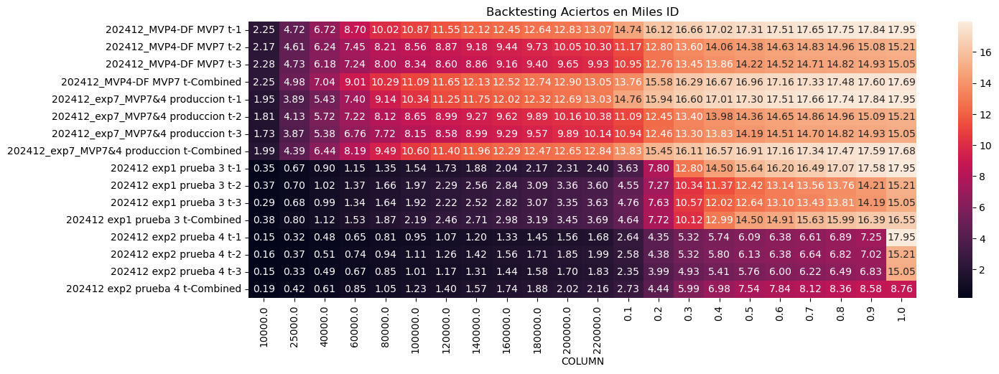

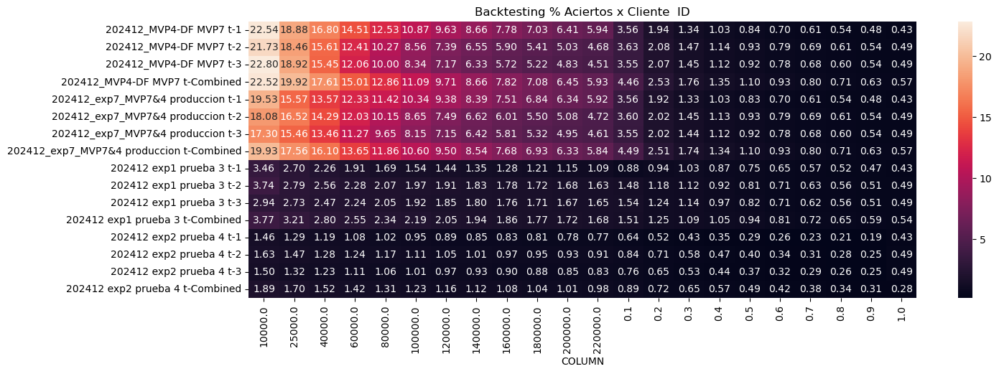

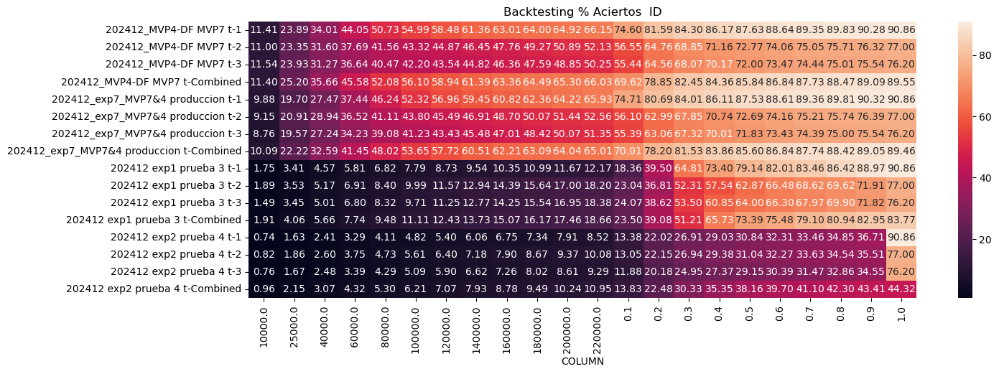

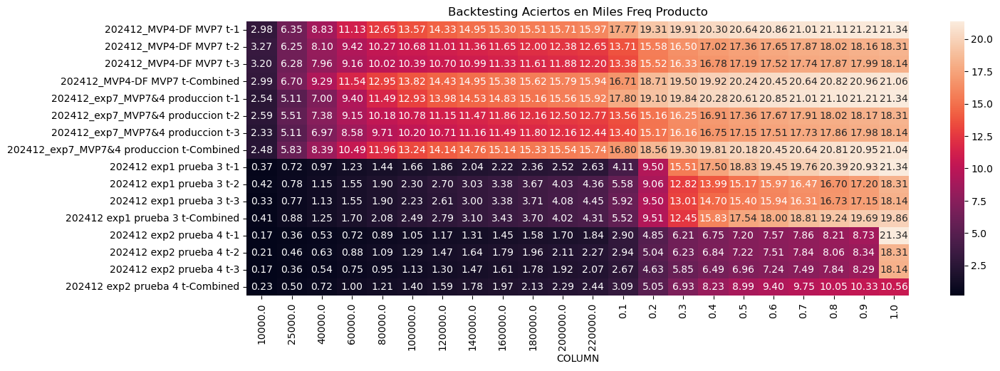

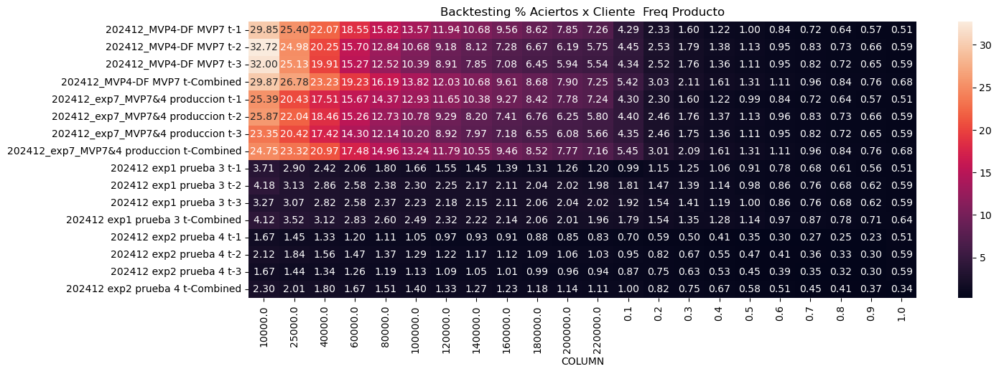

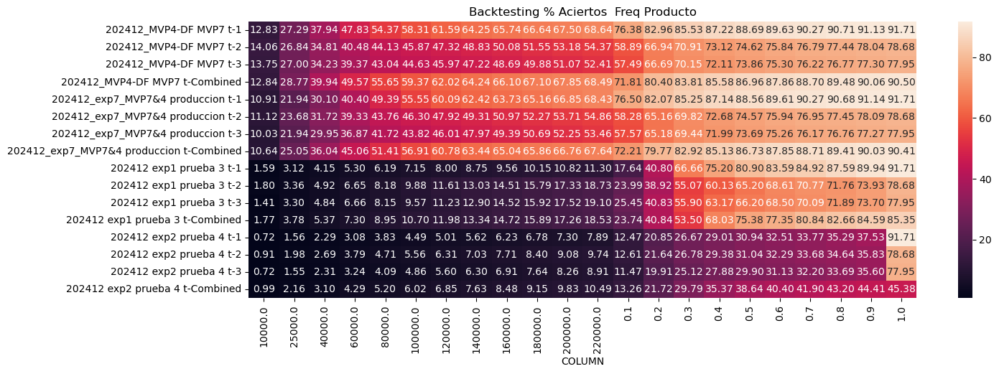

In [86]:
consolidacion_tipo = {}
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        df_i = save_backtesting[i]['contactabilidad_curva']#.keys()
        df_i = df_i[~df_i['Aciertos'].isnull()]
        df_i = df_i.replace('Fabrica '+params['target'].split('_')[0],name)
        df_i = df_i[df_i['Modelo'] == name]
        for tipo in df_i['Tipo'].unique():
            df_ii = df_i[df_i['Tipo'] == tipo]
            df_ii = df_ii.set_index('COLUMN')
            if tipo not in consolidacion_tipo:
                consolidacion_tipo[tipo] = {'Aciertos': pd.DataFrame(),'% Aciertos x Cliente':pd.DataFrame(),'% Aciertos': pd.DataFrame()}
            for col in ['Aciertos','% Aciertos x Cliente','% Aciertos']:
                consolidacion_tipo[tipo][col] = pd.concat([consolidacion_tipo[tipo][col],df_ii[[col]].rename(columns = {col:name})], axis = 1)
print(consolidacion_tipo.keys())
import seaborn as sns
for col in list(consolidacion_tipo.keys()):
    for tipo in ['Aciertos','% Aciertos x Cliente','% Aciertos']:
        if tipo == 'Aciertos':
            graph = consolidacion_tipo[col][tipo].T/1000
            msj = f'Backtesting {tipo} en Miles {col}'
        else:
            graph = consolidacion_tipo[col][tipo].T
            msj = f'Backtesting {tipo}  {col}'
        plt.figure(figsize=(15,5))
        sns.heatmap(graph, annot = True, fmt= '0.02f')
        plt.title(msj)
        plt.show()

In [87]:
nametag_model = ['202412_MVP4-DF MVP7','202412_exp7_MVP7&4 produccion','202412 exp1 mas_exp2','202412 exp3 prueba 5','202412 exp4 prueba 6']
backtesting_all = [data_backtesting3,data_backtesting3333333,data_backtesting33,data_backtesting33333,data_backtesting333333]

dict_keys(['ID', 'Freq Producto'])


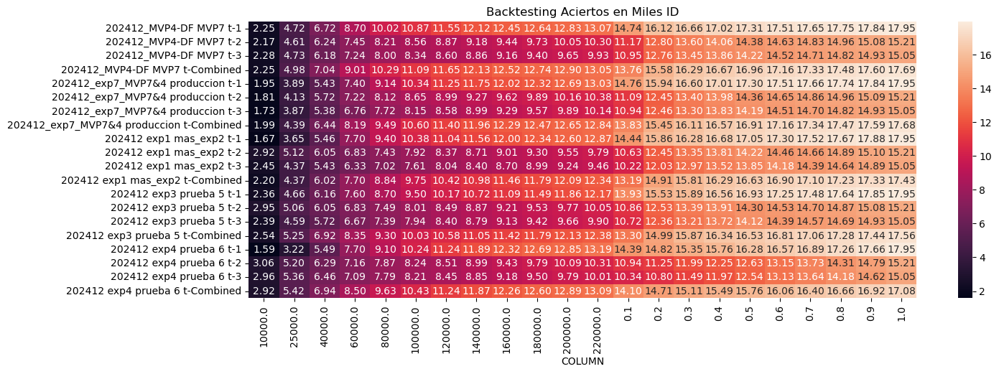

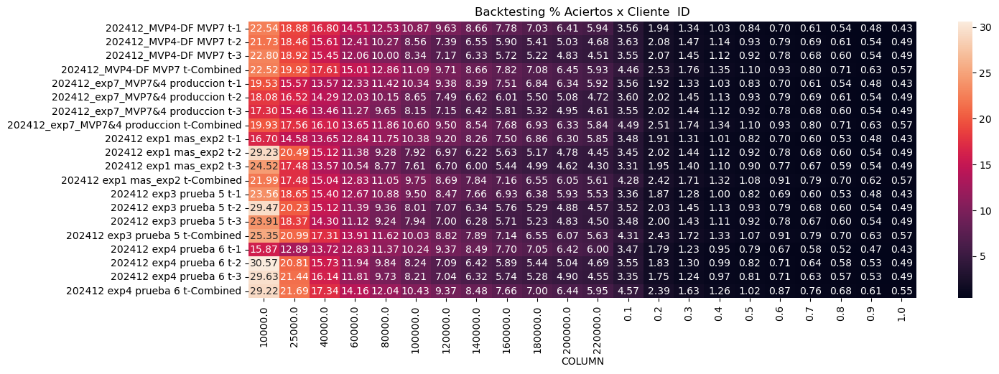

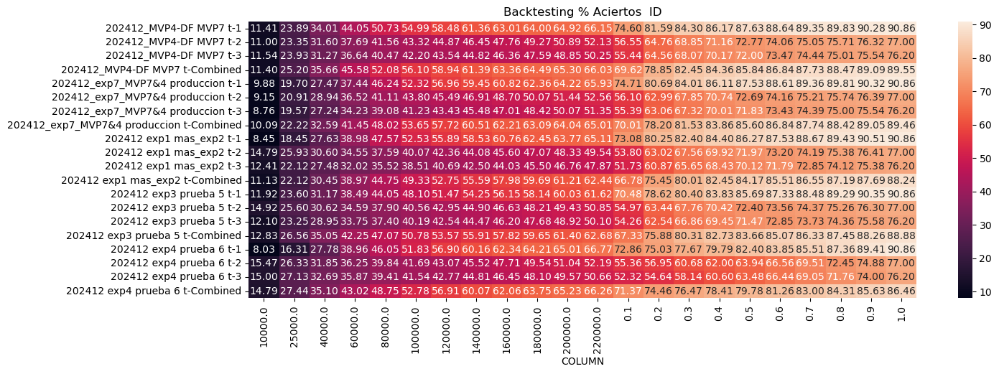

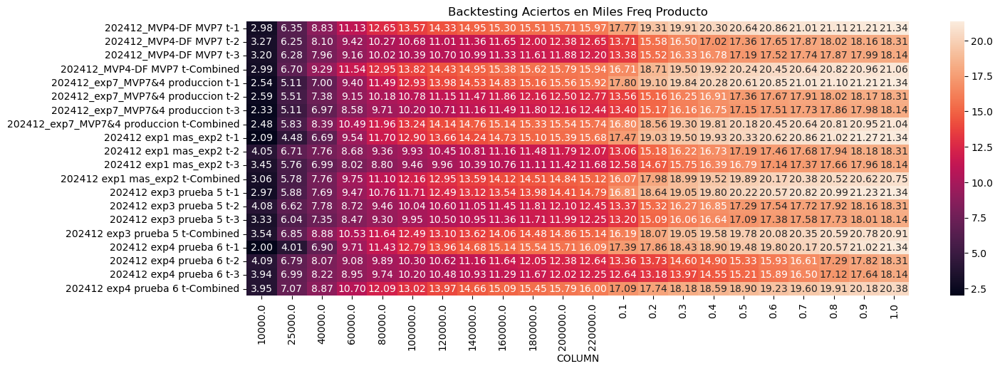

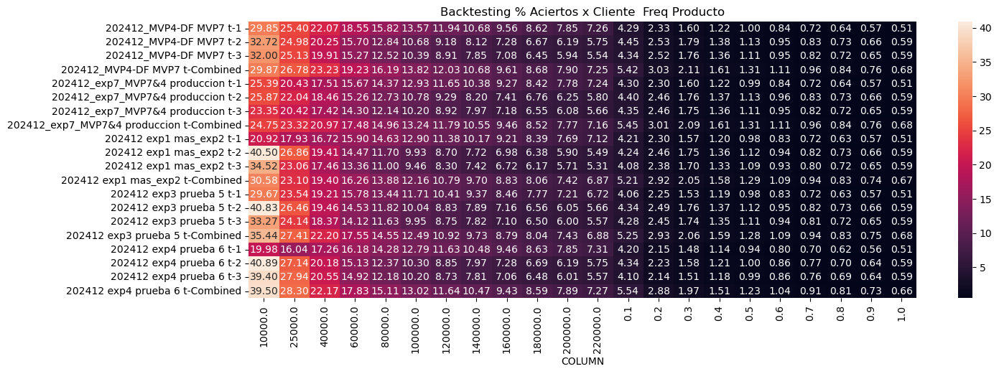

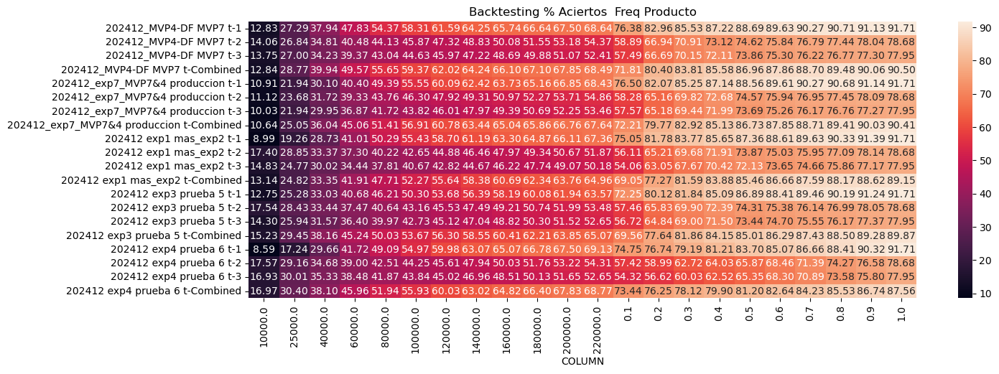

In [88]:
consolidacion_tipo = {}
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        df_i = save_backtesting[i]['contactabilidad_curva']#.keys()
        df_i = df_i[~df_i['Aciertos'].isnull()]
        df_i = df_i.replace('Fabrica '+params['target'].split('_')[0],name)
        df_i = df_i[df_i['Modelo'] == name]
        for tipo in df_i['Tipo'].unique():
            df_ii = df_i[df_i['Tipo'] == tipo]
            df_ii = df_ii.set_index('COLUMN')
            if tipo not in consolidacion_tipo:
                consolidacion_tipo[tipo] = {'Aciertos': pd.DataFrame(),'% Aciertos x Cliente':pd.DataFrame(),'% Aciertos': pd.DataFrame()}
            for col in ['Aciertos','% Aciertos x Cliente','% Aciertos']:
                consolidacion_tipo[tipo][col] = pd.concat([consolidacion_tipo[tipo][col],df_ii[[col]].rename(columns = {col:name})], axis = 1)
print(consolidacion_tipo.keys())
import seaborn as sns
for col in list(consolidacion_tipo.keys()):
    for tipo in ['Aciertos','% Aciertos x Cliente','% Aciertos']:
        if tipo == 'Aciertos':
            graph = consolidacion_tipo[col][tipo].T/1000
            msj = f'Backtesting {tipo} en Miles {col}'
        else:
            graph = consolidacion_tipo[col][tipo].T
            msj = f'Backtesting {tipo}  {col}'
        plt.figure(figsize=(15,5))
        sns.heatmap(graph, annot = True, fmt= '0.02f')
        plt.title(msj)
        plt.show()

In [89]:
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        print(name)
        res = save_backtesting[i]['ks']
        display(res)

202412_MVP4-DF MVP7 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.34,17.06,414480,14739,3.56,82.10,10.00,72.10
1,9,0.19,0.34,414480,1381,0.33,89.80,20.00,69.79
2,8,0.16,0.19,414480,536,0.13,92.78,30.00,62.78
3,7,0.14,0.16,414479,369,0.09,94.84,40.00,54.84
4,6,0.13,0.14,414480,289,0.07,96.45,50.00,46.45
5,5,0.12,0.13,414480,199,0.05,97.55,60.00,37.55
6,4,0.11,0.12,414479,140,0.03,98.33,70.00,28.33
7,3,0.11,0.11,414480,95,0.02,98.86,80.00,18.86
8,2,0.11,0.11,412250,90,0.02,99.36,89.95,9.42
9,1,0.03,0.11,416710,114,0.03,100.00,100.00,0.00


202412_MVP4-DF MVP7 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.31,17.05,308088,11174,3.63,73.45,10.0,63.45
1,9,0.20,0.31,308088,1622,0.53,84.11,20.0,64.11
2,8,0.17,0.20,308088,808,0.26,89.42,30.0,59.42
3,7,0.16,0.17,308088,455,0.15,92.41,40.0,52.41
4,6,0.14,0.16,308087,318,0.10,94.50,50.0,44.50
5,5,0.13,0.14,308088,256,0.08,96.18,60.0,36.18
6,4,0.12,0.13,308088,195,0.06,97.46,70.0,27.46
7,3,0.12,0.12,308059,130,0.04,98.32,80.0,18.32
8,2,0.12,0.12,308117,121,0.04,99.11,90.0,9.11
9,1,0.04,0.12,308088,135,0.04,100.00,100.0,0.00


202412_MVP4-DF MVP7 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.34,17.06,308346,10953,3.55,72.75,10.00,62.75
1,9,0.20,0.34,308346,1802,0.58,84.72,20.00,64.72
2,8,0.17,0.20,308346,695,0.23,89.34,30.00,59.34
3,7,0.15,0.17,308346,414,0.13,92.09,40.00,52.09
4,6,0.14,0.15,308346,361,0.12,94.49,50.00,44.49
5,5,0.12,0.14,306514,291,0.09,96.42,59.94,36.48
6,4,0.11,0.12,309648,192,0.06,97.70,69.98,27.71
7,3,0.11,0.11,299715,112,0.04,98.44,79.70,18.74
8,2,0.11,0.11,317507,106,0.03,99.14,90.00,9.14
9,1,0.04,0.11,308346,129,0.04,100.00,100.00,0.00


202412_MVP4-DF MVP7 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.88,17.06,308088,13753,4.46,77.73,10.00,67.73
1,9,0.28,0.88,308088,1824,0.59,88.04,20.00,68.04
2,8,0.21,0.28,308088,712,0.23,92.06,30.00,62.06
3,7,0.18,0.21,308088,378,0.12,94.20,40.00,54.20
4,6,0.17,0.18,308088,292,0.09,95.85,50.00,45.85
5,5,0.15,0.17,308088,197,0.06,96.96,60.00,36.96
6,4,0.14,0.15,308088,178,0.06,97.97,70.00,27.97
7,3,0.13,0.14,308088,144,0.05,98.78,80.00,18.78
8,2,0.12,0.13,302443,121,0.04,99.47,89.82,9.65
9,1,0.12,0.12,313733,94,0.03,100.00,100.00,0.00


202412_exp7_MVP7&4 produccion t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.34,16.97,414480,14761,3.56,82.22,10.00,72.22
1,9,0.21,0.34,414480,1181,0.28,88.80,20.00,68.80
2,8,0.18,0.21,414480,656,0.16,92.46,30.00,62.46
3,7,0.15,0.18,414479,415,0.10,94.77,40.00,54.77
4,6,0.13,0.15,414480,282,0.07,96.34,50.00,46.34
5,5,0.12,0.13,414480,213,0.05,97.53,60.00,37.53
6,4,0.11,0.12,414478,147,0.04,98.35,70.00,28.35
7,3,0.11,0.11,411706,89,0.02,98.84,79.93,18.91
8,2,0.11,0.11,417255,101,0.02,99.40,90.00,9.40
9,1,0.03,0.11,414480,107,0.03,100.00,100.00,0.00


202412_exp7_MVP7&4 produccion t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.29,16.99,308088,11085,3.60,72.86,10.00,62.86
1,9,0.22,0.29,308088,1361,0.44,81.81,20.00,61.81
2,8,0.19,0.22,308088,959,0.31,88.11,30.00,58.11
3,7,0.18,0.19,308088,572,0.19,91.87,40.00,51.87
4,6,0.16,0.18,308087,385,0.12,94.40,50.00,44.40
5,5,0.13,0.16,295187,284,0.10,96.27,59.58,36.69
6,4,0.13,0.13,320989,214,0.07,97.67,70.00,27.67
7,3,0.12,0.13,308088,104,0.03,98.36,80.00,18.36
8,2,0.12,0.12,308088,130,0.04,99.21,90.00,9.21
9,1,0.04,0.12,308088,120,0.04,100.00,100.00,0.00


202412_exp7_MVP7&4 produccion t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.32,16.93,308346,10943,3.55,72.69,10.0,62.69
1,9,0.21,0.32,308346,1516,0.49,82.76,20.0,62.76
2,8,0.18,0.21,308346,843,0.27,88.36,30.0,58.36
3,7,0.16,0.18,308346,530,0.17,91.88,40.0,51.88
4,6,0.14,0.16,308346,360,0.12,94.27,50.0,44.27
5,5,0.12,0.14,308346,316,0.10,96.37,60.0,36.37
6,4,0.11,0.12,308346,189,0.06,97.62,70.0,27.62
7,3,0.11,0.11,308346,121,0.04,98.43,80.0,18.43
8,2,0.11,0.11,308346,107,0.03,99.14,90.0,9.14
9,1,0.04,0.11,308346,130,0.04,100.00,100.0,0.00


202412_exp7_MVP7&4 produccion t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.66,16.99,308088,13833,4.49,78.26,10.00,68.26
1,9,0.28,0.66,308088,1614,0.52,87.39,20.00,67.39
2,8,0.23,0.28,308088,657,0.21,91.11,30.00,61.11
3,7,0.20,0.23,308088,465,0.15,93.74,40.00,53.74
4,6,0.18,0.20,308088,341,0.11,95.67,50.00,45.67
5,5,0.16,0.18,307913,247,0.08,97.07,59.99,37.07
6,4,0.14,0.16,308263,177,0.06,98.07,70.00,28.07
7,3,0.13,0.14,308088,135,0.04,98.83,80.00,18.83
8,2,0.13,0.13,308088,126,0.04,99.55,90.00,9.55
9,1,0.12,0.13,308088,80,0.03,100.00,100.00,0.00


202412 exp1 mas_exp2 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,43.99,45.19,414480,14440,3.48,80.44,10.0,70.44
1,9,42.06,43.99,414480,1416,0.34,88.32,20.0,68.32
2,8,40.93,42.06,414467,424,0.10,90.69,30.0,60.69
3,7,40.66,40.93,414492,396,0.10,92.89,40.0,52.89
4,6,40.46,40.66,414480,369,0.09,94.95,50.0,44.95
5,5,40.25,40.46,414480,250,0.06,96.34,60.0,36.34
6,4,40.10,40.25,414479,224,0.05,97.59,70.0,27.59
7,3,40.01,40.10,414480,150,0.04,98.42,80.0,18.42
8,2,39.76,40.01,414480,213,0.05,99.61,90.0,9.61
9,1,38.95,39.76,414480,70,0.02,100.00,100.0,0.00


202412 exp1 mas_exp2 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.57,45.19,308088,10630,3.45,69.87,10.00,59.87
1,9,43.53,44.57,308088,1821,0.59,81.84,20.00,61.84
2,8,42.37,43.53,308088,898,0.29,87.74,30.00,57.74
3,7,41.36,42.37,302881,457,0.15,90.75,39.83,50.91
4,6,40.70,41.36,313294,414,0.13,93.47,50.00,43.47
5,5,40.61,40.70,294253,230,0.08,94.98,59.55,35.43
6,4,40.51,40.61,321923,209,0.06,96.35,70.00,26.35
7,3,40.21,40.51,308088,234,0.08,97.89,80.00,17.89
8,2,39.98,40.21,308075,204,0.07,99.23,90.00,9.23
9,1,38.97,39.98,308101,117,0.04,100.00,100.00,0.00


202412 exp1 mas_exp2 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.88,45.19,308346,10221,3.31,67.89,10.0,57.89
1,9,44.41,44.88,308346,1806,0.59,79.89,20.0,59.89
2,8,43.82,44.41,308346,944,0.31,86.16,30.0,56.16
3,7,43.25,43.82,308346,549,0.18,89.80,40.0,49.80
4,6,42.78,43.25,308346,334,0.11,92.02,50.0,42.02
5,5,41.96,42.78,308346,330,0.11,94.21,60.0,34.21
6,4,41.27,41.96,308346,209,0.07,95.60,70.0,25.60
7,3,40.67,41.27,308346,252,0.08,97.28,80.0,17.28
8,2,40.25,40.67,308346,248,0.08,98.92,90.0,8.92
9,1,39.16,40.25,308346,162,0.05,100.00,100.0,0.00


202412 exp1 mas_exp2 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.96,45.19,308088,13193,4.28,75.67,10.0,65.67
1,9,44.60,44.96,308088,1712,0.56,85.49,20.0,65.49
2,8,44.09,44.60,308088,903,0.29,90.67,30.0,60.67
3,7,43.57,44.09,308088,481,0.16,93.43,40.0,53.43
4,6,43.11,43.57,308088,342,0.11,95.39,50.0,45.39
5,5,42.60,43.11,308088,265,0.09,96.91,60.0,36.91
6,4,41.89,42.60,308088,203,0.07,98.07,70.0,28.07
7,3,41.37,41.89,308088,126,0.04,98.80,80.0,18.80
8,2,40.95,41.37,308082,101,0.03,99.37,90.0,9.38
9,1,40.74,40.95,308094,109,0.04,100.00,100.0,0.00


202412 exp3 prueba 5 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.58,45.02,414480,13925,3.36,77.57,10.00,67.57
1,9,43.87,44.58,414480,1609,0.39,86.53,20.00,66.53
2,8,43.61,43.87,352151,339,0.10,88.42,28.50,59.92
3,7,42.55,43.61,476808,691,0.14,92.27,40.00,52.27
4,6,41.54,42.55,413343,366,0.09,94.31,49.97,44.33
5,5,40.12,41.54,415617,325,0.08,96.12,60.00,36.12
6,4,38.00,40.12,414479,227,0.05,97.38,70.00,27.38
7,3,35.63,38.00,414480,159,0.04,98.27,80.00,18.27
8,2,34.31,35.63,414480,210,0.05,99.44,90.00,9.44
9,1,32.02,34.31,414480,101,0.02,100.00,100.00,0.00


202412 exp3 prueba 5 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.64,45.02,308088,10860,3.52,71.38,10.0,61.38
1,9,44.02,44.64,308086,1674,0.54,82.38,20.0,62.38
2,8,43.21,44.02,308090,854,0.28,88.00,30.0,58.00
3,7,42.38,43.21,308088,526,0.17,91.46,40.0,51.46
4,6,41.12,42.38,308087,391,0.13,94.03,50.0,44.03
5,5,39.97,41.12,308088,229,0.07,95.53,60.0,35.53
6,4,39.16,39.97,308088,161,0.05,96.59,70.0,26.59
7,3,37.45,39.16,308088,174,0.06,97.73,80.0,17.73
8,2,34.64,37.45,308088,207,0.07,99.09,90.0,9.09
9,1,32.18,34.64,308088,138,0.04,100.00,100.0,0.00


202412 exp3 prueba 5 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.72,45.02,308346,10721,3.48,71.21,10.0,61.21
1,9,44.27,44.72,308346,1636,0.53,82.08,20.0,62.08
2,8,43.65,44.27,308346,853,0.28,87.74,30.0,57.74
3,7,42.96,43.65,308346,512,0.17,91.15,40.0,51.15
4,6,42.00,42.96,308346,399,0.13,93.80,50.0,43.80
5,5,41.03,42.00,308346,272,0.09,95.60,60.0,35.60
6,4,39.87,41.03,308346,174,0.06,96.76,70.0,26.76
7,3,38.88,39.87,308346,126,0.04,97.60,80.0,17.60
8,2,34.75,38.88,308346,241,0.08,99.20,90.0,9.20
9,1,32.07,34.75,308346,121,0.04,100.00,100.0,0.00


202412 exp3 prueba 5 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,44.84,45.02,308088,13302,4.32,75.75,10.00,65.75
1,9,44.56,44.84,308088,1687,0.55,85.36,20.00,65.36
2,8,44.17,44.56,308088,877,0.28,90.35,30.00,60.35
3,7,43.78,44.17,308088,478,0.16,93.08,40.00,53.08
4,6,43.61,43.78,298034,183,0.06,94.12,49.67,44.44
5,5,43.18,43.61,318142,280,0.09,95.71,60.00,35.71
6,4,42.58,43.18,303595,247,0.08,97.12,69.85,27.26
7,3,41.95,42.58,312581,221,0.07,98.38,80.00,18.38
8,2,41.31,41.95,308088,161,0.05,99.29,90.00,9.29
9,1,40.21,41.31,308088,124,0.04,100.00,100.00,0.00


202412 exp4 prueba 6 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,30.38,39.62,411260,14395,3.50,80.19,9.92,70.26
1,9,30.24,30.38,410528,426,0.10,82.56,19.83,62.73
2,8,30.06,30.24,342938,522,0.15,85.47,28.10,57.37
3,7,29.94,30.06,492783,421,0.09,87.81,39.99,47.82
4,6,29.88,29.94,396698,515,0.13,90.68,49.56,41.12
5,5,29.88,29.88,335657,270,0.08,92.18,57.66,34.53
6,4,29.87,29.88,511494,346,0.07,94.11,70.00,24.11
7,3,29.81,29.87,414480,366,0.09,96.15,80.00,16.15
8,2,29.74,29.81,414480,404,0.10,98.40,90.00,8.40
9,1,0.42,29.74,414480,287,0.07,100.00,100.00,0.00


202412 exp4 prueba 6 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,30.30,39.67,294113,10933,3.72,71.86,9.55,62.32
1,9,30.22,30.30,322063,319,0.10,73.96,20.00,53.96
2,8,30.03,30.22,308088,738,0.24,78.81,30.00,48.81
3,7,29.99,30.03,308088,260,0.08,80.52,40.00,40.52
4,6,29.91,29.99,308087,384,0.12,83.04,50.00,33.04
5,5,29.88,29.91,308088,517,0.17,86.44,60.00,26.44
6,4,29.87,29.88,308088,583,0.19,90.27,70.00,20.27
7,3,29.80,29.87,307886,581,0.19,94.09,79.99,14.10
8,2,29.75,29.80,306840,480,0.16,97.25,89.95,7.29
9,1,0.43,29.75,309538,419,0.14,100.00,100.00,0.00


202412 exp4 prueba 6 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,30.38,39.69,306030,10337,3.38,68.66,9.92,58.74
1,9,30.28,30.38,310662,459,0.15,71.71,20.00,51.71
2,8,30.10,30.28,308346,692,0.22,76.31,30.00,46.31
3,7,30.01,30.10,308346,485,0.16,79.53,40.00,39.53
4,6,29.90,30.01,308346,569,0.18,83.31,50.00,33.31
5,5,29.88,29.90,308346,586,0.19,87.20,60.00,27.20
6,4,29.87,29.88,308346,514,0.17,90.61,70.00,20.61
7,3,29.81,29.87,308346,536,0.17,94.17,80.00,14.17
8,2,29.76,29.81,308346,442,0.14,97.11,90.00,7.11
9,1,0.43,29.76,308346,435,0.14,100.00,100.00,0.00


202412 exp4 prueba 6 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,30.75,39.69,308088,14102,4.58,82.55,10.00,72.55
1,9,30.36,30.75,308073,609,0.20,86.12,20.00,66.12
2,8,30.24,30.36,274921,390,0.14,88.40,28.92,59.48
3,7,30.10,30.24,341264,389,0.11,90.68,40.00,50.68
4,6,30.03,30.10,308094,269,0.09,92.26,50.00,42.26
5,5,29.97,30.03,308082,296,0.10,93.99,60.00,33.99
6,4,29.89,29.97,308093,338,0.11,95.97,70.00,25.97
7,3,29.88,29.89,262607,257,0.10,97.47,78.52,18.95
8,2,29.88,29.88,347932,268,0.08,99.04,89.82,9.22
9,1,29.88,29.88,313726,164,0.05,100.00,100.00,0.00


In [90]:
wanted_metric = ['N all','N n_top','true_sum n_top','backtest_metric n_top','Precision n_top','recall n_top','f1-score n_top']
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        print(name,'Top Metrics')
        res = save_backtesting[i]['metrics']
        display(res[(res["metric_name"].isin(wanted_metric))&(res["class_name"].isin(['1.0','1',1,1.0,'dim shape']))].drop('timestamp', axis=1))
        display(res[res["metric_name"].isin(['True negatives','True positives','False negatives','False positives'])])
        print('------------')

202412_MVP4-DF MVP7 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,1243439
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,4144798
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,1.34
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,1.34
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,2.6445
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,16662


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-28 18:00,CDT,"Ensamble,",202412,True positives,overall metric,overall,17952.0
19,2025-01-28 18:00,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-01-28 18:00,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-01-28 18:00,CDT,"Ensamble,",202412,False positives,overall metric,overall,4044946.0


------------
202412_MVP4-DF MVP7 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,1.4731
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,1.4731
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,2.9034
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,13615


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-28 18:00,CDT,"Ensamble,",202412,True positives,overall metric,overall,15214.0
19,2025-01-28 18:00,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-01-28 18:00,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-01-28 18:00,CDT,"Ensamble,",202412,False positives,overall metric,overall,2923589.0


------------
202412_MVP4-DF MVP7 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,1.4556
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,1.4556
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,2.8695
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,13465


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-28 18:00,CDT,"Ensamble,",202412,True positives,overall metric,overall,15055.0
19,2025-01-28 18:00,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-01-28 18:00,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-01-28 18:00,CDT,"Ensamble,",202412,False positives,overall metric,overall,2859602.0


------------
202412_MVP4-DF MVP7 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,1.7644
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,1.7644
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,3.4677
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,16308


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-28 18:00,CDT,"Ensamble,",202412,True positives,overall metric,overall,17693.0
19,2025-01-28 18:00,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-01-28 18:00,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-01-28 18:00,CDT,"Ensamble,",202412,False positives,overall metric,overall,2967454.0


------------
202412_exp7_MVP7&4 produccion t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,1243439
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,4144798
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.3352
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.3352
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.6352
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,16602


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-04 14:20,CDT,"Ensamble,",202411,True positives,overall metric,overall,17952.0
19,2025-02-04 14:20,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-04 14:20,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-04 14:20,CDT,"Ensamble,",202411,False positives,overall metric,overall,4044946.0


------------
202412_exp7_MVP7&4 produccion t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.452
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.452
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.8624
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,13420


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-04 14:20,CDT,"Ensamble,",202411,True positives,overall metric,overall,15214.0
19,2025-02-04 14:20,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-04 14:20,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-04 14:20,CDT,"Ensamble,",202411,False positives,overall metric,overall,2923589.0


------------
202412_exp7_MVP7&4 produccion t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.4397
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.4397
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.8386
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,13318


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-04 14:20,CDT,"Ensamble,",202411,True positives,overall metric,overall,15055.0
19,2025-02-04 14:20,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-04 14:20,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-04 14:20,CDT,"Ensamble,",202411,False positives,overall metric,overall,2859602.0


------------
202412_exp7_MVP7&4 produccion t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.7439
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.7439
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,3.428
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,16118


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-04 14:21,CDT,"Ensamble,",202411,True positives,overall metric,overall,17675.0
19,2025-02-04 14:21,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-04 14:21,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-04 14:21,CDT,"Ensamble,",202411,False positives,overall metric,overall,2972561.0


------------
202412 exp1 mas_exp2 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,1243439
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,4144798
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.3095
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.3095
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.5852
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,16283


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-30 23:38,CDT,"Ensamble,",202411,True positives,overall metric,overall,17952.0
19,2025-01-30 23:38,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-30 23:38,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-30 23:38,CDT,"Ensamble,",202411,False positives,overall metric,overall,4044946.0


------------
202412 exp1 mas_exp2 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.4467
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.4467
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.8521
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,13371


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-30 23:39,CDT,"Ensamble,",202411,True positives,overall metric,overall,15214.0
19,2025-01-30 23:39,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-30 23:39,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-30 23:39,CDT,"Ensamble,",202411,False positives,overall metric,overall,2923589.0


------------
202412 exp1 mas_exp2 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.4061
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.4061
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.7732
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,13007


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-30 23:39,CDT,"Ensamble,",202411,True positives,overall metric,overall,15055.0
19,2025-01-30 23:39,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-30 23:39,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-30 23:39,CDT,"Ensamble,",202411,False positives,overall metric,overall,2859602.0


------------
202412 exp1 mas_exp2 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.7129
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.7129
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,3.3682
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,15832


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-30 23:40,CDT,"Ensamble,",202411,True positives,overall metric,overall,17435.0
19,2025-01-30 23:40,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-01-30 23:40,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-01-30 23:40,CDT,"Ensamble,",202411,False positives,overall metric,overall,2934312.0


------------
202412 exp3 prueba 5 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202501,N n_top,n_top,1,1243439
1,CDT,"Ensamble,",202501,N all,dim shape,dim shape,4144798
2,CDT,"Ensamble,",202501,backtest_metric n_top,n_top,1.0,1.2776
3,CDT,"Ensamble,",202501,Precision n_top,n_top,1,1.2776
5,CDT,"Ensamble,",202501,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202501,f1-score n_top,n_top,1,2.5229
9,CDT,"Ensamble,",202501,true_sum n_top,n_top,1,15886


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 21:41,CDT,"Ensamble,",202501,True positives,overall metric,overall,17952.0
19,2025-02-03 21:41,CDT,"Ensamble,",202501,False negatives,overall metric,overall,0.0
20,2025-02-03 21:41,CDT,"Ensamble,",202501,True negatives,overall metric,overall,0.0
21,2025-02-03 21:41,CDT,"Ensamble,",202501,False positives,overall metric,overall,4044946.0


------------
202412 exp3 prueba 5 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202501,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202501,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202501,backtest_metric n_top,n_top,1.0,1.4496
3,CDT,"Ensamble,",202501,Precision n_top,n_top,1,1.4496
5,CDT,"Ensamble,",202501,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202501,f1-score n_top,n_top,1,2.8577
9,CDT,"Ensamble,",202501,true_sum n_top,n_top,1,13398


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 21:42,CDT,"Ensamble,",202501,True positives,overall metric,overall,15214.0
19,2025-02-03 21:42,CDT,"Ensamble,",202501,False negatives,overall metric,overall,0.0
20,2025-02-03 21:42,CDT,"Ensamble,",202501,True negatives,overall metric,overall,0.0
21,2025-02-03 21:42,CDT,"Ensamble,",202501,False positives,overall metric,overall,2923589.0


------------
202412 exp3 prueba 5 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202501,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202501,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202501,backtest_metric n_top,n_top,1.0,1.4324
3,CDT,"Ensamble,",202501,Precision n_top,n_top,1,1.4324
5,CDT,"Ensamble,",202501,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202501,f1-score n_top,n_top,1,2.8243
9,CDT,"Ensamble,",202501,true_sum n_top,n_top,1,13250


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 21:42,CDT,"Ensamble,",202501,True positives,overall metric,overall,15055.0
19,2025-02-03 21:42,CDT,"Ensamble,",202501,False negatives,overall metric,overall,0.0
20,2025-02-03 21:42,CDT,"Ensamble,",202501,True negatives,overall metric,overall,0.0
21,2025-02-03 21:42,CDT,"Ensamble,",202501,False positives,overall metric,overall,2859602.0


------------
202412 exp3 prueba 5 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202501,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202501,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202501,backtest_metric n_top,n_top,1.0,1.719
3,CDT,"Ensamble,",202501,Precision n_top,n_top,1,1.719
5,CDT,"Ensamble,",202501,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202501,f1-score n_top,n_top,1,3.3799
9,CDT,"Ensamble,",202501,true_sum n_top,n_top,1,15888


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 21:42,CDT,"Ensamble,",202501,True positives,overall metric,overall,17560.0
19,2025-02-03 21:42,CDT,"Ensamble,",202501,False negatives,overall metric,overall,0.0
20,2025-02-03 21:42,CDT,"Ensamble,",202501,True negatives,overall metric,overall,0.0
21,2025-02-03 21:42,CDT,"Ensamble,",202501,False positives,overall metric,overall,2996672.0


------------
202412 exp4 prueba 6 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,1243439
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,4144798
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.2354
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.2354
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.4406
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,15361


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 17:35,CDT,"Ensamble,",202411,True positives,overall metric,overall,17952.0
19,2025-02-03 17:35,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-03 17:35,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-03 17:35,CDT,"Ensamble,",202411,False positives,overall metric,overall,4044946.0


------------
202412 exp4 prueba 6 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.2998
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.2998
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.5663
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,12014


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 17:35,CDT,"Ensamble,",202411,True positives,overall metric,overall,15214.0
19,2025-02-03 17:35,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-03 17:35,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-03 17:35,CDT,"Ensamble,",202411,False positives,overall metric,overall,2923589.0


------------
202412 exp4 prueba 6 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.2633
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.2633
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,2.4951
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,11686


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 17:36,CDT,"Ensamble,",202411,True positives,overall metric,overall,15055.0
19,2025-02-03 17:36,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-03 17:36,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-03 17:36,CDT,"Ensamble,",202411,False positives,overall metric,overall,2859602.0


------------
202412 exp4 prueba 6 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202411,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202411,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202411,backtest_metric n_top,n_top,1.0,1.636
3,CDT,"Ensamble,",202411,Precision n_top,n_top,1,1.636
5,CDT,"Ensamble,",202411,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202411,f1-score n_top,n_top,1,3.2193
9,CDT,"Ensamble,",202411,true_sum n_top,n_top,1,15121


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-02-03 17:36,CDT,"Ensamble,",202411,True positives,overall metric,overall,17082.0
19,2025-02-03 17:36,CDT,"Ensamble,",202411,False negatives,overall metric,overall,0.0
20,2025-02-03 17:36,CDT,"Ensamble,",202411,True negatives,overall metric,overall,0.0
21,2025-02-03 17:36,CDT,"Ensamble,",202411,False positives,overall metric,overall,2884976.0


------------


**Analisis extra de estabilidad del modelo MVP4 con data mala, MVP4 con data buena del MVP7 y MVP4 ejecuado en el codigo y datos del MVP7**

1. ``202410_MVP4`` y ``202411_MVP4`` son con el mejor modelo del MVP4 ejecuado con el codigo del MVP4 y prediciendo con los datos de mala calidad.
2. ``202410_exp7_MVP7&4 produccion``, ``202411_exp7_MVP7&4 produccion`` y ``202412_exp7_MVP7&4 produccion`` son el mejor modelo del MVP4 ejecuado con el codigo del MVP7 y prediciendo con los datos de buena calidad.
3. ``202412_MVP4 DF MVP7`` Mejor modelo del MVP4 ejecuado con el codigo del MVP4 y prediciendo con los datos de buena calidad.

In [105]:
# modelo entrenado en el MVP4, ejecutado en el MVP7 y con datos dle MVP7
data_backtesting11 = catalog.load("data_backtesting_202410_experimento7")
data_backtesting222222222 = catalog.load("data_backtesting_202411_experimento7") 
data_backtesting3333333 = catalog.load("data_backtesting_202412_experimento7") 
 # modelo chueco MVP4 con datos chuecos ejecutados desde el MVP4
data_backtesting1 = catalog.load("data_backtesting_202410_anterior")
data_backtesting2 = catalog.load("data_backtesting_202411_anterior")
 # modelo chueco MVP4 con datos buenos ejecutados desde el MVP4
data_backtesting3 = catalog.load("data_backtesting_202412_anterior")

[02/04/25 15:12:07] INFO     Loading data from 'data_backtesting_202410_anterior'               ]8;id=877831;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=844267;file:///home/sagemaker-user/.conda/envs/proyecto_fabrica/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\
                             (PickleDataSet)...                                                                    

In [107]:
nametag_model = ['202410_MVP4','202410_exp7_MVP7&4 produccion','202411_MVP4','202411_exp7_MVP7&4 produccion','202412_MVP4 DF MVP7','202412_exp7_MVP7&4 produccion']
backtesting_all = [data_backtesting1,data_backtesting11,data_backtesting2,data_backtesting222222222,data_backtesting3,data_backtesting3333333]

dict_keys(['ID', 'Freq Producto'])


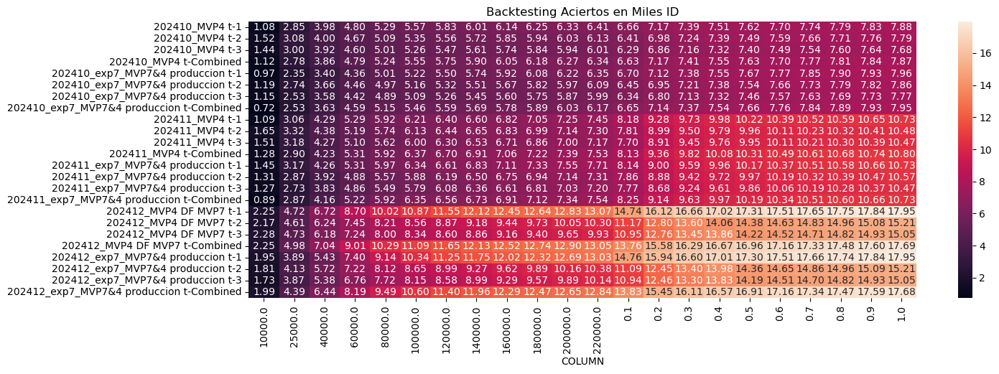

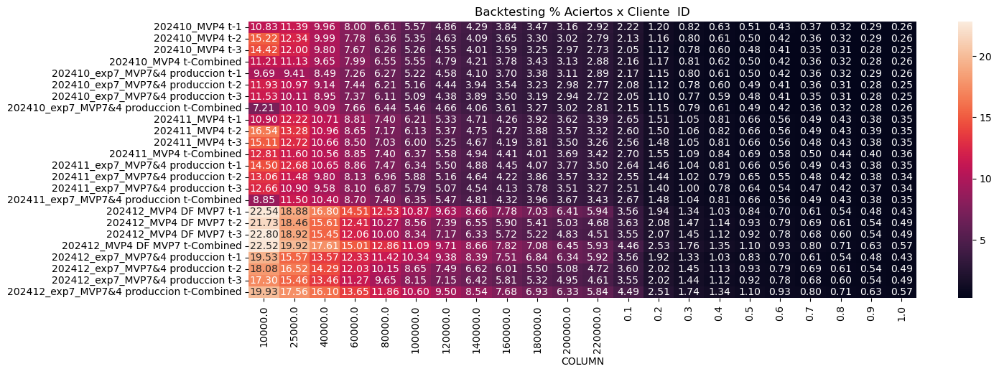

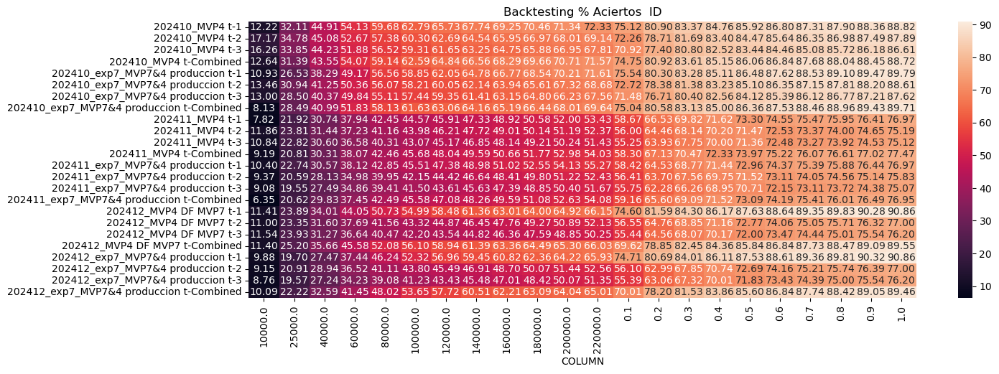

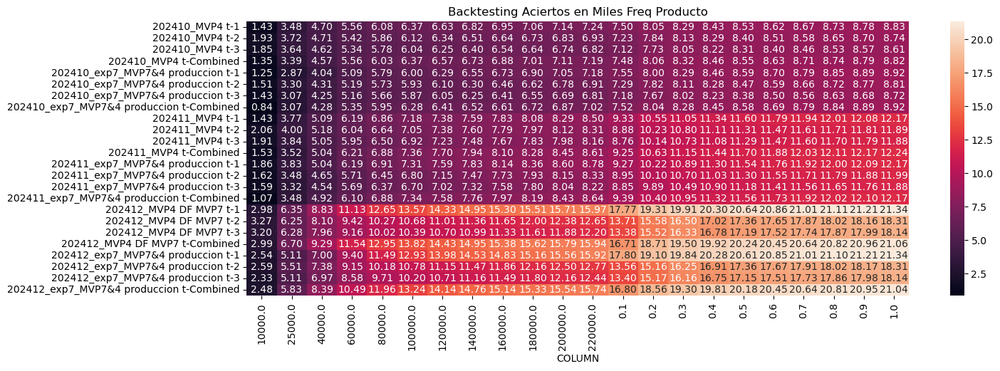

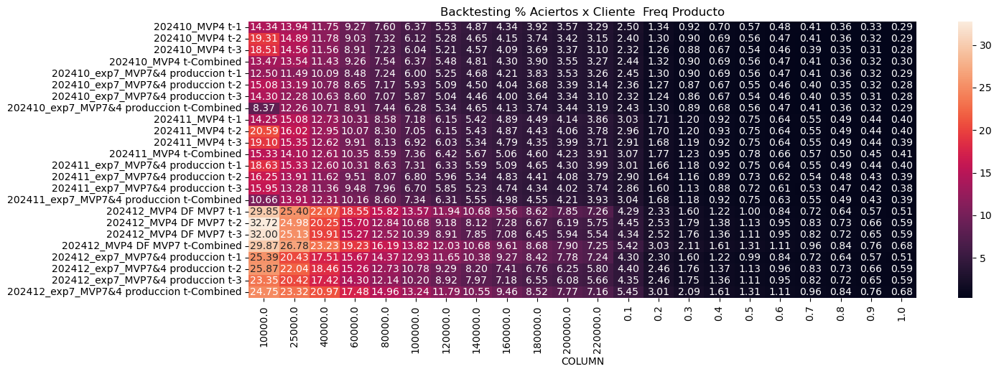

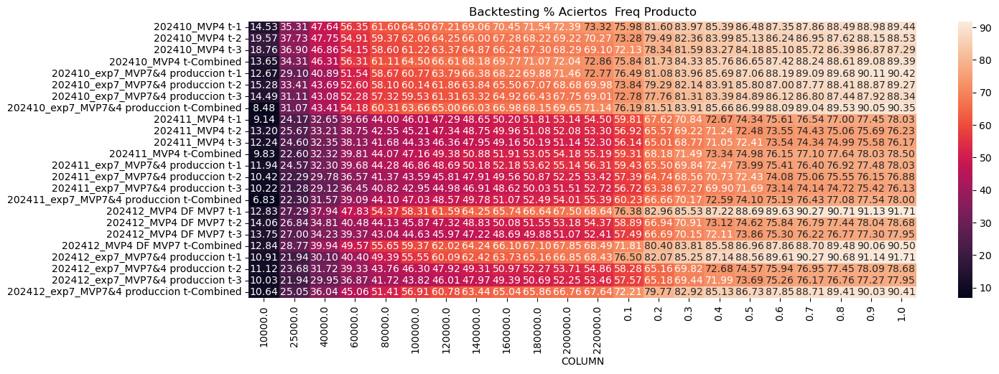

In [108]:
consolidacion_tipo = {}
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        df_i = save_backtesting[i]['contactabilidad_curva']#.keys()
        df_i = df_i[~df_i['Aciertos'].isnull()]
        df_i = df_i.replace('Fabrica '+params['target'].split('_')[0],name)
        df_i = df_i[df_i['Modelo'] == name]
        for tipo in df_i['Tipo'].unique():
            df_ii = df_i[df_i['Tipo'] == tipo]
            df_ii = df_ii.set_index('COLUMN')
            if tipo not in consolidacion_tipo:
                consolidacion_tipo[tipo] = {'Aciertos': pd.DataFrame(),'% Aciertos x Cliente':pd.DataFrame(),'% Aciertos': pd.DataFrame()}
            for col in ['Aciertos','% Aciertos x Cliente','% Aciertos']:
                consolidacion_tipo[tipo][col] = pd.concat([consolidacion_tipo[tipo][col],df_ii[[col]].rename(columns = {col:name})], axis = 1)
print(consolidacion_tipo.keys())
import seaborn as sns
for col in list(consolidacion_tipo.keys()):
    for tipo in ['Aciertos','% Aciertos x Cliente','% Aciertos']:
        if tipo == 'Aciertos':
            graph = consolidacion_tipo[col][tipo].T/1000
            msj = f'Backtesting {tipo} en Miles {col}'
        else:
            graph = consolidacion_tipo[col][tipo].T
            msj = f'Backtesting {tipo}  {col}'
        plt.figure(figsize=(15,5))
        sns.heatmap(graph, annot = True, fmt= '0.02f')
        plt.title(msj)
        plt.show()

In [11]:
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        print(name)
        res = save_backtesting[i]['ks']
        display(res)

202410_MVP4 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.20,17.06,300137,6660,2.22,84.57,10.00,74.57
1,9,0.08,0.20,300136,513,0.17,91.09,20.00,71.09
2,8,0.05,0.08,300136,219,0.07,93.87,30.00,63.87
3,7,0.04,0.05,300137,123,0.04,95.43,40.00,55.43
4,6,0.03,0.04,300136,103,0.03,96.74,50.00,46.74
5,5,0.02,0.03,300136,78,0.03,97.73,60.00,37.73
6,4,0.02,0.02,299451,45,0.02,98.30,69.98,28.32
7,3,0.01,0.02,300822,52,0.02,98.96,80.00,18.96
8,2,0.01,0.01,300136,41,0.01,99.48,90.00,9.48
9,1,0.00,0.01,300137,41,0.01,100.00,100.00,0.00


202410_MVP4 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.23,17.05,301027,6407,2.13,82.23,10.0,72.23
1,9,0.09,0.23,301026,571,0.19,89.55,20.0,69.55
2,8,0.05,0.09,301026,265,0.09,92.95,30.0,62.95
3,7,0.04,0.05,301026,151,0.05,94.89,40.0,54.89
4,6,0.03,0.04,301026,95,0.03,96.11,50.0,46.11
5,5,0.02,0.03,301026,104,0.03,97.45,60.0,37.45
6,4,0.02,0.02,301026,63,0.02,98.25,70.0,28.25
7,3,0.01,0.02,301026,56,0.02,98.97,80.0,18.97
8,2,0.01,0.01,301026,45,0.01,99.55,90.0,9.55
9,1,0.00,0.01,301027,35,0.01,100.00,100.0,0.00


202410_MVP4 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.23,17.06,306616,6288,2.05,81.89,10.00,71.89
1,9,0.09,0.23,306616,574,0.19,89.36,20.00,69.36
2,8,0.05,0.09,306616,302,0.10,93.29,30.00,63.29
3,7,0.03,0.05,306615,152,0.05,95.27,40.00,55.27
4,6,0.03,0.03,306616,82,0.03,96.34,50.00,46.34
5,5,0.02,0.03,306616,90,0.03,97.51,60.00,37.51
6,4,0.01,0.02,306615,55,0.02,98.23,70.00,28.23
7,3,0.01,0.01,306459,57,0.02,98.97,79.99,18.98
8,2,0.01,0.01,306773,41,0.01,99.51,90.00,9.51
9,1,0.00,0.01,306616,38,0.01,100.00,100.00,0.00


202410_MVP4 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.38,17.06,298793,6601,2.21,83.92,10.0,73.92
1,9,0.12,0.38,298792,557,0.19,91.00,20.0,71.00
2,8,0.07,0.12,298792,249,0.08,94.16,30.0,64.16
3,7,0.05,0.07,298793,133,0.04,95.86,40.0,55.86
4,6,0.04,0.05,298792,81,0.03,96.89,50.0,46.89
5,5,0.03,0.04,298792,71,0.02,97.79,60.0,37.79
6,4,0.02,0.03,298793,76,0.03,98.75,70.0,28.75
7,3,0.02,0.02,298792,34,0.01,99.19,80.0,19.19
8,2,0.01,0.02,298792,31,0.01,99.58,90.0,9.58
9,1,0.01,0.01,298793,33,0.01,100.00,100.0,0.00


202411_MVP4 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.33,17.06,308088,8179,2.65,76.22,10.00,66.22
1,9,0.20,0.33,308088,1096,0.36,86.43,20.00,66.43
2,8,0.17,0.20,308088,458,0.15,90.70,30.00,60.70
3,7,0.15,0.17,308088,252,0.08,93.05,40.00,53.05
4,6,0.14,0.15,308087,234,0.08,95.23,50.00,45.23
5,5,0.12,0.14,308088,174,0.06,96.85,60.00,36.85
6,4,0.11,0.12,305066,128,0.04,98.04,69.90,28.14
7,3,0.11,0.11,297724,67,0.02,98.67,79.57,19.10
8,2,0.11,0.11,321474,64,0.02,99.26,90.00,9.26
9,1,0.04,0.11,308088,79,0.03,100.00,100.00,0.00


202411_MVP4 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.20,17.06,300137,7807,2.60,74.48,10.00,64.48
1,9,0.08,0.20,300136,1180,0.39,85.74,20.00,65.74
2,8,0.05,0.08,300136,513,0.17,90.63,30.00,60.63
3,7,0.04,0.05,300137,287,0.10,93.37,40.00,53.37
4,6,0.03,0.04,300136,177,0.06,95.06,50.00,45.06
5,5,0.02,0.03,300136,148,0.05,96.47,60.00,36.47
6,4,0.02,0.02,299451,117,0.04,97.59,69.98,27.61
7,3,0.01,0.02,300822,88,0.03,98.43,80.00,18.43
8,2,0.01,0.01,300136,90,0.03,99.28,90.00,9.28
9,1,0.00,0.01,300137,75,0.02,100.00,100.00,0.00


202411_MVP4 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.23,17.05,301027,7703,2.56,73.55,10.0,63.55
1,9,0.09,0.23,301026,1209,0.40,85.10,20.0,65.09
2,8,0.05,0.09,301026,533,0.18,90.18,30.0,60.18
3,7,0.04,0.05,301026,314,0.10,93.18,40.0,53.18
4,6,0.03,0.04,301026,189,0.06,94.99,50.0,44.99
5,5,0.02,0.03,301026,157,0.05,96.49,60.0,36.49
6,4,0.02,0.02,301026,110,0.04,97.54,70.0,27.54
7,3,0.01,0.02,301026,90,0.03,98.40,80.0,18.40
8,2,0.01,0.01,301026,85,0.03,99.21,90.0,9.21
9,1,0.00,0.01,301027,83,0.03,100.00,100.0,0.00


202411_MVP4 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.51,17.06,298793,8113,2.72,75.12,10.00,65.12
1,9,0.21,0.51,298792,1240,0.42,86.60,20.00,66.60
2,8,0.17,0.21,298792,466,0.16,90.92,30.00,60.92
3,7,0.15,0.17,298793,255,0.09,93.28,40.00,53.28
4,6,0.14,0.15,298792,230,0.08,95.41,50.00,45.41
5,5,0.13,0.14,298792,177,0.06,97.05,60.00,37.05
6,4,0.12,0.13,297943,119,0.04,98.15,69.97,28.18
7,3,0.11,0.12,298658,77,0.03,98.86,79.97,18.89
8,2,0.11,0.11,299776,58,0.02,99.40,90.00,9.40
9,1,0.10,0.11,298793,65,0.02,100.00,100.00,0.00


202412_MVP4 DF MVP7 t-1


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.34,17.06,414480,14739,3.56,82.10,10.00,72.10
1,9,0.19,0.34,414480,1381,0.33,89.80,20.00,69.79
2,8,0.16,0.19,414480,536,0.13,92.78,30.00,62.78
3,7,0.14,0.16,414479,369,0.09,94.84,40.00,54.84
4,6,0.13,0.14,414480,289,0.07,96.45,50.00,46.45
5,5,0.12,0.13,414480,199,0.05,97.55,60.00,37.55
6,4,0.11,0.12,414479,140,0.03,98.33,70.00,28.33
7,3,0.11,0.11,414480,95,0.02,98.86,80.00,18.86
8,2,0.11,0.11,412250,90,0.02,99.36,89.95,9.42
9,1,0.03,0.11,416710,114,0.03,100.00,100.00,0.00


202412_MVP4 DF MVP7 t-2


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.31,17.05,308088,11174,3.63,73.45,10.0,63.45
1,9,0.20,0.31,308088,1622,0.53,84.11,20.0,64.11
2,8,0.17,0.20,308088,808,0.26,89.42,30.0,59.42
3,7,0.16,0.17,308088,455,0.15,92.41,40.0,52.41
4,6,0.14,0.16,308087,318,0.10,94.50,50.0,44.50
5,5,0.13,0.14,308088,256,0.08,96.18,60.0,36.18
6,4,0.12,0.13,308088,195,0.06,97.46,70.0,27.46
7,3,0.12,0.12,308059,130,0.04,98.32,80.0,18.32
8,2,0.12,0.12,308117,121,0.04,99.11,90.0,9.11
9,1,0.04,0.12,308088,135,0.04,100.00,100.0,0.00


202412_MVP4 DF MVP7 t-3


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.34,17.06,308346,10953,3.55,72.75,10.00,62.75
1,9,0.20,0.34,308346,1802,0.58,84.72,20.00,64.72
2,8,0.17,0.20,308346,695,0.23,89.34,30.00,59.34
3,7,0.15,0.17,308346,414,0.13,92.09,40.00,52.09
4,6,0.14,0.15,308346,361,0.12,94.49,50.00,44.49
5,5,0.12,0.14,306514,291,0.09,96.42,59.94,36.48
6,4,0.11,0.12,309648,192,0.06,97.70,69.98,27.71
7,3,0.11,0.11,299715,112,0.04,98.44,79.70,18.74
8,2,0.11,0.11,317507,106,0.03,99.14,90.00,9.14
9,1,0.04,0.11,308346,129,0.04,100.00,100.00,0.00


202412_MVP4 DF MVP7 t-Combined


,decil,prob_min,prob_max,total_clientes,total_aperturas,tasa_aperturas,cum_aperturas,cum_prob_esperadas,ks_stat
0,10,0.88,17.06,308088,13753,4.46,77.73,10.00,67.73
1,9,0.28,0.88,308088,1824,0.59,88.04,20.00,68.04
2,8,0.21,0.28,308088,712,0.23,92.06,30.00,62.06
3,7,0.18,0.21,308088,378,0.12,94.20,40.00,54.20
4,6,0.17,0.18,308088,292,0.09,95.85,50.00,45.85
5,5,0.15,0.17,308088,197,0.06,96.96,60.00,36.96
6,4,0.14,0.15,308088,178,0.06,97.97,70.00,27.97
7,3,0.13,0.14,308088,144,0.05,98.78,80.00,18.78
8,2,0.12,0.13,302443,121,0.04,99.47,89.82,9.65
9,1,0.12,0.12,313733,94,0.03,100.00,100.00,0.00


In [12]:
wanted_metric = ['N all','N n_top','true_sum n_top','backtest_metric n_top','Precision n_top','recall n_top','f1-score n_top']
for t,save_backtesting in enumerate(backtesting_all):
    for i in save_backtesting.keys():
        name = nametag_model[t]+' t-'+str(i)
        print(name,'Top Metrics')
        res = save_backtesting[i]['metrics']
        display(res[(res["metric_name"].isin(wanted_metric))&(res["class_name"].isin(['1.0','1',1,1.0,'dim shape']))].drop('timestamp', axis=1))
        display(res[res["metric_name"].isin(['True negatives','True positives','False negatives','False positives'])])
        print('------------')

202410_MVP4 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,900409
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,3001364
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,0.8211
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,0.8211
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,1.6288
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,7393


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
20,2025-01-20 16:55,CDT,"Ensamble,",202410,True positives,overall metric,overall,7873.0
21,2025-01-20 16:55,CDT,"Ensamble,",202410,False negatives,overall metric,overall,2.0
22,2025-01-20 16:55,CDT,"Ensamble,",202410,True negatives,overall metric,overall,11452.0
23,2025-01-20 16:55,CDT,"Ensamble,",202410,False positives,overall metric,overall,2909759.0


------------
202410_MVP4 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,903078
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,3010262
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,0.8031
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,0.8031
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,1.5935
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,7253


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
20,2025-01-20 16:55,CDT,"Ensamble,",202410,True positives,overall metric,overall,7792.0
21,2025-01-20 16:55,CDT,"Ensamble,",202410,False negatives,overall metric,overall,0.0
22,2025-01-20 16:55,CDT,"Ensamble,",202410,True negatives,overall metric,overall,10267.0
23,2025-01-20 16:55,CDT,"Ensamble,",202410,False positives,overall metric,overall,2834666.0


------------
202410_MVP4 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,919847
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,3066158
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,0.7803
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,0.7803
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,1.5486
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,7178


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
20,2025-01-20 16:55,CDT,"Ensamble,",202410,True positives,overall metric,overall,7677.0
21,2025-01-20 16:55,CDT,"Ensamble,",202410,False negatives,overall metric,overall,2.0
22,2025-01-20 16:55,CDT,"Ensamble,",202410,True negatives,overall metric,overall,10151.0
23,2025-01-20 16:55,CDT,"Ensamble,",202410,False positives,overall metric,overall,2753550.0


------------
202410_MVP4 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,896377
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,2987924
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,0.8278
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,0.8278
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,1.642
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,7420


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-20 16:55,CDT,"Ensamble,",202410,True positives,overall metric,overall,7866.0
19,2025-01-20 16:55,CDT,"Ensamble,",202410,False negatives,overall metric,overall,0.0
20,2025-01-20 16:55,CDT,"Ensamble,",202410,True negatives,overall metric,overall,0.0
21,2025-01-20 16:55,CDT,"Ensamble,",202410,False positives,overall metric,overall,2742156.0


------------
202411_MVP4 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,1.0533
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,1.0533
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,2.0846
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,9735


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-20 17:29,CDT,"Ensamble,",202410,True positives,overall metric,overall,10731.0
19,2025-01-20 17:29,CDT,"Ensamble,",202410,False negatives,overall metric,overall,0.0
20,2025-01-20 17:29,CDT,"Ensamble,",202410,True negatives,overall metric,overall,0.0
21,2025-01-20 17:29,CDT,"Ensamble,",202410,False positives,overall metric,overall,2991686.0


------------
202411_MVP4 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,900409
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,3001364
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,1.0559
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,1.0559
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,2.0896
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,9507


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
20,2025-01-20 17:29,CDT,"Ensamble,",202410,True positives,overall metric,overall,10479.0
21,2025-01-20 17:29,CDT,"Ensamble,",202410,False negatives,overall metric,overall,3.0
22,2025-01-20 17:29,CDT,"Ensamble,",202410,True negatives,overall metric,overall,10362.0
23,2025-01-20 17:29,CDT,"Ensamble,",202410,False positives,overall metric,overall,2834260.0


------------
202411_MVP4 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,903078
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,3010262
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,1.0474
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,1.0474
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,2.0731
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,9459


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
20,2025-01-20 17:29,CDT,"Ensamble,",202410,True positives,overall metric,overall,10469.0
21,2025-01-20 17:29,CDT,"Ensamble,",202410,False negatives,overall metric,overall,4.0
22,2025-01-20 17:29,CDT,"Ensamble,",202410,True negatives,overall metric,overall,9613.0
23,2025-01-20 17:29,CDT,"Ensamble,",202410,False positives,overall metric,overall,2770661.0


------------
202411_MVP4 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202410,N n_top,n_top,1,896377
1,CDT,"Ensamble,",202410,N all,dim shape,dim shape,2987924
2,CDT,"Ensamble,",202410,backtest_metric n_top,n_top,1.0,1.096
3,CDT,"Ensamble,",202410,Precision n_top,n_top,1,1.096
5,CDT,"Ensamble,",202410,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202410,f1-score n_top,n_top,1,2.1682
9,CDT,"Ensamble,",202410,true_sum n_top,n_top,1,9824


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-20 17:29,CDT,"Ensamble,",202410,True positives,overall metric,overall,10800.0
19,2025-01-20 17:29,CDT,"Ensamble,",202410,False negatives,overall metric,overall,0.0
20,2025-01-20 17:29,CDT,"Ensamble,",202410,True negatives,overall metric,overall,0.0
21,2025-01-20 17:29,CDT,"Ensamble,",202410,False positives,overall metric,overall,2898974.0


------------
202412_MVP4 DF MVP7 t-1 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,1243439
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,4144798
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,1.34
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,1.34
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,2.6445
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,16662


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-28 18:00,CDT,"Ensamble,",202412,True positives,overall metric,overall,17952.0
19,2025-01-28 18:00,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-01-28 18:00,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-01-28 18:00,CDT,"Ensamble,",202412,False positives,overall metric,overall,4044946.0


------------
202412_MVP4 DF MVP7 t-2 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,924263
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3080879
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,1.4731
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,1.4731
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,2.9034
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,13615


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-28 18:00,CDT,"Ensamble,",202412,True positives,overall metric,overall,15214.0
19,2025-01-28 18:00,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-01-28 18:00,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-01-28 18:00,CDT,"Ensamble,",202412,False positives,overall metric,overall,2923589.0


------------
202412_MVP4 DF MVP7 t-3 Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,925038
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3083460
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,1.4556
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,1.4556
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,2.8695
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,13465


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-28 18:00,CDT,"Ensamble,",202412,True positives,overall metric,overall,15055.0
19,2025-01-28 18:00,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-01-28 18:00,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-01-28 18:00,CDT,"Ensamble,",202412,False positives,overall metric,overall,2859602.0


------------
202412_MVP4 DF MVP7 t-Combined Top Metrics


,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
0,CDT,"Ensamble,",202412,N n_top,n_top,1,924264
1,CDT,"Ensamble,",202412,N all,dim shape,dim shape,3080880
2,CDT,"Ensamble,",202412,backtest_metric n_top,n_top,1.0,1.7644
3,CDT,"Ensamble,",202412,Precision n_top,n_top,1,1.7644
5,CDT,"Ensamble,",202412,recall n_top,n_top,1,100.0
7,CDT,"Ensamble,",202412,f1-score n_top,n_top,1,3.4677
9,CDT,"Ensamble,",202412,true_sum n_top,n_top,1,16308


,timestamp,model_name,model_type,dataset_name,metric_name,metric_type,class_name,value
18,2025-01-28 18:00,CDT,"Ensamble,",202412,True positives,overall metric,overall,17693.0
19,2025-01-28 18:00,CDT,"Ensamble,",202412,False negatives,overall metric,overall,0.0
20,2025-01-28 18:00,CDT,"Ensamble,",202412,True negatives,overall metric,overall,0.0
21,2025-01-28 18:00,CDT,"Ensamble,",202412,False positives,overall metric,overall,2967454.0


------------
